In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = []
strings="""[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]"""

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[6339, 5760, 5485, 6409, 5864, 5465, 7396, 1310, 9076, 8001, 7955, 3978, 920, 9029, 6628, 9012, 6533, 6397, 4157, 3465]
log initialized
Average similarity between family members is 0.9763871297477349 at temperature -1
Average similarity between family and home is 0.9998503033639403 at temperature -1
Average similarity between students and their classroom is 0.9635423214036328 at temperature -1
Average classroom occupancy is 1.7797619047619047 and number classrooms is 168
Average similarity between workers is 0.9720845843887873 at temperature -1
Average office occupancy is 3.3195876288659796 and number offices is 194
Average friend similarity for adults: 0.8552808734011104 for kids: 0.7485621161424625
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.7334803509718267
avg restaurant similarity 0.4907910328549003
avg restaurant similarity 0.4509469840723941
avg restaurant similarity 0.999806753232027
avg restaurant similarity 0.49871577957130503
avg restaurant similarity 0.798258143006674
avg restaurant similarity 0.7765702080285455
avg restaurant similarity 0.5915922646090377
avg restaurant similarity 0.8907390745381276
avg restaurant similarity 0.7365577463027683
avg restaurant similarity 0.6023200290434724
avg restaurant similarity 0.8707954635620642
avg restaurant similarity 0.5353754560868346
avg restaurant similarity 0.5106596677118702
avg restaurant similarity 0.36770274475032527
avg restaurant similarity 0.8238775377068324
avg restaurant similarity 0.8235034720758077
avg restaurant similarity 0.5969431693719641
avg restaurant similarity 0.6939654007208631
avg restaurant similarity 0.7210660274040044
avg restaurant similarity 0.6022803168726624
avg restaurant similarity 0.9997729106170097
avg restau

Average similarity between family and home is 0.9998690134836847 at temperature -1
Average similarity between students and their classroom is 0.9713951499201036 at temperature -1
Average classroom occupancy is 1.74375 and number classrooms is 160
Average similarity between workers is 0.9669840787365508 at temperature -1
Average office occupancy is 3.550802139037433 and number offices is 187
Average friend similarity for adults: 0.8612651413460971 for kids: 0.7378032543846047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.42342706774062266
avg restaurant similarity 0.643329756090304
avg restaurant similarity 0.999535040908209
avg restaurant similarity 0.8633734608606083
avg restaurant similarity 0.7884482560286573
avg restaurant similarity 0.6926909246640196
avg restaurant similarity 0.46178488156243724
avg restaurant similarity 0.6127887653881627
avg restaurant similarity 0.4701739151286694
avg restaurant similarity 0.7684264325084855
avg restaurant similarity 0.7258600392764121
avg restaurant similarity 0.685359083455582
avg restaurant similarity 0.9998917709769823
avg restaurant similarity 0.6446423518774217
avg restaurant similarity 0.5242431679456152
avg restaurant similarity 0.9997248076869576
avg restaurant similarity 0.9998917709769823
avg restaurant similarity 0.9004234519107938
avg restaurant similarity 0.9105081908931734
avg restaurant similarity 0.8114583741778292
avg restaurant similarity 0.9998408000362902
avg restaurant similarity 0.5465260027294941
avg restaur

avg restaurant similarity 0.8511291194043613
avg restaurant similarity 0.5543214071373551
avg restaurant similarity 0.8700527883359057
avg restaurant similarity 0.7584302709137108
avg restaurant similarity 0.5229424694799465
avg restaurant similarity 0.6844821700430723
avg restaurant similarity 0.5952630799472626
avg restaurant similarity 0.8065907444293968
avg restaurant similarity 0.3861794115231134
avg restaurant similarity 0.614613819144412
avg restaurant similarity 0.45132102217993697
avg restaurant similarity 0.9995138684905818
avg restaurant similarity 0.8022277887853946
avg restaurant similarity 0.5548702754744095
avg restaurant similarity 0.4148485923348234
avg restaurant similarity 0.9045619559534142
avg restaurant similarity 0.5505222866269304
avg restaurant similarity 0.4553980603802017
avg restaurant similarity 0.5332873752614046
avg restaurant similarity 0.6133715044179797
avg restaurant similarity 0.3831019331208338
avg restaurant similarity 0.5586979147550036
avg restau

avg restaurant similarity 0.7806706570242169
avg restaurant similarity 0.5299393693486871
avg restaurant similarity 0.8868038304804713
avg restaurant similarity 0.6091889205676272
avg restaurant similarity 0.6708940133016776
avg restaurant similarity 0.5702027512921811
avg restaurant similarity 0.7976645665724457
avg restaurant similarity 0.35028598012462975
avg restaurant similarity 0.4297298364231604
avg restaurant similarity 0.5643718653453531
avg restaurant similarity 0.46545041983650615
avg restaurant similarity 0.9996748723439652
avg restaurant similarity 0.42182318218097875
avg restaurant similarity 0.6191552744127033
avg restaurant similarity 0.6208315623501056
avg restaurant similarity 0.9268531922618369
avg restaurant similarity 0.48289724773628706
avg restaurant similarity 0.4048736068810791
avg restaurant similarity 0.577570338824239
avg restaurant similarity 0.47793557569230627
avg restaurant similarity 0.7320875845366475
avg restaurant similarity 0.7038738209121713
avg re

avg restaurant similarity 0.349122511231012
avg restaurant similarity 0.48090143852526535
avg restaurant similarity 0.7359612075497963
avg restaurant similarity 0.851471424638851
avg restaurant similarity 0.6876951379763186
avg restaurant similarity 0.6410281695949108
avg restaurant similarity 0.7354172175642384
avg restaurant similarity 0.5976669292819797
avg restaurant similarity 0.32293236913805
avg restaurant similarity 0.8422724525577103
avg restaurant similarity 0.6643561167145103
avg restaurant similarity 0.48111198027788976
avg restaurant similarity 0.3897220460706507
avg restaurant similarity 0.48486745203439363
avg restaurant similarity 0.479623407721456
avg restaurant similarity 0.48111198027788976
avg restaurant similarity 0.4668692547197171
avg restaurant similarity 0.6474439515796653
Average similarity between family members is 0.9685552022028269 at temperature -1
Average similarity between family and home is 0.9998564933168519 at temperature -1
Average similarity between

avg restaurant similarity 0.6509904986629035
avg restaurant similarity 0.5730105867532288
avg restaurant similarity 0.9996976837455386
avg restaurant similarity 0.9999287503176756
avg restaurant similarity 0.7837199340894504
avg restaurant similarity 0.4813699042411967
avg restaurant similarity 0.708942199564275
avg restaurant similarity 0.8162492936402934
avg restaurant similarity 0.6423680068031962
avg restaurant similarity 0.8122170224294918
avg restaurant similarity 0.6174590120590795
avg restaurant similarity 0.8570004626754602
avg restaurant similarity 0.5311655184244521
avg restaurant similarity 0.6732711808458183
avg restaurant similarity 0.9997049472207733
avg restaurant similarity 0.6693343074845699
avg restaurant similarity 0.8355612857622875
avg restaurant similarity 0.6834158678756251
avg restaurant similarity 0.8188562037913026
avg restaurant similarity 0.6602276650726294
avg restaurant similarity 0.8206353655044176
avg restaurant similarity 0.6256363265698033
avg restaur

avg restaurant similarity 0.4682523313785456
avg restaurant similarity 0.6577993408455136
avg restaurant similarity 0.9997223168394914
avg restaurant similarity 0.43536031097513217
avg restaurant similarity 0.7546058718591915
avg restaurant similarity 0.3575353458349293
avg restaurant similarity 0.9998184750938048
avg restaurant similarity 0.5898910602090308
avg restaurant similarity 0.9575184140427714
avg restaurant similarity 0.6699062508771788
avg restaurant similarity 0.6699062508771788
avg restaurant similarity 0.6116239993645443
avg restaurant similarity 0.6732711808458183
avg restaurant similarity 0.6699062508771788
avg restaurant similarity 0.8123893154038893
avg restaurant similarity 0.41755460587873394
avg restaurant similarity 0.722865428732785
avg restaurant similarity 0.4180308793598684
avg restaurant similarity 0.8941686873330825
avg restaurant similarity 0.9998998063679168
avg restaurant similarity 0.30767687409440114
avg restaurant similarity 0.9310115803547262
avg rest

avg restaurant similarity 0.48804453167298384
avg restaurant similarity 0.5421844893762827
avg restaurant similarity 0.5911219127490642
avg restaurant similarity 0.5366824547725054
avg restaurant similarity 0.7851080878154084
avg restaurant similarity 0.7254360614855778
avg restaurant similarity 0.6648351888806173
avg restaurant similarity 0.4850390001137526
avg restaurant similarity 0.47895384496927035
avg restaurant similarity 0.8892337766812702
avg restaurant similarity 0.6181528815815776
avg restaurant similarity 0.5375038265416913
avg restaurant similarity 0.723334465522172
avg restaurant similarity 0.6418889803985411
avg restaurant similarity 0.44832889090473227
avg restaurant similarity 0.7284151841604182
avg restaurant similarity 0.7351074127301926
avg restaurant similarity 0.8369399055183642
avg restaurant similarity 0.9494175962201823
avg restaurant similarity 0.6890074870312533
avg restaurant similarity 0.7094918919651627
avg restaurant similarity 0.5363124191150893
avg rest

avg restaurant similarity 0.7186084907859491
avg restaurant similarity 0.579995841023068
avg restaurant similarity 0.7592055236139668
avg restaurant similarity 0.7338747000844509
avg restaurant similarity 0.30671598976024883
avg restaurant similarity 0.5704537996462266
avg restaurant similarity 0.9275790225585503
avg restaurant similarity 0.7148860457058385
avg restaurant similarity 0.45021184300237294
avg restaurant similarity 0.5704729792399974
avg restaurant similarity 0.724445539844063
avg restaurant similarity 0.5020078905564076
avg restaurant similarity 0.5638373076878682
avg restaurant similarity 0.5871558286861579
avg restaurant similarity 0.42579967091106674
avg restaurant similarity 0.7337283804919518
avg restaurant similarity 0.6463172729726336
avg restaurant similarity 0.5441872414833208
avg restaurant similarity 0.6075889612611861
avg restaurant similarity 0.5539403991120743
avg restaurant similarity 0.4735358470847847
avg restaurant similarity 0.5746840700330571
avg resta

avg restaurant similarity 0.6178651375644048
avg restaurant similarity 0.7623491875582761
avg restaurant similarity 0.5893003397964915
avg restaurant similarity 0.3922533267232065
avg restaurant similarity 0.5610635102840065
avg restaurant similarity 0.6728552265277238
avg restaurant similarity 0.7527483996514894
avg restaurant similarity 0.8394839278392693
avg restaurant similarity 0.510380447099417
avg restaurant similarity 0.5589828065495772
avg restaurant similarity 0.7870516458868357
avg restaurant similarity 0.5157437774883524
avg restaurant similarity 0.6384884003792489
avg restaurant similarity 0.46927504534528786
avg restaurant similarity 0.882896952403911
avg restaurant similarity 0.6990237364836478
avg restaurant similarity 0.47229771519708574
avg restaurant similarity 0.30479369900914705
avg restaurant similarity 0.6563390879632949
avg restaurant similarity 0.5610635102840065
avg restaurant similarity 0.7640548167742081
avg restaurant similarity 0.8393650063288561
avg resta

avg restaurant similarity 0.5854698261883893
avg restaurant similarity 0.7842332917055523
avg restaurant similarity 0.8714491557350809
avg restaurant similarity 0.5735484821451372
avg restaurant similarity 0.3315116104724478
avg restaurant similarity 0.9997479003882953
avg restaurant similarity 0.7032772990689404
avg restaurant similarity 0.5408859155333847
avg restaurant similarity 0.905714803223304
avg restaurant similarity 0.8819983896376644
avg restaurant similarity 0.8828127759587207
avg restaurant similarity 0.6187906345934672
avg restaurant similarity 0.8807647066823475
avg restaurant similarity 0.921184771680414
avg restaurant similarity 0.780255839422198
avg restaurant similarity 0.5937625404598548
avg restaurant similarity 0.516118991726188
avg restaurant similarity 0.7640548167742081
avg restaurant similarity 0.45305243068183004
avg restaurant similarity 0.8547993447158739
avg restaurant similarity 0.34360187569614337
avg restaurant similarity 0.5670227819208675
avg restaura

avg restaurant similarity 0.6657062228727514
avg restaurant similarity 0.43674133755915234
avg restaurant similarity 0.62483892397886
avg restaurant similarity 0.7930106718252302
avg restaurant similarity 0.4725765509609763
avg restaurant similarity 0.28168108198448033
avg restaurant similarity 0.480761645697659
avg restaurant similarity 0.2863287131070045
avg restaurant similarity 0.6416431799833426
avg restaurant similarity 0.6484531113538158
avg restaurant similarity 0.62790696892161
avg restaurant similarity 0.9998519982349583
avg restaurant similarity 0.4345293203422622
avg restaurant similarity 0.4716639411524689
avg restaurant similarity 0.470824265419012
avg restaurant similarity 0.6396328483846975
avg restaurant similarity 0.6365921756912531
avg restaurant similarity 0.6652777204325482
avg restaurant similarity 0.37031077684190594
avg restaurant similarity 0.9997951224882407
avg restaurant similarity 0.7362024617172926
avg restaurant similarity 0.715636931368974
avg restaurant

avg restaurant similarity 0.7955161402198649
avg restaurant similarity 0.5761898580429149
avg restaurant similarity 0.9355842774004346
avg restaurant similarity 0.6652777204325482
Average similarity between family members is 0.9700654725272523 at temperature -1
Average similarity between family and home is 0.99984285938027 at temperature -1
Average similarity between students and their classroom is 0.9686163169910796 at temperature -1
Average classroom occupancy is 1.6931818181818181 and number classrooms is 176
Average similarity between workers is 0.9744729613105083 at temperature -1
Average office occupancy is 3.56353591160221 and number offices is 181
Average friend similarity for adults: 0.8502926817731158 for kids: 0.7428247529742912
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.6006034341804776
avg restaurant similarity 0.6595256274387721
avg restaurant similarity 0.8132361914147654
avg restaurant similarity 0.4614331955740266
avg restaurant similarity 0.4997114752499414
avg restaurant similarity 0.8940809333111467
avg restaurant similarity 0.49568037272660026
avg restaurant similarity 0.9993050526190097
avg restaurant similarity 0.49937310265523377
avg restaurant similarity 0.905488596859827
avg restaurant similarity 0.5016875171238693
avg restaurant similarity 0.7670577357912897
avg restaurant similarity 0.6971189063970871
avg restaurant similarity 0.33646192254842516
avg restaurant similarity 0.2522708338605225
avg restaurant similarity 0.6906231181854683
avg restaurant similarity 0.6260117598843057
avg restaurant similarity 0.5008258651736873
avg restaurant similarity 0.6262853097151675
avg restaurant similarity 0.49775629465322047
avg restaurant similarity 0.9995895812150033
avg restaurant similarity 0.7719164096086149
avg res

Average similarity between workers is 0.9691111219707803 at temperature -1
Average office occupancy is 3.639784946236559 and number offices is 186
Average friend similarity for adults: 0.8631610898977264 for kids: 0.7309857172122838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.630382342064451
avg restaurant similarity 0.8111189808216515
avg restaurant similarity 0.44528946654820967
avg restaurant similarity 0.45490312454794174
avg restaurant similarity 0.6934636403335461
avg restaurant similarity 0.7768072152213982
avg restaurant similarity 0.7768072152213982
avg restaurant similarity 0.4444091613807023
avg restaurant similarity 0.486719617933093
avg restaurant similarity 0.6078260607811073
avg restaurant similarity 0.49568964114052894
avg restaurant similarity 0.7768072152213982
avg restaurant similarity 0.9997140573793732
avg restaurant similarity 0.7525852718678079
avg restaurant similarity 0.38915346405068724
avg restaurant similarity 0.9995014645303142
avg restaurant similarity 0.3630684516370628
avg restaurant similarity 0.6509378017530918
avg restaurant similarity 0.5662801327071381
avg restaurant similarity 0.6618758257398791
avg restaurant similarity 0.6431279683287245
avg restaurant similarity 0.6420128223174304
avg rest

avg restaurant similarity 0.6853516963898402
avg restaurant similarity 0.6428596375558918
avg restaurant similarity 0.6718013945322852
avg restaurant similarity 0.6703903841995578
avg restaurant similarity 0.8718516891135053
avg restaurant similarity 0.45290852050691527
avg restaurant similarity 0.6966469458221043
avg restaurant similarity 0.5514830499820931
avg restaurant similarity 0.8114870933772802
avg restaurant similarity 0.6973555916233725
avg restaurant similarity 0.7367270805217513
avg restaurant similarity 0.6055050748329237
avg restaurant similarity 0.45290852050691527
avg restaurant similarity 0.45444593435545555
avg restaurant similarity 0.3226400505506183
avg restaurant similarity 0.7162941020957972
avg restaurant similarity 0.5090759317732083
avg restaurant similarity 0.48731236307098114
avg restaurant similarity 0.5389314938349686
avg restaurant similarity 0.6458279593345659
avg restaurant similarity 0.6684674873153431
avg restaurant similarity 0.7768072152213982
avg re

avg restaurant similarity 0.999924158992015
avg restaurant similarity 0.3499071444341227
avg restaurant similarity 0.5588266738041548
avg restaurant similarity 0.46391424919283686
avg restaurant similarity 0.8227164699328353
avg restaurant similarity 0.7873347757102638
avg restaurant similarity 0.9999311785335999
avg restaurant similarity 0.9111075517352045
avg restaurant similarity 0.6697038889059349
avg restaurant similarity 0.3918538645077489
avg restaurant similarity 0.7845221108991225
avg restaurant similarity 0.5611934200989896
avg restaurant similarity 0.5505531566817585
avg restaurant similarity 0.6682095108175072
avg restaurant similarity 0.6130488037473105
avg restaurant similarity 0.4602655040429938
avg restaurant similarity 0.6997703452596896
avg restaurant similarity 0.7714953151649888
avg restaurant similarity 0.39644723228929724
avg restaurant similarity 0.800170409850499
avg restaurant similarity 0.568976485487124
avg restaurant similarity 0.556978737453141
avg restaura

avg restaurant similarity 0.5665187297645642
avg restaurant similarity 0.537083541000614
avg restaurant similarity 0.4323314814566196
avg restaurant similarity 0.4642811087751493
avg restaurant similarity 0.5334049597619263
avg restaurant similarity 0.39108725107384273
avg restaurant similarity 0.4203867604678809
avg restaurant similarity 0.5478983284744745
avg restaurant similarity 0.4564718626828804
avg restaurant similarity 0.6916196010896615
avg restaurant similarity 0.5316054264991421
avg restaurant similarity 0.9092526691505499
avg restaurant similarity 0.49596172037128616
avg restaurant similarity 0.5127615895298399
avg restaurant similarity 0.49331621270433773
avg restaurant similarity 0.573037165106141
avg restaurant similarity 0.9521285449427641
avg restaurant similarity 0.8001034659785914
avg restaurant similarity 0.7954878035513786
avg restaurant similarity 0.5943690308915146
avg restaurant similarity 0.4789131021757778
avg restaurant similarity 0.7545091946101196
avg resta

avg restaurant similarity 0.608158720854358
avg restaurant similarity 0.6022519935197791
avg restaurant similarity 0.7646037070134127
avg restaurant similarity 0.9998796972128893
avg restaurant similarity 0.6672477622285722
avg restaurant similarity 0.9370172103444194
avg restaurant similarity 0.5394199810792366
avg restaurant similarity 0.8799543964131663
avg restaurant similarity 0.9997805186337189
avg restaurant similarity 0.5621934100406079
avg restaurant similarity 0.5669668371369607
avg restaurant similarity 0.7657161286919492
avg restaurant similarity 0.9993686179037407
avg restaurant similarity 0.33392424340182697
avg restaurant similarity 0.6496099140127277
avg restaurant similarity 0.7068255920627644
avg restaurant similarity 0.5696254849074212
avg restaurant similarity 0.6176746494868679
avg restaurant similarity 0.7076076120290472
avg restaurant similarity 0.6265155059921338
avg restaurant similarity 0.9999108190521893
avg restaurant similarity 0.9999873692916481
avg restau

avg restaurant similarity 0.7491025489269812
avg restaurant similarity 0.5706032348703125
avg restaurant similarity 0.8267900293945545
avg restaurant similarity 0.6079132352156785
avg restaurant similarity 0.6913951955889985
avg restaurant similarity 0.5920350935120127
avg restaurant similarity 0.3613283576174007
avg restaurant similarity 0.8474239278163764
avg restaurant similarity 0.5617741872050495
avg restaurant similarity 0.5158170689287739
avg restaurant similarity 0.7518749365441475
avg restaurant similarity 0.7344484578295523
avg restaurant similarity 0.659081275710658
avg restaurant similarity 0.5538970628127194
avg restaurant similarity 0.7878825135333053
avg restaurant similarity 0.33742094768117536
avg restaurant similarity 0.6343490943045679
avg restaurant similarity 0.41097079942284787
avg restaurant similarity 0.6301835558065213
avg restaurant similarity 0.44428444339756246
avg restaurant similarity 0.4669860238293517
avg restaurant similarity 0.6105756981945388
avg rest

avg restaurant similarity 0.9998295478696824
avg restaurant similarity 0.7518749365441475
avg restaurant similarity 0.6985006505341093
avg restaurant similarity 0.911620607455071
avg restaurant similarity 0.6895092196177123
avg restaurant similarity 0.5872800605679598
avg restaurant similarity 0.9994820364755009
avg restaurant similarity 0.5438313544159411
avg restaurant similarity 0.8263488982155893
avg restaurant similarity 0.7176370302443908
avg restaurant similarity 0.9201292789390774
avg restaurant similarity 0.5308534151839961
avg restaurant similarity 0.8652452426424687
avg restaurant similarity 0.8791540179646465
avg restaurant similarity 0.5781277755331996
avg restaurant similarity 0.5024545143849526
avg restaurant similarity 0.5985058227113433
avg restaurant similarity 0.7418534877956902
avg restaurant similarity 0.6079132352156785
Average similarity between family members is 0.9680985767077921 at temperature -1
Average similarity between family and home is 0.9998574561254608

avg restaurant similarity 0.8381110755264447
avg restaurant similarity 0.8705303605139938
avg restaurant similarity 0.7746292946573006
avg restaurant similarity 0.5966691165712239
avg restaurant similarity 0.4446021061393878
avg restaurant similarity 0.6573792592782755
avg restaurant similarity 0.5546225659549162
avg restaurant similarity 0.4350644442383087
avg restaurant similarity 0.44840169111384404
avg restaurant similarity 0.4422105746328996
avg restaurant similarity 0.5657885221367781
avg restaurant similarity 0.7835778509493853
avg restaurant similarity 0.6762335550115496
avg restaurant similarity 0.4475988455562698
avg restaurant similarity 0.8824252222989643
avg restaurant similarity 0.46921673591530805
avg restaurant similarity 0.7802006181983383
avg restaurant similarity 0.4422105746328996
avg restaurant similarity 0.8908140289678796
avg restaurant similarity 0.8755811058194318
avg restaurant similarity 0.681339928292407
avg restaurant similarity 0.44840169111384404
avg rest

avg restaurant similarity 0.7319665713625763
avg restaurant similarity 0.4632097991333515
avg restaurant similarity 0.5814600564546711
avg restaurant similarity 0.8670240346730392
avg restaurant similarity 0.6403713737675404
avg restaurant similarity 0.4954308259104566
avg restaurant similarity 0.7443548361770826
avg restaurant similarity 0.7334231932347249
avg restaurant similarity 0.5380447734709132
avg restaurant similarity 0.5599222201862031
avg restaurant similarity 0.4599025002940774
avg restaurant similarity 0.7041200557401833
avg restaurant similarity 0.38890443530478636
avg restaurant similarity 0.7319665713625763
avg restaurant similarity 0.8317437111868392
avg restaurant similarity 0.40518610429203566
avg restaurant similarity 0.7702813549843944
avg restaurant similarity 0.6240237756367939
avg restaurant similarity 0.4793969421957599
avg restaurant similarity 0.7702813549843944
avg restaurant similarity 0.8113672624508361
avg restaurant similarity 0.6762735401177904
avg rest

avg restaurant similarity 0.6505911520620143
avg restaurant similarity 0.5069041151230825
avg restaurant similarity 0.5377775849147012
avg restaurant similarity 0.7048868647801549
avg restaurant similarity 0.8350228164531448
avg restaurant similarity 0.5985456671985616
avg restaurant similarity 0.7891540572941513
avg restaurant similarity 0.4951225433813682
avg restaurant similarity 0.6737785706748647
avg restaurant similarity 0.514785786840976
avg restaurant similarity 0.8781290807816456
avg restaurant similarity 0.8794374337269513
avg restaurant similarity 0.6368182950292591
avg restaurant similarity 0.5604347411514488
avg restaurant similarity 0.754674537020059
avg restaurant similarity 0.8780251016549493
avg restaurant similarity 0.4510626397303247
avg restaurant similarity 0.7517711520157985
avg restaurant similarity 0.5958134688955508
avg restaurant similarity 0.8369749276707235
avg restaurant similarity 0.7562517965107323
avg restaurant similarity 0.3103975886138448
avg restaura

avg restaurant similarity 0.7540918859651491
avg restaurant similarity 0.9267368111371124
Average similarity between family members is 0.9704930863451053 at temperature -1
Average similarity between family and home is 0.999843776099878 at temperature -1
Average similarity between students and their classroom is 0.9693203473704665 at temperature -1
Average classroom occupancy is 1.6820809248554913 and number classrooms is 173
Average similarity between workers is 0.9756799565144977 at temperature -1
Average office occupancy is 3.4285714285714284 and number offices is 189
Average friend similarity for adults: 0.8615555023766375 for kids: 0.7426803484338975
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with 

avg restaurant similarity 0.5743904387107112
avg restaurant similarity 0.5721860738936769
avg restaurant similarity 0.48831129340907686
avg restaurant similarity 0.44258310047339616
avg restaurant similarity 0.28259632436638527
avg restaurant similarity 0.7078480676408544
avg restaurant similarity 0.7361741975667089
avg restaurant similarity 0.8540283160558588
avg restaurant similarity 0.59326801537382
avg restaurant similarity 0.4045196619744388
avg restaurant similarity 0.8280443395946129
avg restaurant similarity 0.7210228697344061
avg restaurant similarity 0.7205927040563678
avg restaurant similarity 0.38647389690730005
avg restaurant similarity 0.7636780120101133
avg restaurant similarity 0.6496044550741074
avg restaurant similarity 0.8719921323154844
avg restaurant similarity 0.5420951918512449
avg restaurant similarity 0.6389082111067113
avg restaurant similarity 0.5119909329607574
avg restaurant similarity 0.5431139060317326
avg restaurant similarity 0.7205927040563678
avg rest

avg restaurant similarity 0.5697375719512698
avg restaurant similarity 0.5996926149510367
avg restaurant similarity 0.43855820400577394
avg restaurant similarity 0.652067962782227
avg restaurant similarity 0.42973845105358627
avg restaurant similarity 0.604738095174162
avg restaurant similarity 0.78741548561606
avg restaurant similarity 0.8609813279015439
avg restaurant similarity 0.45113088319698946
avg restaurant similarity 0.568005770058261
avg restaurant similarity 0.7590944937250698
avg restaurant similarity 0.9997637699506595
avg restaurant similarity 0.5888121177793035
avg restaurant similarity 0.39992591559785085
avg restaurant similarity 0.47769762077100103
avg restaurant similarity 0.7060790523381544
avg restaurant similarity 0.7901027455694506
avg restaurant similarity 0.8414894942434851
avg restaurant similarity 0.4409988768280473
avg restaurant similarity 0.5550066411801335
avg restaurant similarity 0.6624138177829612
avg restaurant similarity 0.6519654618697888
avg restau

avg restaurant similarity 0.5175759969664918
avg restaurant similarity 0.4470109103927044
avg restaurant similarity 0.5720421511232402
avg restaurant similarity 0.5839187370531367
avg restaurant similarity 0.2882633889602634
avg restaurant similarity 0.8611375063492542
avg restaurant similarity 0.5897403643485054
avg restaurant similarity 0.6010311819898557
avg restaurant similarity 0.16551639240799879
avg restaurant similarity 0.7308322551511872
avg restaurant similarity 0.8766772347758192
avg restaurant similarity 0.6148549016313114
avg restaurant similarity 0.6956193634355363
avg restaurant similarity 0.453287649141074
avg restaurant similarity 0.624792302776615
avg restaurant similarity 0.521064333490231
avg restaurant similarity 0.15504846197679498
avg restaurant similarity 0.6475933636399482
avg restaurant similarity 0.4472091831400151
avg restaurant similarity 0.5297113656714444
avg restaurant similarity 0.6522189301891678
avg restaurant similarity 0.9995437238270728
avg restaur

avg restaurant similarity 0.6919736351319337
avg restaurant similarity 0.6866352732606293
avg restaurant similarity 0.7041861818229297
avg restaurant similarity 0.5888829621052897
avg restaurant similarity 0.5050826175292854
avg restaurant similarity 0.32519364795188577
avg restaurant similarity 0.4995756866681984
avg restaurant similarity 0.7877149553932419
avg restaurant similarity 0.6890857626457872
avg restaurant similarity 0.738278044761961
avg restaurant similarity 0.5169313061057159
avg restaurant similarity 0.8885647140930668
avg restaurant similarity 0.7598051495808558
avg restaurant similarity 0.7308517405334675
avg restaurant similarity 0.6118696638783909
avg restaurant similarity 0.6220558074800715
avg restaurant similarity 0.5827009245588022
avg restaurant similarity 0.9996121153372648
avg restaurant similarity 0.7378965045737932
avg restaurant similarity 0.6426981377849273
avg restaurant similarity 0.8341810611195547
avg restaurant similarity 0.5914894418116758
avg restau

avg restaurant similarity 0.5228788218998179
avg restaurant similarity 0.5762584946000389
avg restaurant similarity 0.6643599271074286
avg restaurant similarity 0.8062516375735734
avg restaurant similarity 0.5409307784301945
avg restaurant similarity 0.4086519613465176
avg restaurant similarity 0.8061020615692894
avg restaurant similarity 0.6338095160237087
avg restaurant similarity 0.7051261392046815
avg restaurant similarity 0.7089694785486053
avg restaurant similarity 0.5686435971051808
avg restaurant similarity 0.8293928452165032
avg restaurant similarity 0.6793683112335072
avg restaurant similarity 0.6295130143651806
avg restaurant similarity 0.8342814666768035
avg restaurant similarity 0.6011220991423379
avg restaurant similarity 0.8315369683735443
avg restaurant similarity 0.5821388583190632
avg restaurant similarity 0.5147845671349514
avg restaurant similarity 0.7618896520345912
avg restaurant similarity 0.3870257295372602
avg restaurant similarity 0.5749091171378465
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

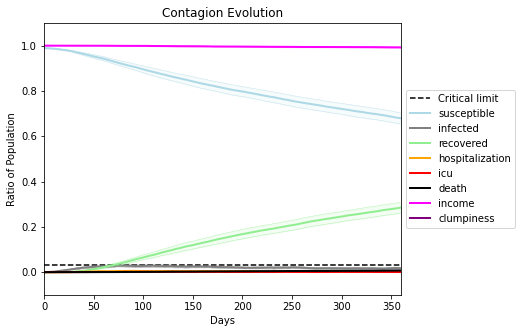

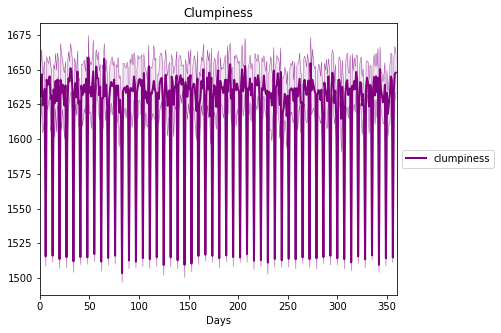

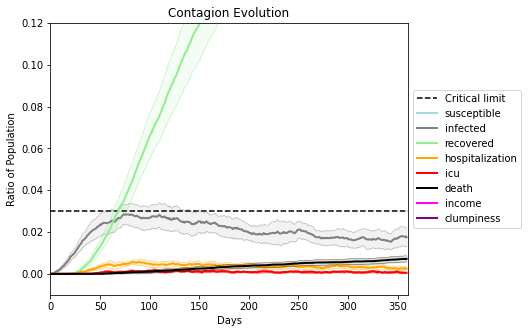

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5677, 6048, 9426, 5951, 2836, 7107, 1660, 4039, 298, 5118, 1270, 434, 787, 3760, 5208, 5749, 2235, 7239, 3917, 4553]
Average similarity between family members is 0.9728674008462593 at temperature -0.999
Average similarity between family and home is 0.9998508510964063 at temperature -1
Average similarity between students and their classroom is 0.9433701093599651 at temperature -0.999
Average classroom occupancy is 1.7243243243243243 and number classrooms is 185
Average similarity between workers is 0.9672653202019657 at temperature -0.999
Average office occupancy is 3.5280898876404496 and number offices is 178
Average friend similarity for adults: 0.8490137287787872 for kids: 0.7532382415819263
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.750351775457904
avg restaurant similarity 0.7243752291616592
avg restaurant similarity 0.7896916800966929
avg restaurant similarity 0.7910645928784633
avg restaurant similarity 0.861850165741195
avg restaurant similarity 0.2813150113925291
avg restaurant similarity 0.6697899658740782
avg restaurant similarity 0.861850165741195
avg restaurant similarity 0.6030562907548148
avg restaurant similarity 0.7243752291616592
avg restaurant similarity 0.5160564982200684
avg restaurant similarity 0.92993970936223
avg restaurant similarity 0.4587300739379916
avg restaurant similarity 0.8612946438183803
avg restaurant similarity 0.4614244328014453
avg restaurant similarity 0.6679981847226935
avg restaurant similarity 0.7199767183762927
avg restaurant similarity 0.9316127197947601
avg restaurant similarity 0.7192734970363328
avg restaurant similarity 0.6907335606409495
avg restaurant similarity 0.5627527361595455
avg restaurant similarity 0.48752707133595363
avg restaurant

avg restaurant similarity 0.7730590128923363
avg restaurant similarity 0.7554126638369231
avg restaurant similarity 0.8205144258527322
avg restaurant similarity 0.9998435268883286
avg restaurant similarity 0.8039422152206569
avg restaurant similarity 0.6692190614106652
avg restaurant similarity 0.5409706511299621
avg restaurant similarity 0.7337854431128596
avg restaurant similarity 0.6434188785961729
avg restaurant similarity 0.6407901075419116
avg restaurant similarity 0.6684579428102304
avg restaurant similarity 0.6135820303611297
avg restaurant similarity 0.3422575478408112
Average similarity between family members is 0.9718709644791441 at temperature -0.999
Average similarity between family and home is 0.9998511765937264 at temperature -1
Average similarity between students and their classroom is 0.9543058888728495 at temperature -0.999
Average classroom occupancy is 1.6855345911949686 and number classrooms is 159
Average similarity between workers is 0.9756327628636929 at tempera

avg restaurant similarity 0.7212314729711092
avg restaurant similarity 0.5936403236424808
avg restaurant similarity 0.5888794950518037
avg restaurant similarity 0.7849894652924589
avg restaurant similarity 0.6424057821868367
avg restaurant similarity 0.7035362391349477
avg restaurant similarity 0.7123362498422233
avg restaurant similarity 0.6576120374917971
avg restaurant similarity 0.7184984542029409
avg restaurant similarity 0.34256531324267825
avg restaurant similarity 0.7046986615604355
avg restaurant similarity 0.7396162151328047
avg restaurant similarity 0.9995859753539131
avg restaurant similarity 0.8094357896251574
avg restaurant similarity 0.5956389202002472
avg restaurant similarity 0.4694562380508097
avg restaurant similarity 0.6782388293931191
avg restaurant similarity 0.4281982899746379
avg restaurant similarity 0.6564737271546952
avg restaurant similarity 0.9203628194312046
avg restaurant similarity 0.5003095243260667
avg restaurant similarity 0.6833296509569688
avg resta

avg restaurant similarity 0.999671199463553
avg restaurant similarity 0.926602227348805
avg restaurant similarity 0.5787598708802044
avg restaurant similarity 0.7943215019688762
avg restaurant similarity 0.8170719329008944
avg restaurant similarity 0.4638573154122169
avg restaurant similarity 0.6546659390795385
avg restaurant similarity 0.7862192267922473
avg restaurant similarity 0.7724215565903805
avg restaurant similarity 0.579736946744933
avg restaurant similarity 0.9259881380424537
avg restaurant similarity 0.5941897292119274
avg restaurant similarity 0.9998016177889424
avg restaurant similarity 0.6037675966538463
avg restaurant similarity 0.6349525515113934
avg restaurant similarity 0.4421533043500622
avg restaurant similarity 0.90147513146449
avg restaurant similarity 0.43631891343155765
avg restaurant similarity 0.44346709593244715
avg restaurant similarity 0.12441089389572163
avg restaurant similarity 0.9283819684602581
avg restaurant similarity 0.43828534456913304
avg restaur

avg restaurant similarity 0.716366872381216
avg restaurant similarity 0.5151166320039579
avg restaurant similarity 0.8205532556817896
avg restaurant similarity 0.8731442269431633
avg restaurant similarity 0.41807965396608204
avg restaurant similarity 0.999734928861463
avg restaurant similarity 0.382518116276539
avg restaurant similarity 0.7608433189078667
avg restaurant similarity 0.6165761048185592
avg restaurant similarity 0.9997706719567823
avg restaurant similarity 0.7857326346993132
avg restaurant similarity 0.41494084425658784
avg restaurant similarity 0.8325100134475045
avg restaurant similarity 0.7453411328491089
avg restaurant similarity 0.38365304609607453
avg restaurant similarity 0.8342967918891088
avg restaurant similarity 0.35020056181155984
avg restaurant similarity 0.41863058588417884
avg restaurant similarity 0.9475373852432853
avg restaurant similarity 0.6212174700185015
avg restaurant similarity 0.5413958829856046
avg restaurant similarity 0.6645724903167687
avg rest

avg restaurant similarity 0.5366697590408106
avg restaurant similarity 0.7489850524415861
avg restaurant similarity 0.7480650096302348
avg restaurant similarity 0.5500418592405741
avg restaurant similarity 0.3809347074126039
avg restaurant similarity 0.7039373490075049
avg restaurant similarity 0.6445678019649762
avg restaurant similarity 0.5765745965549898
avg restaurant similarity 0.5778323703150381
avg restaurant similarity 0.5635802188288741
avg restaurant similarity 0.5007384667252656
avg restaurant similarity 0.4774787948995256
avg restaurant similarity 0.7080538761409343
avg restaurant similarity 0.44366062308965376
avg restaurant similarity 0.5051342406119547
avg restaurant similarity 0.5254401818406771
avg restaurant similarity 0.36366673857827436
avg restaurant similarity 0.99961033773203
avg restaurant similarity 0.549670027558298
avg restaurant similarity 0.42367418808920676
avg restaurant similarity 0.6215440768114433
avg restaurant similarity 0.4770774083971486
avg restau

avg restaurant similarity 0.4504531941729853
avg restaurant similarity 0.6952382035747218
avg restaurant similarity 0.5232946604862121
avg restaurant similarity 0.37027611708594355
avg restaurant similarity 0.5612338439798328
avg restaurant similarity 0.9995495804667925
avg restaurant similarity 0.8282474540277468
avg restaurant similarity 0.6895514025194344
avg restaurant similarity 0.45278751102964065
avg restaurant similarity 0.4430803240080507
avg restaurant similarity 0.6182558901162295
avg restaurant similarity 0.4081225582116642
avg restaurant similarity 0.5468430875483227
avg restaurant similarity 0.6204013615369177
avg restaurant similarity 0.49545908787464066
avg restaurant similarity 0.8497343737104962
avg restaurant similarity 0.5003305885760285
avg restaurant similarity 0.421223327523138
avg restaurant similarity 0.5712878773752266
avg restaurant similarity 0.415843151013865
avg restaurant similarity 0.4580585763453948
avg restaurant similarity 0.8729609675872705
avg resta

avg restaurant similarity 0.6093407861417814
avg restaurant similarity 0.3729846335813566
avg restaurant similarity 0.6037287724206206
avg restaurant similarity 0.5737474558873314
avg restaurant similarity 0.6606990502863567
avg restaurant similarity 0.8004857222345496
avg restaurant similarity 0.5963440926342515
avg restaurant similarity 0.6475098107503807
avg restaurant similarity 0.5779183130970875
avg restaurant similarity 0.6184699558098886
avg restaurant similarity 0.3632509101101163
avg restaurant similarity 0.8336891897510533
avg restaurant similarity 0.7419930796847107
avg restaurant similarity 0.525072086094142
avg restaurant similarity 0.9995900074621789
avg restaurant similarity 0.9124719988246142
avg restaurant similarity 0.6074683925234627
avg restaurant similarity 0.5779183130970875
avg restaurant similarity 0.6606990502863567
avg restaurant similarity 0.8362937442400058
avg restaurant similarity 0.6954633449145874
avg restaurant similarity 0.6037287724206206
avg restaur

avg restaurant similarity 0.6437012043681382
avg restaurant similarity 0.6954217034614659
avg restaurant similarity 0.9997936626981571
avg restaurant similarity 0.5914794626527484
avg restaurant similarity 0.7892530424515287
avg restaurant similarity 0.4692233755289123
avg restaurant similarity 0.631387542510933
avg restaurant similarity 0.8926638287585679
avg restaurant similarity 0.8891469515906667
avg restaurant similarity 0.5384482251252117
avg restaurant similarity 0.9998400114648243
avg restaurant similarity 0.8185574944240503
avg restaurant similarity 0.999826987296732
avg restaurant similarity 0.7905384386588993
avg restaurant similarity 0.8926165507935474
avg restaurant similarity 0.6859571779827038
avg restaurant similarity 0.9998440355356211
avg restaurant similarity 0.6360853005189612
avg restaurant similarity 0.6028166207513518
avg restaurant similarity 0.7398366678974506
avg restaurant similarity 0.6045254691965223
avg restaurant similarity 0.6966759446771315
avg restaura

avg restaurant similarity 0.9998440355356211
avg restaurant similarity 0.8910612593410709
avg restaurant similarity 0.6408915729571336
avg restaurant similarity 0.9997500981111247
avg restaurant similarity 0.8655038920270139
avg restaurant similarity 0.5515821274160878
avg restaurant similarity 0.7780412970092816
avg restaurant similarity 0.5631713244229755
Average similarity between family members is 0.9706870127176894 at temperature -0.999
Average similarity between family and home is 0.9998512270420731 at temperature -1
Average similarity between students and their classroom is 0.9544700780480737 at temperature -0.999
Average classroom occupancy is 1.778443113772455 and number classrooms is 167
Average similarity between workers is 0.9665582741686073 at temperature -0.999
Average office occupancy is 3.5026737967914436 and number offices is 187
Average friend similarity for adults: 0.8679482778832724 for kids: 0.7459891416956468
home_districts
[
Home (0,0) district with 1 Buildings
H

avg restaurant similarity 0.7305215016841196
avg restaurant similarity 0.4058865072950509
avg restaurant similarity 0.34428928806628295
avg restaurant similarity 0.7716053065948855
avg restaurant similarity 0.3991720069524798
avg restaurant similarity 0.3465732742790255
avg restaurant similarity 0.7892563748365017
avg restaurant similarity 0.7898884334292
avg restaurant similarity 0.5253457342335844
avg restaurant similarity 0.7032898647682256
avg restaurant similarity 0.7049592523962785
avg restaurant similarity 0.7407502670918257
avg restaurant similarity 0.5077818581610833
avg restaurant similarity 0.6165134590490362
avg restaurant similarity 0.4287523905622915
avg restaurant similarity 0.7083977392515396
avg restaurant similarity 0.5208020600857025
avg restaurant similarity 0.6859428895564765
avg restaurant similarity 0.6780982709570453
avg restaurant similarity 0.47775565707795664
avg restaurant similarity 0.23335474681640567
avg restaurant similarity 0.40842288341614874
avg resta

avg restaurant similarity 0.671300361661328
avg restaurant similarity 0.523599934434273
avg restaurant similarity 0.41495784984043305
avg restaurant similarity 0.47171178202715075
avg restaurant similarity 0.41386568352239533
avg restaurant similarity 0.49610710045279727
avg restaurant similarity 0.4378712086985014
avg restaurant similarity 0.33325972295063455
avg restaurant similarity 0.5455571117202163
avg restaurant similarity 0.4589128292037929
avg restaurant similarity 0.43501179042916294
avg restaurant similarity 0.7577211647019468
avg restaurant similarity 0.5211403289877581
avg restaurant similarity 0.33325972295063455
avg restaurant similarity 0.7324399394831514
avg restaurant similarity 0.9993776572875432
avg restaurant similarity 0.6343997601878847
avg restaurant similarity 0.42997713617042105
avg restaurant similarity 0.856220916384981
avg restaurant similarity 0.5643487375611314
avg restaurant similarity 0.8103106055415292
avg restaurant similarity 0.5234811185740251
avg r

Average similarity between workers is 0.9547557138133583 at temperature -0.999
Average office occupancy is 3.758426966292135 and number offices is 178
Average friend similarity for adults: 0.8568342507309549 for kids: 0.7316202051808515
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.47129910931642793
avg restaurant similarity 0.44958859571394805
avg restaurant similarity 0.7480248035853571
avg restaurant similarity 0.42042373888401174
avg restaurant similarity 0.47639335809994177
avg restaurant similarity 0.6561176119407659
avg restaurant similarity 0.6939083531801858
avg restaurant similarity 0.47129910931642793
avg restaurant similarity 0.6257742504444619
avg restaurant similarity 0.48333720707125155
avg restaurant similarity 0.75674036625279
avg restaurant similarity 0.8491582197944674
avg restaurant similarity 0.7198572581308065
avg restaurant similarity 0.4879343016818119
avg restaurant similarity 0.8150030027575846
avg restaurant similarity 0.7769597467086862
avg restaurant similarity 0.8486162595861655
avg restaurant similarity 0.7378490121246201
avg restaurant similarity 0.6768692538355162
avg restaurant similarity 0.8955325806221254
avg restaurant similarity 0.7224045456955936
avg restaurant similarity 0.999685478249291
avg res

avg restaurant similarity 0.6996123477833612
avg restaurant similarity 0.2737222141901184
avg restaurant similarity 0.670404426980255
avg restaurant similarity 0.632708827362608
avg restaurant similarity 0.53012680172
avg restaurant similarity 0.7210722853149389
avg restaurant similarity 0.7222580165393595
avg restaurant similarity 0.45059821527147725
avg restaurant similarity 0.807331677288211
avg restaurant similarity 0.8609285192091221
avg restaurant similarity 0.7229290902929827
avg restaurant similarity 0.5067806997816345
avg restaurant similarity 0.9998789733334962
avg restaurant similarity 0.5205908709688609
avg restaurant similarity 0.4919828092393326
avg restaurant similarity 0.9996750095786608
avg restaurant similarity 0.7222580165393595
avg restaurant similarity 0.7605035741075109
avg restaurant similarity 0.8337806573772891
avg restaurant similarity 0.7202930070755564
avg restaurant similarity 0.7385933061360785
Average similarity between family members is 0.970753597775793

avg restaurant similarity 0.637610843791613
avg restaurant similarity 0.4561282508720005
avg restaurant similarity 0.5418941153967295
avg restaurant similarity 0.6547113978721731
avg restaurant similarity 0.4087304597883803
avg restaurant similarity 0.4017211153082254
avg restaurant similarity 0.8177601503951759
avg restaurant similarity 0.9081343757015075
avg restaurant similarity 0.5352826232974245
avg restaurant similarity 0.7041998228391365
avg restaurant similarity 0.4622796243499345
avg restaurant similarity 0.926819973190937
avg restaurant similarity 0.6330708247208332
avg restaurant similarity 0.5368875347972734
avg restaurant similarity 0.36866806081694165
avg restaurant similarity 0.3149792846873114
avg restaurant similarity 0.4614281463194674
avg restaurant similarity 0.4558875718347239
avg restaurant similarity 0.5194718251038271
avg restaurant similarity 0.5265031458977212
avg restaurant similarity 0.4905020078416505
avg restaurant similarity 0.19104897204194587
avg restau

avg restaurant similarity 0.5787031379429045
avg restaurant similarity 0.46481557764482595
avg restaurant similarity 0.3568234112196428
avg restaurant similarity 0.36866806081694165
avg restaurant similarity 0.9071628006182793
avg restaurant similarity 0.5774912473367825
avg restaurant similarity 0.5523978353634665
avg restaurant similarity 0.5534257205298881
avg restaurant similarity 0.36684244645483566
avg restaurant similarity 0.6281957835435881
avg restaurant similarity 0.4604540099878285
Average similarity between family members is 0.9690395385102174 at temperature -0.999
Average similarity between family and home is 0.9998512609505459 at temperature -1
Average similarity between students and their classroom is 0.9576530679323262 at temperature -0.999
Average classroom occupancy is 1.7251461988304093 and number classrooms is 171
Average similarity between workers is 0.9654411365658404 at temperature -0.999
Average office occupancy is 3.647727272727273 and number offices is 176
Ave

avg restaurant similarity 0.5735307224219834
avg restaurant similarity 0.487180697382991
avg restaurant similarity 0.9385823882847905
avg restaurant similarity 0.892735531702061
avg restaurant similarity 0.8843336720959415
avg restaurant similarity 0.5447171086594498
avg restaurant similarity 0.6652594843542685
avg restaurant similarity 0.6785027844431728
avg restaurant similarity 0.2802607311175777
avg restaurant similarity 0.4787375997282748
avg restaurant similarity 0.7713025913733504
avg restaurant similarity 0.6014588820060878
avg restaurant similarity 0.5025939984357223
avg restaurant similarity 0.5268881432048473
avg restaurant similarity 0.7091216385929213
avg restaurant similarity 0.8177050706783151
avg restaurant similarity 0.8177050706783151
avg restaurant similarity 0.49548608500698377
avg restaurant similarity 0.7697323339397464
avg restaurant similarity 0.7548059143448598
avg restaurant similarity 0.9999094944298277
avg restaurant similarity 0.5268881432048473
avg restaur

avg restaurant similarity 0.7245249273209071
avg restaurant similarity 0.43095218771214544
avg restaurant similarity 0.8774400192389605
avg restaurant similarity 0.6692643938494603
avg restaurant similarity 0.6505141937967469
avg restaurant similarity 0.9446750112493396
avg restaurant similarity 0.5367280197808177
avg restaurant similarity 0.5779986211636666
avg restaurant similarity 0.7252347804210226
avg restaurant similarity 0.8265525648060628
avg restaurant similarity 0.684256316950014
avg restaurant similarity 0.8340135253399126
avg restaurant similarity 0.8162649033765089
avg restaurant similarity 0.26726312406395875
avg restaurant similarity 0.6039182327694396
avg restaurant similarity 0.9997476237241526
avg restaurant similarity 0.691015685925996
avg restaurant similarity 0.8355442599934553
avg restaurant similarity 0.8715446776087545
avg restaurant similarity 0.7252347804210226
avg restaurant similarity 0.5101334680257488
avg restaurant similarity 0.5798914624220508
avg restau

Average similarity between family and home is 0.9998595258781646 at temperature -1
Average similarity between students and their classroom is 0.9557278474424616 at temperature -0.999
Average classroom occupancy is 1.803680981595092 and number classrooms is 163
Average similarity between workers is 0.9639463885218682 at temperature -0.999
Average office occupancy is 3.486772486772487 and number offices is 189
Average friend similarity for adults: 0.8581081348683443 for kids: 0.7442787404624376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.5303572259277427
avg restaurant similarity 0.9182856982109938
avg restaurant similarity 0.5059004989265892
avg restaurant similarity 0.27851835793194446
avg restaurant similarity 0.4857320393840731
avg restaurant similarity 0.5118563384786333
avg restaurant similarity 0.7194142432669726
avg restaurant similarity 0.4306102408244571
avg restaurant similarity 0.9159756076250497
avg restaurant similarity 0.30090927312077825
avg restaurant similarity 0.5627959671252684
avg restaurant similarity 0.616981577156574
avg restaurant similarity 0.525290416270289
avg restaurant similarity 0.40636016479914927
avg restaurant similarity 0.6660572715625975
avg restaurant similarity 0.9147328783322451
avg restaurant similarity 0.5493386878350934
avg restaurant similarity 0.5743006332222913
avg restaurant similarity 0.5099642835236613
avg restaurant similarity 0.12798382573544595
avg restaurant similarity 0.786689563460278
avg restaurant similarity 0.5167523650978201
avg resta

avg restaurant similarity 0.4363096837620795
avg restaurant similarity 0.5823889886768205
avg restaurant similarity 0.9997099152027149
avg restaurant similarity 0.5784860496517947
avg restaurant similarity 0.30090927312077825
avg restaurant similarity 0.6456906350780796
avg restaurant similarity 0.4766522584860887
avg restaurant similarity 0.7633025628622654
avg restaurant similarity 0.5392158254405027
avg restaurant similarity 0.8483976217891944
avg restaurant similarity 0.8662389971672037
avg restaurant similarity 0.6215764180979407
avg restaurant similarity 0.48518435845996666
avg restaurant similarity 0.750123348467438
avg restaurant similarity 0.4186501152119586
avg restaurant similarity 0.8846869164333349
avg restaurant similarity 0.6059069998207647
avg restaurant similarity 0.5966444938629151
avg restaurant similarity 0.517916703206802
avg restaurant similarity 0.5075486178908787
avg restaurant similarity 0.45115480186610435
avg restaurant similarity 0.8951611755220428
avg resta

avg restaurant similarity 0.711734553630789
avg restaurant similarity 0.9998161203150844
avg restaurant similarity 0.7701176757084469
avg restaurant similarity 0.6532579879422924
avg restaurant similarity 0.6532800553321121
avg restaurant similarity 0.7347349573555453
avg restaurant similarity 0.2613301041797949
avg restaurant similarity 0.9997243603920871
avg restaurant similarity 0.8715551434099458
avg restaurant similarity 0.6520574573445748
avg restaurant similarity 0.9999592414907672
avg restaurant similarity 0.6508346837237514
avg restaurant similarity 0.7291120450525362
avg restaurant similarity 0.8614718579765585
avg restaurant similarity 0.6578231576386205
avg restaurant similarity 0.8158034151036264
avg restaurant similarity 0.9999027941003727
avg restaurant similarity 0.43978245193564547
avg restaurant similarity 0.687931221836112
avg restaurant similarity 0.9997734411130978
avg restaurant similarity 0.6089971176709655
avg restaurant similarity 0.42198270564076834
avg restau

avg restaurant similarity 0.7167797140385386
avg restaurant similarity 0.6899997531829092
avg restaurant similarity 0.46110986539907756
avg restaurant similarity 0.8447132987059135
avg restaurant similarity 0.5263796455733665
avg restaurant similarity 0.5507189679732473
avg restaurant similarity 0.7577524602156089
avg restaurant similarity 0.20445754373291933
avg restaurant similarity 0.6041775351666578
avg restaurant similarity 0.6628332624222094
avg restaurant similarity 0.7555295143840249
avg restaurant similarity 0.43721744092464665
avg restaurant similarity 0.45991045139716386
avg restaurant similarity 0.44223781300963155
avg restaurant similarity 0.7103107815876972
avg restaurant similarity 0.554684790819454
avg restaurant similarity 0.4515578272095675
avg restaurant similarity 0.6736646836890388
avg restaurant similarity 0.3363241421926958
avg restaurant similarity 0.7961546818694019
avg restaurant similarity 0.8640761378032846
avg restaurant similarity 0.6872036868865955
avg re

avg restaurant similarity 0.7830243579334678
avg restaurant similarity 0.6065013991806643
avg restaurant similarity 0.44230486141646863
avg restaurant similarity 0.6046033772845294
avg restaurant similarity 0.8860758355443801
avg restaurant similarity 0.6483459103688095
avg restaurant similarity 0.9351287504157357
avg restaurant similarity 0.7085810744450346
avg restaurant similarity 0.9998622220691679
avg restaurant similarity 0.7426472676576827
avg restaurant similarity 0.4806073685564953
avg restaurant similarity 0.3784448673337916
avg restaurant similarity 0.5960865760543539
avg restaurant similarity 0.7835701148239511
avg restaurant similarity 0.8219398081834908
avg restaurant similarity 0.9294821967937867
avg restaurant similarity 0.6450912652000481
avg restaurant similarity 0.713435663809453
avg restaurant similarity 0.4542410290634564
avg restaurant similarity 0.6270647436958017
avg restaurant similarity 0.827882837302456
avg restaurant similarity 0.442683501921612
avg restaura

avg restaurant similarity 0.8365429098750805
avg restaurant similarity 0.6469926331006031
avg restaurant similarity 0.6198199472530195
avg restaurant similarity 0.7743094976964402
avg restaurant similarity 0.6169400988416254
avg restaurant similarity 0.7212443340345387
avg restaurant similarity 0.5940910913743315
avg restaurant similarity 0.622077005824789
avg restaurant similarity 0.3679486083355919
avg restaurant similarity 0.7165211872319014
avg restaurant similarity 0.5850565075631807
avg restaurant similarity 0.7444731107669347
avg restaurant similarity 0.7735614066289664
avg restaurant similarity 0.4460799897803657
avg restaurant similarity 0.8860758355443801
avg restaurant similarity 0.9998957109913009
avg restaurant similarity 0.6017719228080782
avg restaurant similarity 0.5667381516513159
avg restaurant similarity 0.4686580508967602
avg restaurant similarity 0.4349428894340747
avg restaurant similarity 0.7181829615435165
avg restaurant similarity 0.7143159768774954
avg restaur

avg restaurant similarity 0.8317899831234941
avg restaurant similarity 0.6343775725110093
avg restaurant similarity 0.6922001868611765
avg restaurant similarity 0.5798152593473607
avg restaurant similarity 0.3625261784205271
avg restaurant similarity 0.5015325514166202
avg restaurant similarity 0.4346926183329855
avg restaurant similarity 0.4572368892210471
avg restaurant similarity 0.5482475004053154
avg restaurant similarity 0.4895614875942627
avg restaurant similarity 0.9037399739597987
avg restaurant similarity 0.5770986051321982
avg restaurant similarity 0.3679839889673433
avg restaurant similarity 0.5571221036962369
avg restaurant similarity 0.7311544450321794
avg restaurant similarity 0.8951656732014208
avg restaurant similarity 0.4751063592364765
avg restaurant similarity 0.884479898359944
avg restaurant similarity 0.8758999631383363
avg restaurant similarity 0.5170582717320458
avg restaurant similarity 0.4924312429458767
avg restaurant similarity 0.9997450270686716
avg restaur

avg restaurant similarity 0.9996538435670121
avg restaurant similarity 0.9998477094118836
avg restaurant similarity 0.6913020350408579
avg restaurant similarity 0.7497974494003827
avg restaurant similarity 0.5423017503284491
avg restaurant similarity 0.9336633663666787
avg restaurant similarity 0.9993446036609517
avg restaurant similarity 0.5504208509623
avg restaurant similarity 0.9034194917069913
avg restaurant similarity 0.894168574915255
avg restaurant similarity 0.8844680618553149
avg restaurant similarity 0.9996766181588896
avg restaurant similarity 0.6330871578485633
avg restaurant similarity 0.9995753181886299
avg restaurant similarity 0.9031901929558435
avg restaurant similarity 0.5150049327067221
avg restaurant similarity 0.5672974103965637
avg restaurant similarity 0.5482021124763843
avg restaurant similarity 0.5359190904779922
avg restaurant similarity 0.5783500941290336
avg restaurant similarity 0.373818755660962
avg restaurant similarity 0.7870830356533183
avg restaurant 

avg restaurant similarity 0.6698739969708644
avg restaurant similarity 0.9997631789538841
avg restaurant similarity 0.9998740868482691
avg restaurant similarity 0.6136202924200702
avg restaurant similarity 0.6627393514150333
avg restaurant similarity 0.9213770000761211
avg restaurant similarity 0.4966102260261963
avg restaurant similarity 0.49751758132729174
avg restaurant similarity 0.9996205913703164
avg restaurant similarity 0.5603287032675005
avg restaurant similarity 0.4789984410485436
avg restaurant similarity 0.4551181378781668
avg restaurant similarity 0.5749573481046922
avg restaurant similarity 0.5952179246794145
avg restaurant similarity 0.43557425662507343
avg restaurant similarity 0.676917002205005
avg restaurant similarity 0.7173734945848559
avg restaurant similarity 0.5141802839672259
avg restaurant similarity 0.4966102260261963
avg restaurant similarity 0.612198537721155
avg restaurant similarity 0.497590146042865
avg restaurant similarity 0.513014441981396
avg restaura

Average friend similarity for adults: 0.8588316165042692 for kids: 0.7258802961050747
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.14569825548495546
avg restaurant similarity 0.3803476415015612
avg restaurant similarity 0.14569825548495546
avg restaurant similarity 0.48427033961563104
avg restaurant similarity 0.49944041445430953
avg restaurant similarity 0.5056683323898034
avg restaurant similarity 0.6498340544947393
avg restaurant similarity 0.46009840479177
avg restaurant similarity 0.43553119970943865
avg restaurant similarity 0.49944041445430953
avg restaurant similarity 0.70590272354184
avg restaurant similarity 0.584517766096109
avg restaurant similarity 0.7483835760079092
avg restaurant similarity 0.9993817022225443
avg restaurant similarity 0.5901722912271553
avg restaurant similarity 0.30276728412113446
avg restaurant similarity 0.49850881888888543
avg restaurant similarity 0.40251292924490567
avg restaurant similarity 0.999521434605822
avg restaurant similarity 0.7445146369623998
avg restaurant similarity 0.9055460148756871
avg restaurant similarity 0.6001098629664372
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

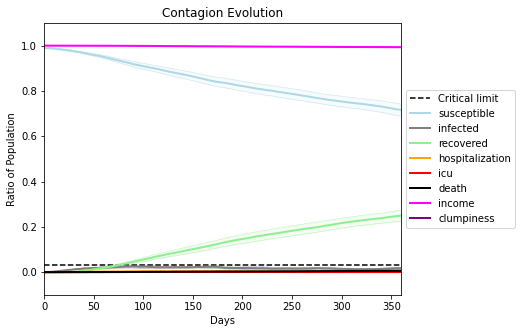

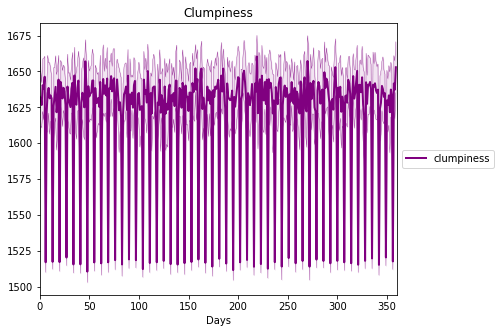

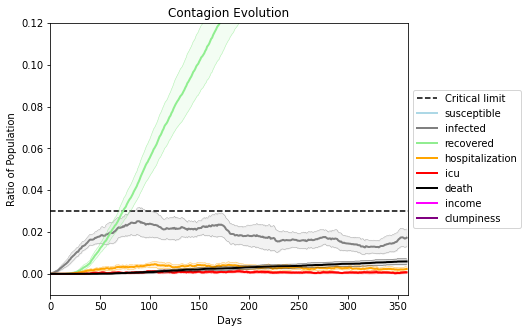

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3562, 4324, 3641, 5845, 5219, 875, 4535, 4262, 3022, 5823, 2604, 8778, 6450, 5704, 1943, 5253, 5578, 6188, 8977, 1527]
Average similarity between family members is 0.9686893439277676 at temperature -0.998
Average similarity between family and home is 0.9998508615973477 at temperature -1
Average similarity between students and their classroom is 0.9538856425679763 at temperature -0.998
Average classroom occupancy is 1.8092105263157894 and number classrooms is 152
Average similarity between workers is 0.9681678547694558 at temperature -0.998
Average office occupancy is 3.6432432432432433 and number offices is 185
Average friend similarity for adults: 0.86782444627603 for kids: 0.7381500245254895
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5694110594067069
avg restaurant similarity 0.6479802771028226
avg restaurant similarity 0.7924910738070496
avg restaurant similarity 0.7733132044667743
avg restaurant similarity 0.7692443555073989
avg restaurant similarity 0.7966887764062852
avg restaurant similarity 0.8635547804842042
avg restaurant similarity 0.5851714774992103
avg restaurant similarity 0.7709207958237305
avg restaurant similarity 0.5272593174061548
avg restaurant similarity 0.6992777990077071
avg restaurant similarity 0.6794021938822394
avg restaurant similarity 0.6752219073880636
avg restaurant similarity 0.5703494770771967
avg restaurant similarity 0.6510311701606614
avg restaurant similarity 0.7274127261521293
avg restaurant similarity 0.6761916856780247
avg restaurant similarity 0.7608717580313524
avg restaurant similarity 0.20678238201596372
avg restaurant similarity 0.7936424360872478
avg restaurant similarity 0.5882933270170216
avg restaurant similarity 0.5456871632610738
avg resta

Average friend similarity for adults: 0.8610228384367767 for kids: 0.7378698386748572
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.5861820160205115
avg restaurant similarity 0.8615668952875164
avg restaurant similarity 0.7850993974341969
avg restaurant similarity 0.7344675073467327
avg restaurant similarity 0.542388377283422
avg restaurant similarity 0.7586196236596918
avg restaurant similarity 0.584651314390963
avg restaurant similarity 0.44767817239917185
avg restaurant similarity 0.5884844605398218
avg restaurant similarity 0.5153645217375624
avg restaurant similarity 0.5861820160205115
avg restaurant similarity 0.5105250610782307
avg restaurant similarity 0.7852242471904408
avg restaurant similarity 0.491459060593573
avg restaurant similarity 0.4915831515429391
avg restaurant similarity 0.5530910880130184
avg restaurant similarity 0.9998169164534563
avg restaurant similarity 0.687718332852807
avg restaurant similarity 0.3985940403358374
avg restaurant similarity 0.6610755802058828
avg restaurant similarity 0.5152881773645652
avg restaurant similarity 0.5152881773645652
avg restauran

avg restaurant similarity 0.6022117245665897
avg restaurant similarity 0.6529825759417502
avg restaurant similarity 0.5564088416256523
avg restaurant similarity 0.8582512211013362
avg restaurant similarity 0.6333732121956394
avg restaurant similarity 0.5953215066560076
avg restaurant similarity 0.48912287054505404
avg restaurant similarity 0.5640439072279293
avg restaurant similarity 0.7819348394377268
avg restaurant similarity 0.7065264702832378
avg restaurant similarity 0.8921572462072926
avg restaurant similarity 0.43571007461738775
avg restaurant similarity 0.60197585663942
avg restaurant similarity 0.4762044175112572
avg restaurant similarity 0.5807059836427609
avg restaurant similarity 0.9290603576701288
avg restaurant similarity 0.44146694261520614
avg restaurant similarity 0.6015177038984211
avg restaurant similarity 0.60197585663942
avg restaurant similarity 0.8446675608851871
avg restaurant similarity 0.7182232008468001
avg restaurant similarity 0.6015177038984211
avg restaur

avg restaurant similarity 0.8275616523295295
avg restaurant similarity 0.6308412421693043
avg restaurant similarity 0.5615658876526239
avg restaurant similarity 0.7819348394377268
avg restaurant similarity 0.6015177038984211
avg restaurant similarity 0.8550437382696727
avg restaurant similarity 0.719655766668002
avg restaurant similarity 0.8512417334825086
avg restaurant similarity 0.5501177469168368
avg restaurant similarity 0.47378099493246795
avg restaurant similarity 0.9295538644861314
avg restaurant similarity 0.5957611252822901
avg restaurant similarity 0.6567360532896069
avg restaurant similarity 0.5840244204860269
avg restaurant similarity 0.6297231709457012
avg restaurant similarity 0.6029572809937496
avg restaurant similarity 0.6209971527565146
Average similarity between family members is 0.9634206043074623 at temperature -0.998
Average similarity between family and home is 0.9998496784830282 at temperature -1
Average similarity between students and their classroom is 0.95429

avg restaurant similarity 0.4687230873562611
avg restaurant similarity 0.8046830650162823
avg restaurant similarity 0.5260630921527468
avg restaurant similarity 0.7422145681343283
avg restaurant similarity 0.7519613714377722
avg restaurant similarity 0.5699953462086682
avg restaurant similarity 0.7474605601142561
avg restaurant similarity 0.8612723467242328
avg restaurant similarity 0.6250736598755513
avg restaurant similarity 0.6331591845685025
avg restaurant similarity 0.7528787924889209
avg restaurant similarity 0.8852998407415329
avg restaurant similarity 0.4491135882634133
avg restaurant similarity 0.5294252772461039
avg restaurant similarity 0.9998039330180055
avg restaurant similarity 0.4780788756325456
avg restaurant similarity 0.5638604402706027
avg restaurant similarity 0.8961189888570872
avg restaurant similarity 0.6272419695086701
avg restaurant similarity 0.9339337564123298
avg restaurant similarity 0.6828609997023287
avg restaurant similarity 0.7492493852361568
avg restau

avg restaurant similarity 0.61669738300327
avg restaurant similarity 0.4450538049183016
avg restaurant similarity 0.8624730074743647
avg restaurant similarity 0.6989499827276924
avg restaurant similarity 0.6365415200707993
avg restaurant similarity 0.9994032990051201
avg restaurant similarity 0.5232194274118518
avg restaurant similarity 0.7144932818564774
avg restaurant similarity 0.34344539991382067
avg restaurant similarity 0.47680200269279005
avg restaurant similarity 0.6137906285379291
avg restaurant similarity 0.6219060899143831
avg restaurant similarity 0.9998783420757673
avg restaurant similarity 0.7482643708349874
avg restaurant similarity 0.6231657761224988
avg restaurant similarity 0.35766345436716984
avg restaurant similarity 0.867193969856618
avg restaurant similarity 0.5907506297917761
avg restaurant similarity 0.6083901375486134
avg restaurant similarity 0.41311564458257316
avg restaurant similarity 0.8127943675362426
avg restaurant similarity 0.6493633483376458
avg resta

avg restaurant similarity 0.6429136078335138
avg restaurant similarity 0.8183641660459626
avg restaurant similarity 0.7282237551540824
avg restaurant similarity 0.8703935141264204
avg restaurant similarity 0.6596910061351172
avg restaurant similarity 0.6258180134058834
avg restaurant similarity 0.9998260531637296
avg restaurant similarity 0.6194883776769005
avg restaurant similarity 0.6745751289759622
avg restaurant similarity 0.4700606843212291
avg restaurant similarity 0.49481530980971256
avg restaurant similarity 0.5745902589196695
avg restaurant similarity 0.6115937647355425
avg restaurant similarity 0.51357082571106
avg restaurant similarity 0.4653167753766376
avg restaurant similarity 0.6282756694784134
avg restaurant similarity 0.7443992758331501
avg restaurant similarity 0.8996272255065946
avg restaurant similarity 0.8646015705012416
avg restaurant similarity 0.4643793890658525
avg restaurant similarity 0.5799616412388254
avg restaurant similarity 0.157924253529546
avg restaura

avg restaurant similarity 0.7011796960407171
avg restaurant similarity 0.5074421168760035
avg restaurant similarity 0.8972190703117138
avg restaurant similarity 0.6084561479295206
avg restaurant similarity 0.7408092488516108
avg restaurant similarity 0.7561097844720898
avg restaurant similarity 0.6438660566218631
avg restaurant similarity 0.6811378932389363
avg restaurant similarity 0.5372555363862228
avg restaurant similarity 0.9015626442227389
avg restaurant similarity 0.835222321781553
avg restaurant similarity 0.8399473282795896
avg restaurant similarity 0.5362573517233259
avg restaurant similarity 0.54485612746377
avg restaurant similarity 0.6949063060200529
avg restaurant similarity 0.5902519829070543
avg restaurant similarity 0.6849840429807488
avg restaurant similarity 0.7848605643134104
avg restaurant similarity 0.5872688511620701
avg restaurant similarity 0.8977160504499637
avg restaurant similarity 0.8356482898121528
avg restaurant similarity 0.6066786062260545
avg restauran

avg restaurant similarity 0.9018213453522996
avg restaurant similarity 0.6809582437482505
avg restaurant similarity 0.6647934435510869
avg restaurant similarity 0.8001442534023687
avg restaurant similarity 0.8243970576449117
avg restaurant similarity 0.6825509464519623
avg restaurant similarity 0.6775495475996764
avg restaurant similarity 0.4626828217038425
avg restaurant similarity 0.9015626442227389
avg restaurant similarity 0.9018213453522996
avg restaurant similarity 0.5429329427651143
avg restaurant similarity 0.6683650288689222
avg restaurant similarity 0.9208933881296839
avg restaurant similarity 0.9991021733120314
avg restaurant similarity 0.8068155149376162
avg restaurant similarity 0.5156729033292169
avg restaurant similarity 0.6745315960122494
avg restaurant similarity 0.8131998246774084
avg restaurant similarity 0.42704285111962303
avg restaurant similarity 0.7068558439634615
avg restaurant similarity 0.6718004668243389
avg restaurant similarity 0.7068664132492921
avg resta

avg restaurant similarity 0.3507340418635664
avg restaurant similarity 0.35341804366328944
avg restaurant similarity 0.5451161058968823
avg restaurant similarity 0.8227653197688752
avg restaurant similarity 0.5552864459557553
avg restaurant similarity 0.5496337952954005
avg restaurant similarity 0.20678715506734804
avg restaurant similarity 0.8153935323096622
avg restaurant similarity 0.6456820916985442
avg restaurant similarity 0.5143078529877062
avg restaurant similarity 0.9998120479890313
avg restaurant similarity 0.467826303946793
avg restaurant similarity 0.579907947334755
avg restaurant similarity 0.5623028005101135
avg restaurant similarity 0.8231641900027118
avg restaurant similarity 0.354049667063008
avg restaurant similarity 0.5749342360276822
avg restaurant similarity 0.7999195735562294
avg restaurant similarity 0.5474981127294944
avg restaurant similarity 0.5037628445151954
avg restaurant similarity 0.46341621316724
avg restaurant similarity 0.5305210810598834
avg restauran

avg restaurant similarity 0.6740207242422452
avg restaurant similarity 0.8329496988356999
avg restaurant similarity 0.8886197298250363
avg restaurant similarity 0.633984037432773
avg restaurant similarity 0.8603955074646848
avg restaurant similarity 0.8831630615335815
avg restaurant similarity 0.541754631085136
avg restaurant similarity 0.37921183038214046
avg restaurant similarity 0.6333844792310462
avg restaurant similarity 0.6138909157797307
avg restaurant similarity 0.8834041391962464
avg restaurant similarity 0.6164758897301369
avg restaurant similarity 0.834719776286083
avg restaurant similarity 0.630566641289232
avg restaurant similarity 0.3110427071545857
avg restaurant similarity 0.3144136993790275
avg restaurant similarity 0.6690308700022936
avg restaurant similarity 0.6288250576767673
avg restaurant similarity 0.5447161396786406
avg restaurant similarity 0.834719776286083
avg restaurant similarity 0.6246725198005028
avg restaurant similarity 0.834719776286083
avg restaurant 

avg restaurant similarity 0.5418250901464154
avg restaurant similarity 0.5901642582714892
avg restaurant similarity 0.18788989810461068
avg restaurant similarity 0.6920602006272499
Average similarity between family members is 0.9725272460964083 at temperature -0.998
Average similarity between family and home is 0.999856705941641 at temperature -1
Average similarity between students and their classroom is 0.9570564166973263 at temperature -0.998
Average classroom occupancy is 1.81437125748503 and number classrooms is 167
Average similarity between workers is 0.9426503218224532 at temperature -0.998
Average office occupancy is 3.540983606557377 and number offices is 183
Average friend similarity for adults: 0.8582397575283466 for kids: 0.7449956375056377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.7713372191691303
avg restaurant similarity 0.8263346780448239
avg restaurant similarity 0.48214456532966554
avg restaurant similarity 0.43958333061829197
avg restaurant similarity 0.6254345684638789
avg restaurant similarity 0.9999457891639996
avg restaurant similarity 0.7958218727014954
avg restaurant similarity 0.4128463834953517
avg restaurant similarity 0.49271443835654327
avg restaurant similarity 0.4762340933643243
avg restaurant similarity 0.9999145102750937
avg restaurant similarity 0.6546702685093605
avg restaurant similarity 0.7958218727014954
avg restaurant similarity 0.9319774722285237
avg restaurant similarity 0.7536244813993228
avg restaurant similarity 0.5383684900184218
avg restaurant similarity 0.5591653368280373
avg restaurant similarity 0.8727296845550734
avg restaurant similarity 0.5497264659577061
avg restaurant similarity 0.5687097582944196
avg restaurant similarity 0.5498370297280823
avg restaurant similarity 0.605964051878989
avg rest

avg restaurant similarity 0.5444620640640672
avg restaurant similarity 0.8124466989126825
avg restaurant similarity 0.5966302503258697
avg restaurant similarity 0.8121719181813614
avg restaurant similarity 0.6349632455976282
avg restaurant similarity 0.9997025681923182
avg restaurant similarity 0.9994433617872872
avg restaurant similarity 0.5664209508878978
avg restaurant similarity 0.7793191459043006
avg restaurant similarity 0.7050472424185609
avg restaurant similarity 0.6077601327635537
avg restaurant similarity 0.478660982379396
avg restaurant similarity 0.7423200593615564
avg restaurant similarity 0.8943493755911427
avg restaurant similarity 0.5827118617031701
avg restaurant similarity 0.6349632455976282
avg restaurant similarity 0.43999467349110466
avg restaurant similarity 0.4800363061079067
avg restaurant similarity 0.7053706115109626
avg restaurant similarity 0.9996744691480174
avg restaurant similarity 0.4633265254021741
avg restaurant similarity 0.9994433617872872
avg restau

avg restaurant similarity 0.999717110075996
avg restaurant similarity 0.4388105146466563
avg restaurant similarity 0.8961510034343698
avg restaurant similarity 0.8046848956846969
avg restaurant similarity 0.4429685126354357
avg restaurant similarity 0.9997149521453158
avg restaurant similarity 0.37656286718657306
avg restaurant similarity 0.6482432097274123
avg restaurant similarity 0.9241808884393965
avg restaurant similarity 0.5255838285919089
avg restaurant similarity 0.27072751519319566
avg restaurant similarity 0.2682068935628652
avg restaurant similarity 0.8562878935158789
avg restaurant similarity 0.4662764455236811
avg restaurant similarity 0.27418022558498345
avg restaurant similarity 0.9997025681923182
avg restaurant similarity 0.6116092919762859
avg restaurant similarity 0.45936530308348766
avg restaurant similarity 0.4807533324380928
avg restaurant similarity 0.7621775651251156
avg restaurant similarity 0.7141946344535623
avg restaurant similarity 0.5034719134021903
avg res

avg restaurant similarity 0.5752880676574541
avg restaurant similarity 0.9998809381595055
avg restaurant similarity 0.8383708111279216
avg restaurant similarity 0.7664968917701461
avg restaurant similarity 0.9207452928017907
avg restaurant similarity 0.48609014977277304
avg restaurant similarity 0.7140714402505977
avg restaurant similarity 0.4362235266629543
avg restaurant similarity 0.5965317952493765
avg restaurant similarity 0.9999197667066004
avg restaurant similarity 0.9998762600549456
avg restaurant similarity 0.756609443109106
avg restaurant similarity 0.9998921150675977
avg restaurant similarity 0.2490623461342925
avg restaurant similarity 0.6682764754975622
avg restaurant similarity 0.49321189029128193
avg restaurant similarity 0.6839374595014404
avg restaurant similarity 0.6363152557739836
avg restaurant similarity 0.8415575856308737
avg restaurant similarity 0.5181696997642047
avg restaurant similarity 0.5979696070010467
avg restaurant similarity 0.43107292591709356
avg rest

avg restaurant similarity 0.5724800516973976
avg restaurant similarity 0.6498903480602711
avg restaurant similarity 0.7102497141208567
avg restaurant similarity 0.7683034168450189
avg restaurant similarity 0.4058784380114273
avg restaurant similarity 0.6659593063740158
avg restaurant similarity 0.5096581581428941
avg restaurant similarity 0.8334209469536391
avg restaurant similarity 0.3846337753953143
avg restaurant similarity 0.9989485827707985
avg restaurant similarity 0.6275809452176704
avg restaurant similarity 0.9998050675173455
avg restaurant similarity 0.839439799553718
avg restaurant similarity 0.7658704888385349
avg restaurant similarity 0.5316424165144762
avg restaurant similarity 0.5096581581428941
avg restaurant similarity 0.6527718060947147
avg restaurant similarity 0.5240462533805594
avg restaurant similarity 0.6302722993872751
avg restaurant similarity 0.7232629263459232
avg restaurant similarity 0.5924394334913057
avg restaurant similarity 0.8289145916339158
avg restaur

avg restaurant similarity 0.9990634171417061
avg restaurant similarity 0.930258666168331
avg restaurant similarity 0.6092075682172279
avg restaurant similarity 0.5368917715800174
avg restaurant similarity 0.6510607272975721
avg restaurant similarity 0.8968436250873075
avg restaurant similarity 0.9160612593703401
avg restaurant similarity 0.7663017953509639
avg restaurant similarity 0.5105978214425883
avg restaurant similarity 0.7288756425429656
avg restaurant similarity 0.8697191434753228
avg restaurant similarity 0.5924394334913057
avg restaurant similarity 0.6185971620814177
avg restaurant similarity 0.6872078164673027
avg restaurant similarity 0.6659924548296163
avg restaurant similarity 0.4821565580798681
avg restaurant similarity 0.6174508186030184
avg restaurant similarity 0.5076985470388086
avg restaurant similarity 0.635146817946895
avg restaurant similarity 0.6584002837030867
avg restaurant similarity 0.7407840335555245
avg restaurant similarity 0.4460558115612804
avg restaura

avg restaurant similarity 0.7269271353621495
avg restaurant similarity 0.7366325980096885
avg restaurant similarity 0.6177337676629449
avg restaurant similarity 0.7905448229886787
avg restaurant similarity 0.6318864903691588
avg restaurant similarity 0.601948935395044
avg restaurant similarity 0.6369755033325001
avg restaurant similarity 0.6217676255197471
avg restaurant similarity 0.6277359302550477
avg restaurant similarity 0.6608818808580201
avg restaurant similarity 0.8251206085845153
avg restaurant similarity 0.6393826093471254
avg restaurant similarity 0.6506170551680693
avg restaurant similarity 0.4594203828955356
avg restaurant similarity 0.8230666662001562
avg restaurant similarity 0.7277738567195604
avg restaurant similarity 0.5928114325026648
avg restaurant similarity 0.8254915936434812
avg restaurant similarity 0.6724864013792862
avg restaurant similarity 0.9997782429668415
avg restaurant similarity 0.6372390949282705
avg restaurant similarity 0.41596307629636536
avg restau

Average similarity between workers is 0.9651097890648699 at temperature -0.998
Average office occupancy is 3.5248618784530388 and number offices is 181
Average friend similarity for adults: 0.8494330367809612 for kids: 0.7363179021541107
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.9395459615890466
avg restaurant similarity 0.7249618958136066
avg restaurant similarity 0.6135127737766698
avg restaurant similarity 0.9998816660911383
avg restaurant similarity 0.6392470570044078
avg restaurant similarity 0.7425977160638677
avg restaurant similarity 0.8591540177036202
avg restaurant similarity 0.2973478501846197
avg restaurant similarity 0.3224426507440836
avg restaurant similarity 0.6769302309022275
avg restaurant similarity 0.8160151386919363
avg restaurant similarity 0.42825868781091603
avg restaurant similarity 0.631806932549268
avg restaurant similarity 0.707529683681825
avg restaurant similarity 0.9997726847609578
avg restaurant similarity 0.7369073102598419
avg restaurant similarity 0.8015554013676744
avg restaurant similarity 0.8613501387480036
avg restaurant similarity 0.9240481248735221
avg restaurant similarity 0.47864820253850454
avg restaurant similarity 0.7793082984905912
avg restaurant similarity 0.6766273940404128
avg restau

Average similarity between workers is 0.9785394611981076 at temperature -0.998
Average office occupancy is 3.543010752688172 and number offices is 186
Average friend similarity for adults: 0.8548337606689416 for kids: 0.732615905287826
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.2941747092297468
avg restaurant similarity 0.6085743764415088
avg restaurant similarity 0.6242800809846507
avg restaurant similarity 0.5043204384800468
avg restaurant similarity 0.6727203008612691
avg restaurant similarity 0.30084950427125406
avg restaurant similarity 0.7770278367260779
avg restaurant similarity 0.8119737209865656
avg restaurant similarity 0.6228491739364179
avg restaurant similarity 0.4801170529047156
avg restaurant similarity 0.8972149465073899
avg restaurant similarity 0.6395675195403636
avg restaurant similarity 0.7803531511999617
avg restaurant similarity 0.6336108206137296
avg restaurant similarity 0.7738619448084593
avg restaurant similarity 0.3670350808892544
avg restaurant similarity 0.7062142265411638
avg restaurant similarity 0.7850876908453693
avg restaurant similarity 0.6137368587025411
avg restaurant similarity 0.7527750813915538
avg restaurant similarity 0.8574779021234529
avg restaurant similarity 0.6836636467282223
avg resta

avg restaurant similarity 0.2898075103192637
avg restaurant similarity 0.2929170641986315
avg restaurant similarity 0.7944498349843461
avg restaurant similarity 0.6297625662449988
avg restaurant similarity 0.8488820479733541
avg restaurant similarity 0.4422666250125452
avg restaurant similarity 0.4422666250125452
avg restaurant similarity 0.33191406025508685
avg restaurant similarity 0.555446977478441
avg restaurant similarity 0.9997789743315719
avg restaurant similarity 0.7686799196166737
avg restaurant similarity 0.43032628700619435
avg restaurant similarity 0.999805145401435
avg restaurant similarity 0.6963988662904319
avg restaurant similarity 0.6977086344736916
avg restaurant similarity 0.7879964232457268
avg restaurant similarity 0.5685047621074453
avg restaurant similarity 0.45199129929589615
avg restaurant similarity 0.4574707921981628
avg restaurant similarity 0.5616026029375603
avg restaurant similarity 0.43032628700619435
avg restaurant similarity 0.7273132875455254
avg rest

avg restaurant similarity 0.9997561837634372
avg restaurant similarity 0.7851364668068155
avg restaurant similarity 0.5834668166044348
avg restaurant similarity 0.29911867251747
avg restaurant similarity 0.7974624081246294
avg restaurant similarity 0.9998157768402027
avg restaurant similarity 0.6767397920963139
avg restaurant similarity 0.7755899262705521
avg restaurant similarity 0.6305165246727666
avg restaurant similarity 0.6487459887421384
avg restaurant similarity 0.9994760049170459
avg restaurant similarity 0.39567142715561426
avg restaurant similarity 0.5833453211035367
avg restaurant similarity 0.4667501806172849
avg restaurant similarity 0.6755487564386417
avg restaurant similarity 0.7043473477030996
avg restaurant similarity 0.9069777716229654
avg restaurant similarity 0.2628488088557397
avg restaurant similarity 0.27179088519635103
avg restaurant similarity 0.4051599306954583
avg restaurant similarity 0.4194099674626304
avg restaurant similarity 0.3987879398915117
avg restau

avg restaurant similarity 0.869344248841452
avg restaurant similarity 0.7295457071488642
avg restaurant similarity 0.757981378513052
avg restaurant similarity 0.7300506882799838
avg restaurant similarity 0.46186264020599244
avg restaurant similarity 0.6808454000327131
avg restaurant similarity 0.9995442356006096
avg restaurant similarity 0.8243381708041869
avg restaurant similarity 0.622360215757987
avg restaurant similarity 0.6462003622188714
avg restaurant similarity 0.9995726308583885
avg restaurant similarity 0.5460573660028052
avg restaurant similarity 0.7617377955844202
avg restaurant similarity 0.47005784973461096
avg restaurant similarity 0.9996410695996691
avg restaurant similarity 0.5445033011169076
avg restaurant similarity 0.8112419826590456
avg restaurant similarity 0.5576041325567165
avg restaurant similarity 0.42571805728960493
avg restaurant similarity 0.9035728837822128
avg restaurant similarity 0.7557980130382491
avg restaurant similarity 0.6516829451245503
avg restau

avg restaurant similarity 0.559281839240664
avg restaurant similarity 0.9121802075096244
avg restaurant similarity 0.6570974150379568
avg restaurant similarity 0.5544960739252112
avg restaurant similarity 0.4988450263515292
avg restaurant similarity 0.5583088563964511
avg restaurant similarity 0.38834395790208137
avg restaurant similarity 0.5530291100635683
avg restaurant similarity 0.42949341643871447
avg restaurant similarity 0.7780267847765595
avg restaurant similarity 0.5693687984247324
avg restaurant similarity 0.8912592204032028
avg restaurant similarity 0.999726704671117
avg restaurant similarity 0.907809152244224
avg restaurant similarity 0.6068132384159985
avg restaurant similarity 0.559281839240664
avg restaurant similarity 0.8145497006707323
avg restaurant similarity 0.5544960739252112
avg restaurant similarity 0.3482606219338763
avg restaurant similarity 0.61010651254116
avg restaurant similarity 0.6102682560948582
avg restaurant similarity 0.7594183470927236
avg restaurant

avg restaurant similarity 0.7591478862660297
avg restaurant similarity 0.42845206380887996
avg restaurant similarity 0.6316356181638527
avg restaurant similarity 0.5656890157086283
avg restaurant similarity 0.8682704071728318
avg restaurant similarity 0.8220894694063269
avg restaurant similarity 0.8212767915438173
avg restaurant similarity 0.2310059965221888
avg restaurant similarity 0.8220894694063269
avg restaurant similarity 0.49699458244343
avg restaurant similarity 0.7824296094444996
avg restaurant similarity 0.8220894694063269
avg restaurant similarity 0.6363792381335163
avg restaurant similarity 0.8759712110882911
avg restaurant similarity 0.733866835040314
avg restaurant similarity 0.7504796960493333
avg restaurant similarity 0.813972033543052
avg restaurant similarity 0.5682138632560876
avg restaurant similarity 0.5251843545347399
avg restaurant similarity 0.7372494171291255
avg restaurant similarity 0.6457120434809311
avg restaurant similarity 0.8345368047198765
avg restauran

avg restaurant similarity 0.6771590817793223
avg restaurant similarity 0.814504194888426
avg restaurant similarity 0.8228193454827657
avg restaurant similarity 0.4867996058341349
avg restaurant similarity 0.9108340629793865
avg restaurant similarity 0.9081087612527674
avg restaurant similarity 0.8608138032922151
avg restaurant similarity 0.7314586106987631
avg restaurant similarity 0.9158957164439199
avg restaurant similarity 0.5165746388984769
avg restaurant similarity 0.4030832544377607
avg restaurant similarity 0.6155386898916453
avg restaurant similarity 0.8207630621230928
avg restaurant similarity 0.7675868439685938
avg restaurant similarity 0.6479449657047958
avg restaurant similarity 0.69565309074671
avg restaurant similarity 0.4904404001074305
avg restaurant similarity 0.6844567135063638
avg restaurant similarity 0.4904404001074305
avg restaurant similarity 0.681863275517738
avg restaurant similarity 0.9108340629793865
avg restaurant similarity 0.8660633659786532
avg restaurant

avg restaurant similarity 0.7903765268189065
avg restaurant similarity 0.7979443262968338
avg restaurant similarity 0.46179142859966965
avg restaurant similarity 0.7021720872768132
avg restaurant similarity 0.5223842256168205
avg restaurant similarity 0.5806698743940863
avg restaurant similarity 0.7556987876772643
avg restaurant similarity 0.12426373568719654
avg restaurant similarity 0.4790211960869088
avg restaurant similarity 0.6800143162786794
avg restaurant similarity 0.37939854305196224
avg restaurant similarity 0.9996177879396446
avg restaurant similarity 0.9997506038198891
avg restaurant similarity 0.5016666908417561
avg restaurant similarity 0.6459405329116081
avg restaurant similarity 0.6690111856404484
avg restaurant similarity 0.7172158359996625
avg restaurant similarity 0.61707926764036
avg restaurant similarity 0.9996177879396446
avg restaurant similarity 0.405266440278955
avg restaurant similarity 0.46139796353208007
avg restaurant similarity 0.38409895182947285
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

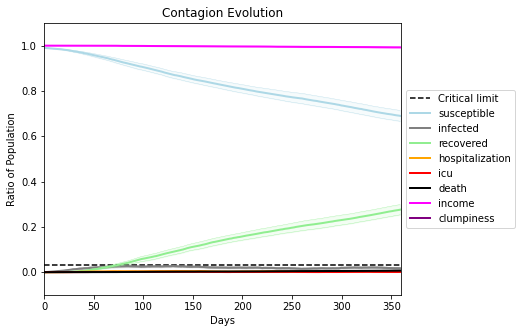

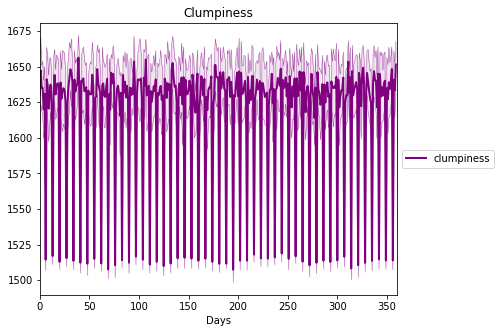

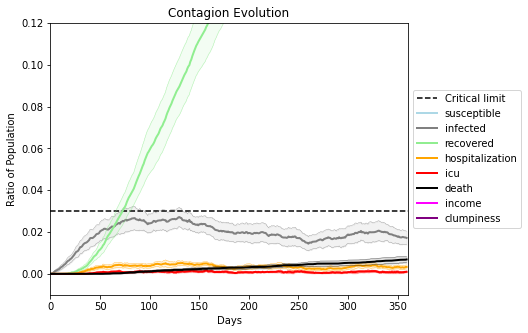

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7028, 9197, 1280, 1213, 6928, 9523, 510, 1895, 6351, 7672, 1861, 7132, 7893, 2401, 3504, 6268, 8004, 6452, 7978, 5711]
Average similarity between family members is 0.9584562143544072 at temperature -0.9975
Average similarity between family and home is 0.9998635047105038 at temperature -1
Average similarity between students and their classroom is 0.9289259555006669 at temperature -0.9975
Average classroom occupancy is 1.6395348837209303 and number classrooms is 172
Average similarity between workers is 0.9315325066383847 at temperature -0.9975
Average office occupancy is 3.560846560846561 and number offices is 189
Average friend similarity for adults: 0.8586278193912867 for kids: 0.7296547716324189
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.7559792236557751
avg restaurant similarity 0.6162085242308165
avg restaurant similarity 0.6939988112473279
avg restaurant similarity 0.6414114978501048
avg restaurant similarity 0.4975988394751396
avg restaurant similarity 0.9995008497072784
avg restaurant similarity 0.6954307835795852
avg restaurant similarity 0.9996821571010913
avg restaurant similarity 0.5511092351152278
avg restaurant similarity 0.5983769916478325
avg restaurant similarity 0.835906322682935
avg restaurant similarity 0.8183093977107525
avg restaurant similarity 0.465032631005592
avg restaurant similarity 0.6347621240977465
avg restaurant similarity 0.7549179654232803
avg restaurant similarity 0.5415825569610946
avg restaurant similarity 0.4574691216518072
avg restaurant similarity 0.39500001409829694
avg restaurant similarity 0.849313116798275
avg restaurant similarity 0.518486782757315
avg restaurant similarity 0.6074556582076852
avg restaurant similarity 0.5930563194695853
avg restauran

avg restaurant similarity 0.4922186331347349
avg restaurant similarity 0.6824085583612881
avg restaurant similarity 0.6939988112473279
avg restaurant similarity 0.5892142701359666
avg restaurant similarity 0.5069789589621063
avg restaurant similarity 0.5449633756540935
avg restaurant similarity 0.6073219250131918
avg restaurant similarity 0.6544488023011718
avg restaurant similarity 0.5810577046471685
avg restaurant similarity 0.5324066705841679
avg restaurant similarity 0.32480606214068697
avg restaurant similarity 0.5647042769579669
avg restaurant similarity 0.6632959460144643
avg restaurant similarity 0.8309135793848862
avg restaurant similarity 0.8443613356187558
avg restaurant similarity 0.7882950030818215
avg restaurant similarity 0.5084991590628125
avg restaurant similarity 0.4686178504655718
avg restaurant similarity 0.8442283028528724
avg restaurant similarity 0.549071268666947
avg restaurant similarity 0.7751969863083851
avg restaurant similarity 0.5060618768391554
avg restau

avg restaurant similarity 0.5039645108668437
avg restaurant similarity 0.4163856329749501
avg restaurant similarity 0.517525267001657
avg restaurant similarity 0.4917555747918275
avg restaurant similarity 0.6574482466505349
avg restaurant similarity 0.8482418059004098
avg restaurant similarity 0.7280530596423594
avg restaurant similarity 0.5215000202124467
avg restaurant similarity 0.4843743374215196
avg restaurant similarity 0.6921874764196271
avg restaurant similarity 0.6687431877900775
avg restaurant similarity 0.51655459255801
avg restaurant similarity 0.39876316941769013
avg restaurant similarity 0.5723511929999944
avg restaurant similarity 0.41536376200676184
avg restaurant similarity 0.4531142512602852
avg restaurant similarity 0.3083634315204476
avg restaurant similarity 0.4388338138833548
avg restaurant similarity 0.5557202884298866
avg restaurant similarity 0.5185449333724161
avg restaurant similarity 0.12415682989860355
avg restaurant similarity 0.5706537591600342
avg restau

avg restaurant similarity 0.36915897625444916
avg restaurant similarity 0.4310861263964907
avg restaurant similarity 0.692558224361602
avg restaurant similarity 0.3939053881409044
avg restaurant similarity 0.4139762134992125
avg restaurant similarity 0.8915622820988867
avg restaurant similarity 0.4762778554324201
avg restaurant similarity 0.4660673576088042
avg restaurant similarity 0.8565140975653783
avg restaurant similarity 0.3815847671357209
avg restaurant similarity 0.47983540679701897
avg restaurant similarity 0.6631181724392203
avg restaurant similarity 0.2760125193982184
avg restaurant similarity 0.48442256229901837
avg restaurant similarity 0.9997552960355809
avg restaurant similarity 0.4408627344078902
Average similarity between family members is 0.9537740390920988 at temperature -0.9975
Average similarity between family and home is 0.9998150408210035 at temperature -1
Average similarity between students and their classroom is 0.904650528591653 at temperature -0.9975
Average 

avg restaurant similarity 0.588008432427224
avg restaurant similarity 0.6240824367319453
avg restaurant similarity 0.5256453524741085
avg restaurant similarity 0.24963665670769075
avg restaurant similarity 0.6579224684793736
avg restaurant similarity 0.5245800876379902
avg restaurant similarity 0.43965486269517035
avg restaurant similarity 0.412085785993844
avg restaurant similarity 0.8162451911130661
avg restaurant similarity 0.5549077694711184
avg restaurant similarity 0.35042812448794386
avg restaurant similarity 0.6681204831113512
avg restaurant similarity 0.44781620133645383
avg restaurant similarity 0.3063453563633172
avg restaurant similarity 0.3931638689298641
avg restaurant similarity 0.5593999623734742
avg restaurant similarity 0.5079590407867968
avg restaurant similarity 0.685653823571088
avg restaurant similarity 0.8420644662794377
avg restaurant similarity 0.3481517646833841
avg restaurant similarity 0.35042812448794386
avg restaurant similarity 0.6727054066294835
avg rest

avg restaurant similarity 0.6717350852255477
avg restaurant similarity 0.5244393726502421
avg restaurant similarity 0.6265264775296935
avg restaurant similarity 0.5627123495467582
avg restaurant similarity 0.5326406728296894
avg restaurant similarity 0.36919439496636675
avg restaurant similarity 0.7633744036381802
avg restaurant similarity 0.47459660466144554
avg restaurant similarity 0.5458491480680692
avg restaurant similarity 0.711912084828187
avg restaurant similarity 0.9997475203823762
avg restaurant similarity 0.47977440106938163
avg restaurant similarity 0.5440981691305651
avg restaurant similarity 0.40958345185922174
avg restaurant similarity 0.6458057474261124
avg restaurant similarity 0.47177260125708986
avg restaurant similarity 0.6413222810299706
avg restaurant similarity 0.8995175016251364
avg restaurant similarity 0.48782592361629024
avg restaurant similarity 0.5431735531989788
avg restaurant similarity 0.6696198920669482
avg restaurant similarity 0.7119047726511483
avg r

avg restaurant similarity 0.3527041345533011
avg restaurant similarity 0.8673996714776752
avg restaurant similarity 0.3073142676319001
avg restaurant similarity 0.5099877242328625
avg restaurant similarity 0.487791755575558
avg restaurant similarity 0.5080205579268714
avg restaurant similarity 0.4076463685585879
avg restaurant similarity 0.5760281485541034
avg restaurant similarity 0.43531610005845445
avg restaurant similarity 0.7347174765407053
avg restaurant similarity 0.6110143062120796
avg restaurant similarity 0.43381913984981857
avg restaurant similarity 0.16695990723134524
avg restaurant similarity 0.8624372337112589
avg restaurant similarity 0.3461724207108469
avg restaurant similarity 0.6055855060624513
avg restaurant similarity 0.404588863238721
avg restaurant similarity 0.650161309516817
avg restaurant similarity 0.877234578681957
avg restaurant similarity 0.6107418155128812
avg restaurant similarity 0.5371074053698603
avg restaurant similarity 0.5285791058419297
avg restaur

avg restaurant similarity 0.5820820490709747
avg restaurant similarity 0.2978142736745749
avg restaurant similarity 0.5875687968769957
avg restaurant similarity 0.5884304209292271
avg restaurant similarity 0.8388757195966368
avg restaurant similarity 0.49684001575397085
avg restaurant similarity 0.6300419698880103
avg restaurant similarity 0.9996140739016006
avg restaurant similarity 0.6051007501937999
avg restaurant similarity 0.8150354441735054
avg restaurant similarity 0.5961096877086299
avg restaurant similarity 0.5819261118582789
avg restaurant similarity 0.8908773270596253
avg restaurant similarity 0.4293275268789974
avg restaurant similarity 0.33652309441898703
avg restaurant similarity 0.657762906819344
avg restaurant similarity 0.48714437459078114
avg restaurant similarity 0.657762906819344
avg restaurant similarity 0.5587716487765204
avg restaurant similarity 0.4823586067651662
avg restaurant similarity 0.7400876536722604
avg restaurant similarity 0.8479902675016389
avg resta

Average similarity between family and home is 0.999845411802796 at temperature -1
Average similarity between students and their classroom is 0.9393611961612178 at temperature -0.9975
Average classroom occupancy is 1.7083333333333333 and number classrooms is 168
Average similarity between workers is 0.9232824159991311 at temperature -0.9975
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8519255634533776 for kids: 0.7206984840336712
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity fo

avg restaurant similarity 0.7024501569279451
avg restaurant similarity 0.509578907466126
avg restaurant similarity 0.8020454265654705
avg restaurant similarity 0.5402617059520858
avg restaurant similarity 0.8325172636877833
avg restaurant similarity 0.597851756203046
avg restaurant similarity 0.41840914943312074
avg restaurant similarity 0.7533799192677249
avg restaurant similarity 0.7210584076474827
avg restaurant similarity 0.6145315457154298
avg restaurant similarity 0.5821086584949926
avg restaurant similarity 0.8092363798260661
avg restaurant similarity 0.507848398155601
avg restaurant similarity 0.8941403703135244
avg restaurant similarity 0.9997248626265648
avg restaurant similarity 0.8206336726167199
avg restaurant similarity 0.6910721547421328
avg restaurant similarity 0.877239162288808
avg restaurant similarity 0.5911307158442007
avg restaurant similarity 0.7471425520372943
avg restaurant similarity 0.8088471086113667
avg restaurant similarity 0.7190407975472283
avg restauran

avg restaurant similarity 0.4837069262887715
avg restaurant similarity 0.7428793174514237
avg restaurant similarity 0.6666673073400508
avg restaurant similarity 0.5485290864322282
avg restaurant similarity 0.7349845320228567
avg restaurant similarity 0.2946388575745297
avg restaurant similarity 0.8020393336573146
avg restaurant similarity 0.6206363987206498
avg restaurant similarity 0.6024073660791786
avg restaurant similarity 0.6214928493129854
avg restaurant similarity 0.49097011927296774
avg restaurant similarity 0.8758231976233641
avg restaurant similarity 0.9997008156336877
avg restaurant similarity 0.8301542138213878
avg restaurant similarity 0.6240898453740198
avg restaurant similarity 0.7139165671040744
avg restaurant similarity 0.7517011148695607
avg restaurant similarity 0.9384792091714877
Average similarity between family members is 0.9612647036439224 at temperature -0.9975
Average similarity between family and home is 0.9998516811315903 at temperature -1
Average similarity 

avg restaurant similarity 0.9996955788876059
avg restaurant similarity 0.523280041421287
avg restaurant similarity 0.5825840167606925
avg restaurant similarity 0.338861647705544
avg restaurant similarity 0.35886319043773907
avg restaurant similarity 0.7132875761514362
avg restaurant similarity 0.4727528271609007
avg restaurant similarity 0.8380782955084042
avg restaurant similarity 0.4632946686923196
avg restaurant similarity 0.4885567839780265
avg restaurant similarity 0.606276430914136
avg restaurant similarity 0.7958797412915828
avg restaurant similarity 0.551043058832095
avg restaurant similarity 0.5649110496632185
avg restaurant similarity 0.47107848901163163
avg restaurant similarity 0.6139164065621092
avg restaurant similarity 0.5738693153792424
avg restaurant similarity 0.6197646124941874
avg restaurant similarity 0.8713534935446205
avg restaurant similarity 0.28158606448031426
avg restaurant similarity 0.6805720022073201
avg restaurant similarity 0.5919771180125557
avg restaur

avg restaurant similarity 0.6642911766822341
avg restaurant similarity 0.4416224639888877
avg restaurant similarity 0.6916237365253477
avg restaurant similarity 0.5869389523442756
avg restaurant similarity 0.6223541362918511
avg restaurant similarity 0.6427871392633673
avg restaurant similarity 0.638549585443476
avg restaurant similarity 0.7392883714456719
avg restaurant similarity 0.4871901752421798
avg restaurant similarity 0.7392349099996623
avg restaurant similarity 0.3119506370011713
avg restaurant similarity 0.7400192240446252
avg restaurant similarity 0.7146344647624495
avg restaurant similarity 0.6405190944511826
avg restaurant similarity 0.6142738654461403
avg restaurant similarity 0.7912545534513016
avg restaurant similarity 0.5745303311533476
avg restaurant similarity 0.8049509142959835
avg restaurant similarity 0.43242133455445714
avg restaurant similarity 0.5672315479213013
avg restaurant similarity 0.703486709337881
avg restaurant similarity 0.8506146233203542
avg restaur

avg restaurant similarity 0.8352387303248316
avg restaurant similarity 0.8000480756073488
avg restaurant similarity 0.5669766147201334
avg restaurant similarity 0.643231089674493
Average similarity between family members is 0.9546810117361032 at temperature -0.9975
Average similarity between family and home is 0.9998538286061684 at temperature -1
Average similarity between students and their classroom is 0.9327311779540699 at temperature -0.9975
Average classroom occupancy is 1.6745562130177514 and number classrooms is 169
Average similarity between workers is 0.9180033478963364 at temperature -0.9975
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8586384925338413 for kids: 0.7392279314306076
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.7121648351357002
avg restaurant similarity 0.9997039813481183
avg restaurant similarity 0.8249176433059214
avg restaurant similarity 0.7569372826423659
avg restaurant similarity 0.6846155807497507
avg restaurant similarity 0.7650143303537534
avg restaurant similarity 0.5352600350240921
avg restaurant similarity 0.8268924103476445
avg restaurant similarity 0.5491977725958481
avg restaurant similarity 0.9128331475749529
avg restaurant similarity 0.4507661429964611
avg restaurant similarity 0.3335687570449456
avg restaurant similarity 0.46531365787470347
avg restaurant similarity 0.7489154033647274
avg restaurant similarity 0.6092603185952099
avg restaurant similarity 0.6066528921196729
avg restaurant similarity 0.787547721695692
avg restaurant similarity 0.846684665790094
avg restaurant similarity 0.5460869064389354
avg restaurant similarity 0.7765807700586105
avg restaurant similarity 0.7823079003838336
avg restaurant similarity 0.6676688004449918
avg restaur

avg restaurant similarity 0.8359541570876421
avg restaurant similarity 0.4753845416802662
avg restaurant similarity 0.5289898578752128
avg restaurant similarity 0.659334204413838
avg restaurant similarity 0.4771334671732556
avg restaurant similarity 0.6924476875401061
avg restaurant similarity 0.5817167282904727
avg restaurant similarity 0.4663096091455927
avg restaurant similarity 0.49183808195115286
avg restaurant similarity 0.48437320771629777
avg restaurant similarity 0.5687631292356339
avg restaurant similarity 0.5340496348297389
avg restaurant similarity 0.3143791765401984
avg restaurant similarity 0.5839610520767324
avg restaurant similarity 0.5917171528967922
avg restaurant similarity 0.6311514079660977
avg restaurant similarity 0.5657501871360766
avg restaurant similarity 0.46370777979128497
avg restaurant similarity 0.9997787384415764
avg restaurant similarity 0.6513888148181893
avg restaurant similarity 0.4436508538381493
avg restaurant similarity 0.4596266439489376
avg rest

avg restaurant similarity 0.521944403444189
avg restaurant similarity 0.6495203727576294
avg restaurant similarity 0.5200986757144276
avg restaurant similarity 0.43543757426317314
avg restaurant similarity 0.45293573385918035
avg restaurant similarity 0.5434594680894269
avg restaurant similarity 0.6060152336811127
avg restaurant similarity 0.3904791069308432
avg restaurant similarity 0.9996971141010244
avg restaurant similarity 0.4521088480573221
avg restaurant similarity 0.7326276068181602
avg restaurant similarity 0.4222627524879069
avg restaurant similarity 0.7755939594174256
avg restaurant similarity 0.8153596718082863
avg restaurant similarity 0.5206544963098989
avg restaurant similarity 0.44599043783982384
avg restaurant similarity 0.9996335171605621
avg restaurant similarity 0.7534672458899407
avg restaurant similarity 0.6400425976649754
avg restaurant similarity 0.6444181476619257
avg restaurant similarity 0.4595267619113772
avg restaurant similarity 0.3331506273212383
avg rest

avg restaurant similarity 0.7699908146986079
avg restaurant similarity 0.6165009284722908
avg restaurant similarity 0.4570044672145404
avg restaurant similarity 0.3621569295383916
avg restaurant similarity 0.8320270274493196
avg restaurant similarity 0.5256400441094177
avg restaurant similarity 0.583732187574985
avg restaurant similarity 0.5820527744197732
avg restaurant similarity 0.5274103518914723
avg restaurant similarity 0.49684844471219286
avg restaurant similarity 0.6052161983416767
avg restaurant similarity 0.6082288886308622
avg restaurant similarity 0.5450478353016184
avg restaurant similarity 0.8320270274493196
avg restaurant similarity 0.5511855911043554
avg restaurant similarity 0.5177090730979814
avg restaurant similarity 0.5450478353016184
avg restaurant similarity 0.48363248243511436
avg restaurant similarity 0.42182818670500877
avg restaurant similarity 0.4668489701304693
avg restaurant similarity 0.8318505330257799
avg restaurant similarity 0.6392128507247705
avg rest

avg restaurant similarity 0.41359152973352087
avg restaurant similarity 0.8144954385902646
avg restaurant similarity 0.595811395404718
avg restaurant similarity 0.8341076363802654
avg restaurant similarity 0.6669771793476523
avg restaurant similarity 0.5402038602656272
avg restaurant similarity 0.639877703538536
avg restaurant similarity 0.28465029012720144
avg restaurant similarity 0.8468802252209167
avg restaurant similarity 0.5896183826691163
avg restaurant similarity 0.5799351295055565
avg restaurant similarity 0.6988550297028396
avg restaurant similarity 0.5186749918114026
avg restaurant similarity 0.9995236050968357
avg restaurant similarity 0.6748079152423623
avg restaurant similarity 0.6485123398416919
avg restaurant similarity 0.7287862839233759
avg restaurant similarity 0.6188659143973849
avg restaurant similarity 0.6496225417190681
avg restaurant similarity 0.9998486059844759
avg restaurant similarity 0.8484902226174496
avg restaurant similarity 0.8453382629976006
avg restau

avg restaurant similarity 0.8986200857080402
avg restaurant similarity 0.28502013851490443
avg restaurant similarity 0.656266614091696
avg restaurant similarity 0.33934856172581407
avg restaurant similarity 0.4808464977923255
avg restaurant similarity 0.19205691503851524
avg restaurant similarity 0.8511929720917006
avg restaurant similarity 0.9997058362180625
avg restaurant similarity 0.6974279333287977
avg restaurant similarity 0.5426250786123046
avg restaurant similarity 0.81959606049517
avg restaurant similarity 0.4882605114341117
avg restaurant similarity 0.8986200857080402
avg restaurant similarity 0.5714625912058804
avg restaurant similarity 0.7820742446562646
avg restaurant similarity 0.5167910044785959
avg restaurant similarity 0.9997979829997735
avg restaurant similarity 0.673754664061415
avg restaurant similarity 0.5246492377819137
avg restaurant similarity 0.8456795868158818
avg restaurant similarity 0.39839270114876024
avg restaurant similarity 0.8161463863020262
avg restau

avg restaurant similarity 0.9350713590161361
avg restaurant similarity 0.9997905974430346
avg restaurant similarity 0.6749869061819802
avg restaurant similarity 0.6107162635406282
avg restaurant similarity 0.9995319721244306
avg restaurant similarity 0.43396458546366407
avg restaurant similarity 0.48923552980673213
avg restaurant similarity 0.871797914571824
avg restaurant similarity 0.791802483591266
avg restaurant similarity 0.9997905974430346
avg restaurant similarity 0.8899912315524534
avg restaurant similarity 0.6953874257193616
avg restaurant similarity 0.3885425243274097
avg restaurant similarity 0.8104120747740813
avg restaurant similarity 0.895212454613278
avg restaurant similarity 0.7507428233629501
avg restaurant similarity 0.709389351260389
avg restaurant similarity 0.39134616519058046
avg restaurant similarity 0.8899623563693311
avg restaurant similarity 0.7752186602425294
avg restaurant similarity 0.999547367687134
avg restaurant similarity 0.3008886415653023
avg restaura

avg restaurant similarity 0.7291887917722215
avg restaurant similarity 0.4384723052902636
avg restaurant similarity 0.8748769403019792
avg restaurant similarity 0.5584145631529912
avg restaurant similarity 0.25952753856461086
avg restaurant similarity 0.46725911455782965
avg restaurant similarity 0.8064099394663025
avg restaurant similarity 0.35148904384106955
avg restaurant similarity 0.7984384780092075
avg restaurant similarity 0.7177168452006955
avg restaurant similarity 0.6870217932741043
avg restaurant similarity 0.5522607199354512
avg restaurant similarity 0.7385666715381438
avg restaurant similarity 0.6042196002655755
avg restaurant similarity 0.5548795321237776
avg restaurant similarity 0.6872628880638043
avg restaurant similarity 0.6103702816173393
avg restaurant similarity 0.9998988298238742
avg restaurant similarity 0.49231939830149896
avg restaurant similarity 0.7507409857187239
avg restaurant similarity 0.9998604654809113
avg restaurant similarity 0.8516658754208206
avg re

Average similarity between workers is 0.9297830461103777 at temperature -0.9975
Average office occupancy is 3.3763440860215055 and number offices is 186
Average friend similarity for adults: 0.8563464632673964 for kids: 0.7317374252944372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.4955505950920435
avg restaurant similarity 0.6697478792410596
avg restaurant similarity 0.7045664796184973
avg restaurant similarity 0.536310875013051
avg restaurant similarity 0.6811081562150696
avg restaurant similarity 0.689303387320344
avg restaurant similarity 0.4152108512945356
avg restaurant similarity 0.6465438913979067
avg restaurant similarity 0.6716637039397934
avg restaurant similarity 0.6939733940087356
avg restaurant similarity 0.7969198710382601
avg restaurant similarity 0.6852659198503044
avg restaurant similarity 0.5710807226510047
avg restaurant similarity 0.6118544560392603
avg restaurant similarity 0.31548363727915274
avg restaurant similarity 0.45227758998119233
avg restaurant similarity 0.7242354995484819
avg restaurant similarity 0.8970483851794601
avg restaurant similarity 0.9104134462437561
avg restaurant similarity 0.5918192580864976
avg restaurant similarity 0.9401246117289546
avg restaurant similarity 0.7265391726807177
avg restau

avg restaurant similarity 0.5258215763770697
avg restaurant similarity 0.32780895192755827
avg restaurant similarity 0.41264526762645476
avg restaurant similarity 0.46212054269361863
avg restaurant similarity 0.7915332863799356
avg restaurant similarity 0.558517193983814
avg restaurant similarity 0.9322542225818187
avg restaurant similarity 0.6015104281898093
avg restaurant similarity 0.7315967296355388
avg restaurant similarity 0.5338973354745001
avg restaurant similarity 0.8036854248138418
avg restaurant similarity 0.679416509826599
avg restaurant similarity 0.5365746584596385
avg restaurant similarity 0.4821955659550329
avg restaurant similarity 0.6233054875356353
avg restaurant similarity 0.390818776664529
avg restaurant similarity 0.6085523659002336
avg restaurant similarity 0.7923828648449026
avg restaurant similarity 0.544082908705868
avg restaurant similarity 0.5749126729784041
avg restaurant similarity 0.8401125984434654
avg restaurant similarity 0.999569134565248
avg restaura

avg restaurant similarity 0.558517193983814
avg restaurant similarity 0.5176728050505846
avg restaurant similarity 0.6751960331995329
avg restaurant similarity 0.6460430069291931
avg restaurant similarity 0.4131691713073046
avg restaurant similarity 0.6040803647203796
Average similarity between family members is 0.9635145815388335 at temperature -0.9975
Average similarity between family and home is 0.9998555030512742 at temperature -1
Average similarity between students and their classroom is 0.9304605686052453 at temperature -0.9975
Average classroom occupancy is 1.687116564417178 and number classrooms is 163
Average similarity between workers is 0.9402328535796974 at temperature -0.9975
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.8548718142983981 for kids: 0.7228834691049804
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 pe

avg restaurant similarity 0.5528190291660021
avg restaurant similarity 0.5578823531189421
avg restaurant similarity 0.6279550253507097
avg restaurant similarity 0.7118505472224403
avg restaurant similarity 0.8251394313504492
avg restaurant similarity 0.6942224452251071
avg restaurant similarity 0.626423464829015
avg restaurant similarity 0.608286700171146
avg restaurant similarity 0.5489217466216062
avg restaurant similarity 0.4511745596055967
avg restaurant similarity 0.48215724215844724
avg restaurant similarity 0.5812220651188909
avg restaurant similarity 0.6259670440338598
avg restaurant similarity 0.6145587097490781
avg restaurant similarity 0.7025167872228893
avg restaurant similarity 0.5661619664129481
avg restaurant similarity 0.7818034483908218
avg restaurant similarity 0.5615304150920888
avg restaurant similarity 0.6965937250952685
avg restaurant similarity 0.799821874245974
avg restaurant similarity 0.5535967609721519
avg restaurant similarity 0.9998662108288109
avg restaura

avg restaurant similarity 0.5786250795195684
avg restaurant similarity 0.46509517861759375
avg restaurant similarity 0.5809434023888875
avg restaurant similarity 0.5583181698828323
avg restaurant similarity 0.8636575065772372
avg restaurant similarity 0.5978996017908992
avg restaurant similarity 0.5449580552839419
avg restaurant similarity 0.8228899130826165
avg restaurant similarity 0.5615304150920888
avg restaurant similarity 0.6979552117436751
avg restaurant similarity 0.7750809664554741
avg restaurant similarity 0.6499817064297752
avg restaurant similarity 0.6562558846667597
avg restaurant similarity 0.7409627242394312
avg restaurant similarity 0.6107346038256455
avg restaurant similarity 0.40272482757396655
avg restaurant similarity 0.5235523519324043
avg restaurant similarity 0.7554802347706914
avg restaurant similarity 0.4168012454602784
avg restaurant similarity 0.6876082538710288
avg restaurant similarity 0.7949070898864787
avg restaurant similarity 0.5852226855296276
avg rest

avg restaurant similarity 0.8917523344288819
avg restaurant similarity 0.24191053656244974
avg restaurant similarity 0.6159445924167435
avg restaurant similarity 0.5278395426034179
avg restaurant similarity 0.8072696559129753
avg restaurant similarity 0.7235511681396208
avg restaurant similarity 0.7017371233127531
avg restaurant similarity 0.643933168849289
avg restaurant similarity 0.5125924098315346
avg restaurant similarity 0.5512025470074629
avg restaurant similarity 0.30729423185760424
avg restaurant similarity 0.6702569802592111
avg restaurant similarity 0.6765501922613888
avg restaurant similarity 0.591521282645004
avg restaurant similarity 0.6406291651193672
avg restaurant similarity 0.49406828107199624
avg restaurant similarity 0.5334925570609295
avg restaurant similarity 0.8395596924498774
avg restaurant similarity 0.6887196209724589
avg restaurant similarity 0.7334011418413104
avg restaurant similarity 0.37216676537948457
avg restaurant similarity 0.614079734747575
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

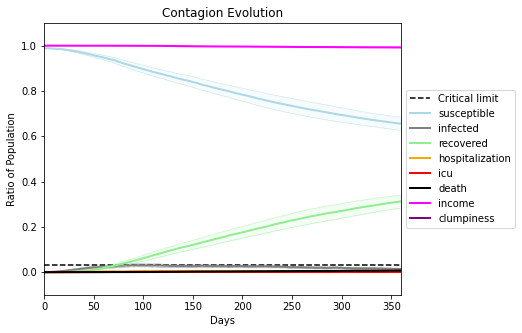

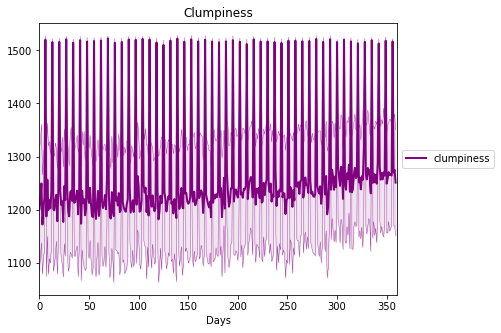

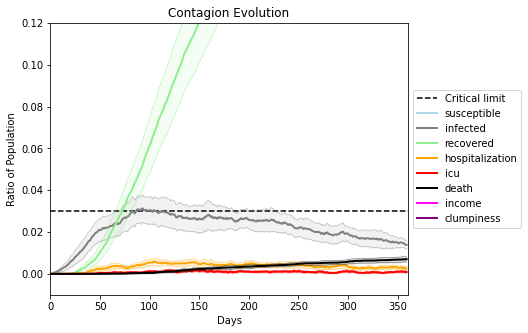

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[36, 7007, 5222, 1296, 6585, 4320, 7331, 6, 7886, 529, 7214, 9772, 9452, 6597, 9391, 165, 1268, 6344, 1385, 7387]
Average similarity between family members is 0.95621495664656 at temperature -0.997
Average similarity between family and home is 0.9998636050036083 at temperature -1
Average similarity between students and their classroom is 0.9141128472864447 at temperature -0.997
Average classroom occupancy is 1.761290322580645 and number classrooms is 155
Average similarity between workers is 0.9312016413585923 at temperature -0.997
Average office occupancy is 3.513089005235602 and number offices is 191
Average friend similarity for adults: 0.8486064707419506 for kids: 0.7339175151281243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.6540812434740316
avg restaurant similarity 0.5370889734496693
avg restaurant similarity 0.9999144334788808
avg restaurant similarity 0.527540812831252
avg restaurant similarity 0.3878001474019675
avg restaurant similarity 0.9999628836283301
avg restaurant similarity 0.815345840361779
avg restaurant similarity 0.5309369800249903
avg restaurant similarity 0.7652504368034112
avg restaurant similarity 0.31869264866096264
avg restaurant similarity 0.3740132507821233
avg restaurant similarity 0.813583638521987
avg restaurant similarity 0.6939861642074446
avg restaurant similarity 0.6630005654629446
avg restaurant similarity 0.5939711965949728
avg restaurant similarity 0.8119921066763232
avg restaurant similarity 0.6981528431518573
avg restaurant similarity 0.610009444773082
avg restaurant similarity 0.28193097877767764
avg restaurant similarity 0.3967815225451692
avg restaurant similarity 0.527540812831252
avg restaurant similarity 0.40262862922429693
avg restaura

avg restaurant similarity 0.5606519520432924
avg restaurant similarity 0.5820067110462444
avg restaurant similarity 0.7149351819252797
avg restaurant similarity 0.8406489471395667
avg restaurant similarity 0.37869129763350395
avg restaurant similarity 0.5411415779869837
avg restaurant similarity 0.37845423935870914
avg restaurant similarity 0.780527491366414
avg restaurant similarity 0.4823397074346262
avg restaurant similarity 0.47066853210430104
avg restaurant similarity 0.41373262970768265
avg restaurant similarity 0.6779214362767216
avg restaurant similarity 0.5954106923363941
avg restaurant similarity 0.9997628553765967
avg restaurant similarity 0.49408761864210127
avg restaurant similarity 0.8108607301622325
avg restaurant similarity 0.5460496888444142
avg restaurant similarity 0.4956910899474589
avg restaurant similarity 0.6191232774550465
avg restaurant similarity 0.68164714840316
avg restaurant similarity 0.8057182522243047
avg restaurant similarity 0.8667766104754497
avg rest

avg restaurant similarity 0.36427093251534826
avg restaurant similarity 0.5310154936756257
avg restaurant similarity 0.5382492583657058
avg restaurant similarity 0.6191914223749793
avg restaurant similarity 0.8232491567515294
avg restaurant similarity 0.535663506597536
avg restaurant similarity 0.6157101621080338
avg restaurant similarity 0.6836903376551917
avg restaurant similarity 0.44491521425708763
avg restaurant similarity 0.47602170947742983
avg restaurant similarity 0.5831315565704605
avg restaurant similarity 0.5776503504789383
avg restaurant similarity 0.43693737241408187
avg restaurant similarity 0.5776503504789383
avg restaurant similarity 0.5993395123185676
avg restaurant similarity 0.5872979256735575
avg restaurant similarity 0.6200415806270646
avg restaurant similarity 0.5374546934207232
avg restaurant similarity 0.7794294174497909
avg restaurant similarity 0.611621286171504
avg restaurant similarity 0.999711346715259
avg restaurant similarity 0.5447729022698746
avg resta

avg restaurant similarity 0.5701901078038838
avg restaurant similarity 0.43496962371768566
avg restaurant similarity 0.5293564122229013
avg restaurant similarity 0.5245976309349395
avg restaurant similarity 0.6274300466061009
avg restaurant similarity 0.385109608599161
avg restaurant similarity 0.686889103152462
avg restaurant similarity 0.8048933450846497
avg restaurant similarity 0.7367776033763331
avg restaurant similarity 0.5119560414797606
avg restaurant similarity 0.41575693953005977
avg restaurant similarity 0.8113065236148187
avg restaurant similarity 0.4502185730369965
avg restaurant similarity 0.8797877767335565
avg restaurant similarity 0.42020007396020753
avg restaurant similarity 0.5461626230198293
avg restaurant similarity 0.3464937126251128
avg restaurant similarity 0.3707119670225866
avg restaurant similarity 0.5006762057448307
avg restaurant similarity 0.7705969484335415
avg restaurant similarity 0.9998769905823248
avg restaurant similarity 0.6136061481625906
avg resta

avg restaurant similarity 0.4847692267680186
avg restaurant similarity 0.527641303439681
avg restaurant similarity 0.5666905870024055
avg restaurant similarity 0.5294422455835719
avg restaurant similarity 0.4572776887433829
avg restaurant similarity 0.599590775881616
avg restaurant similarity 0.4000064552743329
avg restaurant similarity 0.45241731526846213
avg restaurant similarity 0.7328971354311217
avg restaurant similarity 0.20427632689644895
avg restaurant similarity 0.9996032282834925
avg restaurant similarity 0.6324130721237131
avg restaurant similarity 0.8547567117940835
avg restaurant similarity 0.8547567117940835
avg restaurant similarity 0.9466290349662884
avg restaurant similarity 0.5526846764660368
avg restaurant similarity 0.7225624588339631
avg restaurant similarity 0.8658932724422272
avg restaurant similarity 0.8934315957087778
avg restaurant similarity 0.8365534570554235
avg restaurant similarity 0.42392267313576354
avg restaurant similarity 0.8436185636111565
avg resta

avg restaurant similarity 0.6118882831366718
avg restaurant similarity 0.7387901150941033
avg restaurant similarity 0.8589751744382078
avg restaurant similarity 0.4000064552743329
avg restaurant similarity 0.7387901150941033
avg restaurant similarity 0.5536103593780262
avg restaurant similarity 0.6816930231126567
avg restaurant similarity 0.768090821452734
avg restaurant similarity 0.20427632689644895
avg restaurant similarity 0.3564565113963656
avg restaurant similarity 0.5241117394006597
avg restaurant similarity 0.9997537228669746
avg restaurant similarity 0.5840828806058986
avg restaurant similarity 0.35084608373313875
avg restaurant similarity 0.5456728036934474
avg restaurant similarity 0.552455437620773
avg restaurant similarity 0.4822768075873959
avg restaurant similarity 0.5743267804811963
avg restaurant similarity 0.6145566551942533
avg restaurant similarity 0.20831048017148832
avg restaurant similarity 0.49253410482952786
avg restaurant similarity 0.4155720629764387
Average 

avg restaurant similarity 0.6017286443129046
avg restaurant similarity 0.45613976223940295
avg restaurant similarity 0.6680817094933054
avg restaurant similarity 0.32029116835031995
avg restaurant similarity 0.7145444915755406
avg restaurant similarity 0.6979819441354159
avg restaurant similarity 0.9994725076502843
avg restaurant similarity 0.37642352780023125
avg restaurant similarity 0.8817782246860382
avg restaurant similarity 0.7079738403710086
avg restaurant similarity 0.5758046602779294
avg restaurant similarity 0.7994002488647892
avg restaurant similarity 0.33583801569579663
avg restaurant similarity 0.8574825956196884
avg restaurant similarity 0.9994725076502843
avg restaurant similarity 0.5752960066174113
avg restaurant similarity 0.7502710185190499
avg restaurant similarity 0.9997895563590369
avg restaurant similarity 0.3591599878991494
avg restaurant similarity 0.8176149819070708
avg restaurant similarity 0.3573723611193804
avg restaurant similarity 0.7389820550768605
avg re

avg restaurant similarity 0.5428461029259093
avg restaurant similarity 0.6300241498587529
avg restaurant similarity 0.9997508688252174
avg restaurant similarity 0.5254413197417653
avg restaurant similarity 0.4931428225472193
avg restaurant similarity 0.3567325821245365
avg restaurant similarity 0.642745207154184
avg restaurant similarity 0.8087005972749333
avg restaurant similarity 0.6170148690968191
avg restaurant similarity 0.4889793632309444
avg restaurant similarity 0.3789987682011014
avg restaurant similarity 0.4481661358242062
avg restaurant similarity 0.9997179968466087
avg restaurant similarity 0.5843547872998671
avg restaurant similarity 0.6656490114717395
avg restaurant similarity 0.49670767781364467
avg restaurant similarity 0.46385356066082917
avg restaurant similarity 0.5255528786029622
avg restaurant similarity 0.8132428271267664
avg restaurant similarity 0.8041982560782024
avg restaurant similarity 0.519493144526801
avg restaurant similarity 0.4773755612044507
avg restau

avg restaurant similarity 0.41960578782790847
avg restaurant similarity 0.704789800413054
avg restaurant similarity 0.4506544569558856
avg restaurant similarity 0.6889660499879802
avg restaurant similarity 0.9996916381354426
avg restaurant similarity 0.5409298377670089
avg restaurant similarity 0.7152587094398098
avg restaurant similarity 0.8460968080554951
avg restaurant similarity 0.5887803431629463
avg restaurant similarity 0.6706678862019342
avg restaurant similarity 0.7372748249580329
avg restaurant similarity 0.3326588419002981
avg restaurant similarity 0.5384937477548286
avg restaurant similarity 0.5218758835228551
avg restaurant similarity 0.6489135723103097
avg restaurant similarity 0.6862651941711782
avg restaurant similarity 0.5609171142649994
avg restaurant similarity 0.5463178253652592
avg restaurant similarity 0.5758464608740839
avg restaurant similarity 0.7094691671140783
avg restaurant similarity 0.6144481776695014
avg restaurant similarity 0.5314566900934176
avg restau

avg restaurant similarity 0.9998866926115648
avg restaurant similarity 0.5174768282158685
avg restaurant similarity 0.6386237196451163
avg restaurant similarity 0.3094167330340134
avg restaurant similarity 0.5761406422938774
avg restaurant similarity 0.7490616757785118
avg restaurant similarity 0.5072394207603355
avg restaurant similarity 0.533951914658494
avg restaurant similarity 0.5436641440939979
avg restaurant similarity 0.4426714835975932
avg restaurant similarity 0.4406215533952489
avg restaurant similarity 0.3452546890607581
avg restaurant similarity 0.9998233072827707
avg restaurant similarity 0.4441950468771426
avg restaurant similarity 0.7424251098355059
avg restaurant similarity 0.3744159408252279
avg restaurant similarity 0.7865178187655484
avg restaurant similarity 0.45747536888465534
avg restaurant similarity 0.7581858133387946
avg restaurant similarity 0.7726994708479258
avg restaurant similarity 0.47148005550269967
avg restaurant similarity 0.3412171750919897
avg resta

avg restaurant similarity 0.41109243501229203
Average similarity between family members is 0.9559984761878206 at temperature -0.997
Average similarity between family and home is 0.9998604065747031 at temperature -1
Average similarity between students and their classroom is 0.9185354092537452 at temperature -0.997
Average classroom occupancy is 1.764367816091954 and number classrooms is 174
Average similarity between workers is 0.9391920176959272 at temperature -0.997
Average office occupancy is 3.2142857142857144 and number offices is 196
Average friend similarity for adults: 0.8443418446715906 for kids: 0.7444088800258954
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.41438101933685567
avg restaurant similarity 0.5542220425033236
avg restaurant similarity 0.4648268871214447
avg restaurant similarity 0.4879944709618449
avg restaurant similarity 0.5158031394514171
avg restaurant similarity 0.6101153452691523
avg restaurant similarity 0.6318122440311731
avg restaurant similarity 0.9997733829642648
avg restaurant similarity 0.5871000159925104
avg restaurant similarity 0.36130992951997953
avg restaurant similarity 0.2109371836479998
avg restaurant similarity 0.681280671726606
avg restaurant similarity 0.4983193823109866
avg restaurant similarity 0.533068821787254
avg restaurant similarity 0.9997393802795491
avg restaurant similarity 0.40756113088591384
avg restaurant similarity 0.8375217194838736
avg restaurant similarity 0.4328645760900167
avg restaurant similarity 0.41809860730051307
avg restaurant similarity 0.5290476881917121
avg restaurant similarity 0.4299193604488587
avg restaurant similarity 0.6110288107803004
avg rest

avg restaurant similarity 0.39454139619399764
avg restaurant similarity 0.999740745404772
avg restaurant similarity 0.6196200140892238
avg restaurant similarity 0.5932677896650943
avg restaurant similarity 0.670728204634128
avg restaurant similarity 0.3408015860252932
avg restaurant similarity 0.9998803700917577
avg restaurant similarity 0.8165156076046501
avg restaurant similarity 0.4449766079881843
avg restaurant similarity 0.9995902262454582
avg restaurant similarity 0.6891924321316163
avg restaurant similarity 0.49877847253967744
avg restaurant similarity 0.6095385144269916
avg restaurant similarity 0.23739685562445004
avg restaurant similarity 0.24185503285830717
avg restaurant similarity 0.44379566478665383
avg restaurant similarity 0.23509536960908092
avg restaurant similarity 0.4441414073583261
avg restaurant similarity 0.6579352030698257
avg restaurant similarity 0.7613849554023817
avg restaurant similarity 0.9995902262454582
avg restaurant similarity 0.8548446069422704
avg re

avg restaurant similarity 0.5056068426721607
avg restaurant similarity 0.5368279058746511
avg restaurant similarity 0.5801830382647444
avg restaurant similarity 0.49732157811544286
avg restaurant similarity 0.6228481952147424
avg restaurant similarity 0.639622268997416
avg restaurant similarity 0.5555664441193893
avg restaurant similarity 0.5158973231832977
avg restaurant similarity 0.6309799178852513
avg restaurant similarity 0.7565036381130854
avg restaurant similarity 0.999855598124296
avg restaurant similarity 0.6420174997459529
avg restaurant similarity 0.2870118706817339
avg restaurant similarity 0.49928434971505664
avg restaurant similarity 0.8452306856448117
avg restaurant similarity 0.6449750363517854
avg restaurant similarity 0.7190880481307541
avg restaurant similarity 0.4430986976231414
avg restaurant similarity 0.6384766488952303
avg restaurant similarity 0.5555567122428471
avg restaurant similarity 0.5504019283556699
avg restaurant similarity 0.531797964040399
avg restaur

avg restaurant similarity 0.6116990702567586
avg restaurant similarity 0.7618358242811106
avg restaurant similarity 0.46825283766438985
avg restaurant similarity 0.9995275077332093
avg restaurant similarity 0.685863025159652
avg restaurant similarity 0.4683468479310942
avg restaurant similarity 0.683780663617985
avg restaurant similarity 0.7106451094806143
avg restaurant similarity 0.28095232742462184
avg restaurant similarity 0.4717360509262561
avg restaurant similarity 0.4530489746729595
avg restaurant similarity 0.7602365041568164
avg restaurant similarity 0.5906412263143697
avg restaurant similarity 0.48678964832851734
avg restaurant similarity 0.4702208500379986
avg restaurant similarity 0.46845885923191827
avg restaurant similarity 0.46661566557617196
avg restaurant similarity 0.48494074991183017
avg restaurant similarity 0.43254433029583106
avg restaurant similarity 0.9119987438780671
avg restaurant similarity 0.5125951654983727
avg restaurant similarity 0.8011022010365909
avg r

avg restaurant similarity 0.7096541323582117
avg restaurant similarity 0.7802878574219754
avg restaurant similarity 0.5515353637836544
avg restaurant similarity 0.9997944573920156
avg restaurant similarity 0.26685526306119184
avg restaurant similarity 0.7588238563440493
avg restaurant similarity 0.3304218189204212
avg restaurant similarity 0.49390025675529536
avg restaurant similarity 0.4958976090335418
avg restaurant similarity 0.9424344616647106
avg restaurant similarity 0.8503641893356508
avg restaurant similarity 0.5134088940685433
avg restaurant similarity 0.32987201541481265
avg restaurant similarity 0.6091455087751423
avg restaurant similarity 0.636627018649587
avg restaurant similarity 0.7511736922869742
avg restaurant similarity 0.8782426270035197
avg restaurant similarity 0.21655229092948708
avg restaurant similarity 0.6067356153303046
avg restaurant similarity 0.6040512088429126
avg restaurant similarity 0.6218120975341845
avg restaurant similarity 0.8094002424020044
avg res

avg restaurant similarity 0.6252003755715684
Average similarity between family members is 0.9518819538877993 at temperature -0.997
Average similarity between family and home is 0.9998358950154527 at temperature -1
Average similarity between students and their classroom is 0.9376143713697908 at temperature -0.997
Average classroom occupancy is 1.728813559322034 and number classrooms is 177
Average similarity between workers is 0.9182573289126355 at temperature -0.997
Average office occupancy is 3.4945054945054945 and number offices is 182
Average friend similarity for adults: 0.8449464778301683 for kids: 0.7313777497510633
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6823572355530768
avg restaurant similarity 0.6138308628937773
avg restaurant similarity 0.6063480666117463
avg restaurant similarity 0.5394022891028352
avg restaurant similarity 0.7377546215202175
avg restaurant similarity 0.4972192060553874
avg restaurant similarity 0.5857323037956701
avg restaurant similarity 0.33894466617035024
avg restaurant similarity 0.5104929524385049
avg restaurant similarity 0.40261331838564235
avg restaurant similarity 0.4675229951822123
avg restaurant similarity 0.39989396348761036
avg restaurant similarity 0.36612961219589424
avg restaurant similarity 0.6442897085693002
avg restaurant similarity 0.9998359907744019
avg restaurant similarity 0.5479146892423847
avg restaurant similarity 0.5156328565391861
avg restaurant similarity 0.4396339726300141
avg restaurant similarity 0.5326804217303189
avg restaurant similarity 0.41263110222348137
avg restaurant similarity 0.7835127389081777
avg restaurant similarity 0.34315632020651465
avg 

avg restaurant similarity 0.48035742579657736
avg restaurant similarity 0.6024671300860787
avg restaurant similarity 0.04214737676437297
avg restaurant similarity 0.48986126182210793
avg restaurant similarity 0.5460831110646751
avg restaurant similarity 0.48076642535729375
avg restaurant similarity 0.49662446328762927
avg restaurant similarity 0.46299487700055153
avg restaurant similarity 0.6902473810458338
avg restaurant similarity 0.5637977851951372
avg restaurant similarity 0.8125538628706209
avg restaurant similarity 0.46400515418213056
avg restaurant similarity 0.44464157047490405
avg restaurant similarity 0.43804405151681275
avg restaurant similarity 0.329457092490845
avg restaurant similarity 0.5824669660480881
avg restaurant similarity 0.20608213012960835
avg restaurant similarity 0.5897034844906646
avg restaurant similarity 0.5503187296761313
avg restaurant similarity 0.4799633453361399
avg restaurant similarity 0.41263110222348137
avg restaurant similarity 0.5096012913050505


avg restaurant similarity 0.6231482885504528
avg restaurant similarity 0.8452445437466353
avg restaurant similarity 0.8452445437466353
avg restaurant similarity 0.768027445932457
avg restaurant similarity 0.8611859559297159
avg restaurant similarity 0.8506774299009123
avg restaurant similarity 0.37819884435058765
avg restaurant similarity 0.4431528073361354
avg restaurant similarity 0.871129620823509
avg restaurant similarity 0.8452445437466353
avg restaurant similarity 0.2816602426456311
avg restaurant similarity 0.9998526223616896
avg restaurant similarity 0.5098905103764653
avg restaurant similarity 0.641225311560103
avg restaurant similarity 0.6271452854277121
avg restaurant similarity 0.9999322266538193
avg restaurant similarity 0.201226844299324
avg restaurant similarity 0.696682438030926
avg restaurant similarity 0.7136745365280024
avg restaurant similarity 0.8058847023295476
avg restaurant similarity 0.9997239126731642
avg restaurant similarity 0.5880423347917405
avg restaurant

Average friend similarity for adults: 0.8499180168825509 for kids: 0.7457365847636411
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.4751208603253938
avg restaurant similarity 0.46702842129629973
avg restaurant similarity 0.4153655386765893
avg restaurant similarity 0.26696616992788025
avg restaurant similarity 0.5068926394374353
avg restaurant similarity 0.8764063397237609
avg restaurant similarity 0.9998175721538408
avg restaurant similarity 0.5641386190460098
avg restaurant similarity 0.1431383121281975
avg restaurant similarity 0.4630954059049846
avg restaurant similarity 0.3016355378066118
avg restaurant similarity 0.8034104773877115
avg restaurant similarity 0.3334774339340042
avg restaurant similarity 0.9996535426567179
avg restaurant similarity 0.7321861387623532
avg restaurant similarity 0.4153655386765893
avg restaurant similarity 0.5051692266357619
avg restaurant similarity 0.4733958996734403
avg restaurant similarity 0.4037206604312308
avg restaurant similarity 0.4759006712573479
avg restaurant similarity 0.9997223800650888
avg restaurant similarity 0.16299714035771096
avg res

avg restaurant similarity 0.5700292209611398
avg restaurant similarity 0.41483550927854823
avg restaurant similarity 0.5564821194776175
avg restaurant similarity 0.5666322308690083
avg restaurant similarity 0.296901498336018
avg restaurant similarity 0.3545502708236756
avg restaurant similarity 0.48488297113912054
avg restaurant similarity 0.6391935020894277
avg restaurant similarity 0.6688187575846953
avg restaurant similarity 0.5660393254259835
avg restaurant similarity 0.5300704420603111
avg restaurant similarity 0.569573243553153
avg restaurant similarity 0.9995599406497341
avg restaurant similarity 0.4624481119956322
avg restaurant similarity 0.43124090312916463
avg restaurant similarity 0.3601802404530706
avg restaurant similarity 0.2941815206102072
avg restaurant similarity 0.5618027771522425
avg restaurant similarity 0.3637864775301701
avg restaurant similarity 0.7025509656017379
avg restaurant similarity 0.5092287663411138
avg restaurant similarity 0.5685418590101274
avg resta

avg restaurant similarity 0.9995599406497341
avg restaurant similarity 0.7023305388878398
avg restaurant similarity 0.5242031732052956
avg restaurant similarity 0.5241542262291343
avg restaurant similarity 0.6673938210677542
avg restaurant similarity 0.35805482558431023
avg restaurant similarity 0.48821503725955007
avg restaurant similarity 0.6266224434321699
avg restaurant similarity 0.5255473446227136
avg restaurant similarity 0.4899155429229049
avg restaurant similarity 0.999632687392872
avg restaurant similarity 0.5575771933068943
avg restaurant similarity 0.999821517127957
avg restaurant similarity 0.6972148694651752
avg restaurant similarity 0.30153324011837074
avg restaurant similarity 0.5323782125217567
avg restaurant similarity 0.2941815206102072
avg restaurant similarity 0.21514718444852932
avg restaurant similarity 0.8809615261107757
avg restaurant similarity 0.5986135392766713
avg restaurant similarity 0.4278197832488353
avg restaurant similarity 0.64698878751634
avg restau

avg restaurant similarity 0.40676896419962916
avg restaurant similarity 0.6701840978165056
avg restaurant similarity 0.35231297343096596
avg restaurant similarity 0.5485904096334366
avg restaurant similarity 0.580271554196641
avg restaurant similarity 0.8014108967893885
avg restaurant similarity 0.6085582353420158
avg restaurant similarity 0.6630829109276134
avg restaurant similarity 0.4012269076693916
avg restaurant similarity 0.6607648520522491
avg restaurant similarity 0.8608423792225799
avg restaurant similarity 0.9288109211965476
avg restaurant similarity 0.4368518359609111
avg restaurant similarity 0.8266212832311568
avg restaurant similarity 0.5788483447682349
avg restaurant similarity 0.7803057914820832
avg restaurant similarity 0.576795877561712
avg restaurant similarity 0.662916973950585
avg restaurant similarity 0.4082176538728613
avg restaurant similarity 0.5245691494668734
avg restaurant similarity 0.5236725503241322
avg restaurant similarity 0.6655050499044415
avg restaur

avg restaurant similarity 0.7931240297390949
avg restaurant similarity 0.8024650324713338
avg restaurant similarity 0.6071845875206547
avg restaurant similarity 0.49815359008799764
avg restaurant similarity 0.47516405305161
avg restaurant similarity 0.6106352253455151
avg restaurant similarity 0.7355750489180399
avg restaurant similarity 0.46837395795834347
avg restaurant similarity 0.9347172327930385
avg restaurant similarity 0.8055182552006614
avg restaurant similarity 0.4515229099395929
avg restaurant similarity 0.7379177417088915
avg restaurant similarity 0.4302071394225806
avg restaurant similarity 0.7165609452658472
avg restaurant similarity 0.5592571333224061
avg restaurant similarity 0.5865129509029092
avg restaurant similarity 0.45178419983133805
avg restaurant similarity 0.7043885474955198
avg restaurant similarity 0.5848556033335117
avg restaurant similarity 0.4206008716041945
avg restaurant similarity 0.47812735923700866
avg restaurant similarity 0.41592232263379425
avg res

avg restaurant similarity 0.5283981066047845
avg restaurant similarity 0.5339540135080453
avg restaurant similarity 0.3384160038777917
avg restaurant similarity 0.6035166800493554
avg restaurant similarity 0.49143156714561453
avg restaurant similarity 0.6322063599393071
avg restaurant similarity 0.7318946213625164
avg restaurant similarity 0.6011170965054268
avg restaurant similarity 0.7145606792208942
avg restaurant similarity 0.8350697058606174
avg restaurant similarity 0.7162155849533118
avg restaurant similarity 0.581581534327362
avg restaurant similarity 0.9999168066003689
avg restaurant similarity 0.8364623494795602
avg restaurant similarity 0.8364623494795602
avg restaurant similarity 0.6178588853904794
avg restaurant similarity 0.7112440661799276
avg restaurant similarity 0.7953852562908896
avg restaurant similarity 0.4564627488017383
avg restaurant similarity 0.70362587597013
avg restaurant similarity 0.6390620170457291
avg restaurant similarity 0.5416735310271785
avg restaura

avg restaurant similarity 0.8477204988475985
avg restaurant similarity 0.5720300650892799
avg restaurant similarity 0.6557341701043778
avg restaurant similarity 0.6435963282182666
avg restaurant similarity 0.617820033241994
avg restaurant similarity 0.9998880812639432
avg restaurant similarity 0.4950264196833675
avg restaurant similarity 0.3682388746731157
avg restaurant similarity 0.873161505611822
avg restaurant similarity 0.7185665251190969
avg restaurant similarity 0.6951938053443266
avg restaurant similarity 0.3950853843745621
avg restaurant similarity 0.6780858802346558
avg restaurant similarity 0.5261576011811798
avg restaurant similarity 0.6812609305772708
avg restaurant similarity 0.6403695484213797
avg restaurant similarity 0.7019588060867833
avg restaurant similarity 0.6881142452218703
avg restaurant similarity 0.5491440547301043
avg restaurant similarity 0.6498348937124359
avg restaurant similarity 0.39675569049193066
avg restaurant similarity 0.5947323817936594
avg restaur

avg restaurant similarity 0.9994312391252129
avg restaurant similarity 0.6354154596218429
avg restaurant similarity 0.8432256585890983
avg restaurant similarity 0.7099822386269534
avg restaurant similarity 0.9121177896430229
avg restaurant similarity 0.873161505611822
avg restaurant similarity 0.8632574458709181
avg restaurant similarity 0.9998600259687631
avg restaurant similarity 0.8489697783839135
avg restaurant similarity 0.6760781007768291
avg restaurant similarity 0.47958015249778
avg restaurant similarity 0.5610978992481472
avg restaurant similarity 0.719350223942187
avg restaurant similarity 0.8401248599525637
avg restaurant similarity 0.5455448458957355
avg restaurant similarity 0.8358922492630594
avg restaurant similarity 0.7464387912734161
avg restaurant similarity 0.47598433642690874
avg restaurant similarity 0.6470074883338143
avg restaurant similarity 0.6354154596218429
avg restaurant similarity 0.3497485782772386
avg restaurant similarity 0.6857294635059148
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

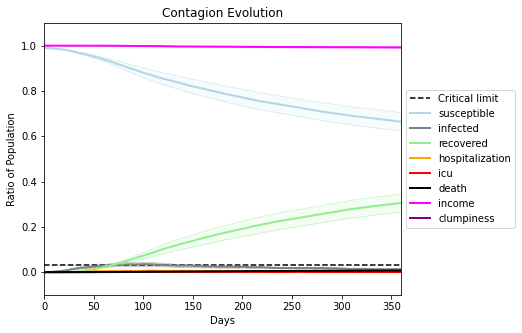

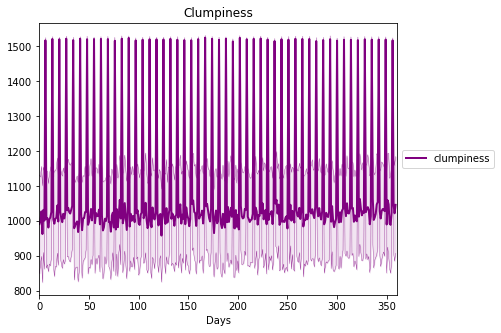

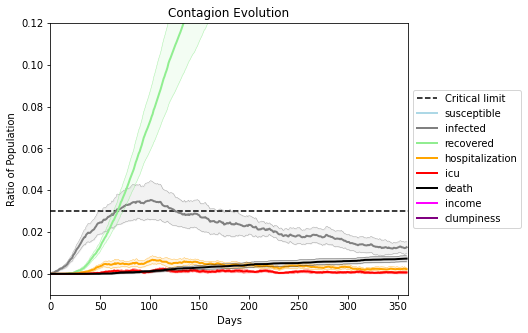

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7784, 9037, 4938, 5035, 7994, 8651, 7245, 7207, 1923, 6563, 6289, 6790, 7555, 565, 3964, 8843, 9431, 2997, 5580, 5832]
Average similarity between family members is 0.9502543238335217 at temperature -0.996
Average similarity between family and home is 0.9998561095142707 at temperature -1
Average similarity between students and their classroom is 0.9059051993623575 at temperature -0.996
Average classroom occupancy is 1.6327683615819208 and number classrooms is 177
Average similarity between workers is 0.9247335068756067 at temperature -0.996
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.8573713304467426 for kids: 0.7432681312600972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.6523476838880625
avg restaurant similarity 0.684794935682065
avg restaurant similarity 0.44323399311685885
avg restaurant similarity 0.8915853127550808
avg restaurant similarity 0.5967382529510515
avg restaurant similarity 0.9997752531028916
avg restaurant similarity 0.6299533902487625
avg restaurant similarity 0.8325565242347082
avg restaurant similarity 0.48893730655958234
avg restaurant similarity 0.3551406207278679
avg restaurant similarity 0.8063560445841622
avg restaurant similarity 0.2399325799938378
avg restaurant similarity 0.8019539469522836
avg restaurant similarity 0.6474017624597842
avg restaurant similarity 0.4398678790377305
avg restaurant similarity 0.674126577180308
avg restaurant similarity 0.47942205599064014
avg restaurant similarity 0.674434073248927
avg restaurant similarity 0.24972177213562027
avg restaurant similarity 0.46403496925626064
avg restaurant similarity 0.2951140276636834
avg restaurant similarity 0.7336227749446781
avg rest

avg restaurant similarity 0.6669217091621993
avg restaurant similarity 0.7525177937043677
avg restaurant similarity 0.30384018398753465
avg restaurant similarity 0.3685474233106084
avg restaurant similarity 0.674434073248927
avg restaurant similarity 0.34236758901892345
avg restaurant similarity 0.6220974409356212
avg restaurant similarity 0.7467416004363205
avg restaurant similarity 0.4528135927864483
avg restaurant similarity 0.577568760761741
avg restaurant similarity 0.7138087953287013
avg restaurant similarity 0.24701809180838247
avg restaurant similarity 0.537930737710109
avg restaurant similarity 0.9996728436195876
avg restaurant similarity 0.36345069091242643
avg restaurant similarity 0.24438857064533728
avg restaurant similarity 0.23927041738792654
avg restaurant similarity 0.3708716292957088
avg restaurant similarity 0.399040253692507
avg restaurant similarity 0.6669217091621993
avg restaurant similarity 0.5350511819137977
avg restaurant similarity 0.6686884594728046
avg rest

avg restaurant similarity 0.45477562489548834
avg restaurant similarity 0.44458858037074117
avg restaurant similarity 0.37028968705244114
avg restaurant similarity 0.9997424426969377
avg restaurant similarity 0.7997874321395146
avg restaurant similarity 0.6814204004536203
avg restaurant similarity 0.9995764905471206
avg restaurant similarity 0.5679864360303537
avg restaurant similarity 0.4512681145018618
avg restaurant similarity 0.6278347805609655
avg restaurant similarity 0.5537481465697467
avg restaurant similarity 0.5119439665483745
avg restaurant similarity 0.9997684273939481
avg restaurant similarity 0.6468120451743025
avg restaurant similarity 0.5423002448636052
avg restaurant similarity 0.8176939777557073
avg restaurant similarity 0.5255416923994842
avg restaurant similarity 0.4665042622220042
avg restaurant similarity 0.5275452506903084
avg restaurant similarity 0.5651230433435516
avg restaurant similarity 0.6126823327265994
avg restaurant similarity 0.4541762165019084
avg res

avg restaurant similarity 0.5342598035633022
avg restaurant similarity 0.6583518739121197
avg restaurant similarity 0.43964932476362606
avg restaurant similarity 0.6168068099962128
avg restaurant similarity 0.42514471038246077
avg restaurant similarity 0.49406073370921966
avg restaurant similarity 0.829541335992825
avg restaurant similarity 0.7870689101169591
Average similarity between family members is 0.9543908958358799 at temperature -0.996
Average similarity between family and home is 0.9998719090376768 at temperature -1
Average similarity between students and their classroom is 0.9368268254306809 at temperature -0.996
Average classroom occupancy is 1.5842696629213484 and number classrooms is 178
Average similarity between workers is 0.9184017243253798 at temperature -0.996
Average office occupancy is 3.5 and number offices is 190
Average friend similarity for adults: 0.862777911178011 for kids: 0.7373049880443946
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBui

avg restaurant similarity 0.9995197746218011
avg restaurant similarity 0.9994749861242054
avg restaurant similarity 0.45949740935279965
avg restaurant similarity 0.750465339338372
avg restaurant similarity 0.8747932153678368
avg restaurant similarity 0.4572662126686015
avg restaurant similarity 0.3003200943698478
avg restaurant similarity 0.4888056494214823
avg restaurant similarity 0.49884793303168407
avg restaurant similarity 0.7484675655828205
avg restaurant similarity 0.5900136319749503
avg restaurant similarity 0.7593213246439151
avg restaurant similarity 0.4725589242168382
avg restaurant similarity 0.5236345190146843
avg restaurant similarity 0.5216225833233119
avg restaurant similarity 0.5115240548268543
avg restaurant similarity 0.3843522239768797
avg restaurant similarity 0.45949740935279965
avg restaurant similarity 0.7593213246439151
avg restaurant similarity 0.5450025777891186
avg restaurant similarity 0.8794212871870037
avg restaurant similarity 0.7394239032934169
avg rest

avg restaurant similarity 0.999834163169222
avg restaurant similarity 0.6191767912382643
avg restaurant similarity 0.7066723302894847
avg restaurant similarity 0.6093762171430639
avg restaurant similarity 0.5890294729757948
avg restaurant similarity 0.5874836322720441
avg restaurant similarity 0.6523197964760814
avg restaurant similarity 0.9191316124607667
avg restaurant similarity 0.58865902747823
avg restaurant similarity 0.5057960237546912
avg restaurant similarity 0.4177744008987223
avg restaurant similarity 0.8199195422685487
avg restaurant similarity 0.6169552392153342
avg restaurant similarity 0.5594021986201361
avg restaurant similarity 0.7118064657323824
avg restaurant similarity 0.6775253278304264
avg restaurant similarity 0.46689628054943993
avg restaurant similarity 0.5831634154277137
avg restaurant similarity 0.5197760106570942
avg restaurant similarity 0.2903500816753078
avg restaurant similarity 0.5858947861108016
avg restaurant similarity 0.42121058630852093
avg restaur

avg restaurant similarity 0.7035306729662367
avg restaurant similarity 0.5749058009284317
avg restaurant similarity 0.7231812010232918
avg restaurant similarity 0.8384350638404061
avg restaurant similarity 0.1209726904098819
avg restaurant similarity 0.8100392640031595
avg restaurant similarity 0.5236895487775128
avg restaurant similarity 0.384893181395879
avg restaurant similarity 0.7738724703154221
avg restaurant similarity 0.37770989859163945
avg restaurant similarity 0.40269295938665567
avg restaurant similarity 0.6138243405037308
avg restaurant similarity 0.08812589243653365
avg restaurant similarity 0.5314498446588827
avg restaurant similarity 0.28909806686226186
avg restaurant similarity 0.7755950294721242
avg restaurant similarity 0.8209031350727902
avg restaurant similarity 0.6063417105379473
avg restaurant similarity 0.5483147486520052
avg restaurant similarity 0.3267371197181259
avg restaurant similarity 0.4177744008987223
avg restaurant similarity 0.8561709710003789
Average

avg restaurant similarity 0.6611588426229656
avg restaurant similarity 0.91751570770036
avg restaurant similarity 0.41335970295054786
avg restaurant similarity 0.729997508310861
avg restaurant similarity 0.3361053538945139
avg restaurant similarity 0.5236048342867446
avg restaurant similarity 0.2814695414409209
avg restaurant similarity 0.5726101134827379
avg restaurant similarity 0.9996908835282503
avg restaurant similarity 0.7400958012115967
avg restaurant similarity 0.4543298761856166
avg restaurant similarity 0.6043169989670161
avg restaurant similarity 0.5730514772432425
avg restaurant similarity 0.9348069066142214
avg restaurant similarity 0.8449185214811384
avg restaurant similarity 0.37992742162600024
avg restaurant similarity 0.4992941249272954
avg restaurant similarity 0.8770873825140021
avg restaurant similarity 0.9997218393841554
avg restaurant similarity 0.22421606739732547
avg restaurant similarity 0.5734710252582049
avg restaurant similarity 0.2847669517381398
avg restau

avg restaurant similarity 0.7869807255474933
avg restaurant similarity 0.5900321573602972
avg restaurant similarity 0.7049427586629559
avg restaurant similarity 0.5667135337032905
avg restaurant similarity 0.9999225873677332
avg restaurant similarity 0.5719824482633005
avg restaurant similarity 0.6266605211655732
avg restaurant similarity 0.48302285222137153
avg restaurant similarity 0.502969283888953
avg restaurant similarity 0.7161366260626805
avg restaurant similarity 0.8343905530420374
avg restaurant similarity 0.5636142788609293
avg restaurant similarity 0.7304421175147982
avg restaurant similarity 0.6753695339447852
avg restaurant similarity 0.9998158420575005
avg restaurant similarity 0.45423904453984
avg restaurant similarity 0.5835451621518452
avg restaurant similarity 0.5365663784695747
avg restaurant similarity 0.5706655981734633
avg restaurant similarity 0.3503572006273191
avg restaurant similarity 0.7910108472922627
avg restaurant similarity 0.48045872748391577
avg restaur

avg restaurant similarity 0.7871106594132002
avg restaurant similarity 0.4362628490547189
avg restaurant similarity 0.5099749038970243
avg restaurant similarity 0.40666330428537345
avg restaurant similarity 0.43524579975793337
avg restaurant similarity 0.5158299002068754
avg restaurant similarity 0.474582432983109
avg restaurant similarity 0.5577868162425157
avg restaurant similarity 0.5107931104903978
avg restaurant similarity 0.9999086044290161
avg restaurant similarity 0.5984047183447292
avg restaurant similarity 0.35632318788590467
avg restaurant similarity 0.382277988238728
avg restaurant similarity 0.7533954614383738
avg restaurant similarity 0.9998619417978614
avg restaurant similarity 0.5608014339517198
avg restaurant similarity 0.21826187387193802
avg restaurant similarity 0.9007914457739331
avg restaurant similarity 0.563211120503988
avg restaurant similarity 0.5721336051757308
avg restaurant similarity 0.4188258140832045
avg restaurant similarity 0.5684298319937552
avg resta

avg restaurant similarity 0.5342254535463606
avg restaurant similarity 0.6202682932688812
avg restaurant similarity 0.3789391388381378
avg restaurant similarity 0.6984608591149015
avg restaurant similarity 0.5058928319846339
avg restaurant similarity 0.6341291415477455
avg restaurant similarity 0.48697245505984593
avg restaurant similarity 0.4919485776703907
avg restaurant similarity 0.4238538759499133
avg restaurant similarity 0.4514962537015708
avg restaurant similarity 0.5233159721808683
avg restaurant similarity 0.42077685886199967
avg restaurant similarity 0.6197553854155542
avg restaurant similarity 0.8321193020327782
avg restaurant similarity 0.44989974380247594
avg restaurant similarity 0.7087675891148553
avg restaurant similarity 0.6824610390446872
avg restaurant similarity 0.6939460559018193
avg restaurant similarity 0.828448747132287
avg restaurant similarity 0.9991654204844935
avg restaurant similarity 0.6596624523321653
avg restaurant similarity 0.5419455997690175
avg rest

Average similarity between workers is 0.9362000015575326 at temperature -0.996
Average office occupancy is 3.34375 and number offices is 192
Average friend similarity for adults: 0.8553798816757501 for kids: 0.741470933705969
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people alloca

avg restaurant similarity 0.6439954654928716
avg restaurant similarity 0.5104430875395088
avg restaurant similarity 0.5397632496906792
avg restaurant similarity 0.7193320165291723
avg restaurant similarity 0.40231788339016494
avg restaurant similarity 0.9998079787984195
avg restaurant similarity 0.6571641105362893
avg restaurant similarity 0.6666623840049948
avg restaurant similarity 0.5516692674396263
avg restaurant similarity 0.47047591533581257
avg restaurant similarity 0.8556818729643131
avg restaurant similarity 0.8026246889280804
avg restaurant similarity 0.49435117689121877
avg restaurant similarity 0.3439251733707231
avg restaurant similarity 0.5221483272325805
avg restaurant similarity 0.6795571234850288
avg restaurant similarity 0.46799375006631005
avg restaurant similarity 0.38121748837561
avg restaurant similarity 0.41016203175070565
avg restaurant similarity 0.6390401001906021
avg restaurant similarity 0.9073403504744433
avg restaurant similarity 0.7839852702622438
avg res

avg restaurant similarity 0.719561584015607
avg restaurant similarity 0.6003074316880392
avg restaurant similarity 0.8765064582255275
avg restaurant similarity 0.8263021574941737
avg restaurant similarity 0.8399424705751276
avg restaurant similarity 0.4253602886809682
avg restaurant similarity 0.4213367040964525
avg restaurant similarity 0.607276272382005
avg restaurant similarity 0.3621022534754295
avg restaurant similarity 0.5579855226562627
avg restaurant similarity 0.4841383920610668
avg restaurant similarity 0.8255782555549395
avg restaurant similarity 0.6043262120598786
avg restaurant similarity 0.5189052710476656
avg restaurant similarity 0.14737241510180688
avg restaurant similarity 0.7248659940002844
avg restaurant similarity 0.887960397274185
avg restaurant similarity 0.8884185955229988
avg restaurant similarity 0.4426655120828982
avg restaurant similarity 0.6575316340866881
avg restaurant similarity 0.47845411880826416
avg restaurant similarity 0.607225446685233
avg restaura

Average similarity between workers is 0.9314006390782473 at temperature -0.996
Average office occupancy is 3.546875 and number offices is 192
Average friend similarity for adults: 0.864490514022975 for kids: 0.7432507614572798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people all

avg restaurant similarity 0.5338948058443432
avg restaurant similarity 0.6596131584402709
avg restaurant similarity 0.8486814226378552
avg restaurant similarity 0.5720477313203941
avg restaurant similarity 0.7448235681017056
avg restaurant similarity 0.8671008786222458
avg restaurant similarity 0.5486094025091637
avg restaurant similarity 0.6141099447746378
avg restaurant similarity 0.8530624388964789
avg restaurant similarity 0.7193346301850252
avg restaurant similarity 0.7340259529719357
avg restaurant similarity 0.41445460702262543
avg restaurant similarity 0.5329557604471171
avg restaurant similarity 0.2626735467539679
avg restaurant similarity 0.4394790224729241
avg restaurant similarity 0.23508451919489148
avg restaurant similarity 0.7390710073976368
avg restaurant similarity 0.9999473977072506
avg restaurant similarity 0.8501825426408784
avg restaurant similarity 0.3633038537461404
avg restaurant similarity 0.7430906003845528
avg restaurant similarity 0.672704394405305
avg resta

avg restaurant similarity 0.42146670109891604
avg restaurant similarity 0.45741132686388286
avg restaurant similarity 0.9997103704397862
avg restaurant similarity 0.5453976451289657
avg restaurant similarity 0.6163503230211016
avg restaurant similarity 0.9090456623849785
avg restaurant similarity 0.9997103704397862
avg restaurant similarity 0.8205642988970416
avg restaurant similarity 0.4721585419223482
Average similarity between family members is 0.9519630603992861 at temperature -0.996
Average similarity between family and home is 0.9998450059795206 at temperature -1
Average similarity between students and their classroom is 0.9076566181416008 at temperature -0.996
Average classroom occupancy is 1.5862068965517242 and number classrooms is 174
Average similarity between workers is 0.9457250404295173 at temperature -0.996
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.85596508352075 for kids: 0.7345956594495878
home_dist

avg restaurant similarity 0.838941514866639
avg restaurant similarity 0.6696144331165376
avg restaurant similarity 0.1482887197200291
avg restaurant similarity 0.6398410759595674
avg restaurant similarity 0.72281839372748
avg restaurant similarity 0.7382891257299476
avg restaurant similarity 0.839235550103649
avg restaurant similarity 0.9996754265312551
avg restaurant similarity 0.820558599248361
avg restaurant similarity 0.6975552607726837
avg restaurant similarity 0.5371723292899129
avg restaurant similarity 0.5851882827844385
avg restaurant similarity 0.821836745181018
avg restaurant similarity 0.7839122049001261
avg restaurant similarity 0.5584613717451998
avg restaurant similarity 0.8502061625930192
avg restaurant similarity 0.5839070007360323
avg restaurant similarity 0.6736618814995725
avg restaurant similarity 0.6095305939221588
avg restaurant similarity 0.5605954206210453
avg restaurant similarity 0.6781288896204136
avg restaurant similarity 0.9996414476861757
avg restaurant s

avg restaurant similarity 0.6221138731517707
avg restaurant similarity 0.821836745181018
avg restaurant similarity 0.806748958993573
avg restaurant similarity 0.9091608561436747
avg restaurant similarity 0.7194838174308408
avg restaurant similarity 0.37968815490398783
avg restaurant similarity 0.8592796117530076
avg restaurant similarity 0.8662485514799207
avg restaurant similarity 0.69433267203565
avg restaurant similarity 0.8067212098027439
avg restaurant similarity 0.7232892611855726
avg restaurant similarity 0.4780516762818238
avg restaurant similarity 0.45033899731017557
avg restaurant similarity 0.7352820386515213
avg restaurant similarity 0.6707770584718047
Average similarity between family members is 0.9579088974318956 at temperature -0.996
Average similarity between family and home is 0.9998463282791756 at temperature -1
Average similarity between students and their classroom is 0.9295941513155495 at temperature -0.996
Average classroom occupancy is 1.6158536585365855 and numb

avg restaurant similarity 0.5903608489774744
avg restaurant similarity 0.41373143081299035
avg restaurant similarity 0.5264641509763133
avg restaurant similarity 0.6890811679917201
avg restaurant similarity 0.41734448911070954
avg restaurant similarity 0.613035442008755
avg restaurant similarity 0.5524473215060979
avg restaurant similarity 0.5508441332348732
avg restaurant similarity 0.46818397627450703
avg restaurant similarity 0.4867166748627069
avg restaurant similarity 0.5743452409919183
avg restaurant similarity 0.41730484681294544
avg restaurant similarity 0.6580622127025572
avg restaurant similarity 0.559313065969893
avg restaurant similarity 0.5897604944062411
avg restaurant similarity 0.6431595994034134
avg restaurant similarity 0.6722528597599027
avg restaurant similarity 0.5481250380009228
avg restaurant similarity 0.5787108369903168
avg restaurant similarity 0.35459631543484577
avg restaurant similarity 0.5365063180338633
avg restaurant similarity 0.8562294645447671
avg res

avg restaurant similarity 0.5686566068808229
avg restaurant similarity 0.6861092842800502
avg restaurant similarity 0.5164147250460861
avg restaurant similarity 0.8895418577453721
avg restaurant similarity 0.5164887989112413
avg restaurant similarity 0.3560282086425558
avg restaurant similarity 0.9599248584887573
avg restaurant similarity 0.82167920911501
avg restaurant similarity 0.8061244125266172
avg restaurant similarity 0.8218636734136395
avg restaurant similarity 0.5554606783052455
avg restaurant similarity 0.3560282086425558
avg restaurant similarity 0.6449589582490188
avg restaurant similarity 0.1674759739392359
avg restaurant similarity 0.09101151003684543
avg restaurant similarity 0.4894683679340377
avg restaurant similarity 0.24134449393215363
avg restaurant similarity 0.6434970662738417
avg restaurant similarity 0.5322071571985284
avg restaurant similarity 0.5161387030502249
avg restaurant similarity 0.4272532541127284
avg restaurant similarity 0.6237314096844484
avg restau

avg restaurant similarity 0.601568374666955
avg restaurant similarity 0.7455553128025023
avg restaurant similarity 0.5726632151855611
avg restaurant similarity 0.5446978022413874
avg restaurant similarity 0.8095310609388878
avg restaurant similarity 0.4127794072522657
avg restaurant similarity 0.6354123374314866
avg restaurant similarity 0.6858011815982248
avg restaurant similarity 0.33462860683817097
avg restaurant similarity 0.8416223568886247
avg restaurant similarity 0.5224952226069778
avg restaurant similarity 0.6436726525605043
avg restaurant similarity 0.7455016158867265
avg restaurant similarity 0.37933375595183744
avg restaurant similarity 0.8417141387446606
avg restaurant similarity 0.7137868130669263
avg restaurant similarity 0.8232101366242139
avg restaurant similarity 0.8285579476999368
avg restaurant similarity 0.47429747293654834
avg restaurant similarity 0.5311159746122147
avg restaurant similarity 0.8566611451513892
avg restaurant similarity 0.6390505892848165
avg rest

Average similarity between family and home is 0.9998458944408662 at temperature -1
Average similarity between students and their classroom is 0.9350188577275762 at temperature -0.996
Average classroom occupancy is 1.5892857142857142 and number classrooms is 168
Average similarity between workers is 0.9191994031272948 at temperature -0.996
Average office occupancy is 3.4461538461538463 and number offices is 195
Average friend similarity for adults: 0.86006698975036 for kids: 0.7336376516384501
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.7042988166358749
avg restaurant similarity 0.7230412008121959
avg restaurant similarity 0.7457210971580422
avg restaurant similarity 0.30084365432851856
avg restaurant similarity 0.8784941431051755
avg restaurant similarity 0.5700700200818278
avg restaurant similarity 0.6037394112639278
avg restaurant similarity 0.594712825782522
avg restaurant similarity 0.6388991683608931
avg restaurant similarity 0.27613105124007986
avg restaurant similarity 0.7353462157142344
avg restaurant similarity 0.6070093119585407
avg restaurant similarity 0.6262841423688323
avg restaurant similarity 0.40411651382508457
avg restaurant similarity 0.9996232073925578
avg restaurant similarity 0.7760726907228037
avg restaurant similarity 0.6596260864426671
avg restaurant similarity 0.30084365432851856
avg restaurant similarity 0.8524837494314383
avg restaurant similarity 0.5543919261261891
avg restaurant similarity 0.29610529667581326
avg restaurant similarity 0.8501623072367177
avg re

avg restaurant similarity 0.6642153282869852
avg restaurant similarity 0.999868048637903
avg restaurant similarity 0.592745546387731
avg restaurant similarity 0.8176247157429164
avg restaurant similarity 0.6476323868071318
avg restaurant similarity 0.7115872495231363
avg restaurant similarity 0.9998338798639703
avg restaurant similarity 0.5591110094613286
avg restaurant similarity 0.8539552929792422
avg restaurant similarity 0.5444312056522147
avg restaurant similarity 0.35135407866613355
avg restaurant similarity 0.4526620711780028
avg restaurant similarity 0.9095777911297105
avg restaurant similarity 0.5782041787825822
avg restaurant similarity 0.6263272534644289
avg restaurant similarity 0.5980494352031009
avg restaurant similarity 0.5683538995786908
avg restaurant similarity 0.826820712030019
avg restaurant similarity 0.4842662703473711
avg restaurant similarity 0.826820712030019
avg restaurant similarity 0.9095777911297105
avg restaurant similarity 0.6005393782212538
avg restauran

avg restaurant similarity 0.463522008240545
avg restaurant similarity 0.6598588996212824
avg restaurant similarity 0.6746316827817835
avg restaurant similarity 0.849675784000713
avg restaurant similarity 0.623201631951696
avg restaurant similarity 0.48635591855819316
avg restaurant similarity 0.4242189151402166
avg restaurant similarity 0.426572891661531
avg restaurant similarity 0.6079753406493844
avg restaurant similarity 0.521723904047114
avg restaurant similarity 0.6822537143633411
avg restaurant similarity 0.6193788604398369
avg restaurant similarity 0.5791249758525758
avg restaurant similarity 0.9220187119410029
avg restaurant similarity 0.6601761864253066
avg restaurant similarity 0.23547324505550143
avg restaurant similarity 0.5744381959620588
avg restaurant similarity 0.5223207720230492
avg restaurant similarity 0.36576208651522873
avg restaurant similarity 0.9346524065504523
avg restaurant similarity 0.6197806557607168
avg restaurant similarity 0.42478767599043943
avg restaur

avg restaurant similarity 0.6657612607500542
avg restaurant similarity 0.5242256248742959
avg restaurant similarity 0.43816517802885163
avg restaurant similarity 0.6188595866963643
avg restaurant similarity 0.688062776485708
avg restaurant similarity 0.6034713757776846
avg restaurant similarity 0.7722818053949007
avg restaurant similarity 0.5313180113221945
avg restaurant similarity 0.7158087573511038
avg restaurant similarity 0.5280669944752492
avg restaurant similarity 0.516842146349686
avg restaurant similarity 0.7671557619665331
avg restaurant similarity 0.8341522447809455
avg restaurant similarity 0.5386263653441872
avg restaurant similarity 0.5340392200178031
avg restaurant similarity 0.6113248825158282
avg restaurant similarity 0.8277263788417313
avg restaurant similarity 0.6417121629991903
avg restaurant similarity 0.6109074526165295
avg restaurant similarity 0.6679797095557505
avg restaurant similarity 0.6290920439181246
avg restaurant similarity 0.46222231591668983
avg restau

avg restaurant similarity 0.4289434731755918
avg restaurant similarity 0.8429030063473748
avg restaurant similarity 0.6272090643707773
avg restaurant similarity 0.4289434731755918
avg restaurant similarity 0.6056077553698098
avg restaurant similarity 0.5944095798271547
avg restaurant similarity 0.7364673343692202
avg restaurant similarity 0.5345200764324087
avg restaurant similarity 0.8624194826836786
avg restaurant similarity 0.5271446689964963
avg restaurant similarity 0.5313180113221945
avg restaurant similarity 0.9997235843779897
avg restaurant similarity 0.7685879422775845
avg restaurant similarity 0.5313016940766174
avg restaurant similarity 0.9997241423969488
avg restaurant similarity 0.6337228809490105
Average similarity between family members is 0.9503048091682121 at temperature -0.996
Average similarity between family and home is 0.9998465654524065 at temperature -1
Average similarity between students and their classroom is 0.9234894905804364 at temperature -0.996
Average cla

avg restaurant similarity 0.47710336372145484
avg restaurant similarity 0.5306779612483303
avg restaurant similarity 0.8970411438872152
avg restaurant similarity 0.4811889421682861
avg restaurant similarity 0.5750210299978931
avg restaurant similarity 0.9996363008681645
avg restaurant similarity 0.5941863458303962
avg restaurant similarity 0.2765811159764372
avg restaurant similarity 0.595732794331604
avg restaurant similarity 0.7721906094624235
avg restaurant similarity 0.36265352135790346
avg restaurant similarity 0.5709540233832913
avg restaurant similarity 0.44671989945167323
avg restaurant similarity 0.5845253568647286
avg restaurant similarity 0.5438530870644968
avg restaurant similarity 0.4373109780352483
avg restaurant similarity 0.9995217454294573
avg restaurant similarity 0.45115823289654083
avg restaurant similarity 0.49432469638630805
avg restaurant similarity 0.6306710502945386
avg restaurant similarity 0.5017105536848037
avg restaurant similarity 0.48800049491273906
avg r

avg restaurant similarity 0.8578224144056853
avg restaurant similarity 0.8733783934000195
avg restaurant similarity 0.5394727646891979
avg restaurant similarity 0.6324930499568349
avg restaurant similarity 0.6671048997727459
avg restaurant similarity 0.5080099052622608
avg restaurant similarity 0.4930634115971826
avg restaurant similarity 0.9997569223339213
avg restaurant similarity 0.5709540233832913
avg restaurant similarity 0.5325393931908569
avg restaurant similarity 0.6080625687707611
avg restaurant similarity 0.48940395211732757
avg restaurant similarity 0.5693521189616475
Average similarity between family members is 0.9483772954266441 at temperature -0.996
Average similarity between family and home is 0.9998530857394422 at temperature -1
Average similarity between students and their classroom is 0.923901950511896 at temperature -0.996
Average classroom occupancy is 1.6923076923076923 and number classrooms is 182
Average similarity between workers is 0.9304545469663368 at tempera

avg restaurant similarity 0.3941344712332782
avg restaurant similarity 0.5780750564825052
avg restaurant similarity 0.5742165931412861
avg restaurant similarity 0.42286295378226674
avg restaurant similarity 0.6148758648350315
avg restaurant similarity 0.4150632622490087
avg restaurant similarity 0.5547148317559711
avg restaurant similarity 0.7302792093117304
avg restaurant similarity 0.33453729889892353
avg restaurant similarity 0.5258441628879503
avg restaurant similarity 0.5992071138173007
avg restaurant similarity 0.4442812664275385
avg restaurant similarity 0.33453729889892353
avg restaurant similarity 0.999502192182512
avg restaurant similarity 0.4779837046725872
avg restaurant similarity 0.7106420483653079
avg restaurant similarity 0.9999000414174242
avg restaurant similarity 0.8413758815019956
avg restaurant similarity 0.7052407090993532
avg restaurant similarity 0.42105052946311244
avg restaurant similarity 0.9997087786000605
avg restaurant similarity 0.9998141445543535
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

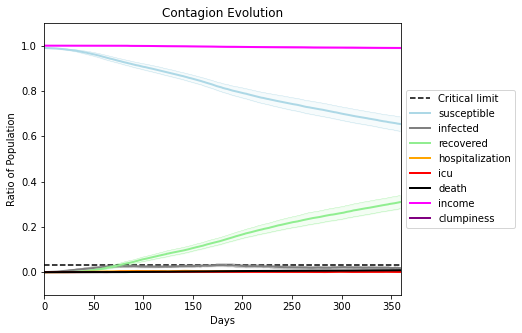

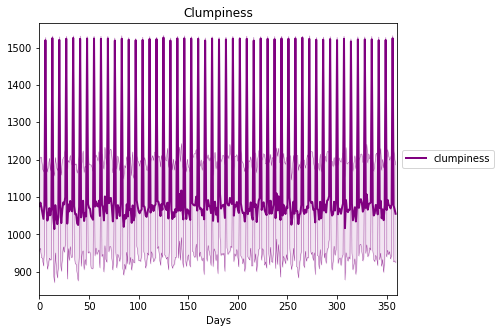

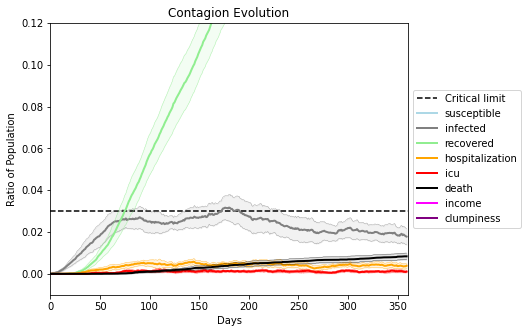

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4500, 6180, 3846, 6975, 4172, 4749, 3204, 6000, 7794, 1824, 8588, 1023, 5244, 1639, 3382, 9626, 1376, 7212, 8045, 7193]
Average similarity between family members is 0.9383929725187524 at temperature -0.995
Average similarity between family and home is 0.9998518324497643 at temperature -1
Average similarity between students and their classroom is 0.9085699475801602 at temperature -0.995
Average classroom occupancy is 1.6630434782608696 and number classrooms is 184
Average similarity between workers is 0.8861277216894324 at temperature -0.995
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.8459565355647549 for kids: 0.750536367231848
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5468365958785667
avg restaurant similarity 0.4571267091422243
avg restaurant similarity 0.6055462140732434
avg restaurant similarity 0.9994781069055894
avg restaurant similarity 0.46835792688810196
avg restaurant similarity 0.7351965814664407
avg restaurant similarity 0.8713990050874243
avg restaurant similarity 0.68698184788885
avg restaurant similarity 0.6487840771146649
avg restaurant similarity 0.60192958824667
avg restaurant similarity 0.5465262008946968
avg restaurant similarity 0.6790366221597518
avg restaurant similarity 0.5033709029475792
avg restaurant similarity 0.5040160059420087
avg restaurant similarity 0.4931647466063718
avg restaurant similarity 0.6513102572142101
avg restaurant similarity 0.7020852022731332
avg restaurant similarity 0.5850972920410549
avg restaurant similarity 0.8336107190796498
avg restaurant similarity 0.8337642830655779
avg restaurant similarity 0.6389027525487946
avg restaurant similarity 0.6331178984889243
avg restauran

avg restaurant similarity 0.5970779507337614
avg restaurant similarity 0.4056997582915831
avg restaurant similarity 0.4109289613534234
avg restaurant similarity 0.584835794834061
avg restaurant similarity 0.8564305410260229
avg restaurant similarity 0.8335903942970633
avg restaurant similarity 0.42746976714355456
avg restaurant similarity 0.7025235202458917
avg restaurant similarity 0.8384390163810873
avg restaurant similarity 0.6317224201665917
avg restaurant similarity 0.5795916075315612
avg restaurant similarity 0.4934134360397694
avg restaurant similarity 0.5762540594687737
avg restaurant similarity 0.4792658880703887
Average similarity between family members is 0.934544618671545 at temperature -0.995
Average similarity between family and home is 0.9998418419471822 at temperature -1
Average similarity between students and their classroom is 0.8884965634437213 at temperature -0.995
Average classroom occupancy is 1.691860465116279 and number classrooms is 172
Average similarity betwe

avg restaurant similarity 0.5269555631902801
avg restaurant similarity 0.7891065284372185
avg restaurant similarity 0.7509338186988517
avg restaurant similarity 0.5962401054251714
avg restaurant similarity 0.533264518733757
avg restaurant similarity 0.6665461514403035
avg restaurant similarity 0.7908290871454231
avg restaurant similarity 0.7188689403470861
avg restaurant similarity 0.740490885004149
avg restaurant similarity 0.5231907655293343
avg restaurant similarity 0.9998217042982029
avg restaurant similarity 0.9996275582565555
avg restaurant similarity 0.5743908197406048
avg restaurant similarity 0.533264518733757
avg restaurant similarity 0.602352712454892
avg restaurant similarity 0.6535934155598777
avg restaurant similarity 0.9997132827948927
avg restaurant similarity 0.6837525458864454
avg restaurant similarity 0.7908290871454231
avg restaurant similarity 0.5463588302373138
avg restaurant similarity 0.8978700547800041
avg restaurant similarity 0.6083382476236242
avg restaurant

avg restaurant similarity 0.7908290871454231
avg restaurant similarity 0.5105681436063714
avg restaurant similarity 0.4806834831513432
avg restaurant similarity 0.2690533059648437
avg restaurant similarity 0.8009411412545918
avg restaurant similarity 0.7308969108761756
avg restaurant similarity 0.5783391001470464
avg restaurant similarity 0.8097582534178145
avg restaurant similarity 0.5463724308327828
avg restaurant similarity 0.5783391001470464
avg restaurant similarity 0.6193440876169447
avg restaurant similarity 0.8129168012424313
avg restaurant similarity 0.9288211662857826
avg restaurant similarity 0.5995765559151045
avg restaurant similarity 0.5356969096342119
avg restaurant similarity 0.7077597618187281
avg restaurant similarity 0.4521346858762064
avg restaurant similarity 0.3352676483244852
avg restaurant similarity 0.25544717217241486
avg restaurant similarity 0.9014231374726585
avg restaurant similarity 0.42826750728756646
avg restaurant similarity 0.7885425576600437
avg rest

avg restaurant similarity 0.8277915225366723
avg restaurant similarity 0.4660663745098456
avg restaurant similarity 0.7334966168956467
avg restaurant similarity 0.4704008760218862
avg restaurant similarity 0.5979259000028317
avg restaurant similarity 0.867032768434348
avg restaurant similarity 0.430501888433084
avg restaurant similarity 0.5319300885516038
avg restaurant similarity 0.9425836255660804
avg restaurant similarity 0.6103897326171095
avg restaurant similarity 0.5379507789275062
avg restaurant similarity 0.49063083525767415
avg restaurant similarity 0.999756390830784
avg restaurant similarity 0.4649597780268881
avg restaurant similarity 0.48945786924687695
avg restaurant similarity 0.4746212630161919
avg restaurant similarity 0.5480684330728443
avg restaurant similarity 0.4649597780268881
avg restaurant similarity 0.9995168314719701
avg restaurant similarity 0.42621436350707914
avg restaurant similarity 0.8857290060201773
avg restaurant similarity 0.5456341823214337
avg restau

avg restaurant similarity 0.9997399311235435
avg restaurant similarity 0.7151079940444902
avg restaurant similarity 0.4911088604032397
avg restaurant similarity 0.466828064126056
avg restaurant similarity 0.45076435958752015
avg restaurant similarity 0.5704642912882801
avg restaurant similarity 0.6379824696022862
avg restaurant similarity 0.4897820948391658
avg restaurant similarity 0.6454120850063721
avg restaurant similarity 0.4103602425174164
avg restaurant similarity 0.36127145297907903
avg restaurant similarity 0.9997180162087991
avg restaurant similarity 0.21439881984055753
avg restaurant similarity 0.6372363591309502
avg restaurant similarity 0.9064651116948914
avg restaurant similarity 0.6970378048664139
avg restaurant similarity 0.5712679820183858
avg restaurant similarity 0.5725665747468286
avg restaurant similarity 0.7999658808812523
avg restaurant similarity 0.47314309110806285
avg restaurant similarity 0.4681008150894408
avg restaurant similarity 0.501754490016991
avg rest

avg restaurant similarity 0.9998391017311412
avg restaurant similarity 0.6796164890772968
avg restaurant similarity 0.6809230902156455
avg restaurant similarity 0.5866388263220705
avg restaurant similarity 0.6366595532070835
avg restaurant similarity 0.5169668517446214
avg restaurant similarity 0.6793257321475382
avg restaurant similarity 0.9997828278031724
avg restaurant similarity 0.47691028530774177
avg restaurant similarity 0.2516849663148441
avg restaurant similarity 0.5381449117132524
avg restaurant similarity 0.8353776310147486
avg restaurant similarity 0.6775513312011465
avg restaurant similarity 0.6796164890772968
avg restaurant similarity 0.5007195890242488
avg restaurant similarity 0.9996530284341745
avg restaurant similarity 0.5339725527830433
avg restaurant similarity 0.6563535310849274
avg restaurant similarity 0.6586272144813227
avg restaurant similarity 0.6077216149076964
avg restaurant similarity 0.4993817114309579
avg restaurant similarity 0.6341151115714683
avg resta

avg restaurant similarity 0.5868393331192481
avg restaurant similarity 0.6796164890772968
avg restaurant similarity 0.6333666023678952
avg restaurant similarity 0.6063819548594648
avg restaurant similarity 0.6813908900236885
avg restaurant similarity 0.585858985399667
avg restaurant similarity 0.5580320505246414
avg restaurant similarity 0.29799826180558325
avg restaurant similarity 0.6501679792048429
avg restaurant similarity 0.4912569743310947
avg restaurant similarity 0.836002599112375
avg restaurant similarity 0.6148505639480182
avg restaurant similarity 0.6785971980488124
avg restaurant similarity 0.25291898575092486
avg restaurant similarity 0.7195666204003539
avg restaurant similarity 0.4004934536876326
avg restaurant similarity 0.6813908900236885
avg restaurant similarity 0.9996187881146061
avg restaurant similarity 0.8842632408086589
avg restaurant similarity 0.5945080664579854
avg restaurant similarity 0.6020359873484734
avg restaurant similarity 0.6407131746763933
avg restau

avg restaurant similarity 0.49558823383019357
avg restaurant similarity 0.5605575673916601
avg restaurant similarity 0.23895987114847284
avg restaurant similarity 0.37797869218996905
avg restaurant similarity 0.38880359821208527
avg restaurant similarity 0.5896126173241178
avg restaurant similarity 0.6378341613987822
avg restaurant similarity 0.999590319809061
avg restaurant similarity 0.4617897262224856
avg restaurant similarity 0.5175271062226894
avg restaurant similarity 0.3944178488697925
avg restaurant similarity 0.6551741056830165
avg restaurant similarity 0.6427427144298433
avg restaurant similarity 0.39434593293181885
avg restaurant similarity 0.5233732082123892
avg restaurant similarity 0.5095429003847756
avg restaurant similarity 0.5781630792791441
avg restaurant similarity 0.5662146060073595
avg restaurant similarity 0.5683648829202486
avg restaurant similarity 0.5208964865752926
avg restaurant similarity 0.20282674007212736
avg restaurant similarity 0.6215508268672087
avg r

avg restaurant similarity 0.7212288524132013
avg restaurant similarity 0.41687547236309896
avg restaurant similarity 0.8398507996500832
avg restaurant similarity 0.5970812913584548
avg restaurant similarity 0.38560707738854905
avg restaurant similarity 0.2733049109596468
avg restaurant similarity 0.3339445315846946
avg restaurant similarity 0.2705152154092858
avg restaurant similarity 0.47390210372762565
avg restaurant similarity 0.6747010043442228
avg restaurant similarity 0.44311286789832827
avg restaurant similarity 0.6078142255399888
avg restaurant similarity 0.6315582870081202
avg restaurant similarity 0.6747010043442228
avg restaurant similarity 0.7470909594295787
avg restaurant similarity 0.6747010043442228
avg restaurant similarity 0.6797167413707481
avg restaurant similarity 0.7665753010696639
avg restaurant similarity 0.34601584100009364
avg restaurant similarity 0.6573281688622437
avg restaurant similarity 0.5007187725858305
avg restaurant similarity 0.41483535270843225
avg 

avg restaurant similarity 0.6345696284444392
avg restaurant similarity 0.6105996142869929
avg restaurant similarity 0.701598543904008
avg restaurant similarity 0.9998258866845723
avg restaurant similarity 0.6013906796470563
avg restaurant similarity 0.85392610617803
avg restaurant similarity 0.4683837209397025
avg restaurant similarity 0.46054728755239416
avg restaurant similarity 0.7088483933052802
avg restaurant similarity 0.514015442638167
avg restaurant similarity 0.6174639299752995
avg restaurant similarity 0.7089852412874247
avg restaurant similarity 0.8322246367485864
avg restaurant similarity 0.70805806710536
avg restaurant similarity 0.4897303082210296
avg restaurant similarity 0.35183031174784996
avg restaurant similarity 0.8338622470770425
avg restaurant similarity 0.8176000417678103
avg restaurant similarity 0.5845320026050157
avg restaurant similarity 0.6936480859277087
avg restaurant similarity 0.8327574223235407
avg restaurant similarity 0.4897303082210296
avg restaurant

avg restaurant similarity 0.8544234351223108
avg restaurant similarity 0.5936842522936528
avg restaurant similarity 0.40819108869697096
avg restaurant similarity 0.521385145960332
avg restaurant similarity 0.5294675220849081
avg restaurant similarity 0.9991980554916425
Average similarity between family members is 0.9360711500185815 at temperature -0.995
Average similarity between family and home is 0.9998557106644369 at temperature -1
Average similarity between students and their classroom is 0.8766186947089314 at temperature -0.995
Average classroom occupancy is 1.6521739130434783 and number classrooms is 184
Average similarity between workers is 0.8916929227182928 at temperature -0.995
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.8446957434255216 for kids: 0.7432886570570576
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a t

avg restaurant similarity 0.5742750786343142
avg restaurant similarity 0.43517757283806924
avg restaurant similarity 0.2838985358816738
avg restaurant similarity 0.9141352816932098
avg restaurant similarity 0.6053040158623226
avg restaurant similarity 0.8746629389533254
avg restaurant similarity 0.4800139493447702
avg restaurant similarity 0.9221981463911072
avg restaurant similarity 0.538807582445479
avg restaurant similarity 0.7141610181987298
avg restaurant similarity 0.6333628786004841
avg restaurant similarity 0.40405520425728614
avg restaurant similarity 0.4327039745025767
avg restaurant similarity 0.4723021009930499
avg restaurant similarity 0.6713490395694326
avg restaurant similarity 0.44571489164764877
avg restaurant similarity 0.7879498586963142
avg restaurant similarity 0.48030532476534926
avg restaurant similarity 0.4305859312760183
avg restaurant similarity 0.5911214593203264
avg restaurant similarity 0.8162121528874355
avg restaurant similarity 0.6827540451145839
avg res

avg restaurant similarity 0.6541794908089946
avg restaurant similarity 0.44501545695979544
avg restaurant similarity 0.70830646851528
avg restaurant similarity 0.49490353205203463
avg restaurant similarity 0.4906520607875613
avg restaurant similarity 0.4170262026217634
avg restaurant similarity 0.6243263976612983
avg restaurant similarity 0.6414660421314752
avg restaurant similarity 0.6731026395795169
avg restaurant similarity 0.6412482703070872
avg restaurant similarity 0.8163453215880506
avg restaurant similarity 0.46567241400736703
avg restaurant similarity 0.6117267978537324
avg restaurant similarity 0.7568484549596048
avg restaurant similarity 0.809914872727354
avg restaurant similarity 0.45936060785172605
avg restaurant similarity 0.4948044259499249
avg restaurant similarity 0.490819686556192
avg restaurant similarity 0.6411369102208304
avg restaurant similarity 0.7848183560470192
avg restaurant similarity 0.5868909675553178
avg restaurant similarity 0.47339389064537546
avg resta

Average friend similarity for adults: 0.8665302587232173 for kids: 0.7487363722593047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.7289316241247258
avg restaurant similarity 0.44067585131458603
avg restaurant similarity 0.5402338603041723
avg restaurant similarity 0.7232082162809192
avg restaurant similarity 0.88047683474312
avg restaurant similarity 0.6934015130230105
avg restaurant similarity 0.5236409688875534
avg restaurant similarity 0.6733071146867592
avg restaurant similarity 0.40074133095014863
avg restaurant similarity 0.38658635444002704
avg restaurant similarity 0.6029469667037255
avg restaurant similarity 0.6180064144295951
avg restaurant similarity 0.7121208647952783
avg restaurant similarity 0.7231721741580135
avg restaurant similarity 0.5589821774482178
avg restaurant similarity 0.824442952131494
avg restaurant similarity 0.6415133044863963
avg restaurant similarity 0.5986884834964803
avg restaurant similarity 0.5384956970950139
avg restaurant similarity 0.41418472472815376
avg restaurant similarity 0.7190602430485816
avg restaurant similarity 0.41390497078912253
avg rest

avg restaurant similarity 0.5340682743512214
avg restaurant similarity 0.9998197919513265
avg restaurant similarity 0.9999056045895209
avg restaurant similarity 0.8325809758162774
avg restaurant similarity 0.6889932555236489
avg restaurant similarity 0.43180039801573056
avg restaurant similarity 0.4643228286068043
avg restaurant similarity 0.5116032540549339
avg restaurant similarity 0.5395664398420378
avg restaurant similarity 0.9997068106580644
avg restaurant similarity 0.4260109820629984
avg restaurant similarity 0.8527569776278612
avg restaurant similarity 0.5969283852447329
avg restaurant similarity 0.7351007980294756
avg restaurant similarity 0.9997068106580644
avg restaurant similarity 0.4501465815280524
avg restaurant similarity 0.4756792396695916
avg restaurant similarity 0.8974312467371556
avg restaurant similarity 0.7120658677986855
avg restaurant similarity 0.46540209453277237
avg restaurant similarity 0.46386142620912263
avg restaurant similarity 0.5639577993672994
avg res

avg restaurant similarity 0.6165288806039845
avg restaurant similarity 0.4643541705069435
avg restaurant similarity 0.6605286816103977
avg restaurant similarity 0.5946853915834409
avg restaurant similarity 0.7092455272128476
avg restaurant similarity 0.5134197845480468
avg restaurant similarity 0.8562678601021045
avg restaurant similarity 0.7356586244453891
avg restaurant similarity 0.5917572681486296
avg restaurant similarity 0.999415801088545
avg restaurant similarity 0.6245948695027626
avg restaurant similarity 0.4646999037902333
avg restaurant similarity 0.8521293792746909
avg restaurant similarity 0.645789748462635
avg restaurant similarity 0.647848232285611
avg restaurant similarity 0.6145598734488579
avg restaurant similarity 0.7099609170305318
avg restaurant similarity 0.5055168500405862
avg restaurant similarity 0.5210512329279839
avg restaurant similarity 0.7227809154539769
avg restaurant similarity 0.7478943856182486
avg restaurant similarity 0.841505465584747
avg restaurant

avg restaurant similarity 0.497165060841773
avg restaurant similarity 0.4830248103929045
avg restaurant similarity 0.5295654396179282
avg restaurant similarity 0.4620449239972345
avg restaurant similarity 0.4242890058656469
avg restaurant similarity 0.429927004358907
avg restaurant similarity 0.3716313355635766
avg restaurant similarity 0.25163537733918406
avg restaurant similarity 0.5047282356070952
avg restaurant similarity 0.320155563872215
avg restaurant similarity 0.4620449239972345
avg restaurant similarity 0.44537976756881703
avg restaurant similarity 0.5216711604166532
avg restaurant similarity 0.46271606101163765
avg restaurant similarity 0.28728992825135835
avg restaurant similarity 0.3831652474370476
avg restaurant similarity 0.9056710475181143
avg restaurant similarity 0.6201804054439647
avg restaurant similarity 0.4620449239972345
avg restaurant similarity 0.23340248697453653
avg restaurant similarity 0.16519432791920827
avg restaurant similarity 0.5038065170516626
avg res

avg restaurant similarity 0.6095234809850033
avg restaurant similarity 0.6103010641609351
avg restaurant similarity 0.7889902617393002
avg restaurant similarity 0.43661758119415056
avg restaurant similarity 0.5230543579356782
avg restaurant similarity 0.3048042619975615
avg restaurant similarity 0.5241518492932563
avg restaurant similarity 0.9995010982097501
avg restaurant similarity 0.8304010654681798
avg restaurant similarity 0.36396837688286576
avg restaurant similarity 0.497667898846832
avg restaurant similarity 0.28384726300322205
avg restaurant similarity 0.4614733119330291
avg restaurant similarity 0.5475022083610694
avg restaurant similarity 0.39163211910723694
avg restaurant similarity 0.5956485422751125
avg restaurant similarity 0.6107551544503131
avg restaurant similarity 0.400447166743411
avg restaurant similarity 0.45232031359914515
avg restaurant similarity 0.417187291678606
avg restaurant similarity 0.4260163143315143
avg restaurant similarity 0.5304500067422512
avg rest

avg restaurant similarity 0.4646530905190287
avg restaurant similarity 0.5149399282537481
avg restaurant similarity 0.6426645989235007
avg restaurant similarity 0.2389060297499346
avg restaurant similarity 0.37540318282055907
avg restaurant similarity 0.5247453798675767
avg restaurant similarity 0.39860186965007793
avg restaurant similarity 0.2179769044898095
avg restaurant similarity 0.8160897058854965
avg restaurant similarity 0.5566956827388165
avg restaurant similarity 0.11947050290710605
avg restaurant similarity 0.5477876749241952
avg restaurant similarity 0.5194154787698186
avg restaurant similarity 0.6964179780386195
avg restaurant similarity 0.38077983316884634
avg restaurant similarity 0.6827545895683715
avg restaurant similarity 0.4989715246855553
avg restaurant similarity 0.5444036726000084
avg restaurant similarity 0.5587186228191487
avg restaurant similarity 0.48042115523453893
avg restaurant similarity 0.3879302709028982
avg restaurant similarity 0.999783775644868
avg re

avg restaurant similarity 0.9089353036267933
avg restaurant similarity 0.26074828878867984
avg restaurant similarity 0.11015945894318689
avg restaurant similarity 0.5803528492928409
avg restaurant similarity 0.7808467852148442
avg restaurant similarity 0.5432874706103102
avg restaurant similarity 0.3557183794954184
avg restaurant similarity 0.1407102827919032
avg restaurant similarity 0.5038485661946007
avg restaurant similarity 0.4802220512063655
avg restaurant similarity 0.642669874680192
avg restaurant similarity 0.40893230172697415
avg restaurant similarity 0.13384516357492554
avg restaurant similarity 0.6868101003568842
avg restaurant similarity 0.5836361398584861
avg restaurant similarity 0.5680757790472581
avg restaurant similarity 0.6877066329471159
avg restaurant similarity 0.8773963870702247
avg restaurant similarity 0.5229408100382824
avg restaurant similarity 0.5252255174077091
avg restaurant similarity 0.4965306183863808
avg restaurant similarity 0.5193726745906291
avg res

avg restaurant similarity 0.7370203939405688
avg restaurant similarity 0.6334499865251086
avg restaurant similarity 0.5619205759405348
avg restaurant similarity 0.6607456876256191
avg restaurant similarity 0.435458661371814
avg restaurant similarity 0.47365246134934824
avg restaurant similarity 0.9998140701469996
avg restaurant similarity 0.6136932490135187
avg restaurant similarity 0.5377675242780484
avg restaurant similarity 0.47374627723939083
avg restaurant similarity 0.6074575074236
avg restaurant similarity 0.29867504616935225
avg restaurant similarity 0.5748564567098102
avg restaurant similarity 0.4753035094757624
avg restaurant similarity 0.21827894025529843
avg restaurant similarity 0.6322776870081526
avg restaurant similarity 0.2409500282546815
avg restaurant similarity 0.7739161163218442
avg restaurant similarity 0.4774979300771111
avg restaurant similarity 0.8510048531925518
avg restaurant similarity 0.4729365408357187
avg restaurant similarity 0.49424329605903794
avg resta

avg restaurant similarity 0.472840766795582
avg restaurant similarity 0.3282772293865181
avg restaurant similarity 0.31019851261144843
avg restaurant similarity 0.47054998935645675
avg restaurant similarity 0.2859488522903353
avg restaurant similarity 0.20692784241494944
avg restaurant similarity 0.4574665374650998
avg restaurant similarity 0.60458081481937
avg restaurant similarity 0.6396655325361121
avg restaurant similarity 0.6905696326712869
avg restaurant similarity 0.8607958448623472
avg restaurant similarity 0.7760842592323361
avg restaurant similarity 0.4157651248929284
avg restaurant similarity 0.38827887662329247
avg restaurant similarity 0.5180018507825866
avg restaurant similarity 0.6365287198717617
avg restaurant similarity 0.5896277756859453
avg restaurant similarity 0.3762071900619478
avg restaurant similarity 0.435575889416034
avg restaurant similarity 0.37852771940339414
avg restaurant similarity 0.47327505647819496
avg restaurant similarity 0.5841928214732857
avg rest

Average similarity between workers is 0.8979000380436003 at temperature -0.995
Average office occupancy is 3.3681592039800994 and number offices is 201
Average friend similarity for adults: 0.855736271892042 for kids: 0.7121651218250233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.7365953644900888
avg restaurant similarity 0.48828628158932724
avg restaurant similarity 0.4798650719371136
avg restaurant similarity 0.3109474582769005
avg restaurant similarity 0.561461173002278
avg restaurant similarity 0.440200916336094
avg restaurant similarity 0.7924411365791957
avg restaurant similarity 0.8463452368156745
avg restaurant similarity 0.588928129491576
avg restaurant similarity 0.565407059413368
avg restaurant similarity 0.5065049078795676
avg restaurant similarity 0.40878680978232396
avg restaurant similarity 0.4560072103216686
avg restaurant similarity 0.6306687003380862
avg restaurant similarity 0.8404413291038448
avg restaurant similarity 0.7957329223791532
avg restaurant similarity 0.5469699409884248
avg restaurant similarity 0.47894196364947406
avg restaurant similarity 0.5571595632634267
avg restaurant similarity 0.8542611367614937
avg restaurant similarity 0.390867408414589
avg restaurant similarity 0.5038210249986632
avg restaura

avg restaurant similarity 0.5371918109199659
avg restaurant similarity 0.48370274117586093
avg restaurant similarity 0.6068428154383272
avg restaurant similarity 0.6347264807623589
avg restaurant similarity 0.6486164549039225
avg restaurant similarity 0.6869779591959676
avg restaurant similarity 0.42601988505770566
avg restaurant similarity 0.43919894033264906
avg restaurant similarity 0.5382483380005302
avg restaurant similarity 0.49343099778341476
avg restaurant similarity 0.5605208070782908
avg restaurant similarity 0.6131261689205334
avg restaurant similarity 0.5382483380005302
avg restaurant similarity 0.36758026275056704
avg restaurant similarity 0.5930672390301968
avg restaurant similarity 0.645855131008169
avg restaurant similarity 0.6652318450188054
avg restaurant similarity 0.5335015361341795
avg restaurant similarity 0.613490363743419
avg restaurant similarity 0.6911056987472376
avg restaurant similarity 0.8993677603636123
avg restaurant similarity 0.5012713204319639
avg res

avg restaurant similarity 0.5654419766044355
avg restaurant similarity 0.33936197050536604
avg restaurant similarity 0.3556753946470388
avg restaurant similarity 0.331633130112045
avg restaurant similarity 0.38712284111682005
avg restaurant similarity 0.5026933029661858
avg restaurant similarity 0.38712284111682005
avg restaurant similarity 0.4673088355776028
avg restaurant similarity 0.5829499732488819
avg restaurant similarity 0.45334808584697883
avg restaurant similarity 0.47910271800033494
avg restaurant similarity 0.4144139041467736
avg restaurant similarity 0.4485029294094286
avg restaurant similarity 0.331633130112045
avg restaurant similarity 0.331633130112045
avg restaurant similarity 0.38589764418858097
avg restaurant similarity 0.7433959889831275
avg restaurant similarity 0.4070578853071452
avg restaurant similarity 0.9994440908105175
avg restaurant similarity 0.36856537315723
avg restaurant similarity 0.42336562520214527
avg restaurant similarity 0.4537793854383657
avg rest

avg restaurant similarity 0.48187205540920186
avg restaurant similarity 0.7334161447628053
avg restaurant similarity 0.36899265087506533
avg restaurant similarity 0.4580911636459192
avg restaurant similarity 0.32721503308854827
avg restaurant similarity 0.28246622184501075
avg restaurant similarity 0.7961593057868053
avg restaurant similarity 0.48636916809149244
avg restaurant similarity 0.6083892644177623
avg restaurant similarity 0.4857548608524228
avg restaurant similarity 0.3445536774320374
avg restaurant similarity 0.3863994399053297
avg restaurant similarity 0.523065374750828
avg restaurant similarity 0.331633130112045
avg restaurant similarity 0.5977694706216928
avg restaurant similarity 0.331633130112045
avg restaurant similarity 0.19254966211737654
avg restaurant similarity 0.4875883061907028
using average of time series:
stats on susceptible:
data: [0.8259694444444444, 0.9146055555555557, 0.8018833333333333, 0.7511361111111111, 0.8331945831945832, 0.7689722222222222, 0.824891

(<function dict.items>, <function dict.items>, <function dict.items>)

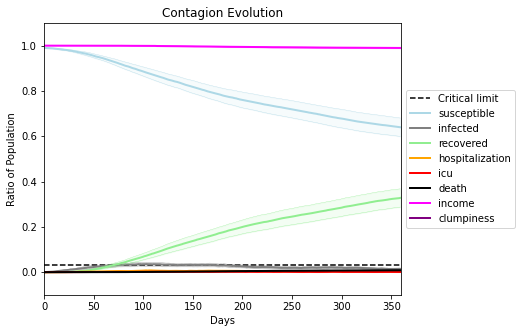

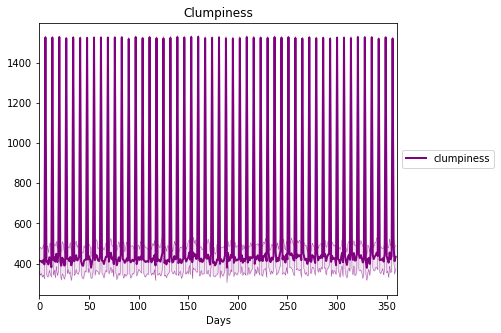

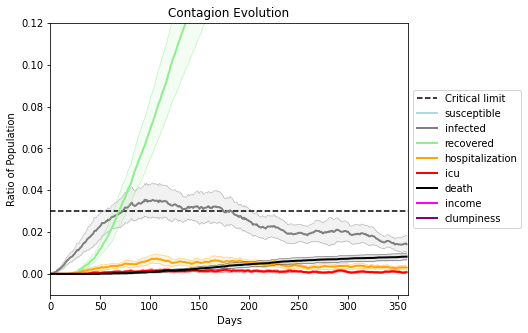

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1938, 2385, 1716, 31, 847, 214, 9952, 6035, 5504, 2562, 9189, 6478, 6674, 857, 2181, 7912, 8523, 9082, 8455, 7324]
Average similarity between family members is 0.9409529407635374 at temperature -0.994
Average similarity between family and home is 0.9998541782353695 at temperature -1
Average similarity between students and their classroom is 0.8581088123066064 at temperature -0.994
Average classroom occupancy is 1.7165775401069518 and number classrooms is 187
Average similarity between workers is 0.896729973951688 at temperature -0.994
Average office occupancy is 3.176767676767677 and number offices is 198
Average friend similarity for adults: 0.8534613339333428 for kids: 0.7504757496862997
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.28810667558682435
avg restaurant similarity 0.5211369184865813
avg restaurant similarity 0.6752459260061224
avg restaurant similarity 0.6096327865616104
avg restaurant similarity 0.26366044483850803
avg restaurant similarity 0.8587921183699379
avg restaurant similarity 0.8376053632512722
avg restaurant similarity 0.6419972623068333
avg restaurant similarity 0.41152024206739524
avg restaurant similarity 0.5296484060823936
avg restaurant similarity 0.9443788833421154
avg restaurant similarity 0.4070270792804586
avg restaurant similarity 0.6222584670388515
avg restaurant similarity 0.393868011918465
avg restaurant similarity 0.2629653153782737
avg restaurant similarity 0.5681038846896873
avg restaurant similarity 0.593568304812953
avg restaurant similarity 0.458321306817952
avg restaurant similarity 0.4481792387219953
avg restaurant similarity 0.47636061227832577
avg restaurant similarity 0.8164892426454815
avg restaurant similarity 0.6251938399441956
avg resta

avg restaurant similarity 0.8478698812234995
avg restaurant similarity 0.2623173152492063
avg restaurant similarity 0.8807647275907138
avg restaurant similarity 0.5951411195391898
avg restaurant similarity 0.20821059535496594
avg restaurant similarity 0.6969592793548496
avg restaurant similarity 0.3793952507282311
avg restaurant similarity 0.6454375304659022
avg restaurant similarity 0.45969153966984316
avg restaurant similarity 0.5564632761054907
avg restaurant similarity 0.5750916254064576
avg restaurant similarity 0.9998818779300607
avg restaurant similarity 0.4740878081626213
avg restaurant similarity 0.609585585178313
avg restaurant similarity 0.5898466674569134
avg restaurant similarity 0.4531023805451977
avg restaurant similarity 0.7964181264253243
avg restaurant similarity 0.6969592793548496
avg restaurant similarity 0.8306729351191356
avg restaurant similarity 0.7007448980064285
avg restaurant similarity 0.09689036285943303
avg restaurant similarity 0.8423791316331213
avg rest

avg restaurant similarity 0.6217628618578817
avg restaurant similarity 0.6807262610828646
avg restaurant similarity 0.41292618540009934
avg restaurant similarity 0.5804974069488986
avg restaurant similarity 0.5825734078250413
avg restaurant similarity 0.7041385037500729
avg restaurant similarity 0.5208633511783108
avg restaurant similarity 0.6118033444304571
avg restaurant similarity 0.6370350001098432
avg restaurant similarity 0.7734846620725158
avg restaurant similarity 0.5614764101672458
avg restaurant similarity 0.6302164307436424
avg restaurant similarity 0.46592136622035074
avg restaurant similarity 0.6112149429112129
avg restaurant similarity 0.6856600594927067
avg restaurant similarity 0.6641528015072947
avg restaurant similarity 0.16138064901417445
avg restaurant similarity 0.5927464609546829
avg restaurant similarity 0.4578721046650438
avg restaurant similarity 0.7299433376075938
avg restaurant similarity 0.4194294309271892
avg restaurant similarity 0.7449220612307743
avg res

avg restaurant similarity 0.5670390509624614
avg restaurant similarity 0.8212529052385733
avg restaurant similarity 0.37574218688350325
avg restaurant similarity 0.6645875115808842
avg restaurant similarity 0.7302169111517927
avg restaurant similarity 0.7743852704058154
avg restaurant similarity 0.7983990171213624
avg restaurant similarity 0.6107244492769052
avg restaurant similarity 0.5965463002936099
avg restaurant similarity 0.7144379212247443
avg restaurant similarity 0.4720807633635922
avg restaurant similarity 0.8753915062775838
avg restaurant similarity 0.2981157908704883
avg restaurant similarity 0.8312553766751448
avg restaurant similarity 0.7761260334417932
avg restaurant similarity 0.6003563212093207
avg restaurant similarity 0.7299433376075938
avg restaurant similarity 0.8335411818852222
avg restaurant similarity 0.4182031553571575
avg restaurant similarity 0.7879194742407691
avg restaurant similarity 0.5674296470269193
avg restaurant similarity 0.37896241425785526
avg rest

avg restaurant similarity 0.49142753527081684
avg restaurant similarity 0.4537072551530913
avg restaurant similarity 0.381276772960223
avg restaurant similarity 0.6694454228657104
avg restaurant similarity 0.6325522980694078
avg restaurant similarity 0.34806650538210626
avg restaurant similarity 0.39566615358838153
avg restaurant similarity 0.40138079965496515
avg restaurant similarity 0.6229778322200716
avg restaurant similarity 0.6028974789728286
avg restaurant similarity 0.878576669870651
avg restaurant similarity 0.34691800596204514
avg restaurant similarity 0.41521077086479585
avg restaurant similarity 0.6583236711953855
avg restaurant similarity 0.388875214670367
avg restaurant similarity 0.5929204061344344
avg restaurant similarity 0.49910538147669525
avg restaurant similarity 0.7065222902254629
avg restaurant similarity 0.1933226279538164
avg restaurant similarity 0.6543979788798135
avg restaurant similarity 0.4082690503839567
avg restaurant similarity 0.5846625109561584
avg re

avg restaurant similarity 0.49564860771696295
avg restaurant similarity 0.6439901439066252
avg restaurant similarity 0.5521964251784397
avg restaurant similarity 0.5832342921226777
avg restaurant similarity 0.5667446495572794
avg restaurant similarity 0.5908760761004973
avg restaurant similarity 0.5716667342574009
avg restaurant similarity 0.7174461053561436
avg restaurant similarity 0.2876888586066677
avg restaurant similarity 0.5204471912975159
avg restaurant similarity 0.5620755956937898
avg restaurant similarity 0.3781666386332585
avg restaurant similarity 0.6137442180202574
avg restaurant similarity 0.3551215530746573
avg restaurant similarity 0.5700958780441239
avg restaurant similarity 0.44987612192046805
avg restaurant similarity 0.7877212853763985
avg restaurant similarity 0.3908260207079216
avg restaurant similarity 0.999770618632043
avg restaurant similarity 0.4728357124538954
avg restaurant similarity 0.4671397586715498
avg restaurant similarity 0.515968575540368
avg restau

Average similarity between family members is 0.929451780876063 at temperature -0.994
Average similarity between family and home is 0.9998562528458298 at temperature -1
Average similarity between students and their classroom is 0.8714789173124063 at temperature -0.994
Average classroom occupancy is 1.7166666666666666 and number classrooms is 180
Average similarity between workers is 0.8838817784278641 at temperature -0.994
Average office occupancy is 3.284974093264249 and number offices is 193
Average friend similarity for adults: 0.8366040808105216 for kids: 0.7298571636143675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.5309709733103769
avg restaurant similarity 0.7755107121567117
avg restaurant similarity 0.7711972683391941
avg restaurant similarity 0.3628604255384271
avg restaurant similarity 0.5365419772152611
avg restaurant similarity 0.5444073444287787
avg restaurant similarity 0.5447930757131003
avg restaurant similarity 0.3874141777104584
avg restaurant similarity 0.5514317830079032
avg restaurant similarity 0.7997527883875377
avg restaurant similarity 0.5940618628930507
avg restaurant similarity 0.324971880473382
avg restaurant similarity 0.39819123963748604
avg restaurant similarity 0.47731871443529267
avg restaurant similarity 0.3593735612355439
avg restaurant similarity 0.4884645658019464
avg restaurant similarity 0.6565206216535937
avg restaurant similarity 0.6239100696220502
avg restaurant similarity 0.5030069538264719
avg restaurant similarity 0.4553781300261939
avg restaurant similarity 0.4522540417306953
avg restaurant similarity 0.7081675419273503
avg resta

avg restaurant similarity 0.5447930757131003
avg restaurant similarity 0.36137491902052027
avg restaurant similarity 0.42473957266269635
avg restaurant similarity 0.4409659447784311
avg restaurant similarity 0.49099283715227277
avg restaurant similarity 0.5420088053940666
avg restaurant similarity 0.5719118902039061
avg restaurant similarity 0.39924876667762504
avg restaurant similarity 0.44389549828554486
avg restaurant similarity 0.47936708973409475
avg restaurant similarity 0.636430376993848
avg restaurant similarity 0.4228823098526816
avg restaurant similarity 0.9996997588610796
avg restaurant similarity 0.23425623997717404
avg restaurant similarity 0.37899434036730495
avg restaurant similarity 0.653930173207215
avg restaurant similarity 0.7788962940619915
avg restaurant similarity 0.5433689418078499
avg restaurant similarity 0.6204372725916438
Average similarity between family members is 0.9391728781586925 at temperature -0.994
Average similarity between family and home is 0.99985

avg restaurant similarity 0.5511790536807352
avg restaurant similarity 0.5441639438565345
avg restaurant similarity 0.8090880349874421
avg restaurant similarity 0.7194096445340707
avg restaurant similarity 0.49114878928507166
avg restaurant similarity 0.8083846204383955
avg restaurant similarity 0.7046885724757241
avg restaurant similarity 0.4105729212642934
avg restaurant similarity 0.5294351062740822
avg restaurant similarity 0.6412768029402804
avg restaurant similarity 0.4797683999634133
avg restaurant similarity 0.87317499080722
avg restaurant similarity 0.7860911834008961
avg restaurant similarity 0.6121331734180128
avg restaurant similarity 0.0676205102905515
avg restaurant similarity 0.4272768712542847
avg restaurant similarity 0.5022961910806212
avg restaurant similarity 0.7127655940199543
avg restaurant similarity 0.6805097781365367
avg restaurant similarity 0.5681696690991144
avg restaurant similarity 0.8083846204383955
avg restaurant similarity 0.4905134104986927
avg restaur

avg restaurant similarity 0.6058014772421244
avg restaurant similarity 0.5322923223133599
avg restaurant similarity 0.5309761724165325
avg restaurant similarity 0.5124333992268747
avg restaurant similarity 0.5956138870574434
avg restaurant similarity 0.5696496588462783
avg restaurant similarity 0.6396574642701554
avg restaurant similarity 0.47350963232804166
avg restaurant similarity 0.5244067585919916
avg restaurant similarity 0.40881775638298334
avg restaurant similarity 0.47758826220988043
avg restaurant similarity 0.3201618136790491
Average similarity between family members is 0.9409377313880655 at temperature -0.994
Average similarity between family and home is 0.9998560349138265 at temperature -1
Average similarity between students and their classroom is 0.8725973987199216 at temperature -0.994
Average classroom occupancy is 1.6545454545454545 and number classrooms is 165
Average similarity between workers is 0.889469832121255 at temperature -0.994
Average office occupancy is 3.4

avg restaurant similarity 0.8285602587957345
avg restaurant similarity 0.49221057690561343
avg restaurant similarity 0.6181312925518919
avg restaurant similarity 0.9998292410279119
avg restaurant similarity 0.5219457645979081
avg restaurant similarity 0.9997856087571744
avg restaurant similarity 0.5994370134969692
avg restaurant similarity 0.5181332998766186
avg restaurant similarity 0.6069020877559046
avg restaurant similarity 0.559044683799617
avg restaurant similarity 0.7420589269209097
avg restaurant similarity 0.552343883895249
avg restaurant similarity 0.5545632856315674
avg restaurant similarity 0.46986390233100134
avg restaurant similarity 0.8532924409590852
avg restaurant similarity 0.834033991250065
avg restaurant similarity 0.606686622554701
avg restaurant similarity 0.7280680099142713
avg restaurant similarity 0.5319740245155441
avg restaurant similarity 0.9999145319388667
avg restaurant similarity 0.38966096826089264
avg restaurant similarity 0.8224743439350927
avg restaur

avg restaurant similarity 0.45210410464484285
avg restaurant similarity 0.7110922770741797
avg restaurant similarity 0.7901757154622951
avg restaurant similarity 0.8005943715254253
avg restaurant similarity 0.6431750553619665
avg restaurant similarity 0.5360879486366219
avg restaurant similarity 0.6256956995503851
avg restaurant similarity 0.4878308500586026
avg restaurant similarity 0.6172190322755874
avg restaurant similarity 0.4705848700479387
avg restaurant similarity 0.5959391414177059
avg restaurant similarity 0.4244216767178548
avg restaurant similarity 0.7629385155008942
avg restaurant similarity 0.8537367266903253
avg restaurant similarity 0.9290182281827221
avg restaurant similarity 0.6873760918673182
avg restaurant similarity 0.7431836347043876
avg restaurant similarity 0.5168981203739829
avg restaurant similarity 0.7584361346150549
avg restaurant similarity 0.6988427726393523
avg restaurant similarity 0.4049165520397091
avg restaurant similarity 0.5360491431688688
avg resta

Average friend similarity for adults: 0.8502726426270583 for kids: 0.7264475206605832
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.37509975649678345
avg restaurant similarity 0.8485762042642883
avg restaurant similarity 0.7809982715123969
avg restaurant similarity 0.5472335617173315
avg restaurant similarity 0.7174797635012831
avg restaurant similarity 0.8587757498483661
avg restaurant similarity 0.5435158162418114
avg restaurant similarity 0.4464091742910874
avg restaurant similarity 0.5879511811935783
avg restaurant similarity 0.49444295902258995
avg restaurant similarity 0.5472335617173315
avg restaurant similarity 0.5666508120488508
avg restaurant similarity 0.8614535476139243
avg restaurant similarity 0.7022001387156313
avg restaurant similarity 0.5364788168035312
avg restaurant similarity 0.6573172652040012
avg restaurant similarity 0.7925213588272034
avg restaurant similarity 0.7609766851669512
avg restaurant similarity 0.5235147547746155
avg restaurant similarity 0.47388217563850554
avg restaurant similarity 0.46023631869022397
avg restaurant similarity 0.48787010991359603
avg r

avg restaurant similarity 0.5783686882149393
avg restaurant similarity 0.58453012999732
avg restaurant similarity 0.5788492184413528
avg restaurant similarity 0.4851438627754711
avg restaurant similarity 0.7466302219896817
avg restaurant similarity 0.5472335617173315
avg restaurant similarity 0.2938290453466427
avg restaurant similarity 0.691101755986142
avg restaurant similarity 0.8587764664862705
avg restaurant similarity 0.5824568703976876
avg restaurant similarity 0.5527516422751094
avg restaurant similarity 0.6633282893916272
avg restaurant similarity 0.6174933298089065
avg restaurant similarity 0.37255687437556917
avg restaurant similarity 0.8211379776408023
Average similarity between family members is 0.9383508514426149 at temperature -0.994
Average similarity between family and home is 0.9998559377101309 at temperature -1
Average similarity between students and their classroom is 0.8691819537899511 at temperature -0.994
Average classroom occupancy is 1.6797752808988764 and numb

avg restaurant similarity 0.5276117699916463
avg restaurant similarity 0.5357549061728104
avg restaurant similarity 0.5379660502661188
avg restaurant similarity 0.852135237855193
avg restaurant similarity 0.4281618614219912
avg restaurant similarity 0.4703006102565721
avg restaurant similarity 0.2738800484796312
avg restaurant similarity 0.4528358789503208
avg restaurant similarity 0.3280771803504529
avg restaurant similarity 0.4610525626892832
avg restaurant similarity 0.42658709936824674
avg restaurant similarity 0.6476528028282773
avg restaurant similarity 0.34589537871469145
avg restaurant similarity 0.3373962663066048
avg restaurant similarity 0.5074707425644501
avg restaurant similarity 0.852135237855193
avg restaurant similarity 0.5245810910120293
avg restaurant similarity 0.17328616058093121
avg restaurant similarity 0.22605320335311407
avg restaurant similarity 0.45151810904822726
avg restaurant similarity 0.41446478376908874
avg restaurant similarity 0.5243542140315698
avg re

avg restaurant similarity 0.3154879757420875
avg restaurant similarity 0.4729658809477266
avg restaurant similarity 0.5288337670220965
Average similarity between family members is 0.9383861058873223 at temperature -0.994
Average similarity between family and home is 0.9998579155474588 at temperature -1
Average similarity between students and their classroom is 0.8984051100084609 at temperature -0.994
Average classroom occupancy is 1.6 and number classrooms is 185
Average similarity between workers is 0.8902393089531493 at temperature -0.994
Average office occupancy is 3.301507537688442 and number offices is 199
Average friend similarity for adults: 0.8525795495024358 for kids: 0.7412736238536158
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.5244582468456127
avg restaurant similarity 0.5146441540290241
avg restaurant similarity 0.38998883707301185
avg restaurant similarity 0.5805135259165203
avg restaurant similarity 0.5134709697882562
avg restaurant similarity 0.6062480043843619
avg restaurant similarity 0.5254301095342339
avg restaurant similarity 0.5703724513140862
avg restaurant similarity 0.6419981657906666
avg restaurant similarity 0.583974661282981
avg restaurant similarity 0.7065969012293716
avg restaurant similarity 0.6378882179579392
avg restaurant similarity 0.6857546906284224
avg restaurant similarity 0.37050609077585595
avg restaurant similarity 0.5142362997140544
avg restaurant similarity 0.7411287606445593
avg restaurant similarity 0.36446486219896274
avg restaurant similarity 0.5491720249632406
avg restaurant similarity 0.7569376766195625
avg restaurant similarity 0.5682534625131175
avg restaurant similarity 0.803084256169079
avg restaurant similarity 0.5929263026649474
avg resta

avg restaurant similarity 0.6573020982527199
avg restaurant similarity 0.633925931634147
avg restaurant similarity 0.8135764234652236
avg restaurant similarity 0.6051672455938488
avg restaurant similarity 0.5336383652294309
avg restaurant similarity 0.635344090339955
avg restaurant similarity 0.3753376278202285
avg restaurant similarity 0.687771439417427
avg restaurant similarity 0.3607290591866875
avg restaurant similarity 0.8135764234652236
avg restaurant similarity 0.7399949800650787
avg restaurant similarity 0.6001948356920331
avg restaurant similarity 0.6643274958420704
avg restaurant similarity 0.7635457970343881
avg restaurant similarity 0.9996779083971112
avg restaurant similarity 0.3583370080472971
avg restaurant similarity 0.8169649248979424
avg restaurant similarity 0.4302778086758407
avg restaurant similarity 0.4513528480572551
avg restaurant similarity 0.40260938983155986
avg restaurant similarity 0.5991805007263961
avg restaurant similarity 0.6141842817116132
avg restaura

avg restaurant similarity 0.5995203807134555
avg restaurant similarity 0.5138133157290745
avg restaurant similarity 0.5992792754621277
avg restaurant similarity 0.6884814220219859
avg restaurant similarity 0.598121314227062
avg restaurant similarity 0.5599945459216485
avg restaurant similarity 0.313939226109267
avg restaurant similarity 0.5052313431536853
avg restaurant similarity 0.6370502334900505
avg restaurant similarity 0.5816334379905637
avg restaurant similarity 0.8863850180181445
avg restaurant similarity 0.4339028042380723
avg restaurant similarity 0.6912316649521436
avg restaurant similarity 0.6992013677964773
avg restaurant similarity 0.5705530478578095
avg restaurant similarity 0.5924178004614448
avg restaurant similarity 0.45413274027239203
avg restaurant similarity 0.31141853335609926
avg restaurant similarity 0.3157960263094378
avg restaurant similarity 0.5226301273363897
avg restaurant similarity 0.34275919967865276
avg restaurant similarity 0.5161099019202491
avg resta

avg restaurant similarity 0.5749571991497289
avg restaurant similarity 0.46324514657517574
Average similarity between family members is 0.9329736508622556 at temperature -0.994
Average similarity between family and home is 0.9998458051515636 at temperature -1
Average similarity between students and their classroom is 0.8655749488466521 at temperature -0.994
Average classroom occupancy is 1.615819209039548 and number classrooms is 177
Average similarity between workers is 0.8838026486429178 at temperature -0.994
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.8418596894168998 for kids: 0.729031392709747
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated 

avg restaurant similarity 0.41418399554746355
avg restaurant similarity 0.3819954383227253
avg restaurant similarity 0.3533547208632519
avg restaurant similarity 0.7040770161818846
avg restaurant similarity 0.5208252886180087
avg restaurant similarity 0.27260319568669167
avg restaurant similarity 0.16641935373594605
avg restaurant similarity 0.5520641361576293
avg restaurant similarity 0.5048601333115721
avg restaurant similarity 0.640063106538269
avg restaurant similarity 0.5216454358115684
avg restaurant similarity 0.49643711599107726
avg restaurant similarity 0.20338432711518178
avg restaurant similarity 0.47671548629665544
avg restaurant similarity 0.5110755042583215
avg restaurant similarity 0.7411308796749556
avg restaurant similarity 0.6229956656868351
avg restaurant similarity 0.6648499751588774
avg restaurant similarity 0.49826596828095493
avg restaurant similarity 0.24426340216046316
avg restaurant similarity 0.5357976770461313
avg restaurant similarity 0.6428922235434921
avg

Average similarity between family and home is 0.9998594322910168 at temperature -1
Average similarity between students and their classroom is 0.8747466848390852 at temperature -0.994
Average classroom occupancy is 1.617283950617284 and number classrooms is 162
Average similarity between workers is 0.8832405764268655 at temperature -0.994
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.8580465454278713 for kids: 0.7399392062171407
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.46121382825146573
avg restaurant similarity 0.6850233046190459
avg restaurant similarity 0.5104295063987058
avg restaurant similarity 0.45855721812948946
avg restaurant similarity 0.483584747945389
avg restaurant similarity 0.7068618277366925
avg restaurant similarity 0.4799467718178335
avg restaurant similarity 0.5364761542963814
avg restaurant similarity 0.8569275297364329
avg restaurant similarity 0.698728603376647
avg restaurant similarity 0.9291669036848909
avg restaurant similarity 0.4810445360148753
avg restaurant similarity 0.7539158344941046
avg restaurant similarity 0.46156172175260946
avg restaurant similarity 0.40604947239930783
avg restaurant similarity 0.45319447446366073
avg restaurant similarity 0.40481179899107345
avg restaurant similarity 0.5012369813660937
avg restaurant similarity 0.9996325449969676
avg restaurant similarity 0.5913411023399223
avg restaurant similarity 0.5086906525007914
avg restaurant similarity 0.5092076589272758
avg re

avg restaurant similarity 0.4881300125391486
avg restaurant similarity 0.528184300170547
avg restaurant similarity 0.3877245869959643
avg restaurant similarity 0.43156716061887457
avg restaurant similarity 0.6381888911522784
avg restaurant similarity 0.7188245318107551
avg restaurant similarity 0.4047321363360945
avg restaurant similarity 0.48048866154202624
avg restaurant similarity 0.8472499639439024
avg restaurant similarity 0.7009644366369777
avg restaurant similarity 0.512361654346599
avg restaurant similarity 0.512361654346599
avg restaurant similarity 0.3988635587949285
avg restaurant similarity 0.8676786665579999
avg restaurant similarity 0.38575363643722677
avg restaurant similarity 0.36517250205156276
avg restaurant similarity 0.9998053974363394
avg restaurant similarity 0.5303793954286025
avg restaurant similarity 0.5888704425804268
avg restaurant similarity 0.6667890614573406
avg restaurant similarity 0.5053423525106374
avg restaurant similarity 0.7968767540582848
avg resta

avg restaurant similarity 0.9996034782756973
avg restaurant similarity 0.5706818965850227
avg restaurant similarity 0.9998594440638078
avg restaurant similarity 0.8453045291222273
avg restaurant similarity 0.4906134462036384
avg restaurant similarity 0.6718894777770043
avg restaurant similarity 0.5836171086981979
avg restaurant similarity 0.4094471895708877
avg restaurant similarity 0.6016541791842085
avg restaurant similarity 0.7536989390242657
avg restaurant similarity 0.5810814645700536
avg restaurant similarity 0.5156566857038152
avg restaurant similarity 0.5172128519498005
avg restaurant similarity 0.8469595287240388
avg restaurant similarity 0.4579371191418668
avg restaurant similarity 0.42277937804193866
avg restaurant similarity 0.6374076911149307
avg restaurant similarity 0.9996034782756973
avg restaurant similarity 0.47838464311759576
avg restaurant similarity 0.5744149515861128
avg restaurant similarity 0.9994644169511082
avg restaurant similarity 0.728488972608949
avg resta

Average similarity between workers is 0.8863811873944591 at temperature -0.994
Average office occupancy is 3.3092783505154637 and number offices is 194
Average friend similarity for adults: 0.837280340320744 for kids: 0.7338114486940261
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.31818303991229674
avg restaurant similarity 0.32518061194012526
avg restaurant similarity 0.5936514533999342
avg restaurant similarity 0.6642740053097053
avg restaurant similarity 0.417921696711969
avg restaurant similarity 0.6831643025556935
avg restaurant similarity 0.9428216273753627
avg restaurant similarity 0.938434336467546
avg restaurant similarity 0.7124539608372408
avg restaurant similarity 0.6290298191637146
avg restaurant similarity 0.2541233228635631
avg restaurant similarity 0.4348725351523586
avg restaurant similarity 0.2780625811718913
avg restaurant similarity 0.5641106673872495
avg restaurant similarity 0.6021614587503734
avg restaurant similarity 0.608512540914079
avg restaurant similarity 0.942857238301595
avg restaurant similarity 0.4333778602246927
avg restaurant similarity 0.9435767499992906
avg restaurant similarity 0.8588023767523751
avg restaurant similarity 0.9996757614045302
avg restaurant similarity 0.8252864503776318
avg restaura

avg restaurant similarity 0.48934939434567626
avg restaurant similarity 0.4548135050859977
avg restaurant similarity 0.8406909763521458
avg restaurant similarity 0.7623278016978445
avg restaurant similarity 0.382711133892107
avg restaurant similarity 0.7087724577150901
avg restaurant similarity 0.6753387054112199
avg restaurant similarity 0.9428272627677975
avg restaurant similarity 0.5647659603673691
avg restaurant similarity 0.5426585552346505
avg restaurant similarity 0.48866367643663744
avg restaurant similarity 0.5611359024723019
avg restaurant similarity 0.4543053928417315
avg restaurant similarity 0.9996381601822037
avg restaurant similarity 0.862466665149002
avg restaurant similarity 0.5357433355555333
avg restaurant similarity 0.4242090175426433
avg restaurant similarity 0.44133901150923716
avg restaurant similarity 0.382711133892107
Average similarity between family members is 0.9332006496177716 at temperature -0.994
Average similarity between family and home is 0.99985327110

avg restaurant similarity 0.5952788482568017
avg restaurant similarity 0.5329966055400849
avg restaurant similarity 0.5277106659230674
avg restaurant similarity 0.5790261855388823
avg restaurant similarity 0.5008127648987758
avg restaurant similarity 0.8416985708469468
avg restaurant similarity 0.6352922219743967
avg restaurant similarity 0.5885936116858195
avg restaurant similarity 0.4309930798547866
avg restaurant similarity 0.8366949087919799
avg restaurant similarity 0.5069168795316028
avg restaurant similarity 0.38545947684291065
avg restaurant similarity 0.42469783663672456
avg restaurant similarity 0.46071315729450646
avg restaurant similarity 0.3892941966704794
avg restaurant similarity 0.5222735811332996
avg restaurant similarity 0.48761137447778885
avg restaurant similarity 0.6810481530307271
avg restaurant similarity 0.9320276054985461
avg restaurant similarity 0.5563559351318919
avg restaurant similarity 0.5979778128176394
avg restaurant similarity 0.5410102356398476
avg re

avg restaurant similarity 0.7963460723078772
avg restaurant similarity 0.673350890853717
avg restaurant similarity 0.9997573419978429
avg restaurant similarity 0.7100336407928244
avg restaurant similarity 0.9997573419978429
avg restaurant similarity 0.9997573419978429
avg restaurant similarity 0.5732306090784789
avg restaurant similarity 0.5968011649350216
avg restaurant similarity 0.7552735637911833
avg restaurant similarity 0.4218540603713711
avg restaurant similarity 0.44205443713094217
avg restaurant similarity 0.7845373706274789
avg restaurant similarity 0.5838359501598196
avg restaurant similarity 0.5674227015388048
avg restaurant similarity 0.5732306090784789
avg restaurant similarity 0.7175935725993263
avg restaurant similarity 0.5838359501598196
avg restaurant similarity 0.9996767471769614
avg restaurant similarity 0.999695130522929
avg restaurant similarity 0.5880743319649846
avg restaurant similarity 0.47574351769792833
avg restaurant similarity 0.3604489293892083
avg restau

using average of time series:
stats on susceptible:
data: [0.7996174318030606, 0.8614055555555555, 0.8850788100788101, 0.8013944444444445, 0.7516777777777778, 0.8194582917912926, 0.7482333333333333, 0.7850194444444445, 0.8722249999999999, 0.8298416666666667, 0.8920388888888889, 0.8124196052339765, 0.7977972222222222, 0.8397722222222221, 0.8242293191394989, 0.8081861111111112, 0.8040222222222222, 0.8105555555555556, 0.7403472222222222, 0.6900777777777778]
min:
0.6900777777777778
max:
0.8920388888888889
std:
0.04892225613761678
mean:
0.8086698951245541
median:
0.8093708333333334
95% confidence interval for the mean:
(0.7851787657778435,0.8321610244712647)
using average of time series:
stats on infected:
data: [0.020375914836992682, 0.017316666666666668, 0.013289488289488293, 0.02206111111111111, 0.02979166666666666, 0.019732469258889995, 0.026691666666666673, 0.023816666666666667, 0.01623888888888889, 0.019202777777777777, 0.013944444444444445, 0.020278886671102243, 0.023986111111111114,

(<function dict.items>, <function dict.items>, <function dict.items>)

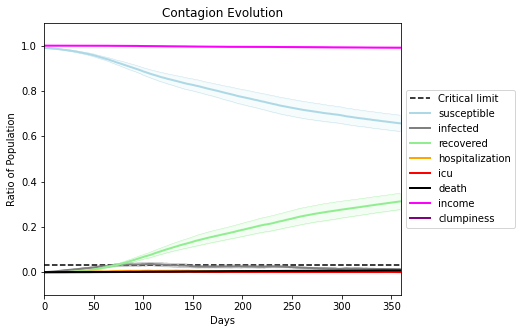

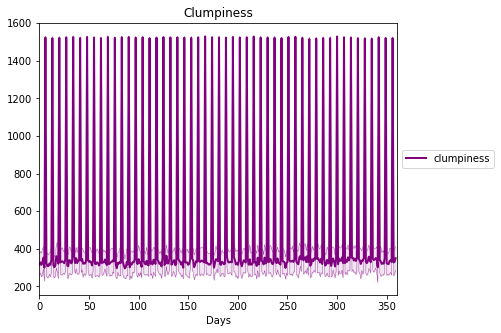

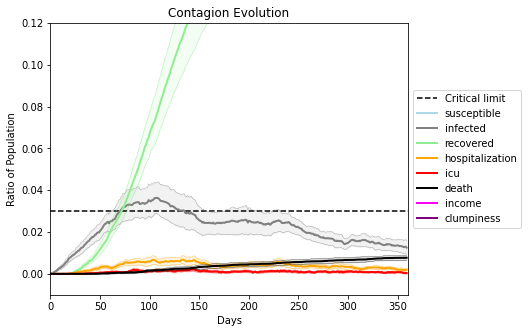

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8390, 5430, 6535, 995, 2819, 8477, 5434, 8646, 1612, 8201, 4979, 3221, 5312, 3090, 4129, 9399, 2206, 168, 1489, 7610]
Average similarity between family members is 0.9299200411678934 at temperature -0.993
Average similarity between family and home is 0.9998543906685637 at temperature -1
Average similarity between students and their classroom is 0.853043114669602 at temperature -0.993
Average classroom occupancy is 1.652694610778443 and number classrooms is 167
Average similarity between workers is 0.8705968537024952 at temperature -0.993
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.8504476024835376 for kids: 0.7219845872043391
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.7161265957940615
avg restaurant similarity 0.4274841254912466
avg restaurant similarity 0.6077269867826073
avg restaurant similarity 0.5685530325573795
avg restaurant similarity 0.481395414886052
avg restaurant similarity 0.6551775968650081
avg restaurant similarity 0.23036143513984106
avg restaurant similarity 0.4298368619289855
avg restaurant similarity 0.36605827576808264
avg restaurant similarity 0.7500381969241303
avg restaurant similarity 0.7124238161513681
avg restaurant similarity 0.722849611574646
avg restaurant similarity 0.5010064474478573
avg restaurant similarity 0.5019833251882662
avg restaurant similarity 0.6458318417081759
avg restaurant similarity 0.9022391604310316
avg restaurant similarity 0.6387716633747593
avg restaurant similarity 0.5208634139988071
avg restaurant similarity 0.5948325244680036
avg restaurant similarity 0.47038881808206023
avg restaurant similarity 0.07240388395195403
avg restaurant similarity 0.8420857165029904
avg rest

avg restaurant similarity 0.9992781800490247
avg restaurant similarity 0.5322896984178629
Average similarity between family members is 0.9248112949057272 at temperature -0.993
Average similarity between family and home is 0.9998550784148751 at temperature -1
Average similarity between students and their classroom is 0.8667095461729649 at temperature -0.993
Average classroom occupancy is 1.7543859649122806 and number classrooms is 171
Average similarity between workers is 0.8787924376449782 at temperature -0.993
Average office occupancy is 3.2653061224489797 and number offices is 196
Average friend similarity for adults: 0.8460037009327533 for kids: 0.7277012621488795
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.6059964072487893
avg restaurant similarity 0.3544473436109419
avg restaurant similarity 0.5086012740252173
avg restaurant similarity 0.4895209101545338
avg restaurant similarity 0.5295881020955203
avg restaurant similarity 0.2865374616966303
avg restaurant similarity 0.8678474455704263
avg restaurant similarity 0.5498105969419393
avg restaurant similarity 0.3438666611317305
avg restaurant similarity 0.5432387683088395
avg restaurant similarity 0.4350869321214305
avg restaurant similarity 0.39143357658678607
avg restaurant similarity 0.6045117399254025
avg restaurant similarity 0.7377264105383976
avg restaurant similarity 0.6313276919402904
avg restaurant similarity 0.3496573239232998
avg restaurant similarity 0.625302498564588
avg restaurant similarity 0.4838732571470949
avg restaurant similarity 0.7590026543239883
avg restaurant similarity 0.7233307192581869
avg restaurant similarity 0.5289367033565172
avg restaurant similarity 0.31214129804065066
avg resta

Average similarity between workers is 0.8632349008680347 at temperature -0.993
Average office occupancy is 3.3979591836734695 and number offices is 196
Average friend similarity for adults: 0.8364849163770146 for kids: 0.7125377831510531
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of

avg restaurant similarity 0.8042985122852735
avg restaurant similarity 0.5874553610344465
avg restaurant similarity 0.9993713001712979
avg restaurant similarity 0.5076278075613666
avg restaurant similarity 0.6147939645320437
avg restaurant similarity 0.8957100575670033
avg restaurant similarity 0.6074915850274527
avg restaurant similarity 0.48413316802193296
avg restaurant similarity 0.6124728864087159
avg restaurant similarity 0.999665114046921
avg restaurant similarity 0.4746028628654823
avg restaurant similarity 0.5493213687696661
avg restaurant similarity 0.456050828762765
avg restaurant similarity 0.5159512014175278
avg restaurant similarity 0.5055623272791305
avg restaurant similarity 0.5405656456383882
avg restaurant similarity 0.407093094187396
avg restaurant similarity 0.6139029379824293
avg restaurant similarity 0.16160984849954724
avg restaurant similarity 0.6372936128185556
avg restaurant similarity 0.6139029379824293
avg restaurant similarity 0.4608505112680742
avg restaur

avg restaurant similarity 0.5188268752212549
avg restaurant similarity 0.7567369797989982
avg restaurant similarity 0.46769394386810215
avg restaurant similarity 0.6092257243992489
avg restaurant similarity 0.6631058752162159
avg restaurant similarity 0.5404537519396893
avg restaurant similarity 0.6139029379824293
avg restaurant similarity 0.8779927036082797
avg restaurant similarity 0.23497020525871803
avg restaurant similarity 0.9998583200007078
avg restaurant similarity 0.49878579928443534
avg restaurant similarity 0.6534606227409103
avg restaurant similarity 0.6254043167463049
avg restaurant similarity 0.22141768226099157
avg restaurant similarity 0.8779927036082797
avg restaurant similarity 0.7181623036886922
avg restaurant similarity 0.6534606227409103
avg restaurant similarity 0.4244508932348847
avg restaurant similarity 0.37707297355984754
avg restaurant similarity 0.7190750861776031
avg restaurant similarity 0.5123664264400891
avg restaurant similarity 0.5926126452351882
avg r

avg restaurant similarity 0.6043786373865264
avg restaurant similarity 0.4661129969510688
avg restaurant similarity 0.4543309654520453
avg restaurant similarity 0.44380625227414294
avg restaurant similarity 0.8813816480793024
avg restaurant similarity 0.5526945917181985
avg restaurant similarity 0.630534412120974
avg restaurant similarity 0.38990792350942605
avg restaurant similarity 0.4643279387621386
avg restaurant similarity 0.8813816480793024
avg restaurant similarity 0.207208117725864
avg restaurant similarity 0.6393398259921153
avg restaurant similarity 0.6340133733860591
avg restaurant similarity 0.30696978509312306
avg restaurant similarity 0.7947423785680641
avg restaurant similarity 0.5295052521274787
avg restaurant similarity 0.3081683030454723
avg restaurant similarity 0.3067270491400532
avg restaurant similarity 0.3281308030003854
avg restaurant similarity 0.5187571413120601
avg restaurant similarity 0.8833239877738699
avg restaurant similarity 0.38990792350942605
avg rest

avg restaurant similarity 0.5560332289530886
avg restaurant similarity 0.6149227173059113
avg restaurant similarity 0.3763601830450618
avg restaurant similarity 0.5000646738414134
avg restaurant similarity 0.5329523616276952
avg restaurant similarity 0.6878655405526022
avg restaurant similarity 0.49880359792773
avg restaurant similarity 0.8074981818318906
avg restaurant similarity 0.5050635126841488
avg restaurant similarity 0.5429470545494778
avg restaurant similarity 0.34182273476663366
avg restaurant similarity 0.2381039212229874
avg restaurant similarity 0.7337588328075285
avg restaurant similarity 0.3738001456105635
avg restaurant similarity 0.4414518450109652
Average similarity between family members is 0.9341883034779264 at temperature -0.993
Average similarity between family and home is 0.9998560265561616 at temperature -1
Average similarity between students and their classroom is 0.8610795358528811 at temperature -0.993
Average classroom occupancy is 1.5813953488372092 and num

avg restaurant similarity 0.4439343055990349
avg restaurant similarity 0.5789056853994513
avg restaurant similarity 0.4311255579918123
avg restaurant similarity 0.6285364254469965
avg restaurant similarity 0.25953942577024863
avg restaurant similarity 0.39206885578214223
avg restaurant similarity 0.4992263589194028
avg restaurant similarity 0.7255123802093528
avg restaurant similarity 0.5858151671694506
avg restaurant similarity 0.24575891494621047
avg restaurant similarity 0.8886112676923966
avg restaurant similarity 0.5751933302173206
avg restaurant similarity 0.5082635989090452
avg restaurant similarity 0.5461471491996802
avg restaurant similarity 0.46380031665865884
avg restaurant similarity 0.3538614197444283
avg restaurant similarity 0.6341116149365296
avg restaurant similarity 0.30609509384010003
avg restaurant similarity 0.5532771371276849
avg restaurant similarity 0.444313126538056
avg restaurant similarity 0.5036756368087384
avg restaurant similarity 0.6046154412138783
avg re

avg restaurant similarity 0.5391374561411713
avg restaurant similarity 0.8639728838746993
avg restaurant similarity 0.51316826216252
avg restaurant similarity 0.4432118596799868
avg restaurant similarity 0.5871444863428623
avg restaurant similarity 0.5310652671500943
avg restaurant similarity 0.5446936192215888
avg restaurant similarity 0.6470855783589832
avg restaurant similarity 0.49753550134477753
avg restaurant similarity 0.46548969257672135
avg restaurant similarity 0.4780840664683616
avg restaurant similarity 0.3657054193639656
avg restaurant similarity 0.35283315493314865
avg restaurant similarity 0.6248964847951108
avg restaurant similarity 0.5079281586404005
avg restaurant similarity 0.6597562406205656
avg restaurant similarity 0.7997937221249481
avg restaurant similarity 0.8251263165175886
avg restaurant similarity 0.6663866449967593
avg restaurant similarity 0.46829366925864696
avg restaurant similarity 0.579685930550659
avg restaurant similarity 0.5018244732356341
avg resta

avg restaurant similarity 0.7886548748396913
avg restaurant similarity 0.8045214128910916
avg restaurant similarity 0.781244503254809
avg restaurant similarity 0.624851613992091
avg restaurant similarity 0.7773832576565798
avg restaurant similarity 0.8557727413844657
avg restaurant similarity 0.49753550134477753
avg restaurant similarity 0.5042516346931997
avg restaurant similarity 0.530231598849412
avg restaurant similarity 0.3965882055816872
avg restaurant similarity 0.643089633075568
avg restaurant similarity 0.5464270963565895
avg restaurant similarity 0.5953945392572305
avg restaurant similarity 0.6991309145063612
avg restaurant similarity 0.8126423266387948
avg restaurant similarity 0.7882367465640466
avg restaurant similarity 0.49171920615018605
avg restaurant similarity 0.51316826216252
avg restaurant similarity 0.7012162845946217
avg restaurant similarity 0.5575780147733872
avg restaurant similarity 0.6436064151487103
avg restaurant similarity 0.6742030254056305
avg restaurant

avg restaurant similarity 0.3336366125111736
avg restaurant similarity 0.37750221353425367
avg restaurant similarity 0.3146100864683816
avg restaurant similarity 0.4147226099415912
avg restaurant similarity 0.5593856600162936
avg restaurant similarity 0.6536415064716632
avg restaurant similarity 0.27860192053111543
avg restaurant similarity 0.5150162893259307
avg restaurant similarity 0.9997963921586159
avg restaurant similarity 0.4683544132500886
avg restaurant similarity 0.6785601824648206
avg restaurant similarity 0.9191072292029828
avg restaurant similarity 0.5877610751949063
avg restaurant similarity 0.6024257691800675
avg restaurant similarity 0.42804100163576186
avg restaurant similarity 0.47143351710238185
avg restaurant similarity 0.5220221711357367
avg restaurant similarity 0.7669340158180742
avg restaurant similarity 0.6843157663600943
avg restaurant similarity 0.6844488690498113
avg restaurant similarity 0.6785092777753617
avg restaurant similarity 0.5091024505687313
avg re

avg restaurant similarity 0.4663535053799296
avg restaurant similarity 0.5171743599413885
avg restaurant similarity 0.40779512914140614
avg restaurant similarity 0.45373035118364935
avg restaurant similarity 0.6017146569312897
avg restaurant similarity 0.523486934164413
avg restaurant similarity 0.07399892221940035
avg restaurant similarity 0.32387603063731496
avg restaurant similarity 0.448195756796948
avg restaurant similarity 0.5709307302476332
avg restaurant similarity 0.6357197174535045
avg restaurant similarity 0.4857462788131599
avg restaurant similarity 0.49801784841190094
avg restaurant similarity 0.44728616108166835
avg restaurant similarity 0.5204369589274052
avg restaurant similarity 0.5799060769303811
avg restaurant similarity 0.4136563295621979
avg restaurant similarity 0.3698230661440539
avg restaurant similarity 0.5729931810983899
avg restaurant similarity 0.35319471711821565
avg restaurant similarity 0.9983768898459504
avg restaurant similarity 0.45219864094940937
avg 

avg restaurant similarity 0.5728374602452958
avg restaurant similarity 0.381592626462838
avg restaurant similarity 0.6852585613238046
avg restaurant similarity 0.9175312778431195
avg restaurant similarity 0.45780904527209143
avg restaurant similarity 0.37988475227614726
avg restaurant similarity 0.5884003755621344
avg restaurant similarity 0.8522598826035117
avg restaurant similarity 0.5940715337540788
avg restaurant similarity 0.9998136708246869
avg restaurant similarity 0.5042972576509781
avg restaurant similarity 0.634204779482671
avg restaurant similarity 0.2660254741592279
avg restaurant similarity 0.34263671905357684
avg restaurant similarity 0.42049096635208655
avg restaurant similarity 0.3232573868183998
avg restaurant similarity 0.9038528225803438
avg restaurant similarity 0.29487770004456026
avg restaurant similarity 0.38432226667449815
avg restaurant similarity 0.23826723918860745
avg restaurant similarity 0.5963294569779829
avg restaurant similarity 0.3354246553564704
avg r

avg restaurant similarity 0.7518993550494103
avg restaurant similarity 0.327422636938934
avg restaurant similarity 0.5347583649645137
avg restaurant similarity 0.4509614576901831
avg restaurant similarity 0.33886104634631964
avg restaurant similarity 0.4073148182501084
avg restaurant similarity 0.4625351686221748
avg restaurant similarity 0.24461579527409988
avg restaurant similarity 0.5966829821043257
Average similarity between family members is 0.9332298624389906 at temperature -0.993
Average similarity between family and home is 0.9998631563219056 at temperature -1
Average similarity between students and their classroom is 0.8546881081503831 at temperature -0.993
Average classroom occupancy is 1.6684491978609626 and number classrooms is 187
Average similarity between workers is 0.8806997915810566 at temperature -0.993
Average office occupancy is 3.2261306532663316 and number offices is 199
Average friend similarity for adults: 0.8489510725288998 for kids: 0.7331438289023221
home_dis

avg restaurant similarity 0.4902315297628851
avg restaurant similarity 0.5828936125789512
avg restaurant similarity 0.403499204705874
avg restaurant similarity 0.5458794887168918
avg restaurant similarity 0.5322959877860116
avg restaurant similarity 0.6037357671776509
avg restaurant similarity 0.624066655847833
avg restaurant similarity 0.6266688462562597
avg restaurant similarity 0.48395627930461327
avg restaurant similarity 0.6346726690398655
avg restaurant similarity 0.6214864840118373
avg restaurant similarity 0.6975517914079367
avg restaurant similarity 0.32045692737121756
avg restaurant similarity 0.6067230653655418
avg restaurant similarity 0.5367971705758146
avg restaurant similarity 0.6504877856302655
avg restaurant similarity 0.8530592903812471
avg restaurant similarity 0.5415635108781772
avg restaurant similarity 0.638007586878537
avg restaurant similarity 0.8963576871078084
avg restaurant similarity 0.3078951111530963
avg restaurant similarity 0.5814559809366083
avg restaur

avg restaurant similarity 0.4957235816685248
avg restaurant similarity 0.6949148976954639
avg restaurant similarity 0.6095139076083891
avg restaurant similarity 0.5113741650547333
avg restaurant similarity 0.5914810958457115
avg restaurant similarity 0.6121252906461232
avg restaurant similarity 0.5897426229279606
avg restaurant similarity 0.6673379543051103
avg restaurant similarity 0.47455106658711954
avg restaurant similarity 0.6424607103479422
avg restaurant similarity 0.9999418782029746
avg restaurant similarity 0.6693803799732856
avg restaurant similarity 0.4998396188923756
avg restaurant similarity 0.5906522652969208
avg restaurant similarity 0.6693803799732856
avg restaurant similarity 0.42782960830743677
avg restaurant similarity 0.42885755975952045
avg restaurant similarity 0.7434848798484666
avg restaurant similarity 0.2790125660187858
avg restaurant similarity 0.6019116607644154
avg restaurant similarity 0.5127270933088717
avg restaurant similarity 0.2847727803871093
avg res

avg restaurant similarity 0.37694008863473955
avg restaurant similarity 0.4373863400877193
avg restaurant similarity 0.6637986840101586
avg restaurant similarity 0.7061647291945643
avg restaurant similarity 0.4510007399668537
avg restaurant similarity 0.5302845633384617
avg restaurant similarity 0.39454562334589177
avg restaurant similarity 0.6721758829043633
avg restaurant similarity 0.50983297065212
avg restaurant similarity 0.6374258446085406
avg restaurant similarity 0.4692772566109641
avg restaurant similarity 0.5589166571053272
avg restaurant similarity 0.27557819760735036
avg restaurant similarity 0.46618867047204415
avg restaurant similarity 0.6097207844663065
avg restaurant similarity 0.40021766804592296
avg restaurant similarity 0.346918041562565
avg restaurant similarity 0.4297510723930038
avg restaurant similarity 0.4692772566109641
avg restaurant similarity 0.39602681768191406
avg restaurant similarity 0.5302845633384617
avg restaurant similarity 0.36841912370966307
avg re

avg restaurant similarity 0.4987390789659043
avg restaurant similarity 0.6516248870228084
avg restaurant similarity 0.3156828968594112
avg restaurant similarity 0.5668728910031763
avg restaurant similarity 0.5984234208593455
avg restaurant similarity 0.29991561119523336
avg restaurant similarity 0.6992621771320584
avg restaurant similarity 0.5984234208593455
avg restaurant similarity 0.4556461078657673
avg restaurant similarity 0.6295693617946114
avg restaurant similarity 0.6992621771320584
avg restaurant similarity 0.43618670187223985
avg restaurant similarity 0.6184539502112745
avg restaurant similarity 0.9997089431403452
avg restaurant similarity 0.5000067943358485
avg restaurant similarity 0.3919263628571043
avg restaurant similarity 0.4183036636840044
avg restaurant similarity 0.3941740953842481
avg restaurant similarity 0.5993462602951455
avg restaurant similarity 0.4021708498082195
avg restaurant similarity 0.5008992381478758
avg restaurant similarity 0.41333340543981173
avg res

avg restaurant similarity 0.5758183303089968
avg restaurant similarity 0.6946702870923172
avg restaurant similarity 0.3991954097697541
avg restaurant similarity 0.6375843058273283
avg restaurant similarity 0.4724878034176685
avg restaurant similarity 0.5556636949860848
avg restaurant similarity 0.5902156054246962
avg restaurant similarity 0.5732032981155204
avg restaurant similarity 0.9995102271411459
avg restaurant similarity 0.6946702870923172
avg restaurant similarity 0.6253154720627457
avg restaurant similarity 0.4374750691381566
avg restaurant similarity 0.5611839330956775
avg restaurant similarity 0.8406669083677489
avg restaurant similarity 0.840766520284816
avg restaurant similarity 0.3521633033647472
avg restaurant similarity 0.5519538255790701
avg restaurant similarity 0.4539515783089178
avg restaurant similarity 0.6134179564446975
avg restaurant similarity 0.4736357229899593
avg restaurant similarity 0.43451945171304407
avg restaurant similarity 0.5310893605653637
avg restau

avg restaurant similarity 0.544206471758181
avg restaurant similarity 0.38042677160857885
avg restaurant similarity 0.3547902633866773
avg restaurant similarity 0.7812480954847165
avg restaurant similarity 0.784574862157429
avg restaurant similarity 0.6140531720223652
avg restaurant similarity 0.3774033075525093
avg restaurant similarity 0.3909668609815821
avg restaurant similarity 0.6017586739715888
avg restaurant similarity 0.876679521017947
avg restaurant similarity 0.4491158049329229
avg restaurant similarity 0.474789765613972
avg restaurant similarity 0.35281459769376766
avg restaurant similarity 0.40235601302591406
avg restaurant similarity 0.48495890391567187
avg restaurant similarity 0.6051627264489552
avg restaurant similarity 0.880089903591103
avg restaurant similarity 0.6791187727254397
avg restaurant similarity 0.9989583197148839
avg restaurant similarity 0.8182415375679928
avg restaurant similarity 0.3466352471183555
avg restaurant similarity 0.7989348117661307
avg restaur

avg restaurant similarity 0.5686492952384614
avg restaurant similarity 0.8055164980194701
avg restaurant similarity 0.45687422367499364
avg restaurant similarity 0.3680635959999005
avg restaurant similarity 0.519933301570727
avg restaurant similarity 0.7089926456165504
avg restaurant similarity 0.8988676860465233
avg restaurant similarity 0.5124367734625643
avg restaurant similarity 0.3964218950231999
avg restaurant similarity 0.41256746684082957
avg restaurant similarity 0.8648340310687357
avg restaurant similarity 0.8644270824216866
avg restaurant similarity 0.6108467409605227
avg restaurant similarity 0.4994911401193214
avg restaurant similarity 0.4555833081879631
avg restaurant similarity 0.861137756297583
avg restaurant similarity 0.5132916895322495
avg restaurant similarity 0.5800709809638539
avg restaurant similarity 0.7256879138734096
avg restaurant similarity 0.39773672962256573
avg restaurant similarity 0.37115799740700695
avg restaurant similarity 0.5724625560895669
avg rest

avg restaurant similarity 0.9994172010315558
avg restaurant similarity 0.46234621071982174
avg restaurant similarity 0.7456438793723792
avg restaurant similarity 0.7166576200684561
avg restaurant similarity 0.4433751102396709
avg restaurant similarity 0.5605968912555461
avg restaurant similarity 0.506586045873178
avg restaurant similarity 0.4771591137565501
avg restaurant similarity 0.7102614598080812
avg restaurant similarity 0.5940422172277864
avg restaurant similarity 0.592552736014762
avg restaurant similarity 0.7185977282815859
avg restaurant similarity 0.41494525304450397
avg restaurant similarity 0.5643004533048828
avg restaurant similarity 0.5178290433447355
avg restaurant similarity 0.519933301570727
avg restaurant similarity 0.8062860615215903
avg restaurant similarity 0.4436817580872672
avg restaurant similarity 0.5430220372498631
avg restaurant similarity 0.864467751797158
avg restaurant similarity 0.648757131841365
avg restaurant similarity 0.39234889636134396
avg restaura

avg restaurant similarity 0.4459142675743853
avg restaurant similarity 0.333585500367395
avg restaurant similarity 0.46466920813179213
avg restaurant similarity 0.6594710626037147
avg restaurant similarity 0.08953391735259042
avg restaurant similarity 0.36378904885915675
avg restaurant similarity 0.9997211737399755
avg restaurant similarity 0.4016764500519743
avg restaurant similarity 0.619570506842746
avg restaurant similarity 0.5102556063267416
avg restaurant similarity 0.731952905977199
avg restaurant similarity 0.2967204977205743
avg restaurant similarity 0.5234110703400251
avg restaurant similarity 0.3943417630182286
avg restaurant similarity 0.3438769761875548
avg restaurant similarity 0.47113246816871535
avg restaurant similarity 0.35645866353858024
avg restaurant similarity 0.5951169467713378
avg restaurant similarity 0.34725792522534077
avg restaurant similarity 0.6142633587328109
avg restaurant similarity 0.4057551291229515
avg restaurant similarity 0.333585500367395
avg rest

Average similarity between workers is 0.8693249225239298 at temperature -0.993
Average office occupancy is 3.4742268041237114 and number offices is 194
Average friend similarity for adults: 0.8495025925248274 for kids: 0.7120226744862186
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.627326727780289
avg restaurant similarity 0.43156606899989164
avg restaurant similarity 0.3584945279662582
avg restaurant similarity 0.5805059165742943
avg restaurant similarity 0.5892437226804501
avg restaurant similarity 0.39902245832597794
avg restaurant similarity 0.6334730297112299
avg restaurant similarity 0.5702021038812908
avg restaurant similarity 0.4376402877131138
avg restaurant similarity 0.258020240595153
avg restaurant similarity 0.33022149471558854
avg restaurant similarity 0.48239401947432625
avg restaurant similarity 0.4520310820502811
avg restaurant similarity 0.556778947409436
avg restaurant similarity 0.6803460051782408
avg restaurant similarity 0.6480297902674332
avg restaurant similarity 0.22086905530000434
avg restaurant similarity 0.7625653460726645
avg restaurant similarity 0.2217753128921428
avg restaurant similarity 0.9998278174783946
avg restaurant similarity 0.5892437226804501
avg restaurant similarity 0.4887996898388469
avg rest

avg restaurant similarity 0.5322364699906121
avg restaurant similarity 0.7113074569063264
avg restaurant similarity 0.5877223592987065
avg restaurant similarity 0.5705515912054345
avg restaurant similarity 0.5122520794467342
avg restaurant similarity 0.628685421751966
avg restaurant similarity 0.34557481489997244
avg restaurant similarity 0.4684295378806965
avg restaurant similarity 0.49376983625603665
avg restaurant similarity 0.6239064184064467
avg restaurant similarity 0.5362702682042036
avg restaurant similarity 0.6373409745325249
avg restaurant similarity 0.6390157314565293
avg restaurant similarity 0.5567429526022492
avg restaurant similarity 0.6088820886508665
avg restaurant similarity 0.378837054175753
avg restaurant similarity 0.40938023125850304
avg restaurant similarity 0.07121433094369631
avg restaurant similarity 0.5615785825952873
avg restaurant similarity 0.5623708072107364
avg restaurant similarity 0.39933499511416604
avg restaurant similarity 0.4013795890923372
avg res

avg restaurant similarity 0.5172075237231741
avg restaurant similarity 0.8562467838146787
avg restaurant similarity 0.4753672407758927
avg restaurant similarity 0.5249345360651458
avg restaurant similarity 0.0990637967187101
avg restaurant similarity 0.36717018914151905
avg restaurant similarity 0.5203201211163018
avg restaurant similarity 0.5839130773969596
avg restaurant similarity 0.3080605542945918
avg restaurant similarity 0.40331603061036286
avg restaurant similarity 0.8405039815245093
avg restaurant similarity 0.6687326287609878
avg restaurant similarity 0.3831701806509665
avg restaurant similarity 0.46778774226041764
avg restaurant similarity 0.38410749848039993
avg restaurant similarity 0.47305999150343475
avg restaurant similarity 0.5258176487470934
avg restaurant similarity 0.4493158663466368
avg restaurant similarity 0.5515653749961942
avg restaurant similarity 0.46239221455985596
avg restaurant similarity 0.5175868888355328
avg restaurant similarity 0.38142420897009943
avg

avg restaurant similarity 0.7105519667547594
avg restaurant similarity 0.49284904626426707
avg restaurant similarity 0.5159186354011882
avg restaurant similarity 0.443231164241229
avg restaurant similarity 0.5770376809916717
avg restaurant similarity 0.4441271134526968
avg restaurant similarity 0.5275412911243116
avg restaurant similarity 0.38955435947844747
avg restaurant similarity 0.39591880948209235
avg restaurant similarity 0.46885184771542504
avg restaurant similarity 0.362065416325961
avg restaurant similarity 0.3657365215480439
avg restaurant similarity 0.5320209191524166
avg restaurant similarity 0.362065416325961
avg restaurant similarity 0.5233660974793818
avg restaurant similarity 0.49533165400779655
avg restaurant similarity 0.5114173277797612
avg restaurant similarity 0.5073322954895223
avg restaurant similarity 0.44367202453249976
avg restaurant similarity 0.5572450939697767
avg restaurant similarity 0.4577407507523774
avg restaurant similarity 0.6676252478166095
avg res

avg restaurant similarity 0.588188281300011
avg restaurant similarity 0.424080455853478
avg restaurant similarity 0.7461057025871014
avg restaurant similarity 0.5964432838229835
avg restaurant similarity 0.6122860651694204
avg restaurant similarity 0.8419776880244414
avg restaurant similarity 0.5696705867312466
avg restaurant similarity 0.616086365035735
avg restaurant similarity 0.7636659313309136
avg restaurant similarity 0.47981614435725006
avg restaurant similarity 0.6921191921886203
avg restaurant similarity 0.5566628423629489
avg restaurant similarity 0.5771027911774107
avg restaurant similarity 0.3640565579766841
avg restaurant similarity 0.6783817684229746
avg restaurant similarity 0.3833603461127034
avg restaurant similarity 0.45081478617066595
avg restaurant similarity 0.34286601634215874
avg restaurant similarity 0.6556088770131394
avg restaurant similarity 0.745758007655572
avg restaurant similarity 0.8459598045946636
avg restaurant similarity 0.374622009334041
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

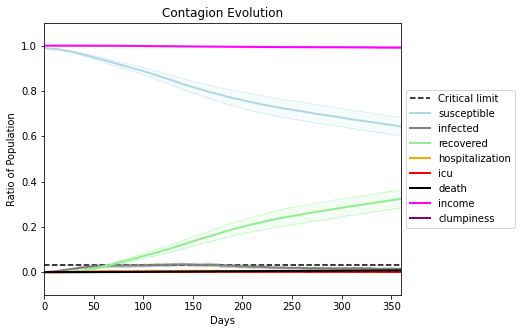

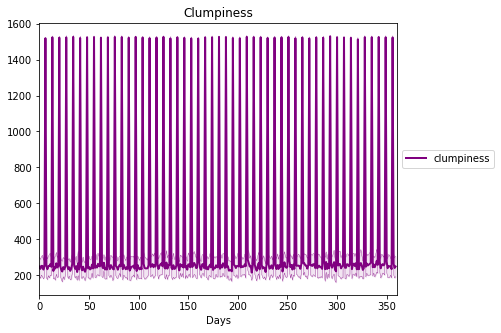

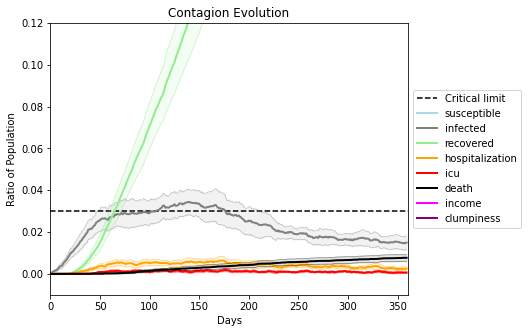

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1435, 9520, 744, 8208, 2863, 8656, 5796, 9513, 3712, 1634, 7674, 2927, 7432, 6533, 3396, 5266, 9532, 2691, 2184, 7102]
Average similarity between family members is 0.9173678440932658 at temperature -0.992
Average similarity between family and home is 0.9998481053652122 at temperature -1
Average similarity between students and their classroom is 0.8275299527840057 at temperature -0.992
Average classroom occupancy is 1.707182320441989 and number classrooms is 181
Average similarity between workers is 0.8554112620271972 at temperature -0.992
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.8458873620088857 for kids: 0.7405691119208129
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.4171488932629976
avg restaurant similarity 0.7080770768478186
avg restaurant similarity 0.7046304091755509
avg restaurant similarity 0.3793051341346012
avg restaurant similarity 0.8424797004975042
avg restaurant similarity 0.46878399546385
avg restaurant similarity 0.6884425367988697
avg restaurant similarity 0.5539240230991421
avg restaurant similarity 0.6500221629630158
avg restaurant similarity 0.6454104337189517
avg restaurant similarity 0.6328760115969585
avg restaurant similarity 0.8768095290917928
avg restaurant similarity 0.6223487853372787
avg restaurant similarity 0.48608086563253217
avg restaurant similarity 0.40058810719668897
avg restaurant similarity 0.5283392520796851
avg restaurant similarity 0.4513069669256008
avg restaurant similarity 0.4344726699703488
avg restaurant similarity 0.7929542707956458
avg restaurant similarity 0.68646658107643
avg restaurant similarity 0.7971985949266117
avg restaurant similarity 0.22617266551895532
avg restaur

avg restaurant similarity 0.38791053701517697
avg restaurant similarity 0.5693679929975902
avg restaurant similarity 0.5399032404616537
avg restaurant similarity 0.6495051537201227
avg restaurant similarity 0.37585055723347227
avg restaurant similarity 0.5508863448388879
avg restaurant similarity 0.29522297462149205
avg restaurant similarity 0.5389136631624641
avg restaurant similarity 0.6020531535503679
avg restaurant similarity 0.920007809453165
avg restaurant similarity 0.3898811278830445
avg restaurant similarity 0.9996955116280752
avg restaurant similarity 0.13613753094311218
avg restaurant similarity 0.4054690240152691
avg restaurant similarity 0.6053715372337695
avg restaurant similarity 0.42360885850736113
avg restaurant similarity 0.5719436344362584
avg restaurant similarity 0.5201290937740133
avg restaurant similarity 0.7404379100742662
avg restaurant similarity 0.2866057661292877
avg restaurant similarity 0.5301381190474032
avg restaurant similarity 0.4096185743358818
avg re

avg restaurant similarity 0.4684259508337274
avg restaurant similarity 0.623180022492501
avg restaurant similarity 0.4765536189191445
avg restaurant similarity 0.41120147376373917
avg restaurant similarity 0.4595589380427957
avg restaurant similarity 0.5477734820114604
avg restaurant similarity 0.5611744597912004
avg restaurant similarity 0.49207860269221515
avg restaurant similarity 0.31579250537545644
avg restaurant similarity 0.5323193216270218
avg restaurant similarity 0.46774021528575405
avg restaurant similarity 0.38311756933882307
avg restaurant similarity 0.6381958701306618
avg restaurant similarity 0.4348215308310886
avg restaurant similarity 0.4451598862867694
avg restaurant similarity 0.6320107486657561
avg restaurant similarity 0.4034832181388265
avg restaurant similarity 0.8242679911384655
avg restaurant similarity 0.4627180055508423
avg restaurant similarity 0.9997727620243442
avg restaurant similarity 0.4487318824454612
avg restaurant similarity 0.47066514713342594
avg r

avg restaurant similarity 0.550695034272016
avg restaurant similarity 0.8220847356579513
avg restaurant similarity 0.403913313392235
avg restaurant similarity 0.4466934792005466
Average similarity between family members is 0.9084113250297555 at temperature -0.992
Average similarity between family and home is 0.9998542451125597 at temperature -1
Average similarity between students and their classroom is 0.8310788063586105 at temperature -0.992
Average classroom occupancy is 1.6280487804878048 and number classrooms is 164
Average similarity between workers is 0.8394935744264392 at temperature -0.992
Average office occupancy is 3.4568527918781724 and number offices is 197
Average friend similarity for adults: 0.8414018388256299 for kids: 0.7071305299957784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.7463061911347721
avg restaurant similarity 0.8412052845318341
avg restaurant similarity 0.4246809228613299
avg restaurant similarity 0.5674399567250863
avg restaurant similarity 0.631567451976408
avg restaurant similarity 0.3154746692937981
avg restaurant similarity 0.31332273322126886
avg restaurant similarity 0.8326787527579124
avg restaurant similarity 0.6425835017188992
avg restaurant similarity 0.9994105067601277
avg restaurant similarity 0.9998326044297314
avg restaurant similarity 0.3154746692937981
avg restaurant similarity 0.6018689043828733
avg restaurant similarity 0.7396780667208244
avg restaurant similarity 0.5147446090647003
avg restaurant similarity 0.2709242909420964
avg restaurant similarity 0.3448979522430915
avg restaurant similarity 0.46182141118384057
avg restaurant similarity 0.5535229012853131
avg restaurant similarity 0.19687753436833844
avg restaurant similarity 0.5129138791137812
avg restaurant similarity 0.43885396170242963
avg res

avg restaurant similarity 0.6558649077089351
avg restaurant similarity 0.45070710302086603
avg restaurant similarity 0.4824594434516932
avg restaurant similarity 0.4014285016634491
avg restaurant similarity 0.20120997508552615
avg restaurant similarity 0.33230803927828484
avg restaurant similarity 0.4917032608961205
avg restaurant similarity 0.5348704839258605
avg restaurant similarity 0.3006236068920573
avg restaurant similarity 0.47965306991236917
avg restaurant similarity 0.41277119026015296
avg restaurant similarity 0.5752552280811601
avg restaurant similarity 0.2761030814970999
avg restaurant similarity 0.4421057594454987
avg restaurant similarity 0.5074339835178371
avg restaurant similarity 0.7741166544741418
avg restaurant similarity 0.5832442980785717
avg restaurant similarity 0.5826707699645568
avg restaurant similarity 0.5946938718244521
avg restaurant similarity 0.7741166544741418
avg restaurant similarity 0.4388646412056699
avg restaurant similarity 0.7960852719982732
avg r

avg restaurant similarity 0.5932202833912126
avg restaurant similarity 0.5411902281890323
avg restaurant similarity 0.5312536434014068
avg restaurant similarity 0.7971661284503284
avg restaurant similarity 0.416522965746148
avg restaurant similarity 0.5443159085528151
avg restaurant similarity 0.6236876819565041
avg restaurant similarity 0.8115053396786857
avg restaurant similarity 0.3791510078479215
avg restaurant similarity 0.4922011886467923
avg restaurant similarity 0.49379090659564595
avg restaurant similarity 0.4759590114022366
avg restaurant similarity 0.5588107675109584
avg restaurant similarity 0.41662614015423793
avg restaurant similarity 0.7479286320523774
avg restaurant similarity 0.6784030162623206
avg restaurant similarity 0.7900322539373461
avg restaurant similarity 0.5818648372705437
avg restaurant similarity 0.5784028025630974
avg restaurant similarity 0.6102323503828057
avg restaurant similarity 0.9997885088184246
avg restaurant similarity 0.5727262157204358
avg resta

avg restaurant similarity 0.42100493964238694
avg restaurant similarity 0.6436064339537128
avg restaurant similarity 0.3646686503048012
avg restaurant similarity 0.4265069509022727
avg restaurant similarity 0.36497534737950393
avg restaurant similarity 0.334273845785817
avg restaurant similarity 0.5301678031086836
avg restaurant similarity 0.8726689167689643
avg restaurant similarity 0.9995779765453631
avg restaurant similarity 0.42630411361429466
avg restaurant similarity 0.9995779765453631
avg restaurant similarity 0.46841736523380745
avg restaurant similarity 0.8882986419847941
avg restaurant similarity 0.44991762923349765
avg restaurant similarity 0.9992641033841494
avg restaurant similarity 0.44941348810620996
avg restaurant similarity 0.8588742896150581
avg restaurant similarity 0.6494177349276586
avg restaurant similarity 0.3600673826180488
avg restaurant similarity 0.3625447016831669
avg restaurant similarity 0.6144856033874784
avg restaurant similarity 0.3964629226332249
avg r

avg restaurant similarity 0.6724900506900631
avg restaurant similarity 0.424427743442659
avg restaurant similarity 0.5166975453876235
avg restaurant similarity 0.6469012813971269
avg restaurant similarity 0.4037526435400308
avg restaurant similarity 0.41321072713832174
avg restaurant similarity 0.9996731202098017
avg restaurant similarity 0.43778289968895956
avg restaurant similarity 0.5725898693138477
avg restaurant similarity 0.5329950794820837
avg restaurant similarity 0.6490397162833691
avg restaurant similarity 0.7505077933127997
avg restaurant similarity 0.41048304799544827
avg restaurant similarity 0.5157907162568236
avg restaurant similarity 0.37511062793095296
avg restaurant similarity 0.7248177853713872
avg restaurant similarity 0.885637986740811
avg restaurant similarity 0.28459956186841723
avg restaurant similarity 0.5810769673827472
avg restaurant similarity 0.1127022599285359
avg restaurant similarity 0.4983135077251637
avg restaurant similarity 0.9091059097126524
avg res

avg restaurant similarity 0.3654377623851959
avg restaurant similarity 0.5986300867016248
avg restaurant similarity 0.23138310190121103
avg restaurant similarity 0.8220317789855852
avg restaurant similarity 0.42755773717539775
avg restaurant similarity 0.8804322432409541
avg restaurant similarity 0.5412503874069228
avg restaurant similarity 0.5093956538612432
avg restaurant similarity 0.5292583689348268
avg restaurant similarity 0.5240695316245262
avg restaurant similarity 0.7213010119545407
avg restaurant similarity 0.4766732555351013
avg restaurant similarity 0.4901700852392918
avg restaurant similarity 0.45841682196892886
avg restaurant similarity 0.9995599470276231
avg restaurant similarity 0.5791796081919312
avg restaurant similarity 0.5011007117631804
avg restaurant similarity 0.9086128259525356
avg restaurant similarity 0.824983872975548
avg restaurant similarity 0.6410572701306518
avg restaurant similarity 0.3094034685635184
avg restaurant similarity 0.8464285404134824
avg rest

avg restaurant similarity 0.45299424876702815
avg restaurant similarity 0.8220317789855852
avg restaurant similarity 0.4770282646700288
avg restaurant similarity 0.37448013293059607
avg restaurant similarity 0.7707299184509122
avg restaurant similarity 0.8220317789855852
avg restaurant similarity 0.650793997217849
avg restaurant similarity 0.42751154223220345
avg restaurant similarity 0.5683617557308513
avg restaurant similarity 0.5927841674206523
avg restaurant similarity 0.425684852784474
avg restaurant similarity 0.47346999000966195
avg restaurant similarity 0.45397649762516146
avg restaurant similarity 0.8951326451504453
avg restaurant similarity 0.4211117047440298
avg restaurant similarity 0.435461931262616
avg restaurant similarity 0.5832360133272373
avg restaurant similarity 0.22795053491458808
avg restaurant similarity 0.4792936057226067
avg restaurant similarity 0.4231401755887382
avg restaurant similarity 0.5121142411918267
avg restaurant similarity 0.8091528649933061
avg res

avg restaurant similarity 0.3949084475454343
avg restaurant similarity 0.6706715106899892
avg restaurant similarity 0.5857963967928093
avg restaurant similarity 0.5207421781702457
avg restaurant similarity 0.25039055870268445
avg restaurant similarity 0.6388792006985436
avg restaurant similarity 0.9997533968035959
avg restaurant similarity 0.5330261489932886
avg restaurant similarity 0.5380322253318371
avg restaurant similarity 0.595969685595548
avg restaurant similarity 0.637668721528095
avg restaurant similarity 0.6511360579448633
avg restaurant similarity 0.4574244036113382
avg restaurant similarity 0.2678551288426161
avg restaurant similarity 0.8449489112220901
avg restaurant similarity 0.6704114595318609
avg restaurant similarity 0.8676148453446111
avg restaurant similarity 0.5368774499111124
avg restaurant similarity 0.19131302795386565
avg restaurant similarity 0.6103570282985193
avg restaurant similarity 0.6207395368956324
avg restaurant similarity 0.6231869661140094
avg restau

avg restaurant similarity 0.8435047644665159
avg restaurant similarity 0.43754232415789945
avg restaurant similarity 0.6574827373316685
avg restaurant similarity 0.6252499940110929
avg restaurant similarity 0.11033063525072442
avg restaurant similarity 0.5282629289201486
avg restaurant similarity 0.16366275047898365
avg restaurant similarity 0.9998136396717152
avg restaurant similarity 0.821838498187492
avg restaurant similarity 0.27571971277933266
avg restaurant similarity 0.4239136391272499
avg restaurant similarity 0.5282629289201486
avg restaurant similarity 0.4153197355735937
avg restaurant similarity 0.36008488997710714
avg restaurant similarity 0.16973993276124366
avg restaurant similarity 0.8966326074813935
avg restaurant similarity 0.5936274622602028
avg restaurant similarity 0.5370690868574235
avg restaurant similarity 0.8119842758876774
avg restaurant similarity 0.37557374125665743
avg restaurant similarity 0.5285840191319182
avg restaurant similarity 0.5806546776836294
avg 

avg restaurant similarity 0.6077514299692377
avg restaurant similarity 0.39714660650171363
avg restaurant similarity 0.6190220563916252
avg restaurant similarity 0.4624667227542303
avg restaurant similarity 0.5986466055538264
avg restaurant similarity 0.5590620832078289
avg restaurant similarity 0.5200733410706293
avg restaurant similarity 0.5389693919438586
avg restaurant similarity 0.5135840824352689
avg restaurant similarity 0.5156630137752135
avg restaurant similarity 0.43824361799018663
avg restaurant similarity 0.5088083575930037
avg restaurant similarity 0.2847793403821326
avg restaurant similarity 0.42953408047253105
avg restaurant similarity 0.6993668121034641
avg restaurant similarity 0.6886260577551
avg restaurant similarity 0.5629890928247776
avg restaurant similarity 0.5789962791024194
avg restaurant similarity 0.5957504694033056
avg restaurant similarity 0.6546002532222062
avg restaurant similarity 0.6055452659623183
avg restaurant similarity 0.4037372428752793
avg restau

avg restaurant similarity 0.6695373875571747
avg restaurant similarity 0.5003075946460642
avg restaurant similarity 0.6570355610593166
avg restaurant similarity 0.609079712457754
avg restaurant similarity 0.7555797731044507
avg restaurant similarity 0.3747794648317573
avg restaurant similarity 0.36610598541154327
avg restaurant similarity 0.3836989506540419
avg restaurant similarity 0.22347648003732484
avg restaurant similarity 0.15419658573965472
avg restaurant similarity 0.5345525667281008
avg restaurant similarity 0.4197608642413344
avg restaurant similarity 0.5543242129275654
avg restaurant similarity 0.6095420303778722
avg restaurant similarity 0.44496283481377086
avg restaurant similarity 0.1454847353268931
avg restaurant similarity 0.46926990392865175
avg restaurant similarity 0.5656349175544061
avg restaurant similarity 0.22695733748691646
avg restaurant similarity 0.5423823436571003
avg restaurant similarity 0.5385150375340522
avg restaurant similarity 0.6086260789682216
avg r

avg restaurant similarity 0.43625638955455764
avg restaurant similarity 0.5325774887947614
avg restaurant similarity 0.6309178152766143
avg restaurant similarity 0.566862107795055
avg restaurant similarity 0.48747109179895515
avg restaurant similarity 0.5290356287690872
avg restaurant similarity 0.9035792401970355
avg restaurant similarity 0.7603332530211389
avg restaurant similarity 0.6173178082442383
avg restaurant similarity 0.576954544493383
avg restaurant similarity 0.8434801524566742
avg restaurant similarity 0.8606349512636191
avg restaurant similarity 0.42481443067853675
avg restaurant similarity 0.4908806022451687
avg restaurant similarity 0.6524464673802011
avg restaurant similarity 0.5684434008921826
avg restaurant similarity 0.7846284941788301
avg restaurant similarity 0.46757950459071995
avg restaurant similarity 0.5462238966680968
avg restaurant similarity 0.6627228620172151
avg restaurant similarity 0.47301312092043113
avg restaurant similarity 0.6911717342713011
avg res

avg restaurant similarity 0.8649274616902032
avg restaurant similarity 0.6309178152766143
avg restaurant similarity 0.9099110199073599
avg restaurant similarity 0.7584597988026094
avg restaurant similarity 0.6835742670332305
avg restaurant similarity 0.42712484559039476
avg restaurant similarity 0.507769272172689
avg restaurant similarity 0.6683738685691485
avg restaurant similarity 0.5999151035572137
avg restaurant similarity 0.6844203776241828
avg restaurant similarity 0.5727095026233727
avg restaurant similarity 0.6937304289341291
avg restaurant similarity 0.6310706834636809
avg restaurant similarity 0.1447691798697064
avg restaurant similarity 0.42430337451356304
avg restaurant similarity 0.691718895432301
avg restaurant similarity 0.8649274616902032
avg restaurant similarity 0.5515225374425194
avg restaurant similarity 0.6529528294784468
avg restaurant similarity 0.8432980382272586
avg restaurant similarity 0.5325232619731334
avg restaurant similarity 0.5832973645182408
avg restau

avg restaurant similarity 0.5538156231802059
avg restaurant similarity 0.7410422587437525
avg restaurant similarity 0.62386261494064
avg restaurant similarity 0.6722940274576834
avg restaurant similarity 0.3061606140594504
avg restaurant similarity 0.386003229194935
avg restaurant similarity 0.632351618591894
avg restaurant similarity 0.5878368878707027
avg restaurant similarity 0.4216291843108241
avg restaurant similarity 0.8674009718041149
avg restaurant similarity 0.4179751420784036
avg restaurant similarity 0.6328985640746851
avg restaurant similarity 0.49275786189883586
avg restaurant similarity 0.6339592355757354
avg restaurant similarity 0.367625472181514
avg restaurant similarity 0.5014088540767792
avg restaurant similarity 0.4067975550664589
avg restaurant similarity 0.41127847745395524
avg restaurant similarity 0.5014088540767792
avg restaurant similarity 0.266989423784464
avg restaurant similarity 0.6239677137606474
avg restaurant similarity 0.4279251015354394
avg restaurant

avg restaurant similarity 0.34715683391544255
avg restaurant similarity 0.5795223403921519
avg restaurant similarity 0.5382905651495002
avg restaurant similarity 0.5393431350347042
avg restaurant similarity 0.4041363079231287
avg restaurant similarity 0.4297886040032876
avg restaurant similarity 0.5064003924234693
avg restaurant similarity 0.5646266639361421
avg restaurant similarity 0.5153939360869108
avg restaurant similarity 0.5023481986702187
avg restaurant similarity 0.42265488733915746
avg restaurant similarity 0.43049093144158923
avg restaurant similarity 0.49238418937269957
avg restaurant similarity 0.4717984444621218
avg restaurant similarity 0.41136073724364614
avg restaurant similarity 0.5339844966256975
avg restaurant similarity 0.3868285011499193
avg restaurant similarity 0.6443655876391499
avg restaurant similarity 0.4841883741304561
avg restaurant similarity 0.2858680493669957
avg restaurant similarity 0.583324183187856
avg restaurant similarity 0.33089266617089563
avg r

avg restaurant similarity 0.5097968344749555
avg restaurant similarity 0.3267655093283778
avg restaurant similarity 0.3699656828050639
avg restaurant similarity 0.32452216700920544
avg restaurant similarity 0.5860286440423984
avg restaurant similarity 0.432798376199499
avg restaurant similarity 0.32136504788481496
avg restaurant similarity 0.6755016677380499
avg restaurant similarity 0.4865179688345286
avg restaurant similarity 0.46138172818017553
avg restaurant similarity 0.6121793440165515
avg restaurant similarity 0.5412365224503889
avg restaurant similarity 0.30282068490887737
avg restaurant similarity 0.5252470189573479
avg restaurant similarity 0.4410561624206353
avg restaurant similarity 0.9997854686625485
avg restaurant similarity 0.8932150915503634
avg restaurant similarity 0.34745173952722197
avg restaurant similarity 0.44483997976800393
avg restaurant similarity 0.22328108915988543
avg restaurant similarity 0.4756664891504925
avg restaurant similarity 0.5028406406396266
avg 

avg restaurant similarity 0.6373976929873412
avg restaurant similarity 0.6126091119724565
avg restaurant similarity 0.40730382888627037
avg restaurant similarity 0.27795699122833223
avg restaurant similarity 0.4110001297854714
avg restaurant similarity 0.5480001960706453
avg restaurant similarity 0.49882442516846776
avg restaurant similarity 0.6877020542755616
avg restaurant similarity 0.34848120396303595
avg restaurant similarity 0.20288098271870622
avg restaurant similarity 0.438984500079298
avg restaurant similarity 0.4366766247640467
avg restaurant similarity 0.5869597192989405
avg restaurant similarity 0.49957141555918144
avg restaurant similarity 0.3807331969166286
avg restaurant similarity 0.15834672785429202
avg restaurant similarity 0.5264156907419916
avg restaurant similarity 0.7073040056572282
avg restaurant similarity 0.544872077974334
avg restaurant similarity 0.5000935285140965
avg restaurant similarity 0.6984447329453664
avg restaurant similarity 0.5948607069458596
avg r

Average similarity between workers is 0.8445824458764987 at temperature -0.992
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.8337915083546021 for kids: 0.7221085293049533
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.4459940168442169
avg restaurant similarity 0.6906391620339237
avg restaurant similarity 0.7173328775931774
avg restaurant similarity 0.5149899034216558
avg restaurant similarity 0.5926782969665325
avg restaurant similarity 0.4086761228713296
avg restaurant similarity 0.46969681500318755
avg restaurant similarity 0.4891210760614049
avg restaurant similarity 0.5151579440105857
avg restaurant similarity 0.5281120049872905
avg restaurant similarity 0.44644951194001226
avg restaurant similarity 0.4689498870093286
avg restaurant similarity 0.5529788222247862
avg restaurant similarity 0.5077336437949564
avg restaurant similarity 0.4821803033137856
avg restaurant similarity 0.49619159462568596
avg restaurant similarity 0.6025120572249666
avg restaurant similarity 0.49085909432712305
avg restaurant similarity 0.6792244175941491
avg restaurant similarity 0.3347303981171499
avg restaurant similarity 0.5854271969867009
avg restaurant similarity 0.9998070058876893
avg re

avg restaurant similarity 0.37799711618908904
avg restaurant similarity 0.5241645065990228
avg restaurant similarity 0.27838350416967167
avg restaurant similarity 0.450705014338896
avg restaurant similarity 0.6349568073747147
avg restaurant similarity 0.7041406136028238
avg restaurant similarity 0.726903941905815
avg restaurant similarity 0.6091540575159514
avg restaurant similarity 0.5854551433539944
avg restaurant similarity 0.21806460350640997
avg restaurant similarity 0.3056635323964878
avg restaurant similarity 0.5692528628372489
avg restaurant similarity 0.6783423896938445
avg restaurant similarity 0.42238634989054713
avg restaurant similarity 0.6054447275348637
avg restaurant similarity 0.48027795466515527
avg restaurant similarity -0.04764135763430705
avg restaurant similarity 0.18472292362935988
avg restaurant similarity 0.013394798003187547
avg restaurant similarity 0.527518831363455
avg restaurant similarity 0.32254956556035047
avg restaurant similarity 0.6272503178121315
av

avg restaurant similarity 0.5401211808277974
avg restaurant similarity 0.5340703168754359
avg restaurant similarity 0.8200755330924163
avg restaurant similarity 0.3221737993323778
avg restaurant similarity 0.3746661174309861
avg restaurant similarity 0.31877719121071413
avg restaurant similarity 0.4170240687757416
avg restaurant similarity 0.6284311060984047
avg restaurant similarity 0.43469853989286145
avg restaurant similarity 0.45090687877467994
avg restaurant similarity 0.5010689241437765
avg restaurant similarity 0.24415808316006485
avg restaurant similarity 0.31479070736219106
avg restaurant similarity 0.5472493283350224
avg restaurant similarity 0.853280040015217
avg restaurant similarity 0.5948555032607655
avg restaurant similarity 0.8456093005540869
avg restaurant similarity 0.24415808316006485
avg restaurant similarity 0.26997437600382
avg restaurant similarity 0.9065617698875583
avg restaurant similarity -0.04063512625720514
avg restaurant similarity 0.5106653747913639
avg r

avg restaurant similarity 0.4537137068395404
avg restaurant similarity 0.9996912927740685
avg restaurant similarity 0.48588810315224285
avg restaurant similarity 0.4955001072800228
avg restaurant similarity 0.24959315478292163
avg restaurant similarity 0.6182638457559302
avg restaurant similarity 0.454776531917016
avg restaurant similarity 0.5896981974887462
avg restaurant similarity 0.5264953406115129
avg restaurant similarity 0.45173946053863356
avg restaurant similarity 0.84559080880957
avg restaurant similarity 0.4016151138791526
avg restaurant similarity 0.4682956072663209
avg restaurant similarity 0.2147716585975023
avg restaurant similarity 0.4703726835409153
avg restaurant similarity 0.7039070817830075
avg restaurant similarity 0.31018034469260436
avg restaurant similarity 0.13305058181844018
avg restaurant similarity 0.7238082454185883
avg restaurant similarity 0.3795357477686209
avg restaurant similarity 0.6284311060984047
avg restaurant similarity 0.3392141163214893
avg rest

avg restaurant similarity 0.47026660102252
avg restaurant similarity 0.5768827679696149
avg restaurant similarity 0.45134534342156324
avg restaurant similarity 0.7002860156635673
avg restaurant similarity 0.7515718464996562
avg restaurant similarity 0.552721131847193
avg restaurant similarity 0.4105121055990196
avg restaurant similarity 0.5818678136772533
avg restaurant similarity 0.49686399437232015
avg restaurant similarity 0.2899164170877209
avg restaurant similarity 0.4371257371941247
avg restaurant similarity 0.58134737330294
avg restaurant similarity 0.2935648413718531
avg restaurant similarity 0.5893275736248315
avg restaurant similarity 0.36670724886380596
avg restaurant similarity 0.5796656011023203
avg restaurant similarity 0.6662389051332996
avg restaurant similarity 0.2572917542346574
avg restaurant similarity 0.5476177150477017
avg restaurant similarity 0.4570161839014857
avg restaurant similarity 0.6661559113717007
avg restaurant similarity 0.4130663601237929
avg restaura

Average similarity between family members is 0.9123228591034094 at temperature -0.992
Average similarity between family and home is 0.9998495222240376 at temperature -1
Average similarity between students and their classroom is 0.7823751539660814 at temperature -0.992
Average classroom occupancy is 1.6900584795321638 and number classrooms is 171
Average similarity between workers is 0.8368556872044901 at temperature -0.992
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.8337180879464238 for kids: 0.7158072950953601
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.4622483657627329
avg restaurant similarity 0.15002553693656226
avg restaurant similarity 0.3361864005545655
avg restaurant similarity 0.5704271226972288
avg restaurant similarity 0.9997360708612311
avg restaurant similarity 0.33240517174359074
avg restaurant similarity 0.653776576175492
avg restaurant similarity 0.6915567337880806
avg restaurant similarity 0.4938621371811074
avg restaurant similarity 0.37313112382001984
avg restaurant similarity 0.409393425829921
avg restaurant similarity 0.37018713869430075
avg restaurant similarity 0.2484313701167568
avg restaurant similarity 0.5490593938576214
avg restaurant similarity 0.7292438395734264
avg restaurant similarity 0.7759308912752632
avg restaurant similarity -0.03394991358050997
avg restaurant similarity 0.2750393702613492
avg restaurant similarity 0.5370395965781098
avg restaurant similarity 0.558686284051476
avg restaurant similarity 0.33468788368681257
avg restaurant similarity 0.4653572390882115
avg re

avg restaurant similarity 0.44186683303964563
avg restaurant similarity 0.5719577982119755
avg restaurant similarity 0.29500745730963984
avg restaurant similarity 0.4468149742254816
avg restaurant similarity 0.36015700291975505
avg restaurant similarity 0.32961647057016635
avg restaurant similarity 0.41253140389184867
avg restaurant similarity 0.34643882523670655
avg restaurant similarity 0.3361864005545655
avg restaurant similarity 0.5807478209523368
avg restaurant similarity 0.2922955604901576
avg restaurant similarity 0.24411217337131758
avg restaurant similarity 0.3365759965170999
avg restaurant similarity 0.4379502668351016
avg restaurant similarity 0.4092698398452007
avg restaurant similarity 0.45210572227125967
avg restaurant similarity 0.7490733921072823
avg restaurant similarity 0.2467971314320324
avg restaurant similarity 0.6863970808204376
avg restaurant similarity 0.33358403112094975
avg restaurant similarity 0.5709319829172741
avg restaurant similarity 0.33130236467923174


avg restaurant similarity 0.760177824161168
avg restaurant similarity 0.7623416698020828
avg restaurant similarity 0.5794953694371531
avg restaurant similarity 0.38174591779475553
avg restaurant similarity 0.3763758599457473
avg restaurant similarity 0.7793209948440857
avg restaurant similarity 0.5120711314291795
avg restaurant similarity 0.477738479321395
avg restaurant similarity 0.9124730564762754
avg restaurant similarity 0.9033764472522515
avg restaurant similarity 0.4808816994142239
avg restaurant similarity 0.6825606234345569
avg restaurant similarity 0.4026650983103941
avg restaurant similarity 0.5975181560340465
avg restaurant similarity 0.5826182375904184
avg restaurant similarity 0.39743148015226215
avg restaurant similarity 0.5827628653864223
avg restaurant similarity 0.7270057274170791
avg restaurant similarity 0.8393005622878345
avg restaurant similarity 0.6455578093349114
avg restaurant similarity 0.2974614584620716
avg restaurant similarity 0.562947334611945
avg restaur

avg restaurant similarity 0.3854779317081371
avg restaurant similarity 0.21526328111160192
avg restaurant similarity 0.34194838133634964
avg restaurant similarity 0.5974359956469204
avg restaurant similarity 0.5149998816933012
avg restaurant similarity 0.16743439871997673
avg restaurant similarity 0.43542863183480474
avg restaurant similarity 0.6335174932652412
avg restaurant similarity 0.3212473827394577
avg restaurant similarity 0.3197572888877902
avg restaurant similarity 0.4621338475271362
avg restaurant similarity 0.41942168775974853
avg restaurant similarity 0.3961389104353074
avg restaurant similarity 0.4989149614505777
avg restaurant similarity 0.6059913905657788
avg restaurant similarity 0.6645666666080547
avg restaurant similarity 0.6738366644749696
avg restaurant similarity 0.285392525550383
avg restaurant similarity 0.6835724896561224
avg restaurant similarity 0.6838677652052484
avg restaurant similarity 0.3081741537827182
avg restaurant similarity 0.22725873440449973
avg r

avg restaurant similarity 0.9998368471211656
avg restaurant similarity 0.38395643473899843
avg restaurant similarity 0.3587204158477314
avg restaurant similarity 0.371886781561449
avg restaurant similarity 0.3706332358701418
avg restaurant similarity 0.31833176417748044
avg restaurant similarity 0.568617574902488
avg restaurant similarity 0.5614644177124779
avg restaurant similarity 0.2953550189598974
avg restaurant similarity 0.5283395096408429
avg restaurant similarity 0.8280619411213579
avg restaurant similarity 0.812188327269118
avg restaurant similarity 0.19769771732910094
avg restaurant similarity 0.151885188829434
avg restaurant similarity 0.16627423732211574
avg restaurant similarity 0.44125056661359946
avg restaurant similarity 0.5917060109463939
avg restaurant similarity 0.4876242262891893
avg restaurant similarity 0.5406869730670654
avg restaurant similarity 0.3608134219878295
avg restaurant similarity 0.5240670976160224
avg restaurant similarity 0.41397918839687153
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

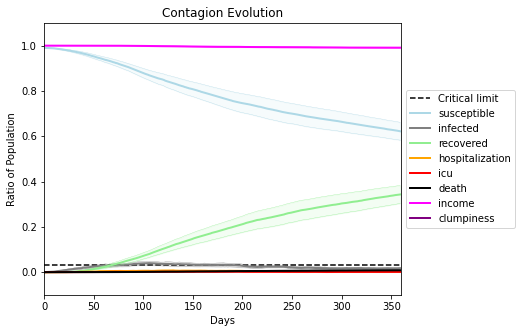

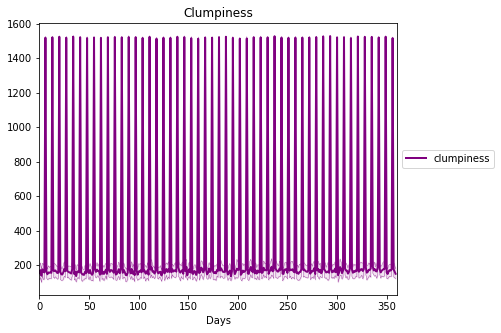

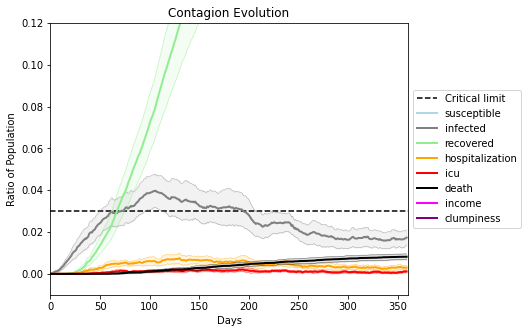

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5152, 2363, 5472, 757, 5973, 9370, 1095, 6400, 686, 9567, 8868, 6189, 134, 17, 4975, 8079, 8871, 5334, 7047, 8059]
Average similarity between family members is 0.9144752302934063 at temperature -0.991
Average similarity between family and home is 0.9998495286672847 at temperature -1
Average similarity between students and their classroom is 0.8313317660342857 at temperature -0.991
Average classroom occupancy is 1.75 and number classrooms is 176
Average similarity between workers is 0.8428902796602434 at temperature -0.991
Average office occupancy is 3.319371727748691 and number offices is 191
Average friend similarity for adults: 0.8379189327001878 for kids: 0.7216802409545089
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuil

avg restaurant similarity 0.4237966357353124
avg restaurant similarity 0.56427992722348
avg restaurant similarity 0.453377114132711
avg restaurant similarity 0.6681716120649213
avg restaurant similarity 0.695010398031523
avg restaurant similarity 0.7154723917638532
avg restaurant similarity 0.39211596737541854
avg restaurant similarity 0.4227412254901032
avg restaurant similarity 0.27608299861940483
avg restaurant similarity 0.369511493948066
avg restaurant similarity 0.7799326965677216
avg restaurant similarity 0.2344302455060937
avg restaurant similarity 0.6676076450739294
avg restaurant similarity 0.4369937432917551
avg restaurant similarity 0.682202239270558
avg restaurant similarity 0.45885640446217135
avg restaurant similarity 0.3977864021767928
avg restaurant similarity 0.44261765988429536
avg restaurant similarity 0.7191611671711351
avg restaurant similarity 0.2512925249400576
avg restaurant similarity 0.21673617390113606
avg restaurant similarity 0.42161654346266575
avg restau

avg restaurant similarity 0.6314943162614661
avg restaurant similarity 0.43534886907710846
avg restaurant similarity 0.41662224204376813
avg restaurant similarity 0.9998514731032576
avg restaurant similarity 0.5280441950368258
avg restaurant similarity 0.46672566514952196
avg restaurant similarity 0.6264590997982515
avg restaurant similarity 0.4713865823012783
avg restaurant similarity 0.5868881642452458
avg restaurant similarity 0.45599185127645636
avg restaurant similarity 0.4402550007169786
avg restaurant similarity 0.33025166477637385
avg restaurant similarity 0.9998786998767193
avg restaurant similarity 0.4145350575149919
avg restaurant similarity 0.44227001452418047
avg restaurant similarity 0.47675253436057285
avg restaurant similarity 0.5416197243341743
avg restaurant similarity 0.41571234918197963
avg restaurant similarity 0.23289034660071842
avg restaurant similarity 0.2992443022787166
avg restaurant similarity 0.5949099711968571
avg restaurant similarity 0.6545069987623017
a

Average similarity between workers is 0.8360169646820226 at temperature -0.991
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.8341079240057697 for kids: 0.7174007866964375
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6343507106384924
avg restaurant similarity 0.4702082030476278
avg restaurant similarity 0.49053414738183054
avg restaurant similarity 0.7208400925568001
avg restaurant similarity 0.4289790273603457
avg restaurant similarity 0.6143222281818675
avg restaurant similarity 0.8890370817627651
avg restaurant similarity 0.9069601169406967
avg restaurant similarity 0.7936385919771854
avg restaurant similarity 0.8646725545271003
avg restaurant similarity 0.3494773889851018
avg restaurant similarity 0.6309522903991045
avg restaurant similarity 0.48140075635139545
avg restaurant similarity 0.8969680099304151
avg restaurant similarity 0.4896913721608591
avg restaurant similarity 0.21746717072148433
avg restaurant similarity 0.5737564208431738
avg restaurant similarity 0.4143463090935918
avg restaurant similarity 0.2865485596021982
avg restaurant similarity 0.4476685720902476
avg restaurant similarity 0.3726736706306518
avg restaurant similarity 0.8663911578568382
avg res

avg restaurant similarity 0.6999015808850522
avg restaurant similarity 0.6153937720407704
avg restaurant similarity 0.9998014621293467
avg restaurant similarity 0.5943580624115178
avg restaurant similarity 0.21470272604753757
avg restaurant similarity 0.6391228594492644
avg restaurant similarity 0.74463378644183
avg restaurant similarity 0.6385475708325046
avg restaurant similarity 0.8636066868307429
Average similarity between family members is 0.9125022582692021 at temperature -0.991
Average similarity between family and home is 0.9998555652258736 at temperature -1
Average similarity between students and their classroom is 0.8063863729806491 at temperature -0.991
Average classroom occupancy is 1.6764705882352942 and number classrooms is 170
Average similarity between workers is 0.8220088457449012 at temperature -0.991
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8354755258639485 for kids: 0.709253044436563
home_distric

avg restaurant similarity 0.6294963821652689
avg restaurant similarity 0.4112939149904029
avg restaurant similarity 0.3852789752145054
avg restaurant similarity 0.4539745580273271
avg restaurant similarity 0.9994831183328133
avg restaurant similarity 0.6574852090724665
avg restaurant similarity 0.999839676104096
avg restaurant similarity 0.45013043848631573
avg restaurant similarity 0.6886836188254142
avg restaurant similarity 0.798376745932685
avg restaurant similarity 0.5074778087176569
avg restaurant similarity 0.7116450394397096
avg restaurant similarity 0.4806003783105974
avg restaurant similarity 0.5014017558300138
avg restaurant similarity 0.37611802721842763
avg restaurant similarity 0.4880607469862638
avg restaurant similarity 0.3650195332319043
avg restaurant similarity 0.6805286327816935
avg restaurant similarity 0.3147329275201528
avg restaurant similarity 0.361407662931736
avg restaurant similarity 0.29390379658980303
avg restaurant similarity 0.4716536977115483
avg restau

Average friend similarity for adults: 0.8380657549497629 for kids: 0.7211917659821668
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.4175119508345666
avg restaurant similarity 0.31279373109254127
avg restaurant similarity 0.7079807881464253
avg restaurant similarity 0.6510054722820326
avg restaurant similarity 0.5495794866532819
avg restaurant similarity 0.38360550068637095
avg restaurant similarity 0.5916417695893263
avg restaurant similarity 0.8791425524053298
avg restaurant similarity 0.5145645205272432
avg restaurant similarity 0.26700053034236626
avg restaurant similarity 0.621617374585697
avg restaurant similarity 0.680067397792827
avg restaurant similarity 0.3473059416200951
avg restaurant similarity 0.656586916533321
avg restaurant similarity 0.39363117634893685
avg restaurant similarity 0.539701020073236
avg restaurant similarity 0.4079457380882572
avg restaurant similarity 0.6213622065297106
avg restaurant similarity 0.4794783114054104
avg restaurant similarity 0.39548765652576223
avg restaurant similarity 0.6922194956536004
avg restaurant similarity 0.562612500129861
avg restau

Average similarity between family and home is 0.9998566603985537 at temperature -1
Average similarity between students and their classroom is 0.8267270886086819 at temperature -0.991
Average classroom occupancy is 1.694915254237288 and number classrooms is 177
Average similarity between workers is 0.8364549418084851 at temperature -0.991
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.8351891369690377 for kids: 0.7193930588447851
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.2580688689930326
avg restaurant similarity 0.39412133027791774
avg restaurant similarity 0.38484074270408675
avg restaurant similarity 0.6000105979654005
avg restaurant similarity 0.6153941268457032
avg restaurant similarity 0.5771897292858972
avg restaurant similarity 0.5112771807421519
avg restaurant similarity 0.6987007853346958
avg restaurant similarity 0.45883344373429635
avg restaurant similarity 0.09966939977326038
avg restaurant similarity 0.5321452480048628
avg restaurant similarity 0.4017686290278675
avg restaurant similarity 0.455379127643204
avg restaurant similarity 0.508929109540388
avg restaurant similarity 0.4320719106910654
avg restaurant similarity 0.6987007853346958
avg restaurant similarity 0.8126378471874498
avg restaurant similarity 0.08168196905695145
avg restaurant similarity 0.42969800927827595
avg restaurant similarity 0.30777171478995147
avg restaurant similarity 0.4086001549117837
avg restaurant similarity 0.354825026983143
avg re

Average friend similarity for adults: 0.831568042408405 for kids: 0.7272516423064046
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.7835869598715128
avg restaurant similarity 0.516133776315649
avg restaurant similarity 0.43577625839751055
avg restaurant similarity 0.38710219684993435
avg restaurant similarity 0.49953214813611
avg restaurant similarity 0.513879904508644
avg restaurant similarity 0.4623982345412394
avg restaurant similarity 0.48455181056266033
avg restaurant similarity 0.6019948198015264
avg restaurant similarity 0.6038410737052777
avg restaurant similarity 0.2867977335531763
avg restaurant similarity 0.49470123489269185
avg restaurant similarity 0.6717893018419625
avg restaurant similarity 0.36843581816169446
avg restaurant similarity 0.4812437548914568
avg restaurant similarity 0.4736146759250923
avg restaurant similarity 0.5628015448417725
avg restaurant similarity 0.6473217357261934
avg restaurant similarity 0.5094751725689537
avg restaurant similarity 0.8910904288932222
avg restaurant similarity 0.5735717850023516
avg restaurant similarity 0.4530100217080385
avg resta

avg restaurant similarity 0.4555915867985939
avg restaurant similarity 0.2936684138041038
avg restaurant similarity 0.5509824181983649
avg restaurant similarity 0.6560625581353592
avg restaurant similarity 0.6509451508842534
avg restaurant similarity 0.5892486382347797
avg restaurant similarity 0.47656226862178513
avg restaurant similarity 0.328305539681622
avg restaurant similarity 0.8065992110369228
avg restaurant similarity 0.2563589539601583
avg restaurant similarity 0.29937594592075223
avg restaurant similarity 0.46652571867858417
avg restaurant similarity 0.33713095533849335
avg restaurant similarity 0.5596545482514704
avg restaurant similarity 0.5850577405072006
avg restaurant similarity 0.5830541120156121
avg restaurant similarity 0.5182290777288544
avg restaurant similarity 0.4850563311657758
avg restaurant similarity 0.3756804317237075
avg restaurant similarity 0.47656226862178513
avg restaurant similarity 0.3572085064751698
avg restaurant similarity 0.4739901219827301
avg re

avg restaurant similarity 0.5112295981000334
avg restaurant similarity 0.3155764722189241
avg restaurant similarity 0.6425028594899375
avg restaurant similarity 0.5430027162717471
avg restaurant similarity 0.6689523390672131
avg restaurant similarity 0.5574531039405962
avg restaurant similarity 0.8634944649693073
avg restaurant similarity 0.4037502178543793
avg restaurant similarity 0.7063871607143329
avg restaurant similarity 0.6102114877636049
avg restaurant similarity 0.6109520234888388
avg restaurant similarity 0.5616111602049929
avg restaurant similarity 0.5082667777063065
avg restaurant similarity 0.5167590239724573
avg restaurant similarity 0.8147006468613072
avg restaurant similarity 0.3242698923408456
avg restaurant similarity 0.7929751658010551
avg restaurant similarity 0.5134128345419373
avg restaurant similarity 0.41198491532464854
avg restaurant similarity 0.5731787802170274
avg restaurant similarity 0.5082667777063065
avg restaurant similarity 0.3938336179610773
avg resta

Average similarity between family and home is 0.9998660685522688 at temperature -1
Average similarity between students and their classroom is 0.7908143455162266 at temperature -0.991
Average classroom occupancy is 1.8047337278106508 and number classrooms is 169
Average similarity between workers is 0.8312396651701737 at temperature -0.991
Average office occupancy is 3.443850267379679 and number offices is 187
Average friend similarity for adults: 0.8306169657112307 for kids: 0.7226837953211062
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.7637277682462508
avg restaurant similarity 0.4695703924335334
avg restaurant similarity 0.40062574749626956
avg restaurant similarity 0.851867704614318
avg restaurant similarity 0.5184851636387623
avg restaurant similarity 0.40305978755636074
avg restaurant similarity 0.5021632830627787
avg restaurant similarity 0.2527799663597011
avg restaurant similarity 0.490269374998462
avg restaurant similarity 0.5283671083310455
avg restaurant similarity 0.3080776683010468
avg restaurant similarity 0.9997462338390797
avg restaurant similarity 0.6584267909393768
avg restaurant similarity 0.40742242788447813
avg restaurant similarity 0.9996912085293184
avg restaurant similarity 0.3775247337286383
avg restaurant similarity 0.2784306506394082
avg restaurant similarity 0.7346967038215666
avg restaurant similarity 0.8353690755007912
avg restaurant similarity 0.9998394094501211
avg restaurant similarity 0.4867260279126863
avg restaurant similarity 0.5283671083310455
avg resta

avg restaurant similarity 0.5323251717242636
avg restaurant similarity 0.5769745673848168
avg restaurant similarity 0.49439982694596313
avg restaurant similarity 0.45378796406365374
avg restaurant similarity 0.4446516040689076
avg restaurant similarity 0.6624161725604558
avg restaurant similarity 0.4903994938716736
avg restaurant similarity 0.5333647983910298
avg restaurant similarity 0.6856197906115392
avg restaurant similarity 0.6663427934432118
avg restaurant similarity 0.5452170228212326
avg restaurant similarity 0.5547801268384647
avg restaurant similarity 0.5990151388282792
avg restaurant similarity 0.49022618779307603
avg restaurant similarity 0.48208698221287105
avg restaurant similarity 0.9996750306507993
avg restaurant similarity 0.5770076009683729
avg restaurant similarity 0.30946708761247593
avg restaurant similarity 0.31101824961161223
avg restaurant similarity 0.5492526117433156
avg restaurant similarity 0.9390028600876479
avg restaurant similarity 0.48075052010382985
avg

avg restaurant similarity 0.10270927802460286
avg restaurant similarity 0.6554069601378776
avg restaurant similarity 0.49328467224357575
avg restaurant similarity 0.4003647185787045
avg restaurant similarity 0.9997601776599111
avg restaurant similarity 0.034297307756223826
avg restaurant similarity 0.47871950004203656
avg restaurant similarity 0.6931993375973
avg restaurant similarity 0.28957203215178073
avg restaurant similarity 0.4050518429841502
avg restaurant similarity 0.4105746325439123
avg restaurant similarity 0.5093760183308154
avg restaurant similarity 0.8468592485093858
avg restaurant similarity 0.8579174261896331
avg restaurant similarity 0.8911046289544314
avg restaurant similarity 0.4783428154157887
avg restaurant similarity 0.5043225257861935
avg restaurant similarity 0.22277643733522237
avg restaurant similarity 0.47494403387265605
avg restaurant similarity 0.3748686708025073
avg restaurant similarity 0.1889838998252624
avg restaurant similarity 0.30152030526174745
avg 

avg restaurant similarity 0.8426763383205584
avg restaurant similarity 0.4414049031421271
avg restaurant similarity 0.7878983947061828
avg restaurant similarity 0.5162354665969835
avg restaurant similarity 0.7634371485473734
avg restaurant similarity 0.4878028503615533
avg restaurant similarity 0.9997851923128027
avg restaurant similarity 0.4583907533946955
avg restaurant similarity 0.42185452218864666
avg restaurant similarity 0.7667919800658252
avg restaurant similarity 0.2625717159419492
avg restaurant similarity 0.5073259637206793
avg restaurant similarity 0.35553967404324904
avg restaurant similarity 0.24355307316620844
avg restaurant similarity 0.5120825488594332
avg restaurant similarity 0.3517020458366119
avg restaurant similarity 0.4514317014501745
avg restaurant similarity 0.40272024296830117
avg restaurant similarity 0.45739119978411436
avg restaurant similarity 0.5439579621242836
avg restaurant similarity 0.9997330352828955
avg restaurant similarity 0.7261905740828329
avg r

avg restaurant similarity 0.3035381318364966
avg restaurant similarity 0.40850187039197816
avg restaurant similarity 0.45213161184686645
avg restaurant similarity 0.5441346703545658
avg restaurant similarity 0.44332186625255127
avg restaurant similarity 0.32539045302567265
avg restaurant similarity 0.9997047981643727
avg restaurant similarity 0.31571297172646645
avg restaurant similarity 0.31676980977351177
avg restaurant similarity 0.49721014918715734
avg restaurant similarity 0.3107686031067992
avg restaurant similarity 0.9997080975844637
avg restaurant similarity 0.8210657145559787
avg restaurant similarity 0.4526760818164214
avg restaurant similarity 0.9144677617055456
avg restaurant similarity 0.40708542747609977
avg restaurant similarity 0.3009886359308189
avg restaurant similarity 0.48244704452621
avg restaurant similarity 0.6425097284164443
avg restaurant similarity 0.5331116347401823
avg restaurant similarity 0.5234711523454617
avg restaurant similarity 0.45052451014384454
avg

avg restaurant similarity 0.6013948619479168
avg restaurant similarity 0.5295445094442501
avg restaurant similarity 0.19881963986041734
avg restaurant similarity 0.5812711633602883
avg restaurant similarity 0.5935633534025401
avg restaurant similarity 0.4501586380105907
avg restaurant similarity 0.4277859655881782
avg restaurant similarity 0.4980338954495518
avg restaurant similarity 0.9996663498544113
avg restaurant similarity 0.5174823153424614
avg restaurant similarity 0.6024350100885175
avg restaurant similarity 0.8660681194124322
avg restaurant similarity 0.46237890834201156
avg restaurant similarity 0.35721262481908045
avg restaurant similarity 0.8239678492001982
avg restaurant similarity 0.4983104288428799
avg restaurant similarity 0.4893558115603617
avg restaurant similarity 0.874202942192395
avg restaurant similarity 0.5517259741774017
avg restaurant similarity 0.30452348673094376
avg restaurant similarity 0.12076060892130973
avg restaurant similarity 0.5344611667645001
avg re

avg restaurant similarity 0.537487628565648
Average similarity between family members is 0.9132388915974996 at temperature -0.991
Average similarity between family and home is 0.999852120605678 at temperature -1
Average similarity between students and their classroom is 0.8041987981283228 at temperature -0.991
Average classroom occupancy is 1.6742857142857144 and number classrooms is 175
Average similarity between workers is 0.8378583363223425 at temperature -0.991
Average office occupancy is 3.3230769230769233 and number offices is 195
Average friend similarity for adults: 0.8312679517024986 for kids: 0.7217751969908736
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.4032555569314556
avg restaurant similarity 0.5661372958416184
avg restaurant similarity 0.48165274390274204
avg restaurant similarity 0.6893166930265131
avg restaurant similarity 0.47314623064493105
avg restaurant similarity 0.5079518565062717
avg restaurant similarity 0.6466036751190085
avg restaurant similarity 0.4582254337079002
avg restaurant similarity 0.5244261280003024
avg restaurant similarity 0.9997913565819682
avg restaurant similarity 0.44850982133670136
avg restaurant similarity 0.4419667841064319
avg restaurant similarity 0.6446564723213329
avg restaurant similarity 0.29330653121424693
avg restaurant similarity 0.2888813656877552
avg restaurant similarity 0.35969131332123483
avg restaurant similarity 0.4987780817434506
avg restaurant similarity 0.4177934785118388
avg restaurant similarity 0.446023130421677
avg restaurant similarity 0.2311611618825909
avg restaurant similarity 0.32003489281031355
avg restaurant similarity 0.30001010637098957
avg 

avg restaurant similarity 0.45359034258382047
Average similarity between family members is 0.9160376196060749 at temperature -0.991
Average similarity between family and home is 0.9998524098465271 at temperature -1
Average similarity between students and their classroom is 0.8195381425158701 at temperature -0.991
Average classroom occupancy is 1.6569767441860466 and number classrooms is 172
Average similarity between workers is 0.850642478988176 at temperature -0.991
Average office occupancy is 3.305 and number offices is 200
Average friend similarity for adults: 0.8472742446779953 for kids: 0.7227721814950625
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people alloca

avg restaurant similarity 0.46061472504030165
avg restaurant similarity 0.41208669585417135
avg restaurant similarity 0.28824391702097474
avg restaurant similarity 0.8982227564083307
avg restaurant similarity 0.7190487484802133
avg restaurant similarity 0.38908961185051405
avg restaurant similarity 0.44617822711635546
avg restaurant similarity 0.6430579523028116
avg restaurant similarity 0.9998909522720422
avg restaurant similarity 0.596164223039229
avg restaurant similarity 0.5895330983870379
avg restaurant similarity 0.8040311371900821
avg restaurant similarity 0.3714705362582673
avg restaurant similarity 0.7276492662656848
avg restaurant similarity 0.29611495293763657
avg restaurant similarity 0.41208669585417135
avg restaurant similarity 0.510539430327257
avg restaurant similarity 0.43604878808195024
avg restaurant similarity 0.44617822711635546
avg restaurant similarity 0.4482497356381361
avg restaurant similarity 0.5046345890384603
avg restaurant similarity 0.5130488982613407
avg

avg restaurant similarity 0.44017978534070973
avg restaurant similarity 0.5583836270657342
avg restaurant similarity 0.598905717906198
avg restaurant similarity 0.448797277923735
avg restaurant similarity 0.400653035536253
avg restaurant similarity 0.5396194479122016
avg restaurant similarity 0.6172434611846853
avg restaurant similarity 0.4544429982697759
avg restaurant similarity 0.8630779216370744
avg restaurant similarity 0.476491367881715
avg restaurant similarity 0.48665616410408696
avg restaurant similarity 0.8238737157619656
avg restaurant similarity 0.41781358801908836
avg restaurant similarity 0.452179161408579
avg restaurant similarity 0.4394785751250188
avg restaurant similarity 0.5517506233024171
avg restaurant similarity 0.47538736268380055
avg restaurant similarity 0.41186305177026855
avg restaurant similarity 0.31500183253173936
avg restaurant similarity 0.39891866287197636
avg restaurant similarity 0.32589755193550285
avg restaurant similarity 0.4425758318319909
avg res

avg restaurant similarity 0.511464790585631
avg restaurant similarity 0.4758843110063682
avg restaurant similarity 0.3816796653058317
avg restaurant similarity 0.5838458054992299
avg restaurant similarity 0.6563899416160146
avg restaurant similarity 0.4973514565749077
avg restaurant similarity 0.43437508518225854
avg restaurant similarity 0.4738934759812386
avg restaurant similarity 0.6035817429189498
avg restaurant similarity 0.6706641477033809
avg restaurant similarity 0.3836391097316545
avg restaurant similarity 0.3524593070563588
avg restaurant similarity 0.3541061970778362
avg restaurant similarity 0.27917997729467564
avg restaurant similarity 0.5435703497512575
avg restaurant similarity 0.5026327616304435
avg restaurant similarity 0.6003675080901357
avg restaurant similarity 0.627794805602671
avg restaurant similarity 0.3931073424708318
avg restaurant similarity 0.7761801850738879
avg restaurant similarity 0.5506704604839745
avg restaurant similarity 0.3772101298746333
avg restau

avg restaurant similarity 0.34530737049997623
avg restaurant similarity 0.5613765306255012
avg restaurant similarity 0.5742861790937805
avg restaurant similarity 0.41926428619465916
avg restaurant similarity 0.25012360670912287
avg restaurant similarity 0.41051572639801126
avg restaurant similarity 0.4199840821146207
avg restaurant similarity 0.4246390366167274
avg restaurant similarity 0.5977256635150641
avg restaurant similarity 0.20924271587959675
avg restaurant similarity 0.4160013486744868
avg restaurant similarity 0.7758031800100135
avg restaurant similarity 0.5249672279207829
avg restaurant similarity 0.3601724189868027
avg restaurant similarity 0.704457204709399
avg restaurant similarity 0.9996471788370784
avg restaurant similarity 0.24501827657824032
avg restaurant similarity 0.47345748893259837
avg restaurant similarity 0.6084179150395528
avg restaurant similarity 0.734927537644539
avg restaurant similarity 0.4617805669592321
avg restaurant similarity 0.7059422643839159
avg r

Average friend similarity for adults: 0.8314003073296063 for kids: 0.7180245654644165
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.49545692772762645
avg restaurant similarity 0.2667811023042587
avg restaurant similarity 0.857777042117621
avg restaurant similarity 0.4977058294482406
avg restaurant similarity 0.5223561041558575
avg restaurant similarity 0.6317243522308379
avg restaurant similarity 0.3095824856613194
avg restaurant similarity 0.43628134894175963
avg restaurant similarity 0.5447394158606442
avg restaurant similarity 0.8754097372516958
avg restaurant similarity 0.42322307049069763
avg restaurant similarity 0.4276189560220337
avg restaurant similarity 0.42078082372481596
avg restaurant similarity 0.5150697361697116
avg restaurant similarity 0.4628820567030319
avg restaurant similarity 0.4487971381699606
avg restaurant similarity 0.4148195795833298
avg restaurant similarity 0.5303654961459865
avg restaurant similarity 0.7263292486001476
avg restaurant similarity 0.532195453844726
avg restaurant similarity 0.5583917862186389
avg restaurant similarity 0.6075230299128087
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

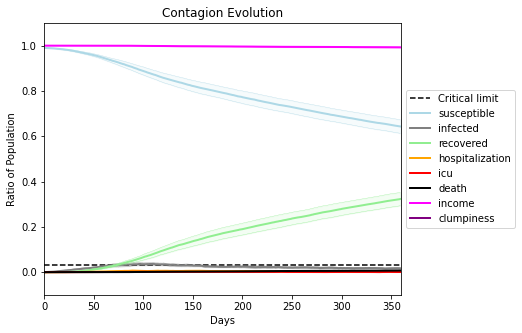

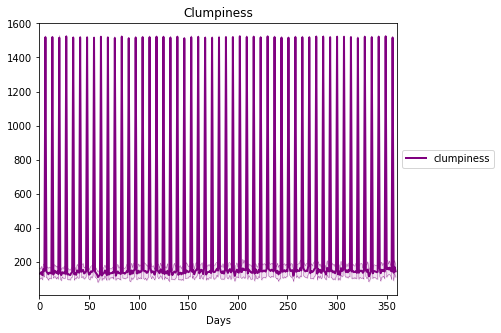

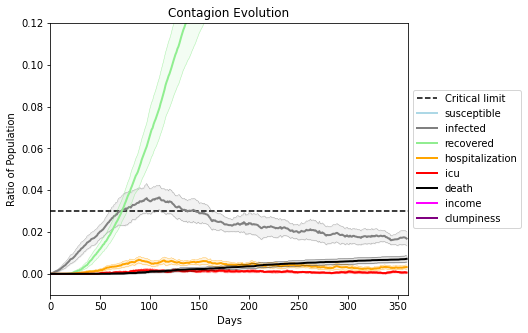

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6642, 2842, 6170, 9995, 5922, 9440, 3237, 8914, 8886, 5785, 839, 190, 6706, 5355, 4538, 3217, 4575, 3361, 1385, 9049]
Average similarity between family members is 0.8960019171944088 at temperature -0.99
Average similarity between family and home is 0.9998584867224598 at temperature -1
Average similarity between students and their classroom is 0.7600981557506384 at temperature -0.99
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.8203495809564719 at temperature -0.99
Average office occupancy is 3.439153439153439 and number offices is 189
Average friend similarity for adults: 0.8293632856339087 for kids: 0.7310916570958854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.7313616295892897
avg restaurant similarity 0.38918861880058514
avg restaurant similarity 0.8523259982299631
avg restaurant similarity 0.28381240565874555
avg restaurant similarity 0.6102979584085252
avg restaurant similarity 0.2681675344260158
avg restaurant similarity 0.1635439070491937
avg restaurant similarity 0.3675708713198711
avg restaurant similarity 0.46459871478561
avg restaurant similarity 0.9052494259213749
avg restaurant similarity 0.2327440696300842
avg restaurant similarity 0.6235053327075297
avg restaurant similarity 0.8037151717070476
avg restaurant similarity 0.3135785951014326
avg restaurant similarity 0.4026619891168101
avg restaurant similarity 0.1681390408653111
avg restaurant similarity 0.345007935770522
avg restaurant similarity 0.5014835135346007
avg restaurant similarity 0.24286303551140132
avg restaurant similarity 0.5350440735168251
avg restaurant similarity 0.3349597658153698
avg restaurant similarity 0.392009761811992
avg restaur

avg restaurant similarity 0.6646406038254216
avg restaurant similarity 0.2880734510827378
avg restaurant similarity 0.861013351636195
avg restaurant similarity 0.4673811552156978
avg restaurant similarity 0.34463844096997065
avg restaurant similarity 0.46508836265006986
avg restaurant similarity 0.4212864690767348
avg restaurant similarity 0.5438822536309978
avg restaurant similarity 0.30745601449437515
avg restaurant similarity 0.4728097491943095
avg restaurant similarity 0.963747428192503
avg restaurant similarity 0.4728097491943095
avg restaurant similarity 0.3808375409696319
avg restaurant similarity 0.44044028137708285
avg restaurant similarity 0.3485204811726441
avg restaurant similarity 0.363578644460639
avg restaurant similarity 0.2950055610027823
avg restaurant similarity 0.2269795860627548
avg restaurant similarity 0.275086393350178
avg restaurant similarity 0.5982318158729385
avg restaurant similarity 0.7999227255393522
avg restaurant similarity 0.3956363390972897
avg restau

avg restaurant similarity 0.4481956574699727
avg restaurant similarity 0.23589579737948005
avg restaurant similarity 0.5029949816073465
avg restaurant similarity 0.6118977383792503
avg restaurant similarity 0.3832686850943269
avg restaurant similarity 0.2691093072092864
avg restaurant similarity 0.6625826265930115
avg restaurant similarity 0.16734138686379926
avg restaurant similarity 0.2691093072092864
avg restaurant similarity 0.3274728213816114
avg restaurant similarity 0.3664880792823139
avg restaurant similarity 0.5266523982143931
avg restaurant similarity 0.5200348526357915
avg restaurant similarity 0.47031118087188745
avg restaurant similarity 0.385154641300266
avg restaurant similarity 0.407689396949778
avg restaurant similarity 0.4844918861488993
avg restaurant similarity 0.5486465213284076
avg restaurant similarity 0.5505425461344196
avg restaurant similarity 0.6135065633836774
avg restaurant similarity 0.3803060181664218
avg restaurant similarity 0.43245066276499244
avg rest

avg restaurant similarity 0.4844918861488993
avg restaurant similarity 0.45530381128639275
Average similarity between family members is 0.907805265605184 at temperature -0.99
Average similarity between family and home is 0.9998626452394215 at temperature -1
Average similarity between students and their classroom is 0.7755637709925736 at temperature -0.99
Average classroom occupancy is 1.6416184971098267 and number classrooms is 173
Average similarity between workers is 0.8188343610518429 at temperature -0.99
Average office occupancy is 3.4123711340206184 and number offices is 194
Average friend similarity for adults: 0.8259606233697679 for kids: 0.7152633644899833
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.8914895000064869
avg restaurant similarity 0.29646530746919497
avg restaurant similarity 0.31621229963305225
avg restaurant similarity 0.6322311856944436
avg restaurant similarity 0.8718737864694693
avg restaurant similarity 0.44456970314996735
avg restaurant similarity 0.5086383037988599
avg restaurant similarity 0.20723870826908652
avg restaurant similarity 0.3262826184131065
avg restaurant similarity 0.2792215466481662
avg restaurant similarity 0.4595983808863887
avg restaurant similarity 0.3270915720521036
avg restaurant similarity 0.3095644977645562
avg restaurant similarity 0.7586372458666744
avg restaurant similarity 0.5344227068480619
avg restaurant similarity 0.4565117751323565
avg restaurant similarity 0.9993076462614037
avg restaurant similarity 0.5464006791125201
avg restaurant similarity 0.3517805132483671
avg restaurant similarity 0.36605095588096254
avg restaurant similarity 0.5830635612488491
avg restaurant similarity 0.5474982205639731
avg r

avg restaurant similarity 0.5092405270408203
avg restaurant similarity 0.48816068080078556
avg restaurant similarity 0.40789024047356626
avg restaurant similarity 0.1120443952581619
avg restaurant similarity 0.5667108076581134
avg restaurant similarity 0.32297057096644916
avg restaurant similarity 0.4221118279342903
avg restaurant similarity 0.40362876980391615
avg restaurant similarity 0.5700102808827312
avg restaurant similarity 0.6498428286468165
avg restaurant similarity 0.4069550536202896
avg restaurant similarity 0.20685858468734925
avg restaurant similarity 0.7408789144385924
avg restaurant similarity 0.4594522418700526
avg restaurant similarity 0.6406016781816979
avg restaurant similarity 0.2769069486118742
avg restaurant similarity 0.6851210316334264
avg restaurant similarity 0.5585928337597179
avg restaurant similarity 0.39265049496059495
avg restaurant similarity 0.7355659638335825
avg restaurant similarity 0.21876591019500338
avg restaurant similarity 0.6468601331326504
avg

avg restaurant similarity 0.6686560576175411
avg restaurant similarity 0.848619423190203
avg restaurant similarity 0.577864876698147
avg restaurant similarity 0.4138708604790444
avg restaurant similarity 0.45904474317009375
avg restaurant similarity 0.3859552869371439
avg restaurant similarity 0.5842317890603704
avg restaurant similarity 0.7103907772513988
avg restaurant similarity 0.7843385388305971
avg restaurant similarity 0.6523327904067708
avg restaurant similarity 0.6610378845570208
avg restaurant similarity 0.5817660250599356
avg restaurant similarity 0.4862050608925861
avg restaurant similarity 0.8121013535099241
avg restaurant similarity 0.5352803843238374
avg restaurant similarity 0.5094072172712765
avg restaurant similarity 0.5720960019197483
avg restaurant similarity 0.32106010511763505
avg restaurant similarity 0.8517202710536388
avg restaurant similarity 0.8679391589386745
avg restaurant similarity 0.5837682056876408
avg restaurant similarity 0.495537972318831
avg restaur

avg restaurant similarity 0.5817660250599356
avg restaurant similarity 0.3663577930562753
avg restaurant similarity 0.7971033325034769
avg restaurant similarity 0.4787104499119774
avg restaurant similarity 0.540439855124407
avg restaurant similarity 0.6948012165045222
avg restaurant similarity 0.5093121082362267
avg restaurant similarity 0.16269672012422765
avg restaurant similarity 0.40782713177549956
avg restaurant similarity 0.5602598959736391
avg restaurant similarity 0.38453778911645287
avg restaurant similarity 0.5040798511743866
avg restaurant similarity 0.23922945250509156
avg restaurant similarity 0.5079557646710082
avg restaurant similarity 0.5509261897174748
avg restaurant similarity 0.36382104063518705
avg restaurant similarity 0.5813904469563052
avg restaurant similarity 0.5575041355190624
avg restaurant similarity 0.5856671613159314
avg restaurant similarity 0.9998625533015916
avg restaurant similarity 0.3965038985364355
avg restaurant similarity 0.5564969357572367
avg re

avg restaurant similarity 0.4640143153095824
avg restaurant similarity 0.6258182470594263
avg restaurant similarity 0.5350087843686356
avg restaurant similarity 0.4577886486123317
avg restaurant similarity 0.47901536916263
avg restaurant similarity 0.589128375479744
avg restaurant similarity 0.5036593185550106
avg restaurant similarity 0.5088982198342027
avg restaurant similarity 0.375456221137036
avg restaurant similarity 0.4758631594702905
avg restaurant similarity 0.22962915615325957
avg restaurant similarity 0.3590302655101286
avg restaurant similarity 0.5347261719339491
avg restaurant similarity 0.47566539105264516
avg restaurant similarity 0.4021902762452269
avg restaurant similarity 0.3436314356663378
avg restaurant similarity 0.43858994874449414
avg restaurant similarity 0.6355733911030461
avg restaurant similarity 0.5139729211473707
avg restaurant similarity 0.4864627638856718
avg restaurant similarity 0.5420937529509117
avg restaurant similarity 0.39046277682114383
avg restau

avg restaurant similarity 0.3801862103394389
avg restaurant similarity 0.33676002676500116
avg restaurant similarity 0.667964751687945
avg restaurant similarity 0.46053759619611245
avg restaurant similarity 0.4505767647055423
avg restaurant similarity 0.5027268826034831
avg restaurant similarity 0.6095524555183518
avg restaurant similarity 0.46609509307804514
avg restaurant similarity 0.34412571198939057
avg restaurant similarity 0.5301173881195688
avg restaurant similarity 0.5298433039734852
avg restaurant similarity 0.30568912135990006
avg restaurant similarity 0.5372237651210827
avg restaurant similarity 0.40010811770745086
avg restaurant similarity 0.633524526345251
avg restaurant similarity 0.5002290482704707
avg restaurant similarity 0.6993971429114343
avg restaurant similarity 0.7610340123917303
avg restaurant similarity 0.5043044755613691
avg restaurant similarity 0.5790349053419123
avg restaurant similarity 0.5036593185550106
avg restaurant similarity 0.4054203798509637
avg re

avg restaurant similarity 0.225502819260813
avg restaurant similarity 0.40773744098784126
avg restaurant similarity 0.6654460453414244
avg restaurant similarity 0.7334708407182551
avg restaurant similarity 0.8393583840621455
avg restaurant similarity 0.5201205286862253
avg restaurant similarity 0.5712919190113653
avg restaurant similarity 0.40239751097231424
avg restaurant similarity 0.736095971999113
avg restaurant similarity 0.4091708014578344
avg restaurant similarity 0.34157374100897264
avg restaurant similarity 0.8453019919561018
avg restaurant similarity 0.5963280411061197
avg restaurant similarity 0.472022145500042
avg restaurant similarity 0.7334708407182551
avg restaurant similarity 0.542389274121427
avg restaurant similarity 0.9996091306648571
avg restaurant similarity 0.31331664987824115
avg restaurant similarity 0.5657453004253509
avg restaurant similarity 0.846764361531544
avg restaurant similarity 0.5114296047917706
avg restaurant similarity 0.9993923638344147
avg restaur

avg restaurant similarity 0.5797883328043008
avg restaurant similarity 0.539089820507662
avg restaurant similarity 0.9993923638344147
avg restaurant similarity 0.6742362659234779
avg restaurant similarity 0.4085542882875905
avg restaurant similarity 0.9993923638344147
avg restaurant similarity 0.6853760103373493
avg restaurant similarity 0.4932295445425373
avg restaurant similarity 0.4511077378685473
avg restaurant similarity 0.4848994876108471
avg restaurant similarity 0.5114835400870625
avg restaurant similarity 0.24202722314416475
avg restaurant similarity 0.2625969525022386
avg restaurant similarity 0.2625969525022386
avg restaurant similarity 0.5674014642493799
avg restaurant similarity 0.6175977202296294
avg restaurant similarity 0.5114835400870625
avg restaurant similarity 0.2625969525022386
Average similarity between family members is 0.9073870323939944 at temperature -0.99
Average similarity between family and home is 0.9998464427570207 at temperature -1
Average similarity bet

avg restaurant similarity 0.5156596272994629
avg restaurant similarity 0.47386927579768656
avg restaurant similarity 0.4806239326274761
avg restaurant similarity 0.28301871468509116
avg restaurant similarity 0.8093303500393706
avg restaurant similarity 0.4222906662586769
avg restaurant similarity 0.42791283151551196
avg restaurant similarity 0.1906411918034035
avg restaurant similarity 0.4650020070513398
avg restaurant similarity 0.6340837390252545
avg restaurant similarity 0.4263237938017292
avg restaurant similarity 0.32864686067555077
avg restaurant similarity 0.21737805534293075
avg restaurant similarity 0.392203515812504
avg restaurant similarity 0.5489590327690064
avg restaurant similarity 0.5779620458363239
avg restaurant similarity 0.5427916136142179
avg restaurant similarity 0.28705984583540656
avg restaurant similarity 0.24749490092781992
avg restaurant similarity 0.609239074787999
avg restaurant similarity 0.5214763620344117
avg restaurant similarity 0.49502642351792947
avg 

avg restaurant similarity 0.3621075010668471
avg restaurant similarity 0.25582676438616725
avg restaurant similarity 0.48234799584278854
avg restaurant similarity 0.5253176516340969
avg restaurant similarity 0.4164367661506199
avg restaurant similarity 0.28037994578350256
avg restaurant similarity 0.41553509172549785
avg restaurant similarity 0.3083672260000681
avg restaurant similarity 0.5090102490767735
avg restaurant similarity 0.4243501182009702
avg restaurant similarity 0.3675614247489909
avg restaurant similarity 0.682264323293114
avg restaurant similarity 0.2135088685322062
avg restaurant similarity 0.5057769749395757
avg restaurant similarity 0.5223131934149056
avg restaurant similarity 0.09342998415837701
avg restaurant similarity 0.3602158012316198
avg restaurant similarity 0.5214389347468185
avg restaurant similarity 0.5489952500088319
avg restaurant similarity 0.1390448160330181
avg restaurant similarity 0.45064694359113167
avg restaurant similarity 0.6334023632060569
avg r

avg restaurant similarity 0.5584555411768977
avg restaurant similarity 0.5670517636643794
avg restaurant similarity 0.5641885604146362
avg restaurant similarity 0.4928327097184654
avg restaurant similarity 0.5595049540888783
avg restaurant similarity 0.457615336093938
avg restaurant similarity 0.579995976972755
avg restaurant similarity 0.729121860387497
avg restaurant similarity 0.6876288520115443
avg restaurant similarity 0.4009709763420386
avg restaurant similarity 0.5036763640299526
avg restaurant similarity 0.4132087143284361
avg restaurant similarity 0.5024891958860105
avg restaurant similarity 0.5771161070415468
avg restaurant similarity 0.18566097312961727
avg restaurant similarity 0.6523832435269877
avg restaurant similarity 0.44212154427467654
avg restaurant similarity 0.32228924252143565
avg restaurant similarity 0.7367838624522571
avg restaurant similarity 0.6101492612774673
avg restaurant similarity 0.2980619530967275
avg restaurant similarity 0.30202965506105317
avg resta

avg restaurant similarity 0.33342432228104324
avg restaurant similarity 0.6324161341319097
avg restaurant similarity 0.4575185842549055
avg restaurant similarity 0.5071244360042895
avg restaurant similarity 0.46711602129112023
avg restaurant similarity 0.37082016147123403
avg restaurant similarity 0.4564360811682858
avg restaurant similarity 0.5201477186138808
avg restaurant similarity 0.4469625092578717
avg restaurant similarity 0.46381016145293885
avg restaurant similarity 0.6260167196558226
avg restaurant similarity 0.6166319455681438
avg restaurant similarity 0.3777642316380762
avg restaurant similarity 0.6444561389746412
avg restaurant similarity 0.4426983470594125
avg restaurant similarity 0.4031647996994037
avg restaurant similarity 0.44797460863724675
avg restaurant similarity 0.5201477186138808
avg restaurant similarity 0.41422588978462443
avg restaurant similarity 0.4180242918775189
avg restaurant similarity 0.32079515228336203
avg restaurant similarity 0.3346739794182052
avg

avg restaurant similarity 0.7023793981942719
avg restaurant similarity 0.33966457828498764
avg restaurant similarity 0.591305870296807
avg restaurant similarity 0.43614467601433127
avg restaurant similarity 0.736725548854898
avg restaurant similarity 0.38422390026208975
avg restaurant similarity 0.5242258452172246
avg restaurant similarity 0.37339191861008203
avg restaurant similarity 0.42550685509738184
avg restaurant similarity 0.5749741165908644
avg restaurant similarity 0.6770046048839055
avg restaurant similarity 0.4403521740473031
avg restaurant similarity 0.8217114458023986
avg restaurant similarity 0.2806703700015174
avg restaurant similarity 0.6414445596669754
avg restaurant similarity 0.5262284757136261
avg restaurant similarity 0.6161721251540229
avg restaurant similarity 0.5795601902055927
avg restaurant similarity 0.5179556506171195
avg restaurant similarity 0.5197255294368504
avg restaurant similarity 0.6100980659020827
avg restaurant similarity 0.8217114458023986
avg res

avg restaurant similarity 0.5278758391660775
avg restaurant similarity 0.5300971832491895
avg restaurant similarity 0.5036528400755551
avg restaurant similarity 0.5516753756016277
avg restaurant similarity 0.3466044403938532
avg restaurant similarity 0.481353740582798
avg restaurant similarity 0.2509879499777681
avg restaurant similarity 0.5211546714304134
avg restaurant similarity 0.6394656254621056
avg restaurant similarity 0.5210126007316767
avg restaurant similarity 0.5598110417390846
avg restaurant similarity 0.5193920921512505
avg restaurant similarity 0.36052814155650986
avg restaurant similarity 0.5468914235480706
avg restaurant similarity 0.6423410977514985
avg restaurant similarity 0.6273054539758749
avg restaurant similarity 0.5368182315612675
avg restaurant similarity 0.32302329920810746
avg restaurant similarity 0.2229225055290182
avg restaurant similarity 0.29360781436705297
avg restaurant similarity 0.45545931883727353
avg restaurant similarity 0.39498695942991735
avg re

avg restaurant similarity 0.39070469491330506
avg restaurant similarity 0.6092731248036377
avg restaurant similarity 0.4413646086750187
avg restaurant similarity 0.3867764815163628
avg restaurant similarity 0.6669185993691755
avg restaurant similarity 0.4767278853506493
avg restaurant similarity 0.33158598078258694
avg restaurant similarity 0.45545931883727353
avg restaurant similarity 0.5975875864026361
avg restaurant similarity 0.34012479838901233
avg restaurant similarity 0.23550361803500716
avg restaurant similarity 0.5499671119826631
avg restaurant similarity 0.5975875864026361
avg restaurant similarity 0.4562030670151682
avg restaurant similarity 0.4307959312572228
avg restaurant similarity 0.4212602562084274
avg restaurant similarity 0.5354133099099351
avg restaurant similarity 0.4701857228489585
avg restaurant similarity 0.29865663747823024
avg restaurant similarity 0.5423177194577371
avg restaurant similarity 0.44725612884890265
avg restaurant similarity 0.516678343285237
avg 

avg restaurant similarity 0.3417958938567685
avg restaurant similarity 0.34251503029746355
avg restaurant similarity 0.35051270799002254
avg restaurant similarity 0.6021083556160964
avg restaurant similarity 0.40830969833881936
avg restaurant similarity 0.3437533277918463
avg restaurant similarity 0.5385659355624821
avg restaurant similarity 0.5985989772887214
avg restaurant similarity 0.8063744006319997
avg restaurant similarity 0.4770511453768066
avg restaurant similarity 0.5546516842003939
avg restaurant similarity 0.3483672522792293
avg restaurant similarity 0.5302064644258082
avg restaurant similarity 0.9997823791948554
avg restaurant similarity 0.34056471277303324
avg restaurant similarity 0.3574194150691724
avg restaurant similarity 0.4385155619103458
avg restaurant similarity 0.35745282137358014
avg restaurant similarity 0.6931643823706496
avg restaurant similarity 0.8398003564618644
avg restaurant similarity 0.5979159012775541
avg restaurant similarity 0.4936006063374586
avg r

avg restaurant similarity 0.5136862816595714
avg restaurant similarity 0.44045080728409924
avg restaurant similarity 0.3715557883935747
avg restaurant similarity 0.521992130718003
avg restaurant similarity 0.591826709080606
avg restaurant similarity 0.5053981140273274
avg restaurant similarity 0.4699528908675531
avg restaurant similarity 0.39025552970750016
avg restaurant similarity 0.44564584922430067
avg restaurant similarity 0.5107156019902466
avg restaurant similarity 0.41961089496719195
avg restaurant similarity 0.4644890737427206
avg restaurant similarity 0.4684348763187805
avg restaurant similarity 0.3852461143775412
avg restaurant similarity 0.3013071330429993
avg restaurant similarity 0.5231978077757389
avg restaurant similarity 0.32294039474828273
avg restaurant similarity 0.34840645261926145
avg restaurant similarity 0.5550463997878752
avg restaurant similarity 0.48731258566363794
avg restaurant similarity 0.6493054579638585
avg restaurant similarity 0.4495625650495987
avg r

avg restaurant similarity 0.3883356401586874
avg restaurant similarity 0.8212298607613335
avg restaurant similarity 0.4234986885305473
avg restaurant similarity 0.8837745151003151
avg restaurant similarity 0.6585522733291422
avg restaurant similarity 0.5290732495735201
avg restaurant similarity 0.6833638657256624
avg restaurant similarity 0.5607904908482234
avg restaurant similarity 0.2571672984268347
avg restaurant similarity 0.4461275374963076
avg restaurant similarity 0.2688531306056229
avg restaurant similarity 0.35952659617586813
avg restaurant similarity 0.7233351507566679
avg restaurant similarity 0.5045940468479879
avg restaurant similarity 0.27566090689685974
avg restaurant similarity 0.8165410119813066
avg restaurant similarity 0.641783464131636
avg restaurant similarity 0.41403632910079347
avg restaurant similarity 0.380736750236339
avg restaurant similarity 0.5763224094732715
avg restaurant similarity 0.8760155919649422
avg restaurant similarity 0.49195255640033936
avg rest

avg restaurant similarity 0.6066129136741452
avg restaurant similarity 0.38168756337435145
avg restaurant similarity 0.4151638998274256
avg restaurant similarity 0.49162336599640755
avg restaurant similarity 0.5476642161426601
avg restaurant similarity 0.3788711146919579
avg restaurant similarity 0.6255289536525002
avg restaurant similarity 0.5316336564586193
avg restaurant similarity 0.5180158371809214
avg restaurant similarity 0.4024806117883083
avg restaurant similarity 0.9997949787375648
avg restaurant similarity 0.32108612940820214
avg restaurant similarity 0.828235778851595
avg restaurant similarity 0.4413864364661578
avg restaurant similarity 0.4983450616010701
avg restaurant similarity 0.9428582828089296
avg restaurant similarity 0.35080037957186705
avg restaurant similarity 0.9997149237981489
avg restaurant similarity 0.5342647179495965
avg restaurant similarity 0.4177915168317635
avg restaurant similarity 0.5894809689208165
avg restaurant similarity 0.659730590578233
avg rest

avg restaurant similarity 0.5094219150477016
avg restaurant similarity 0.6594305358792476
avg restaurant similarity 0.36177528339285303
avg restaurant similarity 0.5502528522622614
avg restaurant similarity 0.39648149000952376
avg restaurant similarity 0.7789284831154052
avg restaurant similarity 0.8299423039425945
avg restaurant similarity 0.4653530728138774
avg restaurant similarity 0.5352248868372192
avg restaurant similarity 0.8587400362807649
avg restaurant similarity 0.3711509332908558
avg restaurant similarity 0.32403754342450375
avg restaurant similarity 0.34973931621055987
avg restaurant similarity 0.5790864817151036
avg restaurant similarity 0.7922199594078702
avg restaurant similarity 0.3649171669524863
avg restaurant similarity 0.36910412302157514
avg restaurant similarity 0.7055772877273998
avg restaurant similarity 0.6731107326814828
avg restaurant similarity 0.6027920591876128
avg restaurant similarity 0.3736704720679973
avg restaurant similarity 0.32396715356049555
avg 

Average friend similarity for adults: 0.8129227625684682 for kids: 0.703313445726655
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.4814632757355831
avg restaurant similarity 0.4874321058373631
avg restaurant similarity 0.8469195908445581
avg restaurant similarity 0.43671489145834197
avg restaurant similarity 0.3433433095483671
avg restaurant similarity 0.5687994258942024
avg restaurant similarity 0.584735569735103
avg restaurant similarity 0.6107581573607774
avg restaurant similarity 0.7143669379164589
avg restaurant similarity 0.9997820663368788
avg restaurant similarity 0.4515649273174095
avg restaurant similarity 0.5534347187340867
avg restaurant similarity 0.3753374287814295
avg restaurant similarity 0.4467903251193869
avg restaurant similarity 0.7002590626531051
avg restaurant similarity 0.3687431243767614
avg restaurant similarity 0.5230644300722773
avg restaurant similarity 0.19891835488809256
avg restaurant similarity 0.591822836294689
avg restaurant similarity 0.490036146567008
avg restaurant similarity 0.23102856735436408
avg restaurant similarity 0.540598950039761
avg restaur

avg restaurant similarity 0.45496375120750726
avg restaurant similarity 0.5856243235296715
avg restaurant similarity 0.5385008582722882
avg restaurant similarity 0.3861565208283003
avg restaurant similarity 0.48673211007161843
avg restaurant similarity 0.6041193767631838
avg restaurant similarity 0.45464976242946437
avg restaurant similarity 0.6158561336864097
avg restaurant similarity 0.2818860102311606
Average similarity between family members is 0.9038414161066906 at temperature -0.99
Average similarity between family and home is 0.9998470879076364 at temperature -1
Average similarity between students and their classroom is 0.7794315002929706 at temperature -0.99
Average classroom occupancy is 1.7039106145251397 and number classrooms is 179
Average similarity between workers is 0.8312785157111808 at temperature -0.99
Average office occupancy is 3.288659793814433 and number offices is 194
Average friend similarity for adults: 0.831249611611922 for kids: 0.7209912716797973
home_distri

avg restaurant similarity 0.8409201157473373
avg restaurant similarity 0.7355278687889907
avg restaurant similarity 0.6204148585517888
avg restaurant similarity 0.6006751309471683
avg restaurant similarity 0.6070226528941512
avg restaurant similarity 0.8187564872474862
avg restaurant similarity 0.6486441249465895
avg restaurant similarity 0.4666216964119563
avg restaurant similarity 0.37223934907302164
avg restaurant similarity 0.4808977120821078
avg restaurant similarity 0.5738479761021903
avg restaurant similarity 0.6862007392357898
avg restaurant similarity 0.5971780398003914
avg restaurant similarity 0.8932443529864402
avg restaurant similarity 0.28793803506510296
avg restaurant similarity 0.9582891760226093
avg restaurant similarity 0.5801035656233559
avg restaurant similarity 0.999705811143417
avg restaurant similarity 0.48962029464864426
avg restaurant similarity 0.5407004407086498
avg restaurant similarity 0.8749383344036892
avg restaurant similarity 0.7673672375475267
avg rest

avg restaurant similarity 0.8751492292340344
avg restaurant similarity 0.4954283227478815
avg restaurant similarity 0.4163550373694215
Average similarity between family members is 0.9098996964655846 at temperature -0.99
Average similarity between family and home is 0.9998458801953717 at temperature -1
Average similarity between students and their classroom is 0.7923690256721055 at temperature -0.99
Average classroom occupancy is 1.633879781420765 and number classrooms is 183
Average similarity between workers is 0.8295096050808025 at temperature -0.99
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.830996695382619 for kids: 0.7255684981169774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.35554710493659314
avg restaurant similarity 0.5621276418054156
avg restaurant similarity 0.2432139489738449
avg restaurant similarity 0.4083931822183118
avg restaurant similarity 0.5299849015225068
avg restaurant similarity 0.30224979201545804
avg restaurant similarity 0.6491840827003554
avg restaurant similarity 0.4896359790331367
avg restaurant similarity 0.7949395911490693
avg restaurant similarity 0.42745871277448294
avg restaurant similarity 0.6506405623684133
avg restaurant similarity 0.5299849015225068
avg restaurant similarity 0.5144867967295988
avg restaurant similarity 0.4677487692511698
avg restaurant similarity 0.2432139489738449
avg restaurant similarity 0.9997420330400333
avg restaurant similarity 0.583336681883246
avg restaurant similarity 0.5300609700521257
avg restaurant similarity 0.6131270441076362
avg restaurant similarity 0.28602765629640253
avg restaurant similarity 0.6168521297214673
avg restaurant similarity 0.29472330810940317
avg re

avg restaurant similarity 0.5939905257247355
avg restaurant similarity 0.6377938806987162
avg restaurant similarity 0.4134938461148606
avg restaurant similarity 0.6397810845953672
avg restaurant similarity 0.9225649002446854
avg restaurant similarity 0.5717472510845617
avg restaurant similarity 0.6387572557907626
avg restaurant similarity 0.6777250501598261
avg restaurant similarity 0.3570360348061086
avg restaurant similarity 0.6537494399879902
avg restaurant similarity 0.18236222461734947
using average of time series:
stats on susceptible:
data: [0.7197777777777777, 0.7328250000000001, 0.8714091464091465, 0.6907138888888888, 0.836058386058386, 0.727013888888889, 0.7980388888888889, 0.7943861693861695, 0.8644138888888888, 0.7327583333333334, 0.7477944444444445, 0.7176129426129426, 0.7592249999999999, 0.8842851592851594, 0.8281027777777779, 0.8235416666666667, 0.7732444444444444, 0.6759657009657011, 0.6604277777777778, 0.7386333333333334]
min:
0.6604277777777778
max:
0.8842851592851594

(<function dict.items>, <function dict.items>, <function dict.items>)

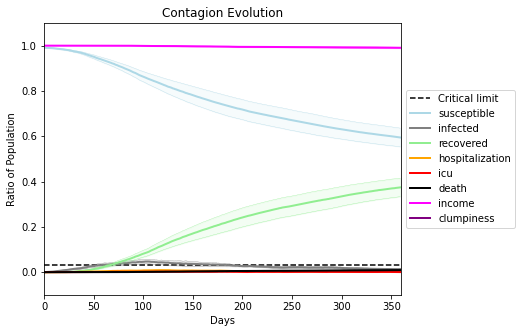

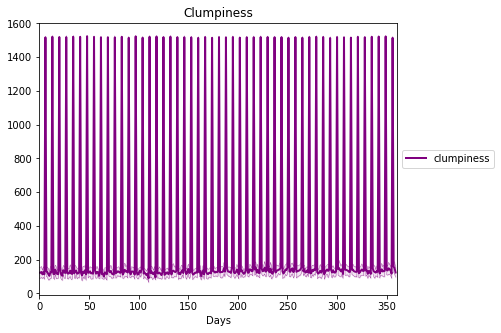

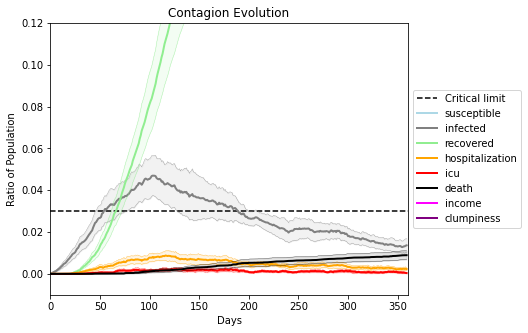

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[8902, 2508, 4459, 5675, 7962, 9651, 5108, 6610, 1638, 1850, 3846, 773, 2990, 8410, 9588, 7295, 3762, 3153, 1647, 3289]
Average similarity between family members is 0.5538346617677519 at temperature -0.9
Average similarity between family and home is 0.9998581343732483 at temperature -1
Average similarity between students and their classroom is 0.26746469730220446 at temperature -0.9
Average classroom occupancy is 1.7166666666666666 and number classrooms is 180
Average similarity between workers is 0.4712891878490223 at temperature -0.9
Average office occupancy is 3.2193877551020407 and number offices is 196
Average friend similarity for adults: 0.6074220174666886 for kids: 0.5043892555326926
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity -0.09827659226366886
avg restaurant similarity -0.3101752737507729
avg restaurant similarity 0.24145944508991665
avg restaurant similarity -0.3500823200024085
avg restaurant similarity -0.0864054209648218
avg restaurant similarity 0.40317253153878296
avg restaurant similarity -0.17848625327246037
avg restaurant similarity -0.28251846411694315
avg restaurant similarity -0.39955599161980304
avg restaurant similarity -0.260637279805481
avg restaurant similarity 0.014972425771854689
avg restaurant similarity -0.0525171729866055
avg restaurant similarity 0.5051874586694111
avg restaurant similarity -0.039731728872805516
avg restaurant similarity 0.07058825725888276
avg restaurant similarity -0.10545429363902759
avg restaurant similarity -0.03995063894152626
avg restaurant similarity -0.09317303088235203
avg restaurant similarity -0.48649955505660936
avg restaurant similarity 0.2598663101594175
avg restaurant similarity -0.09600907146064558
avg restaurant similarity

avg restaurant similarity 0.44339774752573624
avg restaurant similarity 0.2950828142582784
avg restaurant similarity -0.1409931797655981
avg restaurant similarity 0.07058825725888276
avg restaurant similarity -0.13276803362280928
avg restaurant similarity 0.4832230371372892
avg restaurant similarity 0.26604560785850856
avg restaurant similarity -0.42486401824881037
avg restaurant similarity 0.049744038673421274
avg restaurant similarity 0.03349091814649377
avg restaurant similarity -0.01166504833871575
avg restaurant similarity -0.26388788437061295
avg restaurant similarity 0.15648898412796192
avg restaurant similarity 0.2601052285005535
avg restaurant similarity -0.2934036909607948
avg restaurant similarity 0.0809767716145141
avg restaurant similarity 0.6917822758197801
avg restaurant similarity -0.420304997703294
avg restaurant similarity 0.47757484916067844
avg restaurant similarity 0.27667645945074
avg restaurant similarity -0.07608173678734173
avg restaurant similarity 0.227813016

avg restaurant similarity -0.05601231888116751
avg restaurant similarity -0.2665632642419522
avg restaurant similarity -0.23603155736046494
avg restaurant similarity -0.16119021137892953
avg restaurant similarity 0.15806010180234534
avg restaurant similarity 0.07247046768298288
avg restaurant similarity -0.17111147731328302
avg restaurant similarity 0.1790406836163417
avg restaurant similarity -0.22991329465003918
avg restaurant similarity 0.2031353861741296
avg restaurant similarity 0.15518469892156858
avg restaurant similarity 0.7996402828032187
avg restaurant similarity -0.1262106803115361
avg restaurant similarity 0.18524053196095425
avg restaurant similarity 0.15985500724191748
avg restaurant similarity -0.26709684368843567
avg restaurant similarity 0.23901731918972496
avg restaurant similarity -0.0019388441518370103
avg restaurant similarity 0.7785532251257179
avg restaurant similarity 0.5486727896788564
avg restaurant similarity 0.2043406356741638
avg restaurant similarity -0.07

avg restaurant similarity 0.2878786625665417
avg restaurant similarity 0.13318274444808254
avg restaurant similarity 0.08435788794307017
avg restaurant similarity 0.5690812320454388
avg restaurant similarity -0.30488298704767197
avg restaurant similarity -0.09696275449259197
avg restaurant similarity -0.01426598211598553
avg restaurant similarity 0.2985331490353416
avg restaurant similarity -0.16119021137892953
avg restaurant similarity 0.8075079863377889
avg restaurant similarity -0.014880382353010493
avg restaurant similarity 0.3469537640493717
avg restaurant similarity 0.3574167420556276
avg restaurant similarity 0.3101481301011621
avg restaurant similarity 0.008791936414992582
avg restaurant similarity 0.2432567156735584
avg restaurant similarity 0.32746322036768727
avg restaurant similarity 0.06647048380082562
avg restaurant similarity -0.06728771431624009
avg restaurant similarity -0.18826681848691662
avg restaurant similarity 0.2856284393125076
avg restaurant similarity 0.011314

avg restaurant similarity 0.36600694072129986
avg restaurant similarity -0.07130895103747628
avg restaurant similarity 0.010801457399445717
avg restaurant similarity 0.30951344036605394
avg restaurant similarity 0.16305841004011712
avg restaurant similarity 0.34831960358325265
avg restaurant similarity -0.06852319145821945
avg restaurant similarity -0.286333136298652
avg restaurant similarity 0.2489017483684584
avg restaurant similarity 0.036719241383725176
avg restaurant similarity 0.37676195184297745
avg restaurant similarity 0.35927309973929206
avg restaurant similarity -0.07013835852955816
avg restaurant similarity 0.18202581097391907
avg restaurant similarity 0.37676195184297745
avg restaurant similarity 0.2102655578562672
avg restaurant similarity -0.34973392144070203
avg restaurant similarity 0.21352972423664496
avg restaurant similarity -0.13320800915081932
avg restaurant similarity -0.16814770991764397
avg restaurant similarity 0.4919535408696061
avg restaurant similarity -0.1

avg restaurant similarity 0.027624383804883315
avg restaurant similarity 0.6204397984979249
avg restaurant similarity 0.43286322448336334
avg restaurant similarity 0.3949768077048168
avg restaurant similarity -0.10459549942364466
avg restaurant similarity 0.3834818808289547
avg restaurant similarity 0.1666965294099126
avg restaurant similarity 0.1234563577381693
avg restaurant similarity 0.2208850021895776
avg restaurant similarity 0.003816863310360935
avg restaurant similarity 0.14127079663697323
avg restaurant similarity 0.12533670350546078
avg restaurant similarity 0.6088321086576161
avg restaurant similarity -0.042528948011516826
avg restaurant similarity 0.21138320223182278
avg restaurant similarity -0.12965735130631817
avg restaurant similarity 0.3259943286984305
avg restaurant similarity 0.291229790409993
avg restaurant similarity 0.27027439754850513
avg restaurant similarity 0.48015808441879865
avg restaurant similarity -0.1537436756290094
avg restaurant similarity -0.107815500

avg restaurant similarity -0.04463157979365684
avg restaurant similarity 0.785817658570918
avg restaurant similarity 0.12410733006973508
avg restaurant similarity 0.1625009670241403
avg restaurant similarity 0.30316627949071495
avg restaurant similarity 0.31767566487305154
avg restaurant similarity -0.24660143564074605
avg restaurant similarity -0.04158917189359346
avg restaurant similarity 0.22890619871378648
avg restaurant similarity 0.18729661776349066
avg restaurant similarity 0.13039529966562063
avg restaurant similarity 0.4171074045564433
avg restaurant similarity -0.021172942752142425
avg restaurant similarity -0.21463060676399387
avg restaurant similarity 0.4050091421116979
avg restaurant similarity 0.3259943286984305
avg restaurant similarity 0.2393939142469763
avg restaurant similarity 0.12372738662136107
avg restaurant similarity -0.17192109954499948
avg restaurant similarity 0.4376794823057062
avg restaurant similarity 0.5362385279002334
avg restaurant similarity 0.38229280

avg restaurant similarity 0.45907790379577296
avg restaurant similarity 0.14126911330734507
avg restaurant similarity -0.1464925806326199
avg restaurant similarity 0.25576655897891054
avg restaurant similarity 0.0889601203109225
avg restaurant similarity 0.1585616398704345
avg restaurant similarity 0.03319827554574384
avg restaurant similarity -0.22032977611332885
avg restaurant similarity 0.20910129153614027
avg restaurant similarity 0.3750048115700604
avg restaurant similarity 0.20910129153614027
avg restaurant similarity -0.09296034590958108
avg restaurant similarity -0.10092559539485932
avg restaurant similarity 0.16843234800912277
avg restaurant similarity 0.11819160689292418
avg restaurant similarity -0.008955860544372755
avg restaurant similarity -0.27413461086470947
avg restaurant similarity 0.4803736822740894
avg restaurant similarity 0.08816529147044354
avg restaurant similarity 0.210724464226838
avg restaurant similarity 0.05864304352196726
avg restaurant similarity 0.121917

avg restaurant similarity -0.022335700366374358
avg restaurant similarity 0.07626653184885576
avg restaurant similarity -0.14495675120569518
avg restaurant similarity 0.5358603867729674
avg restaurant similarity -0.12307061286933418
avg restaurant similarity 0.09897890004177096
avg restaurant similarity 0.30371791035544865
avg restaurant similarity 0.3872246832436509
avg restaurant similarity 0.27659447019261685
avg restaurant similarity -0.009498916598887915
avg restaurant similarity -0.11353061587982943
avg restaurant similarity -0.1255900909915833
avg restaurant similarity -0.17554435056314352
avg restaurant similarity 0.7606506325841786
avg restaurant similarity -0.36379374175620177
avg restaurant similarity -0.10443618741997225
avg restaurant similarity 0.22220156188983065
avg restaurant similarity 0.08751493230770419
avg restaurant similarity 0.1685214226752975
avg restaurant similarity 0.5223621072973813
avg restaurant similarity 0.09634636326929714
avg restaurant similarity 0.9

avg restaurant similarity -0.04572540425436813
avg restaurant similarity -0.09820449781343199
avg restaurant similarity 0.13486393953575557
avg restaurant similarity -0.22644313353752363
avg restaurant similarity 0.3909880732746335
avg restaurant similarity 0.44223348579538124
avg restaurant similarity 0.29320632177630573
avg restaurant similarity -0.11722030056263764
avg restaurant similarity 0.07241809692474042
avg restaurant similarity -0.1430319131997242
avg restaurant similarity -0.1430319131997242
avg restaurant similarity 0.001125240473547855
avg restaurant similarity 0.026538085327157665
Average similarity between family members is 0.5424492514268151 at temperature -0.9
Average similarity between family and home is 0.9998610912386919 at temperature -1
Average similarity between students and their classroom is 0.23439558609444064 at temperature -0.9
Average classroom occupancy is 1.5421052631578946 and number classrooms is 190
Average similarity between workers is 0.460315075076

avg restaurant similarity 0.13551041225701893
avg restaurant similarity 0.1644503535096037
avg restaurant similarity 0.21611089197822034
avg restaurant similarity -0.05052009351120121
avg restaurant similarity 0.040994525313058736
avg restaurant similarity 0.2361748151064656
avg restaurant similarity -0.04864214393546718
avg restaurant similarity 0.24288455617492682
avg restaurant similarity 0.5646949355731457
avg restaurant similarity -0.19395529341617707
avg restaurant similarity -0.0679174571460419
avg restaurant similarity 0.8279054813387071
avg restaurant similarity -0.0765310057047297
avg restaurant similarity 0.1952570720469903
avg restaurant similarity 0.13384499744851863
avg restaurant similarity 0.11766229378554713
avg restaurant similarity -0.3833711179701489
avg restaurant similarity 0.21601983344361347
avg restaurant similarity -0.10963699162389628
avg restaurant similarity -0.1100358840691875
avg restaurant similarity -0.2011675572840483
avg restaurant similarity -0.27415

avg restaurant similarity 0.4914015637871749
avg restaurant similarity 0.4175726973247526
avg restaurant similarity 0.3727440566336803
avg restaurant similarity 0.5964850346220246
avg restaurant similarity 0.29315702772256463
avg restaurant similarity 0.3627770396755885
avg restaurant similarity -0.015455737898322636
avg restaurant similarity 0.10587548490787177
avg restaurant similarity -0.40405980358667637
avg restaurant similarity -0.015455737898322636
avg restaurant similarity 0.13609630208341966
avg restaurant similarity 0.018734908842059285
avg restaurant similarity 0.2067583337786519
avg restaurant similarity -0.3737182505558277
avg restaurant similarity -0.19029034034826586
avg restaurant similarity 0.2517513260136547
avg restaurant similarity 0.8270993401974625
avg restaurant similarity -0.4281592156039621
avg restaurant similarity 0.3916183659533252
avg restaurant similarity -0.0025407750924356185
avg restaurant similarity 0.1126721317979163
avg restaurant similarity -0.13795

avg restaurant similarity 0.2421632789028435
avg restaurant similarity -0.02583443779210509
avg restaurant similarity 0.0650045168809977
avg restaurant similarity 0.3697460105855661
avg restaurant similarity 0.17316535339139258
avg restaurant similarity -0.08749245848195879
avg restaurant similarity 0.14017235143871346
avg restaurant similarity 0.18866055124556746
avg restaurant similarity -0.5382150597636637
avg restaurant similarity 0.35760927480703675
avg restaurant similarity 0.2350735966808709
avg restaurant similarity -0.20192692307285343
avg restaurant similarity 0.19728515853034484
avg restaurant similarity 0.1687220240869794
avg restaurant similarity 0.07657128768035078
avg restaurant similarity 0.5651416295455514
avg restaurant similarity 0.20488925273896821
avg restaurant similarity 0.4663424100555816
avg restaurant similarity 0.35140882510094285
avg restaurant similarity -0.005740375253006271
avg restaurant similarity 0.24031082391663436
avg restaurant similarity 0.35875853

avg restaurant similarity 0.16165859543334377
Average similarity between family members is 0.5387386460624617 at temperature -0.9
Average similarity between family and home is 0.9998524830655996 at temperature -1
Average similarity between students and their classroom is 0.24078541611702795 at temperature -0.9
Average classroom occupancy is 1.6272189349112427 and number classrooms is 169
Average similarity between workers is 0.4413801524940251 at temperature -0.9
Average office occupancy is 3.4029850746268657 and number offices is 201
Average friend similarity for adults: 0.5969098486801248 for kids: 0.4841683751352781
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 

avg restaurant similarity 0.27009614731289266
avg restaurant similarity 0.1788820153660856
avg restaurant similarity 0.17924823808930718
avg restaurant similarity 0.15452373044683326
avg restaurant similarity -0.0038215045846594353
avg restaurant similarity 0.5065835896880854
avg restaurant similarity 0.1385102148327717
avg restaurant similarity -0.01129827774488868
avg restaurant similarity -0.5123441256334855
avg restaurant similarity -0.3918363183428487
avg restaurant similarity 0.10584593612561423
avg restaurant similarity 0.343909944872698
avg restaurant similarity 0.33147180265406634
avg restaurant similarity 0.19798620522031415
avg restaurant similarity 0.11615304891096773
avg restaurant similarity 0.1254416118785876
avg restaurant similarity 0.32785466984196554
avg restaurant similarity 0.01509292021543901
avg restaurant similarity 0.08088357656219118
avg restaurant similarity -0.12772351138394628
avg restaurant similarity 0.14047956465890807
avg restaurant similarity -0.060430

avg restaurant similarity -0.07989784475745457
avg restaurant similarity -0.2034970431648632
avg restaurant similarity -0.1665655548054158
avg restaurant similarity 0.10662259405924639
avg restaurant similarity 0.24471168390826126
avg restaurant similarity 0.1755039449665588
avg restaurant similarity -0.4722124242472888
avg restaurant similarity 0.3231582382377178
avg restaurant similarity 0.3351516209558151
avg restaurant similarity 0.004788630543573577
avg restaurant similarity 0.27592810945127194
avg restaurant similarity 0.11476101514053252
avg restaurant similarity 0.06768250359511453
avg restaurant similarity 0.22304281143566965
avg restaurant similarity 0.0035899947719928924
avg restaurant similarity 0.15029324090670937
avg restaurant similarity 0.20164361105706857
avg restaurant similarity -0.006740588793206907
avg restaurant similarity 0.12884984225756105
avg restaurant similarity -0.00044955859117381224
avg restaurant similarity 0.415118010483826
avg restaurant similarity 0.0

avg restaurant similarity 0.10211732860572224
avg restaurant similarity -0.11683403544257341
avg restaurant similarity 0.439553091950061
avg restaurant similarity 0.13118998135061258
avg restaurant similarity -0.06705444135710933
avg restaurant similarity 0.3407768219004643
avg restaurant similarity -0.13514246321918488
avg restaurant similarity 0.14829855002205114
avg restaurant similarity -0.06705444135710933
avg restaurant similarity 0.1969443792440653
avg restaurant similarity 0.8119780137794933
avg restaurant similarity -0.24654075304771844
avg restaurant similarity 0.19694085836245268
avg restaurant similarity -0.3515879830935066
avg restaurant similarity 0.14695475992167017
avg restaurant similarity 0.11169152265930149
avg restaurant similarity 0.4700065417661489
avg restaurant similarity 0.6059238515825209
avg restaurant similarity 0.076916077171638
avg restaurant similarity 0.17324611729413805
avg restaurant similarity -0.15734076775156886
avg restaurant similarity 0.780200256

avg restaurant similarity 0.10905967317132098
Average similarity between family members is 0.5676443268253668 at temperature -0.9
Average similarity between family and home is 0.9998571989527819 at temperature -1
Average similarity between students and their classroom is 0.23602878354896287 at temperature -0.9
Average classroom occupancy is 1.752808988764045 and number classrooms is 178
Average similarity between workers is 0.4498545331840001 at temperature -0.9
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.6031540608293262 for kids: 0.5175073104831774
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 peo

avg restaurant similarity -0.07639202139966583
avg restaurant similarity -0.0031699560936697957
avg restaurant similarity -0.0014893499250126692
avg restaurant similarity 0.03463124751072144
avg restaurant similarity -0.15873814582352458
avg restaurant similarity -0.14025269502347948
avg restaurant similarity 0.3839811557733819
avg restaurant similarity -0.15217680035696796
avg restaurant similarity -0.09881858389467425
avg restaurant similarity -0.1848572710816065
avg restaurant similarity 0.08675451065231415
avg restaurant similarity -0.16414681011105497
avg restaurant similarity -0.16414681011105497
avg restaurant similarity -0.10431313008660298
avg restaurant similarity -0.21963141635731795
avg restaurant similarity 0.105592937611003
avg restaurant similarity 0.9588842742084026
avg restaurant similarity 0.12472810237533488
avg restaurant similarity -0.31414843631912115
avg restaurant similarity -0.1822473199095304
avg restaurant similarity -0.04519007945530962
avg restaurant simila

avg restaurant similarity -0.03490200095916536
avg restaurant similarity 0.7688688647997022
avg restaurant similarity 0.07341471022793158
avg restaurant similarity 0.4896932508214955
avg restaurant similarity -0.03490200095916536
avg restaurant similarity -0.016076414617840595
avg restaurant similarity 0.013151155267947696
avg restaurant similarity 0.10146431120072749
avg restaurant similarity 0.19455305347253757
avg restaurant similarity -0.273845600295286
avg restaurant similarity 0.11948729672400842
avg restaurant similarity 0.10205214741684286
avg restaurant similarity 0.04883682619581397
avg restaurant similarity 0.2823011936598732
avg restaurant similarity 0.20174670527347408
avg restaurant similarity 0.447507963867106
avg restaurant similarity 0.29506337429591223
avg restaurant similarity 0.5454179739638204
avg restaurant similarity -0.08397227361742222
avg restaurant similarity -0.0016894735284780221
avg restaurant similarity 0.12158568037850302
avg restaurant similarity -0.223

avg restaurant similarity 0.10497455703862839
avg restaurant similarity 0.02443819841038454
avg restaurant similarity 0.2414383399242263
avg restaurant similarity 0.0806766220516483
avg restaurant similarity 0.2933300251105827
avg restaurant similarity -0.02553222532545139
avg restaurant similarity 0.4878649927287916
avg restaurant similarity -0.03928139030219513
avg restaurant similarity 0.28780317170232156
avg restaurant similarity 0.36014551152517904
avg restaurant similarity 0.3544253635554865
avg restaurant similarity 0.24949553968303062
avg restaurant similarity 0.16452169037051728
avg restaurant similarity -0.0052667307378871445
avg restaurant similarity 0.0976116446875291
avg restaurant similarity -0.11478003617765085
avg restaurant similarity 0.09333414802917193
avg restaurant similarity -0.2869008415097406
avg restaurant similarity 0.1124271739983742
avg restaurant similarity 0.43794455446117786
avg restaurant similarity 0.006081590361894206
avg restaurant similarity 0.193713

avg restaurant similarity -0.07598813034406071
avg restaurant similarity 0.07138819975537895
avg restaurant similarity 0.1793345498058666
avg restaurant similarity -0.04587711225270746
avg restaurant similarity -0.06377491259453347
avg restaurant similarity -0.16408539111807002
avg restaurant similarity 0.3435273184317723
avg restaurant similarity -0.2656189326706444
avg restaurant similarity 0.10497065460131529
avg restaurant similarity 0.0012126584980128724
avg restaurant similarity -0.07786799406644213
avg restaurant similarity -0.029432418384392436
avg restaurant similarity 0.13200495712706942
avg restaurant similarity 0.14160305760696493
avg restaurant similarity 0.13137381731725292
avg restaurant similarity 0.2597178698708031
avg restaurant similarity -0.12304695270478723
avg restaurant similarity 0.1841847225406402
avg restaurant similarity 0.24107313230741312
avg restaurant similarity -0.03846216279332933
avg restaurant similarity 0.11490251104592794
avg restaurant similarity 0

avg restaurant similarity 0.25444199844792154
avg restaurant similarity -0.1259309931996318
avg restaurant similarity 0.14498607031284821
avg restaurant similarity -0.3923621811625847
avg restaurant similarity -0.1471749199575583
avg restaurant similarity -0.08900648575158986
avg restaurant similarity 0.4417628447763229
Average similarity between family members is 0.5326768848240373 at temperature -0.9
Average similarity between family and home is 0.9998558421805661 at temperature -1
Average similarity between students and their classroom is 0.23113074733649394 at temperature -0.9
Average classroom occupancy is 1.679144385026738 and number classrooms is 187
Average similarity between workers is 0.451797403164957 at temperature -0.9
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.5938433722603577 for kids: 0.4997653786896028
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity -0.03762908692661795
avg restaurant similarity -0.13956135046417173
avg restaurant similarity -0.1717253667142158
avg restaurant similarity 0.3757822085262452
avg restaurant similarity -0.01967899424840512
avg restaurant similarity 0.009222273208462414
avg restaurant similarity 0.25897923703458164
avg restaurant similarity 0.2024828998715885
avg restaurant similarity 0.009222273208462414
avg restaurant similarity 0.7417821941188915
avg restaurant similarity 0.2421025988961341
avg restaurant similarity 0.28290600835706264
avg restaurant similarity 0.16442556519914692
avg restaurant similarity 0.3064184490125048
avg restaurant similarity 0.5369258905568604
avg restaurant similarity -0.0698247531002049
avg restaurant similarity 0.08352460236080815
avg restaurant similarity 0.1523214766398078
avg restaurant similarity 0.27784334066888966
avg restaurant similarity 0.2619470639074786
avg restaurant similarity -0.17255901921648661
avg restaurant similarity -0.0489636

Average friend similarity for adults: 0.6012270071921725 for kids: 0.5065833782596673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.4161105389393758
avg restaurant similarity 0.1631839608794653
avg restaurant similarity 0.14249856823234686
avg restaurant similarity 0.14787018276738237
avg restaurant similarity 0.016823699678003397
avg restaurant similarity 0.24846769937378577
avg restaurant similarity 0.03926544819531636
avg restaurant similarity 0.551062706665908
avg restaurant similarity -0.032545402671974206
avg restaurant similarity -0.07787290019886899
avg restaurant similarity 0.23812085991831827
avg restaurant similarity 0.03697141919781449
avg restaurant similarity 0.07936064580127332
avg restaurant similarity 0.1359849512954642
avg restaurant similarity 0.23606890782524087
avg restaurant similarity 0.26593684599870854
avg restaurant similarity -0.047223486275890306
avg restaurant similarity -0.04323820797589928
avg restaurant similarity -0.2546480351645537
avg restaurant similarity 0.189829602138526
avg restaurant similarity 0.23845044854058123
avg restaurant similarity -0.17482

avg restaurant similarity -0.10396564414724602
avg restaurant similarity -0.10590555373782579
avg restaurant similarity 0.22172593705427426
avg restaurant similarity 0.2788477298854569
avg restaurant similarity 0.3992355444172576
avg restaurant similarity 0.11708128995741335
avg restaurant similarity 0.21677928427866913
avg restaurant similarity 0.35063595774697626
avg restaurant similarity 0.4098935330625906
avg restaurant similarity 0.08070894219815235
avg restaurant similarity 0.037192893859493974
avg restaurant similarity 0.2648465146066512
avg restaurant similarity 0.5158438240138101
avg restaurant similarity 0.4976551050430911
avg restaurant similarity 0.09478036331823608
avg restaurant similarity 0.08073077444893058
avg restaurant similarity 0.013375717283709655
avg restaurant similarity -0.08805790534686299
avg restaurant similarity -0.17116320855333023
avg restaurant similarity 0.19311368893221004
avg restaurant similarity -0.08552557994289016
avg restaurant similarity 0.06340

avg restaurant similarity -0.17832867762006765
avg restaurant similarity 0.30516015586124606
avg restaurant similarity 0.23358413235532605
avg restaurant similarity 0.3268115109092218
avg restaurant similarity 0.7212414550894655
avg restaurant similarity 0.4940620717150643
avg restaurant similarity 0.16239511239637877
avg restaurant similarity 0.18992807469570033
avg restaurant similarity 0.7544842137695394
avg restaurant similarity -0.06648731858051843
avg restaurant similarity 0.19401953266423383
avg restaurant similarity -0.12571127115676373
avg restaurant similarity -0.08187829135099313
avg restaurant similarity 0.34520775655611174
avg restaurant similarity 0.17074861699619145
avg restaurant similarity 0.9998095532965071
avg restaurant similarity 0.17129560879147152
avg restaurant similarity -0.25127652879884166
avg restaurant similarity 0.2294000860487111
avg restaurant similarity -0.1469440652191689
avg restaurant similarity 0.2523772385373507
avg restaurant similarity 0.51260819

avg restaurant similarity -0.4005532294087655
avg restaurant similarity 0.05861048714276692
avg restaurant similarity -0.03452383358986581
avg restaurant similarity 0.11579843420556822
avg restaurant similarity 0.22716526814832516
avg restaurant similarity -0.5459945025355535
avg restaurant similarity 0.5185912818994926
avg restaurant similarity 0.16776362313659643
avg restaurant similarity 0.21044510834094088
avg restaurant similarity -0.4125001925164311
avg restaurant similarity -0.26603792880943383
avg restaurant similarity -0.0663201429050039
avg restaurant similarity 0.32933367524019214
avg restaurant similarity 0.5265938026624855
avg restaurant similarity 0.4713337254302694
avg restaurant similarity -0.03225002351745731
avg restaurant similarity 0.374340266988278
avg restaurant similarity 0.33276919752707823
avg restaurant similarity 0.2609615864134369
avg restaurant similarity 0.11360609862472061
avg restaurant similarity 0.12429543070748231
avg restaurant similarity 0.226958731

avg restaurant similarity 0.41014717576276327
avg restaurant similarity -0.46025229417187946
avg restaurant similarity -0.11456392174703797
avg restaurant similarity 0.2732498536933341
avg restaurant similarity 0.0747385195792799
avg restaurant similarity 0.24934848790968922
avg restaurant similarity -0.20605296150682728
avg restaurant similarity 0.0840438860686851
avg restaurant similarity -0.04579371073038849
avg restaurant similarity -0.18937875493726353
avg restaurant similarity -0.18293199427634926
avg restaurant similarity 0.08937947255075196
avg restaurant similarity 0.3042170671059049
avg restaurant similarity 0.34397168083981244
avg restaurant similarity 0.38902465599701297
avg restaurant similarity -0.07558286547755277
avg restaurant similarity -0.14331837727499627
avg restaurant similarity 0.1738189862112754
avg restaurant similarity 0.052319218848267866
avg restaurant similarity 0.06905484517945779
avg restaurant similarity -0.03286461077308924
avg restaurant similarity -0.

avg restaurant similarity 0.13988313680587
avg restaurant similarity 0.8149044555261227
avg restaurant similarity 0.13506922940968355
avg restaurant similarity 0.09879412210314895
avg restaurant similarity 0.05744872860758795
avg restaurant similarity 0.0037242312572110664
avg restaurant similarity -0.13212148338153323
avg restaurant similarity -0.18647203824195369
avg restaurant similarity 0.22264192977396752
avg restaurant similarity -0.17703213706322551
avg restaurant similarity -0.12032973996438805
avg restaurant similarity 0.2589463607822023
avg restaurant similarity 0.583153358767813
avg restaurant similarity 0.5951321933574205
avg restaurant similarity 0.03320331342781106
avg restaurant similarity -0.19431348661670353
avg restaurant similarity -0.12838695779494702
avg restaurant similarity 0.3915485485066144
avg restaurant similarity 0.06219796654020199
avg restaurant similarity -0.16494686939648406
avg restaurant similarity 0.42663377802692837
Average similarity between family 

avg restaurant similarity -0.5000678919406425
avg restaurant similarity 0.3829202244198436
avg restaurant similarity 0.07121591276246071
avg restaurant similarity 0.032621373715202504
avg restaurant similarity 0.22782236271481127
avg restaurant similarity 0.152645835295205
avg restaurant similarity 0.25539794972924024
avg restaurant similarity -0.09766551669629825
avg restaurant similarity -0.13450768158434068
avg restaurant similarity 0.02084686651055595
avg restaurant similarity 0.22597799317995812
avg restaurant similarity 0.2149849388904068
avg restaurant similarity 0.4997949935814912
avg restaurant similarity 0.37455653498204833
avg restaurant similarity -0.11482217498918729
avg restaurant similarity 0.15760239079843888
avg restaurant similarity 0.1890267743911916
avg restaurant similarity 0.34079610004034944
avg restaurant similarity 0.16176062591692042
avg restaurant similarity -0.006806593873895185
avg restaurant similarity -0.37438953241057554
avg restaurant similarity 0.56851

avg restaurant similarity 0.17832572925893245
avg restaurant similarity 0.25874361402921087
avg restaurant similarity 0.06484963431785286
avg restaurant similarity -0.4222724570603484
avg restaurant similarity -0.041323312303562135
avg restaurant similarity 0.08824115862478672
avg restaurant similarity -0.11015679203771232
avg restaurant similarity -0.047769399659297995
avg restaurant similarity 0.049886166558092984
avg restaurant similarity 0.260341777868591
avg restaurant similarity 0.44177480208033126
avg restaurant similarity 0.09919384071541268
avg restaurant similarity 0.5032734575164838
avg restaurant similarity 0.27898386507628914
avg restaurant similarity -0.36844545603395434
avg restaurant similarity -0.17177745605751768
avg restaurant similarity -0.5587059048047571
avg restaurant similarity 0.44385817411118367
avg restaurant similarity 0.8271250162265604
avg restaurant similarity -0.4207624592640268
avg restaurant similarity 0.3367209891680666
avg restaurant similarity -0.11

avg restaurant similarity -0.11804846572847727
avg restaurant similarity 0.23659363698569555
avg restaurant similarity 0.6937111062799473
avg restaurant similarity -0.05809852708383009
avg restaurant similarity 0.2954233240195166
avg restaurant similarity -0.15156787275468397
avg restaurant similarity 0.13346736361803663
avg restaurant similarity 0.2262227758406922
avg restaurant similarity 0.15117958625623173
avg restaurant similarity -0.10347586240704826
avg restaurant similarity 0.026861852805735206
avg restaurant similarity 0.08054660295409283
avg restaurant similarity 0.34101391321776797
avg restaurant similarity 0.38812478947467693
avg restaurant similarity -0.0221851065839877
avg restaurant similarity -0.004084142509924907
avg restaurant similarity -0.18103110504826367
avg restaurant similarity -0.23894268403802166
avg restaurant similarity 0.11042448744567437
avg restaurant similarity 0.1134801906589275
avg restaurant similarity -0.15569019792253005
avg restaurant similarity 0.

avg restaurant similarity -0.002098145524975864
avg restaurant similarity -0.17637275701176658
avg restaurant similarity 0.11714358085028324
avg restaurant similarity 0.16245999560426272
avg restaurant similarity -0.032326427495604784
avg restaurant similarity -0.36539096440689184
avg restaurant similarity 0.21989798500251326
avg restaurant similarity -0.026092796924745358
avg restaurant similarity -0.07029160240090651
avg restaurant similarity 0.01292752061487715
avg restaurant similarity -0.39596869433819215
avg restaurant similarity 0.1302010165955917
avg restaurant similarity -0.07565178090746916
avg restaurant similarity 0.08272612949540645
avg restaurant similarity -0.13783737291470538
avg restaurant similarity 0.08904481143024379
avg restaurant similarity -0.08530736833429917
avg restaurant similarity -0.06616777565832259
avg restaurant similarity -0.04040137906032925
avg restaurant similarity -0.01082589766338081
avg restaurant similarity 0.18808187886173605
avg restaurant simi

avg restaurant similarity -0.3112183136905473
avg restaurant similarity 0.34957646302766776
avg restaurant similarity -0.030840228344227345
avg restaurant similarity 0.40758807255652296
avg restaurant similarity 0.21591868849126356
avg restaurant similarity 0.06699520206325643
avg restaurant similarity -0.34788049048047115
avg restaurant similarity -0.31150831896190095
avg restaurant similarity -0.34788049048047115
avg restaurant similarity 0.18533101068902105
avg restaurant similarity -0.3458435082379072
avg restaurant similarity 0.05744101468327468
avg restaurant similarity -0.030840228344227345
avg restaurant similarity 0.02313785795249078
avg restaurant similarity -0.3399417579031975
avg restaurant similarity 0.14061231871596205
avg restaurant similarity -0.07053206829999574
avg restaurant similarity 0.01292752061487715
avg restaurant similarity 0.16093781995016077
avg restaurant similarity -0.06231626482753548
avg restaurant similarity -0.17040785500686878
avg restaurant similarit

(<function dict.items>, <function dict.items>, <function dict.items>)

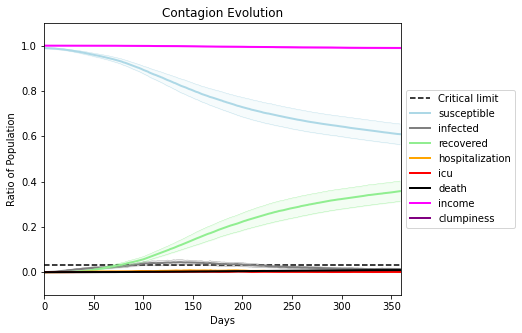

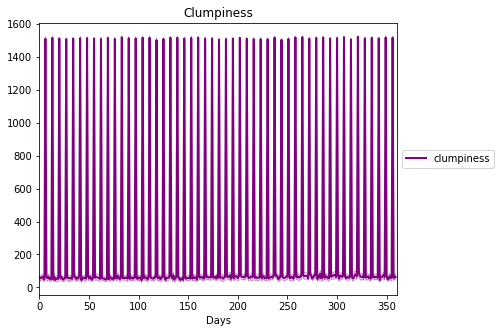

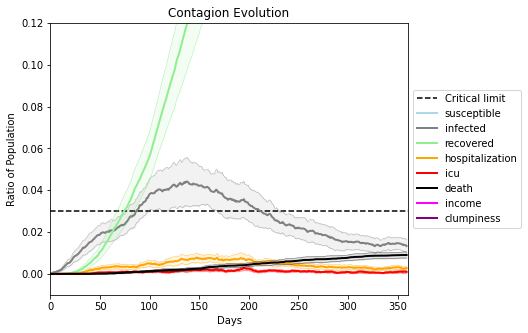

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6423, 7662, 338, 737, 4501, 9459, 270, 3552, 2343, 2983, 7785, 9135, 1078, 746, 8, 1149, 579, 3877, 3477, 1507]
Average similarity between family members is 0.4263125745607533 at temperature -0.8
Average similarity between family and home is 0.9998689952830677 at temperature -1
Average similarity between students and their classroom is 0.1635522133682332 at temperature -0.8
Average classroom occupancy is 1.6494252873563218 and number classrooms is 174
Average similarity between workers is 0.27910735771714773 at temperature -0.8
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.49229638750776117 for kids: 0.3815007844481213
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.14362804902452653
avg restaurant similarity 0.2906848772469259
avg restaurant similarity 0.4172896064606374
avg restaurant similarity 0.38827516309914706
avg restaurant similarity 0.2460215014482035
avg restaurant similarity -0.04563155537117412
avg restaurant similarity -0.035697142214490385
avg restaurant similarity -0.04939436189199814
avg restaurant similarity 0.21073122753314433
avg restaurant similarity -0.09841843029815439
avg restaurant similarity 0.0832804052217263
avg restaurant similarity 0.2906186450617503
avg restaurant similarity 0.4687220432141903
avg restaurant similarity 0.2986131824918448
avg restaurant similarity -0.0703673774693811
avg restaurant similarity 0.03126731655383674
avg restaurant similarity 0.15887432762661916
avg restaurant similarity 0.36366180879439264
avg restaurant similarity -0.13150764561636347
avg restaurant similarity 0.017664230566643572
avg restaurant similarity 0.502063172987729
avg restaurant similarity -0.1430656

avg restaurant similarity -0.07496095333474499
avg restaurant similarity -0.400768060932592
avg restaurant similarity -0.10648649831362086
avg restaurant similarity -0.0653276023526983
avg restaurant similarity -0.3353518404270901
avg restaurant similarity -0.11399809059638338
avg restaurant similarity 0.025672086533600647
avg restaurant similarity -0.0718342962036723
avg restaurant similarity 0.1434135522936696
avg restaurant similarity 0.2750635715985919
avg restaurant similarity -0.035697142214490385
avg restaurant similarity -0.2909072074991236
avg restaurant similarity -0.0037407337335617352
avg restaurant similarity 0.15196240668521155
avg restaurant similarity 0.1440374821534251
avg restaurant similarity 0.09776004684323739
avg restaurant similarity 0.24284132827474808
avg restaurant similarity 0.12589929414366796
avg restaurant similarity 0.07325911224113915
avg restaurant similarity 0.08099700432696906
avg restaurant similarity -0.12858224484827563
avg restaurant similarity 0.

avg restaurant similarity 0.34676610597574936
avg restaurant similarity 0.04424476240620269
avg restaurant similarity 0.4587103299114822
avg restaurant similarity 0.06348452899535507
avg restaurant similarity 0.12400678393693913
avg restaurant similarity 0.2444039255738752
avg restaurant similarity 0.2444039255738752
avg restaurant similarity 0.016627024961303225
avg restaurant similarity 0.20751075360711996
avg restaurant similarity -0.2295965236048142
avg restaurant similarity -0.44867060360183797
avg restaurant similarity 0.3551636644417178
avg restaurant similarity 0.13960004290222297
avg restaurant similarity -0.11120154603772478
avg restaurant similarity -0.13550721525755308
avg restaurant similarity 0.0824461500437521
avg restaurant similarity -0.10857399429851287
avg restaurant similarity 0.16900063679081026
avg restaurant similarity 0.12728454289783186
avg restaurant similarity 0.0794751785526054
avg restaurant similarity 0.09091795268721535
avg restaurant similarity 0.2310759

avg restaurant similarity 0.67884476784282
avg restaurant similarity 0.008233460979088475
avg restaurant similarity 0.23806392006727017
avg restaurant similarity 0.1238745741078982
avg restaurant similarity 0.3991187444953286
avg restaurant similarity -0.10460288612389984
Average similarity between family members is 0.42928454773329394 at temperature -0.8
Average similarity between family and home is 0.9998634878409688 at temperature -1
Average similarity between students and their classroom is 0.172654674552364 at temperature -0.8
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.27407325160985235 at temperature -0.8
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.4871655896096148 for kids: 0.3732758819634103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 peo

avg restaurant similarity -0.31814104686841277
avg restaurant similarity -0.005891948573197149
avg restaurant similarity 0.018007082441930625
avg restaurant similarity 0.048629897526225756
avg restaurant similarity 0.13651164912076963
avg restaurant similarity 0.06944793516423653
avg restaurant similarity -0.17255400899995768
avg restaurant similarity -0.5502095084321423
avg restaurant similarity 0.04771177406849173
avg restaurant similarity -0.10704306691892783
avg restaurant similarity 0.028846534755173403
avg restaurant similarity 0.055675340378727144
avg restaurant similarity -0.03450935277314065
avg restaurant similarity 0.14356922453656193
avg restaurant similarity -0.3513193505975363
avg restaurant similarity 0.06614886323329389
avg restaurant similarity 0.18076566069770245
avg restaurant similarity 0.005089406189476618
avg restaurant similarity -0.07966636058652726
avg restaurant similarity -0.07966636058652726
avg restaurant similarity -0.037252911907851405
avg restaurant simi

Average similarity between workers is 0.27668846197474806 at temperature -0.8
Average office occupancy is 3.3398058252427183 and number offices is 206
Average friend similarity for adults: 0.4986051216243687 for kids: 0.362386845139864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.1799985319430979
avg restaurant similarity 0.32170568434429725
avg restaurant similarity -0.09508328445122609
avg restaurant similarity 0.06740208209490203
avg restaurant similarity 0.18094725332041284
avg restaurant similarity -0.0588589120307483
avg restaurant similarity 0.12229206476804484
avg restaurant similarity -0.03149212635566458
avg restaurant similarity 0.6766149931883039
avg restaurant similarity 0.389208199309758
avg restaurant similarity 0.1386608828042292
avg restaurant similarity 0.3058748819710256
avg restaurant similarity -0.10813117826597166
avg restaurant similarity 0.24220947195913525
avg restaurant similarity 0.0635291757470681
avg restaurant similarity 0.06308156203455585
avg restaurant similarity -0.14319304721859985
avg restaurant similarity 0.05297135192151317
avg restaurant similarity 0.03140488351950968
avg restaurant similarity 0.5952034007620731
avg restaurant similarity 0.3047570559961884
avg restaurant similarity 0.00695354135

avg restaurant similarity 0.11666496656026022
avg restaurant similarity -0.03558148785320186
avg restaurant similarity 0.09635108156139147
avg restaurant similarity -0.10596931653193709
avg restaurant similarity 0.2810602282739615
avg restaurant similarity 0.05297135192151317
avg restaurant similarity -0.048800785472171156
avg restaurant similarity -0.07405373010823602
avg restaurant similarity -0.007248143968880664
avg restaurant similarity -0.09859211373259587
avg restaurant similarity 0.42766146759279156
avg restaurant similarity -0.018923745300355926
avg restaurant similarity 0.013232907426792513
avg restaurant similarity 0.013802788920407746
avg restaurant similarity -0.005381533896384426
avg restaurant similarity 0.1561927022371021
avg restaurant similarity 0.20629362413854102
avg restaurant similarity 0.0626739598337824
avg restaurant similarity -0.17787543112785953
avg restaurant similarity -0.19534695302569557
avg restaurant similarity -0.038159893908473144
avg restaurant simi

avg restaurant similarity 0.05616332909629161
avg restaurant similarity 0.12315888997176673
avg restaurant similarity 0.20653604426515132
avg restaurant similarity -0.45980356076199513
avg restaurant similarity 0.11123317177199715
avg restaurant similarity 0.02595465671613717
avg restaurant similarity -0.23870860250052717
avg restaurant similarity 0.2001127074831094
avg restaurant similarity -0.2187055888422523
avg restaurant similarity -0.10967470407930485
avg restaurant similarity 0.015583542370190537
avg restaurant similarity 0.4347910527184844
avg restaurant similarity 0.11108991156149355
avg restaurant similarity 0.6164922609954724
avg restaurant similarity -0.19675015338330065
avg restaurant similarity -0.0995436617427325
avg restaurant similarity 0.1857153274382139
avg restaurant similarity 0.14559283392527933
avg restaurant similarity 0.2672285165114094
avg restaurant similarity 0.02148198338333633
avg restaurant similarity 0.34580250680447866
avg restaurant similarity 0.340788

avg restaurant similarity 0.017599722644082147
avg restaurant similarity 0.07626239941642855
avg restaurant similarity 0.24071318547395862
avg restaurant similarity 0.23323821722945978
avg restaurant similarity 0.16301032656701445
avg restaurant similarity 0.14559283392527933
avg restaurant similarity 0.22167236428251477
avg restaurant similarity 0.09931916959970741
avg restaurant similarity 0.08411872151845318
avg restaurant similarity 0.28571072620100413
avg restaurant similarity 0.34054380649196003
Average similarity between family members is 0.4438836712739566 at temperature -0.8
Average similarity between family and home is 0.9998583472040897 at temperature -1
Average similarity between students and their classroom is 0.18710722986606293 at temperature -0.8
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.27488160308486265 at temperature -0.8
Average office occupancy is 3.245 and number offices is 200
Average fr

avg restaurant similarity 0.30585212755739116
avg restaurant similarity -0.054699123308397504
avg restaurant similarity -0.2405969882672037
avg restaurant similarity 0.41683632674663695
avg restaurant similarity 0.13647731924891626
avg restaurant similarity 0.4241142515129114
avg restaurant similarity 0.2670166625438555
avg restaurant similarity -0.002251165799461713
avg restaurant similarity 0.11443529994165913
avg restaurant similarity 0.11646341517828365
avg restaurant similarity -0.2405969882672037
avg restaurant similarity -0.20618706178933704
avg restaurant similarity 0.18392638475040918
avg restaurant similarity 0.41996614875509347
avg restaurant similarity 0.15261307044907216
avg restaurant similarity 0.2792649581844252
avg restaurant similarity 0.703833661409582
avg restaurant similarity 0.10582547930898578
avg restaurant similarity 0.1344097049297906
avg restaurant similarity -0.3093190723984671
avg restaurant similarity -0.014897630195700104
avg restaurant similarity 0.19132

avg restaurant similarity -0.04461980204252404
avg restaurant similarity 0.7657356158826119
avg restaurant similarity 0.3001942864260307
avg restaurant similarity 0.4533697547066874
avg restaurant similarity 0.17527868580637831
avg restaurant similarity 0.0014819394117522866
avg restaurant similarity 0.12381902815445626
avg restaurant similarity 0.1885347001808536
avg restaurant similarity -0.3164743394562764
avg restaurant similarity -0.10090449818653706
avg restaurant similarity 0.08184053749275859
avg restaurant similarity -0.15531100441670972
avg restaurant similarity -0.020234107087267347
avg restaurant similarity 0.3077212129393454
avg restaurant similarity 0.04924965421059433
avg restaurant similarity 0.10247727626335329
avg restaurant similarity 0.034100927411146516
avg restaurant similarity -0.20725997330083706
avg restaurant similarity -0.062430595272465264
avg restaurant similarity 0.014058976615323529
avg restaurant similarity 0.11663586064039767
avg restaurant similarity 0

avg restaurant similarity -0.05416480025879683
avg restaurant similarity 0.057423184668926805
avg restaurant similarity 0.08477302723314298
avg restaurant similarity 0.17613080229166644
avg restaurant similarity 0.04438971975588278
avg restaurant similarity 0.14814396994524792
avg restaurant similarity -0.11325524057434036
avg restaurant similarity 0.01786705115635919
avg restaurant similarity 0.03789161404891775
avg restaurant similarity -0.016673614359879373
avg restaurant similarity 0.13880870452637112
avg restaurant similarity 0.11030738886200384
avg restaurant similarity -0.03213529369626768
avg restaurant similarity 0.0014819394117522866
avg restaurant similarity 0.24650590523435886
avg restaurant similarity -0.13370367548397027
avg restaurant similarity -0.1256195952535811
avg restaurant similarity 0.1431646976492209
avg restaurant similarity -0.15547384743198195
avg restaurant similarity 0.2769789133446823
avg restaurant similarity -0.19715526647738105
avg restaurant similarity

avg restaurant similarity -0.4869767803226681
avg restaurant similarity 0.07930340753959952
avg restaurant similarity -0.2705261964715341
avg restaurant similarity 0.1030739097263685
avg restaurant similarity -0.08072831816685978
avg restaurant similarity 0.33829419933878546
avg restaurant similarity 0.1373129866418434
avg restaurant similarity 0.03572815578766326
avg restaurant similarity 0.3634497843608137
avg restaurant similarity 0.080912187182075
avg restaurant similarity 0.08629124290386746
avg restaurant similarity 0.2873807348290449
avg restaurant similarity 0.07327009231836837
avg restaurant similarity 0.07169619224438083
avg restaurant similarity 0.32205607284064314
avg restaurant similarity 0.6142878175103947
avg restaurant similarity -0.031208162207296018
avg restaurant similarity 0.08629124290386746
avg restaurant similarity 0.07744468619978148
avg restaurant similarity 0.07169619224438083
avg restaurant similarity 0.21475834730014529
avg restaurant similarity -0.069747185

avg restaurant similarity -0.08297688003391206
avg restaurant similarity -0.13472861070401232
avg restaurant similarity 0.15062464335914608
avg restaurant similarity 0.26735203657107404
avg restaurant similarity 0.19370478060052762
avg restaurant similarity -0.3325201061915207
avg restaurant similarity 0.3770930511275753
avg restaurant similarity 0.25415312707034854
avg restaurant similarity 0.261379563853552
avg restaurant similarity -0.13997158240903712
avg restaurant similarity 0.39071393236559976
avg restaurant similarity 0.25415312707034854
avg restaurant similarity 0.2159621488604298
avg restaurant similarity 0.43510942897260807
avg restaurant similarity 0.6952841131199305
avg restaurant similarity 0.16186837785257502
avg restaurant similarity 0.723471928310242
avg restaurant similarity 0.4500756633699615
avg restaurant similarity 0.042194963677087555
avg restaurant similarity 0.07991828718367447
avg restaurant similarity -0.07970002315114288
avg restaurant similarity -0.13755361

Average similarity between students and their classroom is 0.13476631689443372 at temperature -0.8
Average classroom occupancy is 1.6179775280898876 and number classrooms is 178
Average similarity between workers is 0.30454611159703404 at temperature -0.8
Average office occupancy is 3.161764705882353 and number offices is 204
Average friend similarity for adults: 0.5003727467488298 for kids: 0.3774799481819571
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated i

avg restaurant similarity 0.3899075954140038
avg restaurant similarity 0.6792557079110298
avg restaurant similarity 0.2999520551001378
avg restaurant similarity 0.012438908170068604
avg restaurant similarity 0.3587423654796038
avg restaurant similarity 0.28876401570118526
avg restaurant similarity 0.29024152761153954
avg restaurant similarity 0.0637183912498265
avg restaurant similarity -0.08639390109026311
avg restaurant similarity 0.3941779021147287
avg restaurant similarity 0.3256165450195233
avg restaurant similarity 0.20903818994305348
avg restaurant similarity 0.11207129281741304
avg restaurant similarity 0.39203313536734863
avg restaurant similarity 0.22683384623236852
avg restaurant similarity 0.1805390795158025
avg restaurant similarity 0.433053352703773
avg restaurant similarity 0.3540550155743295
avg restaurant similarity 0.4807290174539193
avg restaurant similarity 0.2491700543189026
avg restaurant similarity 0.19150991421468858
avg restaurant similarity 0.26059824112293545

avg restaurant similarity 0.11357585298406059
avg restaurant similarity -0.28282697983760663
avg restaurant similarity 0.3992860114881871
avg restaurant similarity -0.16708287084700219
avg restaurant similarity 0.01579313078614468
avg restaurant similarity 0.8336867574111659
avg restaurant similarity -0.045422965041879794
avg restaurant similarity -0.18954631750060116
avg restaurant similarity 0.4050586141617477
avg restaurant similarity -0.5413582040426664
avg restaurant similarity 0.16698100576900712
avg restaurant similarity -0.16708287084700219
avg restaurant similarity 0.7186399967102939
avg restaurant similarity -0.08279931523285564
avg restaurant similarity -0.25973069304403473
avg restaurant similarity 0.03979487294925438
avg restaurant similarity 0.45764403808159165
avg restaurant similarity 0.22326054015630964
avg restaurant similarity 0.2783351746121255
avg restaurant similarity 0.023594795773742294
avg restaurant similarity -0.27053745292812287
avg restaurant similarity 0.1

avg restaurant similarity 0.5938644530957714
avg restaurant similarity 0.34598628375565205
avg restaurant similarity 0.1342746859153005
avg restaurant similarity 0.14516612650299737
avg restaurant similarity -0.0019908108908995906
avg restaurant similarity 0.13741846308848366
avg restaurant similarity -0.07583292424826255
avg restaurant similarity 0.3120909342355402
avg restaurant similarity -0.16291045724166783
avg restaurant similarity 0.7268184667683694
avg restaurant similarity -0.16263150732114226
Average similarity between family members is 0.4139125195340708 at temperature -0.8
Average similarity between family and home is 0.999856850120909 at temperature -1
Average similarity between students and their classroom is 0.18544229063455905 at temperature -0.8
Average classroom occupancy is 1.6836158192090396 and number classrooms is 177
Average similarity between workers is 0.2708469724965886 at temperature -0.8
Average office occupancy is 3.2857142857142856 and number offices is 19

avg restaurant similarity 0.5193281780460208
avg restaurant similarity 0.18329481766738626
avg restaurant similarity -0.6537038641287225
avg restaurant similarity -0.08099919262061246
avg restaurant similarity 0.10642198706572661
avg restaurant similarity -0.3648012879742829
avg restaurant similarity 0.8435831031327199
avg restaurant similarity 0.37508441195272446
avg restaurant similarity 0.17617884873534473
avg restaurant similarity 0.2902703356236043
avg restaurant similarity 0.4020176941727258
avg restaurant similarity -0.21885420333788025
avg restaurant similarity -0.4157649031172048
avg restaurant similarity 0.38134853641958427
avg restaurant similarity 0.2154038434791148
avg restaurant similarity -0.23032808016714515
avg restaurant similarity -0.3225545957120032
avg restaurant similarity -0.2660640870510533
avg restaurant similarity -0.22899466512170896
avg restaurant similarity -0.34642319064942223
avg restaurant similarity 0.29965675260868146
avg restaurant similarity 0.100586

avg restaurant similarity 0.028481901116665945
avg restaurant similarity 0.12073456979611302
avg restaurant similarity -0.056646936416022
avg restaurant similarity -0.06930897152539615
avg restaurant similarity -0.0523800869150776
avg restaurant similarity -0.08081213411306423
avg restaurant similarity -0.19139814921397394
avg restaurant similarity 0.37540116683832964
avg restaurant similarity -0.011449787249989046
avg restaurant similarity 0.10381307403348768
avg restaurant similarity -0.19309802900843392
avg restaurant similarity 0.08463628560885395
avg restaurant similarity -0.12557877622675206
avg restaurant similarity 0.1108103954068076
avg restaurant similarity 0.10505261935840735
avg restaurant similarity 0.16809511449471418
avg restaurant similarity 0.3798018112304714
avg restaurant similarity 0.333280416214367
avg restaurant similarity 0.2804181578681768
avg restaurant similarity 0.3174203690285803
avg restaurant similarity 0.21087168945493612
avg restaurant similarity 0.04533

avg restaurant similarity -0.44849019499653303
avg restaurant similarity -0.22816676684389725
avg restaurant similarity 0.1355172836749951
avg restaurant similarity -0.23353725262186353
avg restaurant similarity 0.40408680449230405
avg restaurant similarity -0.16341712056535884
avg restaurant similarity 0.12600295001376183
avg restaurant similarity -0.09953769520502734
avg restaurant similarity -0.03834138081817387
avg restaurant similarity 0.16326251471875436
avg restaurant similarity 0.685037145848557
avg restaurant similarity 0.021927552714909128
avg restaurant similarity 0.022836162737086815
avg restaurant similarity 0.06018968843523543
avg restaurant similarity -0.06122550873179362
avg restaurant similarity -0.0604957419325851
avg restaurant similarity -0.09483946748270161
avg restaurant similarity 0.12710198456998584
avg restaurant similarity 0.1563838595669448
avg restaurant similarity -0.11295009098530077
avg restaurant similarity 0.340768447720872
avg restaurant similarity 0.2

avg restaurant similarity 0.13028515148785466
avg restaurant similarity 0.2288692708135097
avg restaurant similarity 0.11033952990161261
avg restaurant similarity 0.18414868580718197
avg restaurant similarity -0.02702266009522903
avg restaurant similarity -0.17299537284431796
avg restaurant similarity 0.19130083172834822
avg restaurant similarity -0.27484711617271945
avg restaurant similarity 0.007164876081226623
avg restaurant similarity 0.0044799044666978104
avg restaurant similarity -0.13413931310060637
avg restaurant similarity -0.14947989246773025
avg restaurant similarity -0.1323267054639041
avg restaurant similarity -0.08701854944574042
avg restaurant similarity 0.08196759322338684
avg restaurant similarity 0.1328023390545264
avg restaurant similarity 0.01208442672718428
avg restaurant similarity 0.34043943234192503
avg restaurant similarity -0.10946676835799894
avg restaurant similarity 0.21258162809135656
avg restaurant similarity -0.12342863583121284
avg restaurant similarity

avg restaurant similarity 0.2982200032500103
avg restaurant similarity 0.16261830258011187
avg restaurant similarity -0.0008221799032952573
avg restaurant similarity 0.7115819925722837
avg restaurant similarity -0.2143852570012974
avg restaurant similarity -0.13054802371159188
avg restaurant similarity -0.12342863583121284
avg restaurant similarity -0.14023546634608924
avg restaurant similarity -0.12899231436223332
avg restaurant similarity -0.05815855448302153
avg restaurant similarity 0.050496332379359174
avg restaurant similarity 0.0809882901933232
avg restaurant similarity 0.299941297173419
avg restaurant similarity 0.04466764080053734
avg restaurant similarity 0.7115819925722837
avg restaurant similarity 0.11794228380501347
avg restaurant similarity 0.3763156942006821
avg restaurant similarity 0.3304951219996188
avg restaurant similarity -0.22347967409182984
avg restaurant similarity 0.44231501412477464
avg restaurant similarity -0.16471951000240984
avg restaurant similarity 0.702

avg restaurant similarity 0.16143966184299463
avg restaurant similarity 0.11186425044579162
avg restaurant similarity 0.12897233024700938
avg restaurant similarity -0.30968473219775744
avg restaurant similarity 0.25246001502939264
avg restaurant similarity 0.07318600669728101
avg restaurant similarity 0.18976018322248395
avg restaurant similarity -0.010662736961454387
avg restaurant similarity 0.08163664708737708
avg restaurant similarity 0.1937587635309572
avg restaurant similarity 0.10938288344055515
avg restaurant similarity -0.011362928577292514
avg restaurant similarity 0.08304567575075589
avg restaurant similarity -0.0423636279533143
avg restaurant similarity -0.0725093831164702
avg restaurant similarity -0.08464331403354515
avg restaurant similarity 0.20997204745776712
avg restaurant similarity 0.4009576520269731
avg restaurant similarity 0.24669772315647548
avg restaurant similarity 0.09614111445913504
avg restaurant similarity 0.0777111665500114
avg restaurant similarity -0.05

avg restaurant similarity -0.13968174493099916
avg restaurant similarity 0.1702002314885099
avg restaurant similarity -0.16800903140612702
avg restaurant similarity 0.00047969638665069925
avg restaurant similarity 0.024163490879879276
avg restaurant similarity -0.052348609403217006
avg restaurant similarity 0.22335669826170418
avg restaurant similarity 0.07405520895255052
avg restaurant similarity 0.12120049270036802
avg restaurant similarity 0.845987566107706
avg restaurant similarity -0.037087939030881326
avg restaurant similarity 0.003739552787354064
avg restaurant similarity 0.42074300239770157
avg restaurant similarity -0.0464316116819434
avg restaurant similarity -0.24325299502905606
avg restaurant similarity -0.13914793938295206
avg restaurant similarity -0.08415356732385182
avg restaurant similarity -0.0651850855527175
avg restaurant similarity 0.16469594227536308
avg restaurant similarity 0.19241678105228877
avg restaurant similarity 0.17904152479593077
avg restaurant similari

avg restaurant similarity 0.029716559734420694
avg restaurant similarity -0.11214861078465288
avg restaurant similarity -0.07905980629061155
avg restaurant similarity 0.043029349365173
avg restaurant similarity -0.2825513623223349
avg restaurant similarity -0.02445375692844808
avg restaurant similarity 0.41592081781489054
avg restaurant similarity 0.021698473251038315
avg restaurant similarity 0.5181759667257794
avg restaurant similarity 0.18958663131708992
avg restaurant similarity 0.06547034390269808
avg restaurant similarity 0.09342641964594864
avg restaurant similarity 0.3986305870515472
avg restaurant similarity -0.12470948023389249
avg restaurant similarity -0.2678076474508316
avg restaurant similarity 0.10932373557697035
avg restaurant similarity 0.16291985270050535
avg restaurant similarity -0.0993627184528495
avg restaurant similarity 0.408737939360866
avg restaurant similarity -0.04032720492231623
avg restaurant similarity -0.11462668630703172
avg restaurant similarity 0.0089

Average friend similarity for adults: 0.49513866003280677 for kids: 0.3813271662155366
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloca

avg restaurant similarity 0.08765698886098472
avg restaurant similarity 0.25004799686598783
avg restaurant similarity 0.09072642510533127
avg restaurant similarity 0.281982237410656
avg restaurant similarity 0.4562220342276544
avg restaurant similarity 0.05831549906334933
avg restaurant similarity 0.18173976164259734
avg restaurant similarity 0.12421926074111905
avg restaurant similarity 0.5097974281193586
avg restaurant similarity 0.044668986360410515
avg restaurant similarity 0.42879268264419723
avg restaurant similarity -0.09390773713403455
avg restaurant similarity -0.2829822282973734
avg restaurant similarity 0.038332237741056804
avg restaurant similarity -0.46804331658193055
avg restaurant similarity 0.20986435460329145
avg restaurant similarity -0.016242923299668595
avg restaurant similarity 0.22184453478119956
avg restaurant similarity 0.04284493448707265
avg restaurant similarity -0.030843081395353508
avg restaurant similarity 0.21094677717017873
avg restaurant similarity 0.14

avg restaurant similarity -0.46804331658193055
avg restaurant similarity 0.2809439790478251
avg restaurant similarity 0.0060474334024125595
avg restaurant similarity 0.23132376506219088
avg restaurant similarity 0.1358445161303342
avg restaurant similarity -0.13814700584802503
avg restaurant similarity -0.45472889771368696
avg restaurant similarity -0.661600995331362
avg restaurant similarity 0.31924381418618236
avg restaurant similarity -0.15096267059391225
avg restaurant similarity 0.82320761164843
Average similarity between family members is 0.43585410409634506 at temperature -0.8
Average similarity between family and home is 0.9998534828825636 at temperature -1
Average similarity between students and their classroom is 0.2298446968616357 at temperature -0.8
Average classroom occupancy is 1.5026737967914439 and number classrooms is 187
Average similarity between workers is 0.28985309256622804 at temperature -0.8
Average office occupancy is 3.325 and number offices is 200
Average fri

avg restaurant similarity -0.09279946123399614
avg restaurant similarity 0.22047649267463088
avg restaurant similarity 0.12944802265045485
avg restaurant similarity -0.10329324577612226
avg restaurant similarity -0.03261524678129758
avg restaurant similarity 0.04250888921196318
avg restaurant similarity -0.4037827524961845
avg restaurant similarity 0.022666368180157846
avg restaurant similarity 0.005086214548894102
avg restaurant similarity -0.19868635318476946
avg restaurant similarity -0.2860296652600579
avg restaurant similarity 0.3342229400724569
avg restaurant similarity -0.2552049733571037
avg restaurant similarity -0.2494870131949876
avg restaurant similarity 0.3223289802648335
avg restaurant similarity 0.2147658876953043
avg restaurant similarity 0.1458610566817774
avg restaurant similarity 0.07990958491268434
avg restaurant similarity -0.013215074174549951
avg restaurant similarity 0.4276301723952134
avg restaurant similarity 0.31085167621879894
avg restaurant similarity 0.228

(<function dict.items>, <function dict.items>, <function dict.items>)

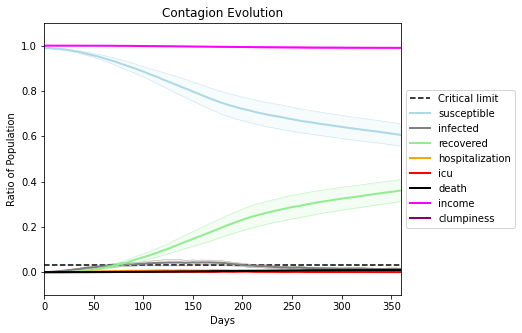

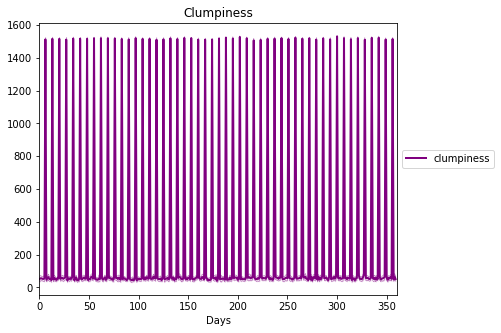

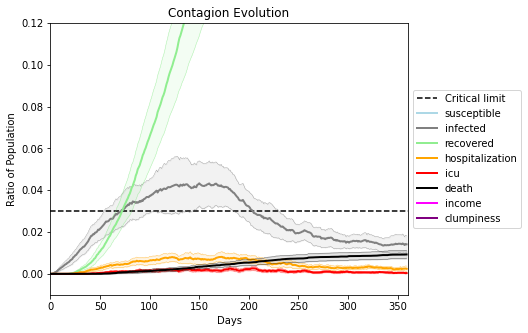

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7870, 271, 9575, 7865, 3676, 3342, 2240, 3891, 7517, 3721, 3269, 3092, 7210, 8341, 1749, 3048, 4998, 9429, 4665, 3096]
Average similarity between family members is 0.3442989076523392 at temperature -0.7
Average similarity between family and home is 0.9998482886533525 at temperature -1
Average similarity between students and their classroom is 0.1543536266180558 at temperature -0.7
Average classroom occupancy is 1.6455026455026456 and number classrooms is 189
Average similarity between workers is 0.16973391140375285 at temperature -0.7
Average office occupancy is 3.185929648241206 and number offices is 199
Average friend similarity for adults: 0.4187324986200402 for kids: 0.30101031910661663
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.17495892025204027
avg restaurant similarity 0.37287890435930454
avg restaurant similarity 0.3124867303667724
avg restaurant similarity 0.11917371365933524
avg restaurant similarity 0.35962107210776634
avg restaurant similarity 0.23038272870405535
avg restaurant similarity 0.17212677535677662
avg restaurant similarity -0.053965298448844234
avg restaurant similarity 0.3128961961171725
avg restaurant similarity 0.20723196954234954
avg restaurant similarity -0.024769335257519315
avg restaurant similarity 0.41918970670627725
avg restaurant similarity 0.468460407345487
avg restaurant similarity 0.4285344068196572
avg restaurant similarity 0.14425953064125782
avg restaurant similarity 0.1651735490236802
avg restaurant similarity 0.04113798209805475
avg restaurant similarity -0.2091980875095844
avg restaurant similarity -0.056290355400001615
avg restaurant similarity 0.23305122828596636
avg restaurant similarity 0.08381158284123326
avg restaurant similarity 0.393481

avg restaurant similarity 0.18074974134986496
avg restaurant similarity 0.37373684335479673
avg restaurant similarity 0.059072126003479386
Average similarity between family members is 0.3504650018568678 at temperature -0.7
Average similarity between family and home is 0.9998567536563442 at temperature -1
Average similarity between students and their classroom is 0.174873177255457 at temperature -0.7
Average classroom occupancy is 1.6666666666666667 and number classrooms is 174
Average similarity between workers is 0.18723616970350584 at temperature -0.7
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.43414661856516823 for kids: 0.2934189049742539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.3043909105304624
avg restaurant similarity 0.5752495806031646
avg restaurant similarity -0.07203351833938239
avg restaurant similarity 0.1079891722689629
avg restaurant similarity -0.28193960592698286
avg restaurant similarity 0.36162937205392753
avg restaurant similarity 0.3937145145503108
avg restaurant similarity 0.14898585971664904
avg restaurant similarity 0.5635513684151537
avg restaurant similarity -0.2712295296604108
avg restaurant similarity 0.06849321583673279
avg restaurant similarity 0.02362409190985909
avg restaurant similarity -0.014419716789603972
avg restaurant similarity 0.28561310391982964
avg restaurant similarity -0.08249576831422521
avg restaurant similarity 0.11412266161582969
avg restaurant similarity 0.2394741161648319
avg restaurant similarity 0.23343282272295934
avg restaurant similarity 0.07534477365090043
avg restaurant similarity 0.4268826925763461
avg restaurant similarity 0.22276809796615515
avg restaurant similarity 0.25917862

avg restaurant similarity -0.043932273760384964
avg restaurant similarity -0.24081348193950472
avg restaurant similarity -0.14832244585155915
avg restaurant similarity -0.39777242428389603
avg restaurant similarity 0.17852423548340168
avg restaurant similarity -0.03963421145220558
avg restaurant similarity -0.1080467501522064
avg restaurant similarity -0.3893659491399295
avg restaurant similarity -0.2767086708543034
avg restaurant similarity 0.039844415496243436
avg restaurant similarity -0.009845482389279861
avg restaurant similarity 0.05564842738179031
avg restaurant similarity 0.05944777348427276
avg restaurant similarity 0.18955503976853652
avg restaurant similarity -0.16142602387726535
avg restaurant similarity 0.12083973011405294
avg restaurant similarity -0.09394559704706278
avg restaurant similarity 0.22173337630464146
avg restaurant similarity 0.1663717176789482
avg restaurant similarity -0.014254262723548294
avg restaurant similarity 0.15958809034322421
avg restaurant similar

avg restaurant similarity 0.0726759635208489
avg restaurant similarity -0.431954229773346
avg restaurant similarity 0.03648266036906529
avg restaurant similarity -0.3893659491399295
avg restaurant similarity -0.2627305755698068
avg restaurant similarity 0.1365355469669587
avg restaurant similarity -0.17585800734461965
avg restaurant similarity 0.33868965188076794
avg restaurant similarity -0.17013743251990088
avg restaurant similarity -0.018706731803099313
avg restaurant similarity 0.10415162409084297
avg restaurant similarity 0.36868032524961075
avg restaurant similarity 0.073775107097767
avg restaurant similarity 0.17484098306941365
avg restaurant similarity 0.2194023693378639
avg restaurant similarity 0.20652175750429003
avg restaurant similarity -7.896803640125225e-06
avg restaurant similarity -0.18722820962923103
avg restaurant similarity -0.22241230817583207
avg restaurant similarity 0.10235979918202562
avg restaurant similarity -0.07317156901851689
avg restaurant similarity 0.58

avg restaurant similarity -0.04269579196125621
avg restaurant similarity 0.38807355015835854
avg restaurant similarity -0.1807544220530411
avg restaurant similarity 0.12320860705148678
avg restaurant similarity 0.21188799128686808
avg restaurant similarity 0.3482862978801189
avg restaurant similarity 0.03065090148901388
avg restaurant similarity 0.0937036360315025
avg restaurant similarity 0.050255149179391834
avg restaurant similarity 0.2893019461690255
avg restaurant similarity 0.02272927368297961
avg restaurant similarity 0.16286262270225815
avg restaurant similarity 0.0937036360315025
avg restaurant similarity 0.031671875770585174
avg restaurant similarity 0.017733300564761925
avg restaurant similarity 0.17980606065055657
avg restaurant similarity -0.02868430505469302
avg restaurant similarity 0.46896332107980665
avg restaurant similarity 0.15255638089224074
avg restaurant similarity 0.4207604163637779
avg restaurant similarity 0.5062586399525647
avg restaurant similarity 0.0491055

avg restaurant similarity -0.18754453914092575
avg restaurant similarity 0.04621429074151988
avg restaurant similarity -0.09771128534455834
avg restaurant similarity 0.17627875038445023
avg restaurant similarity -0.04834551539669514
avg restaurant similarity -0.021435237036700888
avg restaurant similarity 0.14101129695011333
avg restaurant similarity -0.3058102053325014
avg restaurant similarity 0.488240536458174
avg restaurant similarity 0.22345374798676526
avg restaurant similarity 0.18617610860312522
avg restaurant similarity 0.01247890029179366
avg restaurant similarity 0.11265840417569252
avg restaurant similarity 0.13535136077268622
avg restaurant similarity -0.1624841391030541
avg restaurant similarity 0.19019026576610848
avg restaurant similarity -0.1364479074484155
avg restaurant similarity 0.39754750812356243
avg restaurant similarity 0.3915987102006331
avg restaurant similarity 0.11309859377317034
avg restaurant similarity 0.645376484474466
avg restaurant similarity 0.090516

avg restaurant similarity 0.1312049361496484
avg restaurant similarity 0.4168552420806495
avg restaurant similarity -0.06423391147210897
avg restaurant similarity 0.11747048782820753
avg restaurant similarity 0.12035864895351212
avg restaurant similarity 0.3328689100026929
avg restaurant similarity 0.12035864895351212
avg restaurant similarity 0.28140516455254383
avg restaurant similarity 0.10208058963510729
avg restaurant similarity -0.11708610458666122
avg restaurant similarity -0.12411792678383278
avg restaurant similarity 0.24245440414653516
avg restaurant similarity 0.05187351560685104
avg restaurant similarity -0.39838391073683876
avg restaurant similarity 0.04115675469541952
avg restaurant similarity 0.2886719896358733
avg restaurant similarity 0.3880142078197745
avg restaurant similarity 0.05187351560685104
avg restaurant similarity -0.1802920520012022
avg restaurant similarity 0.2962433108065101
avg restaurant similarity -0.17547932420982473
avg restaurant similarity 0.1998130

avg restaurant similarity 0.2806896561835463
avg restaurant similarity 0.2003167360893778
avg restaurant similarity -0.40299262393661023
Average similarity between family members is 0.351135745962324 at temperature -0.7
Average similarity between family and home is 0.9998656039594687 at temperature -1
Average similarity between students and their classroom is 0.2071339160214698 at temperature -0.7
Average classroom occupancy is 1.6534090909090908 and number classrooms is 176
Average similarity between workers is 0.1808422094331105 at temperature -0.7
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.4269104536849607 for kids: 0.2889785994963643
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity -0.040285892997300156
avg restaurant similarity -0.20496553623655225
avg restaurant similarity 0.0028381819317958522
avg restaurant similarity -0.07342824507899157
avg restaurant similarity 0.19223670979573823
avg restaurant similarity -0.35690981233535557
avg restaurant similarity -0.19178570171090548
avg restaurant similarity 0.07112891553587207
avg restaurant similarity 0.18901791401016152
avg restaurant similarity 0.1211915853231399
avg restaurant similarity -0.15324396639590282
avg restaurant similarity 0.0039358723321895606
avg restaurant similarity 0.05469428065732955
avg restaurant similarity 0.03710845014617654
avg restaurant similarity -0.20391606443947208
avg restaurant similarity 0.018974828295314196
avg restaurant similarity 0.1016589692763092
avg restaurant similarity -0.006164312979642317
avg restaurant similarity 0.24586411945935727
avg restaurant similarity 0.00032049626876509
avg restaurant similarity 0.3492802702784394
avg restaurant similar

avg restaurant similarity 0.23771636370613217
avg restaurant similarity 0.049404139431894686
avg restaurant similarity -0.18516887917836905
avg restaurant similarity 0.006941997389341532
avg restaurant similarity -0.12088126290085896
avg restaurant similarity 0.0141016397011018
avg restaurant similarity 0.09517282884513642
avg restaurant similarity 0.18745333674932244
avg restaurant similarity 0.2786147549607276
avg restaurant similarity -0.20018542119011823
avg restaurant similarity -0.061068934711233036
avg restaurant similarity -0.18339833941118386
avg restaurant similarity 0.49989489031360634
avg restaurant similarity -0.05507615414271259
avg restaurant similarity -0.24691660456440478
avg restaurant similarity 0.0710796766330603
avg restaurant similarity 0.020264860480642452
avg restaurant similarity 0.04043027007916469
avg restaurant similarity 0.31082948439237035
avg restaurant similarity -0.06990854586016375
avg restaurant similarity -0.0745575014841639
avg restaurant similarity

avg restaurant similarity 0.014984822432849335
avg restaurant similarity 0.1453084141293985
avg restaurant similarity 0.1490278621902009
avg restaurant similarity -0.3792406090858815
avg restaurant similarity 5.582983800399288e-05
avg restaurant similarity 0.2490117684248735
avg restaurant similarity 0.15958884282233407
avg restaurant similarity -0.1534310549895975
avg restaurant similarity -0.17147148825452813
avg restaurant similarity 0.2811545109765724
avg restaurant similarity 0.005800948103444177
avg restaurant similarity -0.16587908430565773
avg restaurant similarity 0.6185849110748664
avg restaurant similarity 0.09836193538708682
avg restaurant similarity -0.08368181822803991
avg restaurant similarity 0.3186219641922481
avg restaurant similarity 0.09400958029621584
avg restaurant similarity 0.5078002333912022
avg restaurant similarity 0.4055606278052365
avg restaurant similarity 0.10201816936094177
avg restaurant similarity -0.3792406090858815
avg restaurant similarity 0.1577135

avg restaurant similarity 0.09663021988654025
avg restaurant similarity 0.3517168392557753
avg restaurant similarity 0.05635961630285641
avg restaurant similarity -0.2083218473507378
avg restaurant similarity 0.07782518645974168
avg restaurant similarity 0.050065780393243574
avg restaurant similarity 0.19649713400660074
avg restaurant similarity 0.2731449540132952
avg restaurant similarity -0.11680243351198388
avg restaurant similarity -0.11446948556446147
avg restaurant similarity -0.05196947136530654
avg restaurant similarity -0.11689833037998962
avg restaurant similarity -0.15802941685427807
avg restaurant similarity 0.32757919522771084
avg restaurant similarity 0.029362940661609972
avg restaurant similarity -0.05517601721391594
avg restaurant similarity 0.32385572635430776
avg restaurant similarity 0.16770530308308412
avg restaurant similarity 0.34176306920340915
avg restaurant similarity 0.3415856344390755
avg restaurant similarity 0.05457480239814402
avg restaurant similarity 0.0

avg restaurant similarity -0.01645155965033654
avg restaurant similarity 0.04251566141535932
avg restaurant similarity -0.30841213500961107
avg restaurant similarity -0.029023766223485292
avg restaurant similarity 0.2632524037957864
avg restaurant similarity 0.4943028923297721
avg restaurant similarity 0.08942530049441189
avg restaurant similarity 0.14387158795817484
avg restaurant similarity 0.23364854914472474
avg restaurant similarity -0.3371186897069777
avg restaurant similarity 0.1884131245219005
avg restaurant similarity 0.3938114291363116
avg restaurant similarity -0.1855665247508383
avg restaurant similarity 0.07591487567966115
avg restaurant similarity 0.32385572635430776
avg restaurant similarity 0.25700522450559243
avg restaurant similarity -0.05863365489083749
avg restaurant similarity 0.490162965067101
avg restaurant similarity 0.07910928207008802
avg restaurant similarity 0.07591487567966115
avg restaurant similarity 0.16758888712273706
avg restaurant similarity 0.1641474

avg restaurant similarity 0.10215637454717862
avg restaurant similarity 0.1097689327881068
avg restaurant similarity 0.1771084759414972
avg restaurant similarity 0.08315283821708074
avg restaurant similarity 0.41889460784778765
avg restaurant similarity -0.06899867689987964
avg restaurant similarity 0.42537388498415174
avg restaurant similarity 0.031178246947777988
avg restaurant similarity -0.0010035608597688678
avg restaurant similarity 0.2308481375950087
avg restaurant similarity -0.2180915820557341
avg restaurant similarity 0.24757202826076474
avg restaurant similarity -0.04872344696726136
avg restaurant similarity 0.12226680568681857
avg restaurant similarity 0.33304362307119106
avg restaurant similarity 0.036463406834277276
avg restaurant similarity 0.24757202826076474
avg restaurant similarity 0.4000683775221231
avg restaurant similarity 0.25566500287450666
avg restaurant similarity 0.037345043858548796
avg restaurant similarity 0.4187719788029265
avg restaurant similarity 0.161

avg restaurant similarity 0.2300327646573222
avg restaurant similarity 0.044739079894362106
avg restaurant similarity -0.07535208520031414
avg restaurant similarity 0.2805610946218503
avg restaurant similarity -0.18751514474143266
avg restaurant similarity 0.0544818862485409
avg restaurant similarity -0.03311006449016447
avg restaurant similarity -0.039402929403983544
avg restaurant similarity 0.024172182051582454
avg restaurant similarity 0.15356556110640857
avg restaurant similarity 0.20510515056492873
avg restaurant similarity 0.2256811932193694
avg restaurant similarity -0.1982431311639571
avg restaurant similarity 0.40027987372532725
avg restaurant similarity -0.08552571684220103
avg restaurant similarity 0.2536733403875021
avg restaurant similarity 0.05246717660925612
avg restaurant similarity 0.055478427505795465
avg restaurant similarity -0.18751514474143266
avg restaurant similarity -0.011893890045228908
avg restaurant similarity 0.2715022024978961
avg restaurant similarity -0

avg restaurant similarity -0.12897652844277632
avg restaurant similarity 0.13439844220443123
avg restaurant similarity 0.40548780219171676
avg restaurant similarity -0.018554104116841264
avg restaurant similarity -0.18685959639170058
avg restaurant similarity -0.351768285815692
avg restaurant similarity -0.10836283523808977
avg restaurant similarity 0.05758823705619655
avg restaurant similarity -0.0015249985994664275
avg restaurant similarity -0.10059956391776428
avg restaurant similarity 0.19697270080864568
avg restaurant similarity -0.04170381235146452
avg restaurant similarity 0.10185770005892852
avg restaurant similarity 0.16701047694111495
avg restaurant similarity 0.19868340273167745
avg restaurant similarity -0.2876756041228678
avg restaurant similarity -0.08561017556033029
avg restaurant similarity 0.008396895010533499
avg restaurant similarity -0.0072076127280943005
avg restaurant similarity 0.01805360937375035
avg restaurant similarity 0.18044097060268205
avg restaurant simil

avg restaurant similarity -0.11113428228642129
avg restaurant similarity -0.08901237114844518
avg restaurant similarity 0.01253713089892667
avg restaurant similarity -0.023409264464199706
avg restaurant similarity 0.018683442125269484
avg restaurant similarity -0.08877630779158047
avg restaurant similarity -0.007371083727110169
avg restaurant similarity 0.4346398496425566
avg restaurant similarity 0.23599372413436268
avg restaurant similarity 0.05969269633072245
avg restaurant similarity -0.17946162009517966
avg restaurant similarity 0.2951372967882752
avg restaurant similarity 0.2022707274833544
avg restaurant similarity 0.2126745431787257
avg restaurant similarity -0.26662454169447686
avg restaurant similarity 0.4341388612129205
avg restaurant similarity 0.0771071608956836
avg restaurant similarity -0.17376753256189478
avg restaurant similarity -0.06577734805852226
avg restaurant similarity -0.04085484813222458
avg restaurant similarity -0.0556103030163103
avg restaurant similarity -

avg restaurant similarity 0.5619979657192887
avg restaurant similarity 0.08391896203971565
avg restaurant similarity -0.3504167132722691
avg restaurant similarity 0.022571888721876016
avg restaurant similarity -0.16044041448402774
avg restaurant similarity -0.19586240219572923
avg restaurant similarity 0.1816525940277863
avg restaurant similarity -0.09512783079302764
avg restaurant similarity 0.08141020801367928
avg restaurant similarity 0.12140535395159645
avg restaurant similarity -0.023409264464199706
avg restaurant similarity 0.04967680988154121
avg restaurant similarity 0.030249138037000044
avg restaurant similarity 0.0023912874990182653
avg restaurant similarity 0.08887743116800645
avg restaurant similarity 0.009680443740397686
avg restaurant similarity 0.7300229509256608
avg restaurant similarity -0.07631476844866793
avg restaurant similarity -0.44197453093439043
avg restaurant similarity -0.06679056726111253
avg restaurant similarity -0.2216439723626455
avg restaurant similarit

avg restaurant similarity -0.28549049536857984
avg restaurant similarity -0.08378307769299387
avg restaurant similarity 0.08315879448988962
avg restaurant similarity 0.12191430731060246
avg restaurant similarity 0.1373676701729883
avg restaurant similarity 0.14603750790024494
avg restaurant similarity 0.028768800748149713
avg restaurant similarity -0.05502535957569746
avg restaurant similarity 0.25532362356343186
avg restaurant similarity -0.08032581617620856
avg restaurant similarity -0.002366354582798505
avg restaurant similarity 0.45000929571931125
avg restaurant similarity -0.16353072614305167
avg restaurant similarity 0.11911628332414559
avg restaurant similarity 0.02162844855897178
avg restaurant similarity -0.024122146969037528
avg restaurant similarity -0.2679118841795912
avg restaurant similarity -0.02475230748064358
avg restaurant similarity -0.2151796486561185
avg restaurant similarity 0.3478655812007932
avg restaurant similarity 0.3919754686484913
avg restaurant similarity 

Average similarity between workers is 0.15891433104261915 at temperature -0.7
Average office occupancy is 3.1519607843137254 and number offices is 204
Average friend similarity for adults: 0.4262727040249963 for kids: 0.2987956958092251
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity -0.01951808520466918
avg restaurant similarity 0.664549928079557
avg restaurant similarity 0.07856946474493914
avg restaurant similarity 0.06954520073914564
avg restaurant similarity -0.18343012394353492
avg restaurant similarity 0.12357752253234547
avg restaurant similarity 0.1883641526234066
avg restaurant similarity -0.4763619605105901
avg restaurant similarity 0.24824334593695177
avg restaurant similarity 0.26327422614925566
avg restaurant similarity 0.05340761216333978
avg restaurant similarity 0.09088945483120947
avg restaurant similarity -0.29925436604976813
avg restaurant similarity 0.14062993131557047
avg restaurant similarity 0.24010893914449616
avg restaurant similarity 0.3467971668901765
avg restaurant similarity 0.0715562313639252
avg restaurant similarity -0.05721894915675994
avg restaurant similarity 0.2636803070630094
avg restaurant similarity 0.35546702560853943
avg restaurant similarity 0.278499220573091
avg restaurant similarity 0.0715582838

avg restaurant similarity 0.16152934542696076
avg restaurant similarity -0.17046914200381394
avg restaurant similarity 0.1574645180491993
avg restaurant similarity -0.008375224703843895
avg restaurant similarity 0.3107118426127069
avg restaurant similarity 0.20609208225733866
avg restaurant similarity 0.44193592692939343
avg restaurant similarity -0.10002881309704115
avg restaurant similarity -0.08589601625627366
avg restaurant similarity 0.3962381290555279
avg restaurant similarity 0.0017653645278114388
avg restaurant similarity 0.0715562313639252
avg restaurant similarity -0.5086098786377103
avg restaurant similarity 0.005645984544988297
Average similarity between family members is 0.35550153358422254 at temperature -0.7
Average similarity between family and home is 0.9998462139226666 at temperature -1
Average similarity between students and their classroom is 0.18392374443447213 at temperature -0.7
Average classroom occupancy is 1.6342857142857143 and number classrooms is 175
Averag

avg restaurant similarity -0.08353766036010846
avg restaurant similarity 0.3923844003006861
avg restaurant similarity 0.04253085357430486
avg restaurant similarity 0.2796775380512479
avg restaurant similarity -0.16880787103313682
avg restaurant similarity 0.11440693873505055
avg restaurant similarity 0.3172564638024976
avg restaurant similarity -0.2713532098145946
avg restaurant similarity -0.20805481973202294
avg restaurant similarity -0.28689727258798225
avg restaurant similarity -0.33226014750722194
avg restaurant similarity 0.23756797690697687
avg restaurant similarity -0.20150179740101853
avg restaurant similarity 0.262819347378094
avg restaurant similarity -0.14438107692142338
avg restaurant similarity 0.21354992250344268
avg restaurant similarity -0.08924185756723792
avg restaurant similarity -0.03489306345733986
avg restaurant similarity -0.11674724561777805
avg restaurant similarity -0.01970689066093005
avg restaurant similarity -0.1685465021620005
avg restaurant similarity 0.

avg restaurant similarity 0.4990707734751221
avg restaurant similarity 0.5231005003813534
avg restaurant similarity 0.19426846349214988
avg restaurant similarity 0.20851416644340337
avg restaurant similarity 0.3893037390212827
avg restaurant similarity -0.20519302200749187
avg restaurant similarity 0.07689101063140795
avg restaurant similarity -0.31388130898163735
avg restaurant similarity 0.19185580808195407
avg restaurant similarity 0.06868027556109803
avg restaurant similarity 0.102660671042468
avg restaurant similarity 0.1312188296400973
avg restaurant similarity 0.09509571382304835
avg restaurant similarity -0.010891702039582445
avg restaurant similarity 0.3724706591855582
avg restaurant similarity -0.0587733945295298
avg restaurant similarity -0.16578343527584807
avg restaurant similarity 0.04188749837195861
avg restaurant similarity 0.05930998730890846
avg restaurant similarity 0.49181831162264456
avg restaurant similarity 0.11910281906148713
avg restaurant similarity -0.3298665

avg restaurant similarity 0.23382577107326544
avg restaurant similarity 0.10887019295563405
avg restaurant similarity 0.18902837794530153
avg restaurant similarity -0.12197301519196568
avg restaurant similarity -0.09992613683892963
avg restaurant similarity -0.0038173148455233445
avg restaurant similarity 0.03265926230255241
avg restaurant similarity -0.01580956040572375
avg restaurant similarity 0.08427613732866628
avg restaurant similarity 0.05989507530481078
avg restaurant similarity -0.11970892499077322
avg restaurant similarity 0.26515768745930296
avg restaurant similarity -0.20506167098539363
avg restaurant similarity -0.14246775732259864
avg restaurant similarity 0.08867381092402428
avg restaurant similarity 0.35618339416494915
avg restaurant similarity -0.14460103088343357
avg restaurant similarity 0.2358132219158378
avg restaurant similarity 0.17344144311758136
avg restaurant similarity -0.39931176758895703
avg restaurant similarity -0.17931827014868149
avg restaurant similari

avg restaurant similarity 0.24475876407270433
avg restaurant similarity 0.7966766604297035
avg restaurant similarity -0.24044683826767832
avg restaurant similarity -0.37673523134000364
avg restaurant similarity 0.07177016155417464
avg restaurant similarity 0.39147052615383404
avg restaurant similarity 0.29275506010951763
avg restaurant similarity -0.15698398544078473
avg restaurant similarity 0.061279671953364846
avg restaurant similarity -0.23728079294543364
avg restaurant similarity 0.4175906827562228
avg restaurant similarity 0.024890284274486696
avg restaurant similarity 0.044002214304435246
avg restaurant similarity 0.14796508489197616
avg restaurant similarity -0.13472321317990774
avg restaurant similarity 0.30666959045105324
avg restaurant similarity 0.1315331177429214
avg restaurant similarity 0.1120965103637694
avg restaurant similarity 0.2643105992675479
avg restaurant similarity 0.3213657622507332
avg restaurant similarity 0.06027006476854964
avg restaurant similarity 0.1030

avg restaurant similarity 0.1847668346284118
avg restaurant similarity -0.2590572700117032
avg restaurant similarity 0.010198503202663287
avg restaurant similarity 0.2834283279204982
avg restaurant similarity 0.26679709484953534
avg restaurant similarity 0.27747716752439483
avg restaurant similarity 0.007319626109278374
avg restaurant similarity 0.2522350414839538
avg restaurant similarity 0.2594029700529663
avg restaurant similarity -0.04637118922992911
avg restaurant similarity -0.04543415879905749
avg restaurant similarity -0.22194367781513957
avg restaurant similarity 0.10364611697707492
avg restaurant similarity -0.12048315329422066
avg restaurant similarity 0.03631094218652332
avg restaurant similarity 0.003787691442961369
avg restaurant similarity 0.1907266972028216
avg restaurant similarity 0.039998760798147556
avg restaurant similarity -0.3490329185869856
avg restaurant similarity -0.22306564624694175
avg restaurant similarity 0.1692575790287548
avg restaurant similarity 0.199

avg restaurant similarity 0.1166313710798556
avg restaurant similarity 0.3077855235221633
avg restaurant similarity -0.09343262040550482
avg restaurant similarity 0.23469951786924959
avg restaurant similarity -0.003558121406675198
avg restaurant similarity 0.17699430748892972
avg restaurant similarity 0.04934359222308462
avg restaurant similarity 0.21821824103906973
avg restaurant similarity -0.2868822830313356
avg restaurant similarity -0.024961240814040733
avg restaurant similarity -0.03167712282155466
avg restaurant similarity -0.067779839877927
avg restaurant similarity 0.07383104443358812
avg restaurant similarity -0.4644687316550406
avg restaurant similarity 0.3355934223735359
avg restaurant similarity -0.05396685134920749
avg restaurant similarity 0.13166432291019448
avg restaurant similarity -0.2853804787499931
avg restaurant similarity 0.30623354899962046
avg restaurant similarity -0.04723323809402155
avg restaurant similarity 0.0880429153330301
avg restaurant similarity 0.420

Average similarity between workers is 0.17108143855535235 at temperature -0.7
Average office occupancy is 3.1133004926108376 and number offices is 203
Average friend similarity for adults: 0.42100761458374664 for kids: 0.327124876847336
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity -0.0667766832702193
avg restaurant similarity 0.2193029939606479
avg restaurant similarity 0.09918012000974183
avg restaurant similarity 0.2183347629836066
avg restaurant similarity -0.0077517988936560075
avg restaurant similarity -0.005384555946047846
avg restaurant similarity 0.011182766485042489
avg restaurant similarity 0.3581736758698007
avg restaurant similarity 0.004351532531320895
avg restaurant similarity 0.0053066415184131605
avg restaurant similarity -0.041536305208509886
avg restaurant similarity 0.1533611156594704
avg restaurant similarity 0.10434072196174521
avg restaurant similarity 0.004351532531320895
avg restaurant similarity 0.15792375550108184
avg restaurant similarity 0.18877039250487107
avg restaurant similarity 0.09674204448668751
avg restaurant similarity 0.049728473119679664
avg restaurant similarity 0.004351532531320895
avg restaurant similarity -0.03851432210153233
avg restaurant similarity -0.02412468101461543
avg restaurant similar

avg restaurant similarity 0.08906871736662164
avg restaurant similarity -0.04331681160560966
avg restaurant similarity 0.45714577282146995
avg restaurant similarity 0.2580678958626235
avg restaurant similarity 0.0744724370851614
avg restaurant similarity 0.09086627960556562
avg restaurant similarity 0.5308007436468772
avg restaurant similarity -0.14429364381884388
Average similarity between family members is 0.3614401295089173 at temperature -0.7
Average similarity between family and home is 0.9998598838222901 at temperature -1
Average similarity between students and their classroom is 0.1733177568519763 at temperature -0.7
Average classroom occupancy is 1.5739644970414202 and number classrooms is 169
Average similarity between workers is 0.16960190772550277 at temperature -0.7
Average office occupancy is 3.3168316831683167 and number offices is 202
Average friend similarity for adults: 0.435281244973076 for kids: 0.28947922602137566
home_districts
[
Home (0,0) district with 1 Building

avg restaurant similarity 0.05229746688793332
avg restaurant similarity -0.17268796201666176
avg restaurant similarity -0.30431977300370006
avg restaurant similarity 0.54703810278067
avg restaurant similarity -0.31544180397535376
avg restaurant similarity -0.27083389372960953
avg restaurant similarity 0.20227579761411318
avg restaurant similarity 0.5165899381729959
avg restaurant similarity -0.02393985257530637
avg restaurant similarity 0.13381312207543802
avg restaurant similarity 0.40410379965069876
avg restaurant similarity 0.12477090307950592
avg restaurant similarity 0.26048293903591313
avg restaurant similarity 0.7084071122055228
avg restaurant similarity 0.5747415997376369
avg restaurant similarity 0.3569846464401057
avg restaurant similarity 0.1391236675442843
avg restaurant similarity -0.05098313743467073
avg restaurant similarity 0.008734687155332835
avg restaurant similarity 0.6309693956037998
avg restaurant similarity 0.28358504376752697
avg restaurant similarity -0.3798689

avg restaurant similarity -0.21885691514187008
avg restaurant similarity -0.027351148770545827
avg restaurant similarity 0.28762522478847147
avg restaurant similarity -0.10635598504086466
avg restaurant similarity -0.007773939048590639
avg restaurant similarity 0.2171373340212212
avg restaurant similarity 0.0006794632701782391
avg restaurant similarity 0.14363743349388247
avg restaurant similarity 0.008649254199973283
using average of time series:
stats on susceptible:
data: [0.9049722222222221, 0.8068861111111111, 0.8666555555555555, 0.8354805555555557, 0.8028804528804528, 0.7594611111111111, 0.8667138888888887, 0.7129306524869836, 0.8285416666666666, 0.8658361111111111, 0.7595016095016095, 0.8960906374501992, 0.7755444444444445, 0.8159666666666666, 0.7682972222222222, 0.7133583333333332, 0.8908611111111111, 0.8654539904539905, 0.8370944444444444, 0.8758861111111111]
min:
0.7129306524869836
max:
0.9049722222222221
std:
0.057210267864963436
mean:
0.8224206449164395
median:
0.8320111111

(<function dict.items>, <function dict.items>, <function dict.items>)

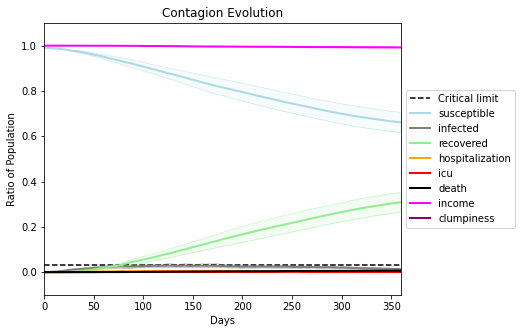

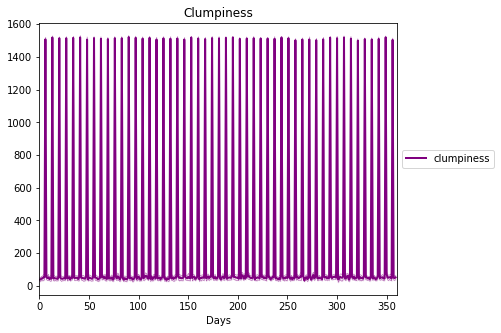

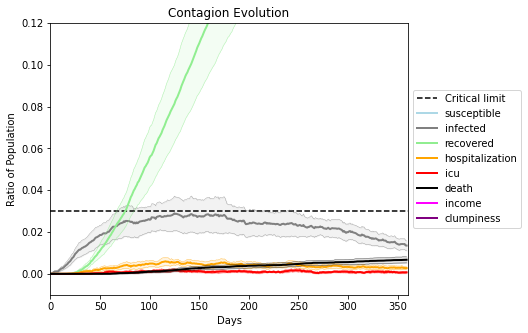

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[1120, 7112, 5507, 6998, 5743, 2925, 8816, 3128, 9549, 6923, 1991, 6791, 6008, 1091, 5961, 9254, 4124, 6431, 3623, 12]
Average similarity between family members is 0.31059625998665485 at temperature -0.6
Average similarity between family and home is 0.9998516673833454 at temperature -1
Average similarity between students and their classroom is 0.18427912417292067 at temperature -0.6
Average classroom occupancy is 1.641304347826087 and number classrooms is 184
Average similarity between workers is 0.1637849297323723 at temperature -0.6
Average office occupancy is 3.2525252525252526 and number offices is 198
Average friend similarity for adults: 0.370003703605629 for kids: 0.23479364113258394
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.03700862590233878
avg restaurant similarity -0.303710925251677
avg restaurant similarity -0.08342758840656418
avg restaurant similarity -0.13127933962441335
avg restaurant similarity -0.08635150025322534
avg restaurant similarity 0.523847673807176
avg restaurant similarity -0.10050064857662523
avg restaurant similarity 0.29933289977063504
avg restaurant similarity 0.2560892861438034
avg restaurant similarity -0.04797265715629491
avg restaurant similarity 0.18646254653839728
avg restaurant similarity 0.19472788437142954
avg restaurant similarity 0.10133796322612389
avg restaurant similarity 0.24217799523889816
avg restaurant similarity 0.3685845723834905
avg restaurant similarity 0.11042027708436372
avg restaurant similarity 0.6047496717314427
avg restaurant similarity -0.2232874370308723
avg restaurant similarity 0.19697582876582462
avg restaurant similarity -0.026629079423086757
avg restaurant similarity 0.4165302654339476
avg restaurant similarity 0.415401

avg restaurant similarity 0.14100234322168748
avg restaurant similarity 0.38366574113848795
avg restaurant similarity 0.07955382299133815
avg restaurant similarity -0.1595896119720599
avg restaurant similarity 0.15592219097318177
avg restaurant similarity 0.4852914376333229
avg restaurant similarity -0.5152486247524515
avg restaurant similarity 0.22944484055627082
avg restaurant similarity 0.15979644762296738
avg restaurant similarity 0.03693671985479846
avg restaurant similarity 0.15201929015288457
avg restaurant similarity 0.7040625934796583
avg restaurant similarity 0.027366306719330963
avg restaurant similarity 0.035816659726754935
avg restaurant similarity 0.30868465683565294
avg restaurant similarity 0.031308951261566687
avg restaurant similarity 0.035816659726754935
avg restaurant similarity -0.35408577393524393
avg restaurant similarity -0.014003995049560417
avg restaurant similarity 0.4815757711211784
avg restaurant similarity 0.5603222021467068
avg restaurant similarity 0.054

avg restaurant similarity 0.11425720088198935
avg restaurant similarity 0.6306695821880737
avg restaurant similarity 0.15707404195741478
avg restaurant similarity 0.11576998905617397
avg restaurant similarity 0.2015112841277316
avg restaurant similarity 0.3469838324051089
avg restaurant similarity -0.13736169757824965
avg restaurant similarity 0.2440719622782325
avg restaurant similarity 0.021228048213727577
avg restaurant similarity 0.14076312367860472
avg restaurant similarity -0.06358611781107348
avg restaurant similarity 0.21536269049291643
avg restaurant similarity 0.18452639769684653
avg restaurant similarity 0.20638957591227153
avg restaurant similarity 0.011758625819718524
avg restaurant similarity 0.11927064531658346
avg restaurant similarity 0.13848750857680456
Average similarity between family members is 0.2942125896179258 at temperature -0.6
Average similarity between family and home is 0.9998441330551574 at temperature -1
Average similarity between students and their class

avg restaurant similarity 0.30562361182959363
avg restaurant similarity 0.6041903635514069
avg restaurant similarity 0.017018516128227638
avg restaurant similarity 0.5712858058028405
avg restaurant similarity -0.04587498269072633
avg restaurant similarity 0.031122938329275457
avg restaurant similarity 0.25731657116423334
avg restaurant similarity 0.06221787217632396
avg restaurant similarity 0.03551067242014451
avg restaurant similarity 0.16610969433404266
avg restaurant similarity -0.1621903462186255
avg restaurant similarity -0.4981763970995212
avg restaurant similarity -0.11256807694832147
avg restaurant similarity -0.2099974232652457
avg restaurant similarity -0.171705265279045
avg restaurant similarity 0.033935175135684156
avg restaurant similarity 0.1116220116405713
avg restaurant similarity 0.24800232865741298
avg restaurant similarity -0.15434112881589432
avg restaurant similarity 0.3140741276960599
avg restaurant similarity 0.18991720090456138
avg restaurant similarity 0.00078

avg restaurant similarity 0.11762833107012323
avg restaurant similarity -0.05840278940086494
avg restaurant similarity 0.41890541247856916
avg restaurant similarity 0.2661239364599264
avg restaurant similarity -0.1757206920849858
avg restaurant similarity 0.06469425836441434
avg restaurant similarity -0.13676842281044474
avg restaurant similarity 0.06395985134091706
avg restaurant similarity -0.3074061825136165
avg restaurant similarity 0.2174262900498864
avg restaurant similarity -0.03337818808544661
avg restaurant similarity 0.045324529779350656
avg restaurant similarity -0.45544195705633816
avg restaurant similarity 0.2645187381090878
avg restaurant similarity 0.13067570425846423
avg restaurant similarity 0.10966031716739791
avg restaurant similarity -0.04365670920841093
avg restaurant similarity 0.4162056272947213
avg restaurant similarity 0.4358240920613608
avg restaurant similarity 0.43038885946011785
avg restaurant similarity 0.03540058214523755
avg restaurant similarity -0.0028

Average similarity between workers is 0.1486325167410588 at temperature -0.6
Average office occupancy is 3.3596059113300494 and number offices is 203
Average friend similarity for adults: 0.3781312279120984 for kids: 0.20380516810855615
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.24122450259733919
avg restaurant similarity 0.13763624000576016
avg restaurant similarity 0.21802475006915076
avg restaurant similarity -0.18288042332913726
avg restaurant similarity 0.0988165591832702
avg restaurant similarity 0.37832471364123593
avg restaurant similarity 0.23308413547486329
avg restaurant similarity 0.2725715811324044
avg restaurant similarity 0.07071911799524568
avg restaurant similarity 0.05350011371929655
avg restaurant similarity -0.03868119507513675
avg restaurant similarity -0.16781347397355828
avg restaurant similarity -0.13512450723810673
avg restaurant similarity -0.0070210687385998186
avg restaurant similarity 0.2877863034919198
avg restaurant similarity -0.11778458089426419
avg restaurant similarity 0.5260905732063976
avg restaurant similarity 0.4176712521060291
avg restaurant similarity 0.19911965208805926
avg restaurant similarity 0.2983488131500159
avg restaurant similarity -0.06596623183062228
avg restaurant similarity 0.228

avg restaurant similarity 0.17868695993149472
avg restaurant similarity 0.19860233981422404
avg restaurant similarity -0.07044793360553134
avg restaurant similarity 0.08066166482760238
avg restaurant similarity 0.21773787369715394
avg restaurant similarity -0.033301442070546784
avg restaurant similarity 0.15176774983245497
avg restaurant similarity -0.12608725467539858
avg restaurant similarity 0.25710117197296767
avg restaurant similarity -0.026208667191323757
avg restaurant similarity 0.0144355529672522
avg restaurant similarity 0.3551529216191392
avg restaurant similarity -0.11778458089426419
avg restaurant similarity -0.06596623183062228
avg restaurant similarity 0.224575937909205
avg restaurant similarity -0.06171384704315992
avg restaurant similarity 0.04562788816338718
avg restaurant similarity 0.2762516006228399
avg restaurant similarity 0.30300555732298157
avg restaurant similarity 0.14574252016480252
avg restaurant similarity 0.09513182722654367
avg restaurant similarity 0.02

avg restaurant similarity 0.12165628968029572
avg restaurant similarity 0.3084784324807362
avg restaurant similarity -0.03638836348706987
avg restaurant similarity 0.5011827267053505
avg restaurant similarity 0.5147071498634219
avg restaurant similarity 0.09774029498061146
avg restaurant similarity 0.14570690787100668
avg restaurant similarity 0.002956180666315051
avg restaurant similarity 0.06817850619792928
avg restaurant similarity 0.22528419677850361
avg restaurant similarity 0.20144353714989216
avg restaurant similarity 0.4994276472626387
avg restaurant similarity 0.38533052716039734
avg restaurant similarity 0.3842711095272019
avg restaurant similarity 0.21539283972959322
avg restaurant similarity 0.3414289103713056
avg restaurant similarity 0.09873093492418278
avg restaurant similarity 0.3804436540416782
avg restaurant similarity 0.27624590558667533
avg restaurant similarity -0.20236846704876305
avg restaurant similarity -0.1542081272219054
avg restaurant similarity 0.0529281401

avg restaurant similarity 0.7090318349534728
avg restaurant similarity -0.04827703787277764
avg restaurant similarity -0.14765226225996997
avg restaurant similarity -0.19817454700786347
avg restaurant similarity 0.14655172582149326
avg restaurant similarity 0.03231914947415923
avg restaurant similarity 0.03427775579476433
avg restaurant similarity -0.0070469513711943765
avg restaurant similarity 0.043379594266796745
avg restaurant similarity 0.09774029498061146
avg restaurant similarity -0.6023916835776646
avg restaurant similarity 0.03573443200602829
avg restaurant similarity 0.12631756896448176
avg restaurant similarity -0.15140765797647657
avg restaurant similarity 0.24806471789572487
avg restaurant similarity 0.5999653338741906
avg restaurant similarity 0.3732861518837196
avg restaurant similarity 0.025324286981566108
avg restaurant similarity 0.0014618132972298303
avg restaurant similarity -0.18111327974892621
avg restaurant similarity 0.41399708111858446
avg restaurant similarity

avg restaurant similarity 0.1721751969645542
avg restaurant similarity 0.058116013555279095
avg restaurant similarity 0.14183029447505213
avg restaurant similarity -0.11190322673865369
avg restaurant similarity 0.12166911184993597
avg restaurant similarity 0.046385147396950446
avg restaurant similarity 0.13522767389725557
avg restaurant similarity 0.31672678529482223
avg restaurant similarity 0.477334644453526
avg restaurant similarity -0.09242783674297728
avg restaurant similarity 0.23793798830852678
avg restaurant similarity -0.3236641916238243
avg restaurant similarity 0.17368465993127835
avg restaurant similarity 0.22363770626004084
avg restaurant similarity -0.23158165430019984
avg restaurant similarity 0.12166911184993597
avg restaurant similarity 0.17334513350161462
avg restaurant similarity 0.2745131895880002
avg restaurant similarity 0.2225328643495537
avg restaurant similarity -0.2104835638418848
avg restaurant similarity 0.028600110597844158
avg restaurant similarity 0.18224

avg restaurant similarity 0.47236786606287307
avg restaurant similarity -0.22169259324933493
Average similarity between family members is 0.2736379016139047 at temperature -0.6
Average similarity between family and home is 0.9998601637183662 at temperature -1
Average similarity between students and their classroom is 0.15706050668578764 at temperature -0.6
Average classroom occupancy is 1.6228571428571428 and number classrooms is 175
Average similarity between workers is 0.15543862850162332 at temperature -0.6
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.378201245549356 for kids: 0.21747641615245789
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.010439681825826393
avg restaurant similarity -0.013728585745030256
avg restaurant similarity 0.09728354092360807
avg restaurant similarity -0.4364512290827095
avg restaurant similarity -0.05332421194769721
avg restaurant similarity -0.04549900083745791
avg restaurant similarity -0.19779387682082972
avg restaurant similarity -0.18290077660167295
avg restaurant similarity 0.17177734399498693
avg restaurant similarity -0.2923110217660675
avg restaurant similarity -0.035842666367351665
avg restaurant similarity 0.1310979042257971
avg restaurant similarity 0.09615759171341441
avg restaurant similarity 0.11913840704683765
avg restaurant similarity -0.2553274990334472
avg restaurant similarity -0.033641392811469856
avg restaurant similarity 0.2706582688303599
avg restaurant similarity -0.2979402552726485
avg restaurant similarity -0.15711020240426093
avg restaurant similarity 0.28376652783497797
avg restaurant similarity -0.09247043007573821
avg restaurant similari

avg restaurant similarity 0.4006066672685447
Average similarity between family members is 0.28962925699141334 at temperature -0.6
Average similarity between family and home is 0.9998475473627244 at temperature -1
Average similarity between students and their classroom is 0.14887685672905376 at temperature -0.6
Average classroom occupancy is 1.7719298245614035 and number classrooms is 171
Average similarity between workers is 0.1613729813525509 at temperature -0.6
Average office occupancy is 3.2806122448979593 and number offices is 196
Average friend similarity for adults: 0.37214057622758057 for kids: 0.22996454343828118
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 

avg restaurant similarity 0.16104127704754972
avg restaurant similarity 0.08785927071596167
avg restaurant similarity -0.1686753523590059
avg restaurant similarity -0.004703125063267644
avg restaurant similarity 0.056079004121535526
avg restaurant similarity -0.1013222142411718
avg restaurant similarity 0.3647525263761969
avg restaurant similarity 0.36112628172470573
avg restaurant similarity 0.26556681659947257
avg restaurant similarity 0.19280239238003194
avg restaurant similarity -0.01417200780901505
avg restaurant similarity 0.13257864267733824
avg restaurant similarity 0.2848398145699521
avg restaurant similarity 0.2082730064461631
avg restaurant similarity -0.02366026113193126
avg restaurant similarity 0.03778776069018732
avg restaurant similarity -0.15426063387621408
avg restaurant similarity -0.11890525431925253
avg restaurant similarity 0.007019087002214458
avg restaurant similarity -0.2351571545244256
avg restaurant similarity -0.05532069817383647
avg restaurant similarity 0.

avg restaurant similarity -0.03225080443670232
avg restaurant similarity -0.25523673531817104
avg restaurant similarity 0.2449809585612514
avg restaurant similarity -0.12816633983531467
avg restaurant similarity 0.08439133801505216
avg restaurant similarity 0.29858660424588945
avg restaurant similarity -0.3260206956522274
avg restaurant similarity 0.3809465046081876
avg restaurant similarity 0.7995655330275377
avg restaurant similarity 0.14282521079280766
avg restaurant similarity 0.32766560377957377
avg restaurant similarity 0.3570071840513545
avg restaurant similarity -0.13635975127271321
avg restaurant similarity 0.14082846267002164
avg restaurant similarity -0.11282184844163463
avg restaurant similarity 0.8069141447077838
avg restaurant similarity 0.073603932849501
avg restaurant similarity 0.2892791198310884
avg restaurant similarity -0.29511452707273483
avg restaurant similarity 0.32356096772593484
avg restaurant similarity -0.023181214697563086
avg restaurant similarity -0.00981

avg restaurant similarity 0.10186676794175706
avg restaurant similarity 0.5876767638698922
avg restaurant similarity 0.18427891783238862
avg restaurant similarity -0.26165783399003556
avg restaurant similarity 0.002915818777814057
avg restaurant similarity 0.0462559799182338
avg restaurant similarity -0.06326824298655281
avg restaurant similarity 0.031206935340076833
avg restaurant similarity 0.031206935340076833
avg restaurant similarity 0.30269075534754236
avg restaurant similarity 0.6852716129856622
avg restaurant similarity 0.005311766792560379
avg restaurant similarity 0.11736017745010784
avg restaurant similarity -0.050181163624252484
avg restaurant similarity 0.1252935607626847
avg restaurant similarity 0.1718836362533335
avg restaurant similarity -0.0923538743612601
avg restaurant similarity 0.06700556510024179
avg restaurant similarity -0.07802916429989573
avg restaurant similarity 0.08702536905779608
avg restaurant similarity 0.031206935340076833
avg restaurant similarity 0.0

avg restaurant similarity 0.2533573282932908
avg restaurant similarity 0.11467414334399292
avg restaurant similarity -0.044272963805576084
avg restaurant similarity 0.5245512919658822
avg restaurant similarity 0.031206935340076833
avg restaurant similarity 0.18427891783238862
avg restaurant similarity 0.22184680207172308
avg restaurant similarity -0.057221804591587266
avg restaurant similarity 0.12102810263233334
avg restaurant similarity 0.05732040789031617
avg restaurant similarity -0.024184424617429208
avg restaurant similarity -0.10466129800485961
avg restaurant similarity 0.2566841718602771
avg restaurant similarity -0.3916730018511368
avg restaurant similarity -0.2644066846032932
avg restaurant similarity -0.12084723322229415
avg restaurant similarity 0.07521755621666315
avg restaurant similarity 0.21242431246714238
avg restaurant similarity -0.15898781303742157
avg restaurant similarity 0.37338674762258317
avg restaurant similarity -0.2644066846032932
avg restaurant similarity 0

avg restaurant similarity -0.05919514819444014
avg restaurant similarity -0.012195102132884716
avg restaurant similarity 0.10163445046880314
avg restaurant similarity 0.014321923433871807
avg restaurant similarity 0.057036277662142254
avg restaurant similarity 0.00470131658531134
avg restaurant similarity -0.26051133935862614
avg restaurant similarity -0.22965993074960303
avg restaurant similarity -0.5524292133545574
avg restaurant similarity -0.02408800756230105
avg restaurant similarity 0.05150648902901466
avg restaurant similarity 0.12022674579860161
avg restaurant similarity 0.12657747255485388
avg restaurant similarity -0.05614056994341139
avg restaurant similarity 0.008764171278935251
avg restaurant similarity 0.08773464847864877
avg restaurant similarity 0.0033563076276622306
avg restaurant similarity 0.5007238405020576
avg restaurant similarity -0.020267782856169914
avg restaurant similarity 0.5609579060603522
avg restaurant similarity -0.009773638901769513
avg restaurant simil

avg restaurant similarity -0.036208974493092974
avg restaurant similarity 0.12867754831733663
avg restaurant similarity 0.47931218471429393
avg restaurant similarity -0.00545451227547096
avg restaurant similarity 0.1495670217517805
avg restaurant similarity 0.33071645297411023
avg restaurant similarity 0.018097426198287192
avg restaurant similarity 0.2749294372769284
avg restaurant similarity 0.2687577225688402
avg restaurant similarity -0.0024637745388844945
avg restaurant similarity -0.1124091118797079
avg restaurant similarity -0.2435258479984639
avg restaurant similarity -0.49882293034730013
avg restaurant similarity -0.19387171865199465
avg restaurant similarity 0.34492180597449207
avg restaurant similarity 0.41589707305113144
avg restaurant similarity -0.29604215581263965
avg restaurant similarity -0.00824175333504451
avg restaurant similarity 0.08730883759198642
avg restaurant similarity 0.4224467888339902
avg restaurant similarity 0.1217395707948458
avg restaurant similarity 0.

avg restaurant similarity -0.07301243655839913
avg restaurant similarity 0.008044149989812427
avg restaurant similarity 0.2517354100211707
avg restaurant similarity 0.3184009875136603
avg restaurant similarity -0.1475943328090493
avg restaurant similarity -0.12476763496733263
avg restaurant similarity 0.1075055621215824
avg restaurant similarity 0.183806038274219
avg restaurant similarity 0.24681833811351278
avg restaurant similarity 0.293574814857221
avg restaurant similarity 0.2580819036991079
avg restaurant similarity -0.2546570090271274
avg restaurant similarity 0.09139550870108626
avg restaurant similarity 0.04099556134013967
avg restaurant similarity -0.1363665385625893
avg restaurant similarity -0.19131073211450977
avg restaurant similarity 0.39523554426254587
avg restaurant similarity -0.0880712821803356
avg restaurant similarity 0.2948049953020442
avg restaurant similarity -0.1361130306354223
avg restaurant similarity -0.23368335934648207
avg restaurant similarity 0.2275959208

avg restaurant similarity 0.042139989366491076
avg restaurant similarity -0.2890425635607379
avg restaurant similarity 0.2223595569657727
avg restaurant similarity 0.23688372049332937
avg restaurant similarity 0.5121271741774039
avg restaurant similarity -0.26171996253551194
avg restaurant similarity 0.43556112898143656
avg restaurant similarity 0.5106354071985771
avg restaurant similarity 0.160146325577056
avg restaurant similarity 0.4623946076695726
avg restaurant similarity 0.2768563039382461
avg restaurant similarity 0.4253126075697845
avg restaurant similarity -0.010530776382399305
avg restaurant similarity 0.41436448243352975
avg restaurant similarity -0.2118186464589898
avg restaurant similarity 0.2038110623147804
avg restaurant similarity 0.25062617186598524
avg restaurant similarity 0.1002941021527199
avg restaurant similarity -0.35478273035893265
avg restaurant similarity 0.17265417646061834
avg restaurant similarity 0.30479694381623057
avg restaurant similarity -0.0836247288

avg restaurant similarity -0.013393319583694538
avg restaurant similarity 0.047761602747714176
avg restaurant similarity 0.24058820078718976
avg restaurant similarity 0.3218311060935551
avg restaurant similarity 0.2778093701279245
avg restaurant similarity -0.16649471158841025
avg restaurant similarity 0.4431492030138616
avg restaurant similarity 0.014629038381632792
avg restaurant similarity -0.12612456119121554
avg restaurant similarity 0.201987249352926
avg restaurant similarity 0.06566086601657611
avg restaurant similarity 0.05997284140072992
avg restaurant similarity -0.01300143918332139
avg restaurant similarity 0.12507002930625585
avg restaurant similarity 0.39089763411064615
avg restaurant similarity 0.3698871087792148
avg restaurant similarity -0.08913068164091918
avg restaurant similarity -0.1887931112867905
avg restaurant similarity -0.13626605928352228
avg restaurant similarity 0.1749446513363016
avg restaurant similarity -0.22984541912584433
avg restaurant similarity 0.388

avg restaurant similarity -0.020819475912302553
avg restaurant similarity 0.4128701361812271
avg restaurant similarity 0.3018971964377796
avg restaurant similarity 0.28118077692074567
avg restaurant similarity 0.28118077692074567
avg restaurant similarity -0.0727082150427641
avg restaurant similarity -0.004100341561059054
avg restaurant similarity 0.17160657437936983
avg restaurant similarity 0.38998303580381527
avg restaurant similarity 0.10054624668281689
avg restaurant similarity 0.4128701361812271
avg restaurant similarity 0.3218311060935551
avg restaurant similarity -0.3024284696535581
avg restaurant similarity 0.42876082089705364
avg restaurant similarity 0.06566086601657611
Average similarity between family members is 0.2912298082449073 at temperature -0.6
Average similarity between family and home is 0.9998668896009457 at temperature -1
Average similarity between students and their classroom is 0.196949539536987 at temperature -0.6
Average classroom occupancy is 1.5178571428571

avg restaurant similarity 0.16387784419244222
avg restaurant similarity -0.012813201887120068
avg restaurant similarity 0.14572568976725103
avg restaurant similarity 0.17078790450543302
avg restaurant similarity -0.10827928357746139
avg restaurant similarity 0.2712830246416835
avg restaurant similarity -0.20661700098101143
avg restaurant similarity -0.05702177315495281
avg restaurant similarity 0.07388872276628096
avg restaurant similarity 0.026047062972865295
avg restaurant similarity -0.10445795360696031
avg restaurant similarity -0.02000223123893337
avg restaurant similarity 0.21627784218891172
avg restaurant similarity 0.23267419643746867
avg restaurant similarity 0.2158718173264889
avg restaurant similarity -0.20589992062030987
avg restaurant similarity 0.06536664423255407
avg restaurant similarity 0.3582746600145418
avg restaurant similarity 0.14186680868823373
avg restaurant similarity 0.08651488227316285
avg restaurant similarity 0.3082614972814983
avg restaurant similarity 0.0

avg restaurant similarity -0.15205956030667678
avg restaurant similarity 0.23687899381826924
avg restaurant similarity -0.2018051278334461
avg restaurant similarity 0.02125544390899628
avg restaurant similarity -0.17144005679554813
avg restaurant similarity 0.2944602349963516
avg restaurant similarity 0.09652579632108475
avg restaurant similarity -0.44776081920698996
avg restaurant similarity 0.18279175073594361
avg restaurant similarity 0.05526336824555557
avg restaurant similarity 0.285275852324841
avg restaurant similarity -0.4824946962438308
avg restaurant similarity 0.4892150803629418
avg restaurant similarity -0.01637556977033753
avg restaurant similarity -0.01637556977033753
avg restaurant similarity 0.12667833434960032
avg restaurant similarity -0.032006710523780964
avg restaurant similarity -0.03199188346677176
avg restaurant similarity 0.2390307491344991
avg restaurant similarity 0.17885521221560066
avg restaurant similarity -0.07091518349446341
avg restaurant similarity 0.00

avg restaurant similarity 0.23759242028488858
avg restaurant similarity 0.27808120745318265
avg restaurant similarity 0.3421675364456559
avg restaurant similarity -0.12428418687342695
avg restaurant similarity -0.06584674314766804
avg restaurant similarity 0.10938231992188541
avg restaurant similarity 0.1177255404977258
avg restaurant similarity -0.0202602733832975
avg restaurant similarity 0.036949066903434545
avg restaurant similarity 0.3421675364456559
avg restaurant similarity 0.4570602628249999
avg restaurant similarity 0.15373211495800404
avg restaurant similarity -0.042054803584246625
avg restaurant similarity 0.4759168665407129
avg restaurant similarity -0.08287072864252006
avg restaurant similarity 0.10938231992188541
avg restaurant similarity 0.09025083098103835
avg restaurant similarity -0.08024353311277127
avg restaurant similarity 0.3954145057151488
avg restaurant similarity 0.10938231992188541
avg restaurant similarity 0.15249055635226347
avg restaurant similarity -0.1302

avg restaurant similarity 0.25008345644032204
avg restaurant similarity 0.07046393384299514
avg restaurant similarity 0.22782338777656616
avg restaurant similarity 0.36800839761319387
avg restaurant similarity 0.3246849079343909
avg restaurant similarity -0.013727421870556762
avg restaurant similarity -0.0774405372314516
avg restaurant similarity -0.03987550637202585
avg restaurant similarity -0.10811904313157428
avg restaurant similarity -0.08533427836656704
avg restaurant similarity 0.07421949646350526
avg restaurant similarity 0.20155823897722477
avg restaurant similarity 0.09545282497146186
avg restaurant similarity -0.2469703062496579
avg restaurant similarity 0.739969740261407
avg restaurant similarity 0.15832610544337086
avg restaurant similarity 0.36297063868355406
avg restaurant similarity -0.05186402906022851
avg restaurant similarity 0.20809547637201442
avg restaurant similarity 0.05650078203729432
avg restaurant similarity 0.08633150929256841
avg restaurant similarity -0.04

avg restaurant similarity 0.5897827039397481
avg restaurant similarity -0.03897909227679156
avg restaurant similarity -0.17900941416363148
avg restaurant similarity -0.31819851877186905
avg restaurant similarity -0.1207241154713409
avg restaurant similarity 0.1458019055249758
avg restaurant similarity 0.5310679539313462
avg restaurant similarity 0.5310679539313462
avg restaurant similarity 0.011244106801936356
avg restaurant similarity -0.20428034073375181
avg restaurant similarity 0.5277984228534042
avg restaurant similarity -0.40817040450300746
avg restaurant similarity -0.0701731455219475
avg restaurant similarity -0.2600357547105491
avg restaurant similarity 0.5175549989921515
avg restaurant similarity 0.0928766319501927
avg restaurant similarity 0.14318921891602723
avg restaurant similarity 0.24668910279471884
avg restaurant similarity 0.4936344629931293
avg restaurant similarity 0.22322551883413785
avg restaurant similarity 0.1743313202872728
avg restaurant similarity -0.12072411

avg restaurant similarity 0.21896987446558913
avg restaurant similarity 0.2801849257831457
avg restaurant similarity -0.1133816052036577
avg restaurant similarity 0.6296844048521195
avg restaurant similarity -0.024118245995185986
avg restaurant similarity 0.3539316779347164
avg restaurant similarity -0.2730124244177293
avg restaurant similarity -0.15814719514440387
avg restaurant similarity 0.3826963971795187
avg restaurant similarity -0.12729420452697227
avg restaurant similarity -0.0513473133961092
avg restaurant similarity 0.0754610768700809
avg restaurant similarity 0.06822591684717318
avg restaurant similarity 0.09206593451614101
avg restaurant similarity -0.011796838550386227
avg restaurant similarity 0.4516713155494485
avg restaurant similarity 0.2590568283143699
avg restaurant similarity 0.1348007989262705
avg restaurant similarity 0.08516571110888245
avg restaurant similarity 0.1548625294477998
avg restaurant similarity -0.33982068957926354
avg restaurant similarity 0.00356920

avg restaurant similarity -0.004121458455920643
avg restaurant similarity 0.36807982749063195
avg restaurant similarity 0.11867607961037134
avg restaurant similarity -0.024118245995185986
avg restaurant similarity 0.043341147859694035
avg restaurant similarity -0.09700201245367676
avg restaurant similarity 0.23249647188992362
avg restaurant similarity 0.5544591444452854
avg restaurant similarity -0.08573419311230338
avg restaurant similarity -0.32872833928379797
avg restaurant similarity 0.03365442916888384
using average of time series:
stats on susceptible:
data: [0.8699444444444444, 0.6573138888888889, 0.7375638888888889, 0.7723608338877799, 0.8723722222222221, 0.8466527777777777, 0.7000525675077468, 0.6494694444444444, 0.7912698412698412, 0.8401722222222222, 0.9065861111111112, 0.7893384393384395, 0.7628833333333332, 0.7477777777777779, 0.8763888888888889, 0.8093805555555554, 0.8076666666666666, 0.7069305555555556, 0.7829527777777778, 0.8625472222222222]
min:
0.6494694444444444
max:

(<function dict.items>, <function dict.items>, <function dict.items>)

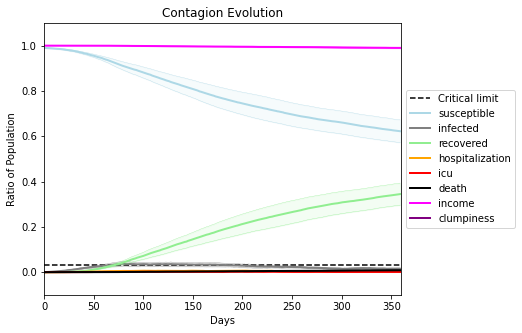

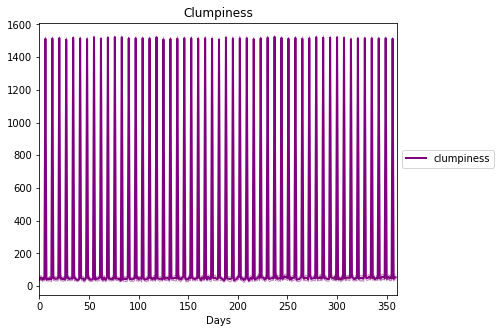

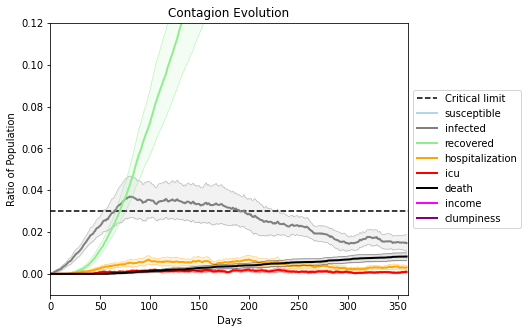

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1250, 3096, 8136, 860, 7370, 9996, 5532, 8940, 6138, 4923, 4101, 9582, 3634, 5069, 2691, 4347, 558, 7800, 9475, 7043]
Average similarity between family members is 0.24745031976520646 at temperature -0.5
Average similarity between family and home is 0.9998550111980395 at temperature -1
Average similarity between students and their classroom is 0.17454639132539018 at temperature -0.5
Average classroom occupancy is 1.621301775147929 and number classrooms is 169
Average similarity between workers is 0.14954302434825514 at temperature -0.5
Average office occupancy is 3.3054187192118225 and number offices is 203
Average friend similarity for adults: 0.32985720050044276 for kids: 0.21054496473342846
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.32738812940556705
avg restaurant similarity 0.44312714460330527
avg restaurant similarity 0.44312714460330527
avg restaurant similarity -0.28218686873472754
avg restaurant similarity -0.0677795212523126
avg restaurant similarity -0.035769599729412266
avg restaurant similarity 0.23693528811060374
avg restaurant similarity -0.28486443441887377
avg restaurant similarity 0.28416419653204195
avg restaurant similarity 0.3407339897814148
avg restaurant similarity 0.20257112963736962
avg restaurant similarity 0.43935033651701283
avg restaurant similarity -0.3505882308200904
avg restaurant similarity -0.16006319763601018
avg restaurant similarity 0.2219760947855458
avg restaurant similarity -0.2876441975603285
avg restaurant similarity 0.129262699594961
avg restaurant similarity 0.01575980645747823
avg restaurant similarity 0.46102965994132217
avg restaurant similarity -0.18789943986107094
avg restaurant similarity 0.010194847463246323
avg restaurant similarity -0.07

avg restaurant similarity 0.22256986429000047
avg restaurant similarity -0.13615089730882396
avg restaurant similarity -0.07086011829894165
avg restaurant similarity 0.4983518772114718
avg restaurant similarity 0.0025361111203893033
avg restaurant similarity -0.24611384275712234
avg restaurant similarity -0.1366390762602766
Average similarity between family members is 0.25008976224081153 at temperature -0.5
Average similarity between family and home is 0.9998599673393271 at temperature -1
Average similarity between students and their classroom is 0.16235880249120155 at temperature -0.5
Average classroom occupancy is 1.4777777777777779 and number classrooms is 180
Average similarity between workers is 0.1406942582434133 at temperature -0.5
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.33666931431631963 for kids: 0.21858418971207258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity 

avg restaurant similarity 0.04761915901654996
avg restaurant similarity -0.331862739317771
avg restaurant similarity -0.015654416716191416
avg restaurant similarity 0.18638675361461196
avg restaurant similarity 0.08960137722505236
avg restaurant similarity 0.07735385825783427
avg restaurant similarity -0.013998067933505276
avg restaurant similarity -0.23336195805101823
avg restaurant similarity 0.04550410897762951
avg restaurant similarity 0.1993045940060234
avg restaurant similarity 0.08210683013990608
avg restaurant similarity -0.11074687778986347
avg restaurant similarity 0.443224387784291
avg restaurant similarity 0.443224387784291
avg restaurant similarity 0.5376069258762408
avg restaurant similarity 0.22860855124868354
avg restaurant similarity 0.18602911903491257
avg restaurant similarity -0.3818511901125641
avg restaurant similarity 0.6064508363731227
avg restaurant similarity 0.11020314325391779
avg restaurant similarity 0.4609770873062029
avg restaurant similarity -0.19012577

avg restaurant similarity 0.5104401016819654
avg restaurant similarity 0.10552048985458239
avg restaurant similarity 0.03272019995626546
avg restaurant similarity 0.3345833878344547
avg restaurant similarity 0.025104431577063338
avg restaurant similarity -0.11745378661425669
avg restaurant similarity -0.10619268890873207
avg restaurant similarity 0.3345833878344547
avg restaurant similarity -0.25210456258130276
avg restaurant similarity -0.289642539619843
avg restaurant similarity 0.5104401016819654
avg restaurant similarity 0.10552048985458239
avg restaurant similarity 0.10552048985458239
avg restaurant similarity -0.08268405425522733
avg restaurant similarity 0.18436807408084718
avg restaurant similarity 0.09592667767269959
avg restaurant similarity 0.10552048985458239
avg restaurant similarity 0.08349432927230765
Average similarity between family members is 0.2337101920442976 at temperature -0.5
Average similarity between family and home is 0.9998552469366552 at temperature -1
Avera

avg restaurant similarity 0.11587941938708157
avg restaurant similarity 0.018362094063372053
avg restaurant similarity 0.06450498070460456
avg restaurant similarity -0.14560815480223713
avg restaurant similarity -0.36476333953755585
avg restaurant similarity 0.15996630532297357
avg restaurant similarity 0.13122795465414575
avg restaurant similarity -0.08933455985257935
avg restaurant similarity 0.2925882459097021
avg restaurant similarity 0.31134771970353803
avg restaurant similarity -0.10007641795160922
avg restaurant similarity -0.15048576384635956
avg restaurant similarity 0.2969187144676741
avg restaurant similarity 0.18399667734073266
avg restaurant similarity -0.2783931174528686
avg restaurant similarity -0.03754359529843213
avg restaurant similarity 0.3093097525163244
avg restaurant similarity -0.029086216655173733
avg restaurant similarity 0.16935362622570238
avg restaurant similarity -0.3008151121594679
avg restaurant similarity -0.10127246302824336
avg restaurant similarity 0

avg restaurant similarity 0.2723880300083947
avg restaurant similarity 0.13636678325006352
avg restaurant similarity 0.45597916324407484
avg restaurant similarity 0.3740346503495794
avg restaurant similarity 0.059153747015460965
avg restaurant similarity -0.1365766745528162
avg restaurant similarity 0.2853888356102657
avg restaurant similarity 0.23046709357607154
avg restaurant similarity 0.23634338206111805
avg restaurant similarity -0.28964036777684843
avg restaurant similarity -0.3008151121594679
avg restaurant similarity 0.30923016129614167
avg restaurant similarity 0.27973723662349537
avg restaurant similarity 0.2723880300083947
avg restaurant similarity 0.41200303695548735
avg restaurant similarity -0.2635270233299762
avg restaurant similarity 0.009790012419179997
avg restaurant similarity 0.24045013466937937
avg restaurant similarity 0.08274282733526923
avg restaurant similarity 0.022737537138114695
avg restaurant similarity 0.42174582686720097
avg restaurant similarity 0.327949

avg restaurant similarity 0.04321801941323809
avg restaurant similarity 0.09961684745770544
avg restaurant similarity -0.4034508682560794
avg restaurant similarity -0.061124645485613874
avg restaurant similarity -0.25532818643914024
avg restaurant similarity -0.11362871447027248
avg restaurant similarity -0.030579352057641444
avg restaurant similarity 0.06179176104903665
avg restaurant similarity 0.047520095863427675
avg restaurant similarity -0.016151501545512956
avg restaurant similarity -0.19845021480269587
avg restaurant similarity 0.1400403428080376
avg restaurant similarity -0.009756135830237447
avg restaurant similarity 0.11457251327191532
avg restaurant similarity 0.7835819884061286
avg restaurant similarity 0.3100962652308633
avg restaurant similarity 0.4704408862804796
avg restaurant similarity -0.16362397251808233
avg restaurant similarity 0.2250334633598523
avg restaurant similarity 0.02177720798390169
avg restaurant similarity 0.24292850791976248
avg restaurant similarity 

avg restaurant similarity 0.3184550701412125
avg restaurant similarity -0.083466166485187
avg restaurant similarity -0.10560089824115008
avg restaurant similarity 0.26587359655207693
avg restaurant similarity -0.03407584863436485
avg restaurant similarity 0.05843692489217872
avg restaurant similarity 0.020191689020719383
avg restaurant similarity 0.2625421762218984
avg restaurant similarity -0.08011511703908158
avg restaurant similarity 0.20569595064478
avg restaurant similarity 0.2137924921309099
avg restaurant similarity -0.13039169067889178
avg restaurant similarity 0.16393202048489114
avg restaurant similarity 0.09353978020696806
avg restaurant similarity 0.07581243796530573
avg restaurant similarity 0.05954738596575532
avg restaurant similarity 0.15323971712640455
avg restaurant similarity 0.1599082436843247
avg restaurant similarity 0.2308578249176059
avg restaurant similarity -0.0343207505976256
avg restaurant similarity -0.039510978521705035
avg restaurant similarity 0.13137790

avg restaurant similarity 0.1966965293220301
avg restaurant similarity 0.11999291325578242
avg restaurant similarity -0.10917277569216186
avg restaurant similarity 0.15884158225059913
avg restaurant similarity 0.2970360001342852
avg restaurant similarity -0.07231223118193124
avg restaurant similarity 0.1349405065455397
avg restaurant similarity 0.14979260804044225
avg restaurant similarity 0.12916230395754183
avg restaurant similarity 0.020660216724200445
avg restaurant similarity 0.2970360001342852
avg restaurant similarity -0.15969684932058245
avg restaurant similarity 0.115303187561184
avg restaurant similarity 0.04875313195761351
avg restaurant similarity 0.5032168413503739
avg restaurant similarity -0.3600612434042466
avg restaurant similarity 0.13308627933026182
avg restaurant similarity 0.13186053069732734
avg restaurant similarity 0.11342323375070416
avg restaurant similarity 0.2970360001342852
avg restaurant similarity 0.39578335373222373
avg restaurant similarity -0.010133365

Average similarity between students and their classroom is 0.15486631454959726 at temperature -0.5
Average classroom occupancy is 1.5738636363636365 and number classrooms is 176
Average similarity between workers is 0.15947146112373356 at temperature -0.5
Average office occupancy is 3.3299492385786804 and number offices is 197
Average friend similarity for adults: 0.3253471800052619 for kids: 0.22210475525435844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated

avg restaurant similarity 0.15439175269949693
avg restaurant similarity 0.32949387131286023
avg restaurant similarity 0.07202206411021134
avg restaurant similarity 0.5744599735084908
avg restaurant similarity 0.1743311411378844
avg restaurant similarity 0.04040607952617586
avg restaurant similarity 0.08242334153154501
avg restaurant similarity 0.20033501816203464
avg restaurant similarity 0.5096634412352857
avg restaurant similarity 0.45936929781279584
avg restaurant similarity 0.3336189116530623
avg restaurant similarity 0.0024660184927752446
avg restaurant similarity -0.04625498737227508
avg restaurant similarity 0.22293491410014135
avg restaurant similarity -0.009880892203332381
avg restaurant similarity -0.24013540593149482
avg restaurant similarity 0.3529497567885506
avg restaurant similarity 0.2910455724640347
avg restaurant similarity 0.43612591874103024
avg restaurant similarity 0.1026802126623571
avg restaurant similarity 0.1730318608225308
avg restaurant similarity 0.06585836

avg restaurant similarity 0.07576410815629912
avg restaurant similarity 0.26288162027457573
avg restaurant similarity -0.037152773043679546
avg restaurant similarity 0.1635674435136491
avg restaurant similarity 0.17426901335106992
avg restaurant similarity -0.14640916654238367
avg restaurant similarity 0.21625327095448243
avg restaurant similarity 0.1618089733350493
avg restaurant similarity 0.19150546688713732
avg restaurant similarity -0.00908383164872184
avg restaurant similarity 0.6388149234786655
avg restaurant similarity -0.2812330489837895
avg restaurant similarity -0.13966311210584054
avg restaurant similarity 0.04563191102185525
avg restaurant similarity 0.23942292305320884
avg restaurant similarity 0.3028860110859953
avg restaurant similarity -0.06010380010237135
avg restaurant similarity 0.05104351997927452
avg restaurant similarity 0.24185127440236787
avg restaurant similarity 0.0053002924461100775
avg restaurant similarity 0.11867865654031078
avg restaurant similarity -0.0

avg restaurant similarity 0.015162624009150263
avg restaurant similarity 0.08528572018135183
avg restaurant similarity -0.017651953522251414
avg restaurant similarity 0.3894858453283369
avg restaurant similarity -0.0817261785962898
avg restaurant similarity -0.1768285905245301
avg restaurant similarity -0.00824215856642249
avg restaurant similarity 0.0878391125592874
avg restaurant similarity 0.24769508403338303
avg restaurant similarity 0.0257713262872164
avg restaurant similarity 0.32244270089099897
avg restaurant similarity 0.053838654984549844
avg restaurant similarity 0.22226510412395975
avg restaurant similarity 0.21068569007913557
avg restaurant similarity 0.21436659707458985
avg restaurant similarity -0.010858154188726057
avg restaurant similarity 0.14107503461874266
avg restaurant similarity 0.1100633760064654
avg restaurant similarity 0.21068569007913557
avg restaurant similarity 0.30012415583506513
avg restaurant similarity -0.017370965324158952
avg restaurant similarity -0.

avg restaurant similarity 0.060434038542752505
avg restaurant similarity 0.16186981840256084
avg restaurant similarity 0.1609116866184586
avg restaurant similarity 0.524042500872995
avg restaurant similarity 0.09988474652544092
avg restaurant similarity 0.5109444037996379
avg restaurant similarity 0.4566254615093865
avg restaurant similarity 0.4756581524743113
avg restaurant similarity -0.038502215932719484
avg restaurant similarity 0.2750044826428722
avg restaurant similarity 0.2011698785959589
avg restaurant similarity 0.15458351932648257
avg restaurant similarity -0.08425863320740651
avg restaurant similarity 0.5012026696040095
avg restaurant similarity 0.3560218976984145
avg restaurant similarity 0.7544237845503964
avg restaurant similarity 0.025797291610977963
avg restaurant similarity -0.21770129350356032
avg restaurant similarity -0.0161614128941715
avg restaurant similarity -0.12006553919475955
avg restaurant similarity 0.2554297023305197
avg restaurant similarity 0.53457083589

avg restaurant similarity -0.0408290517098361
avg restaurant similarity 0.25508376506155817
avg restaurant similarity 0.3391835820754076
avg restaurant similarity 0.192225324106444
avg restaurant similarity 0.004695023199966045
avg restaurant similarity -0.05352383495340621
avg restaurant similarity 0.08640621325382006
avg restaurant similarity 0.17241213726158058
avg restaurant similarity 0.13511801824774514
avg restaurant similarity 0.20221153331710212
avg restaurant similarity 0.06274261160019573
avg restaurant similarity 0.22357886767195803
avg restaurant similarity 0.25044002331166654
avg restaurant similarity -0.19774130819606828
avg restaurant similarity -0.2279353920015728
avg restaurant similarity 0.05284894218304488
avg restaurant similarity -0.2651224101291829
avg restaurant similarity 0.027983159042587136
avg restaurant similarity -0.27394834652898636
avg restaurant similarity -0.14806535699465573
avg restaurant similarity 0.011281102976125274
avg restaurant similarity 0.15

avg restaurant similarity 0.5671784031162123
avg restaurant similarity 0.03246362831747622
avg restaurant similarity 0.2693927259081668
avg restaurant similarity 0.07749393749811431
avg restaurant similarity -0.19074837387396276
avg restaurant similarity 0.06283281593518758
avg restaurant similarity -0.3758872560170351
Average similarity between family members is 0.23124155590629425 at temperature -0.5
Average similarity between family and home is 0.9998603152993415 at temperature -1
Average similarity between students and their classroom is 0.16527087842091082 at temperature -0.5
Average classroom occupancy is 1.546448087431694 and number classrooms is 183
Average similarity between workers is 0.14492732614689768 at temperature -0.5
Average office occupancy is 3.3284313725490198 and number offices is 204
Average friend similarity for adults: 0.32411374947578075 for kids: 0.20959040360534756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.24866920254710992
avg restaurant similarity 0.19771081338797256
avg restaurant similarity 0.11129028535084436
avg restaurant similarity 0.1354209129575255
avg restaurant similarity 0.17219513754581842
avg restaurant similarity 0.12789473660390743
avg restaurant similarity -0.019692146527133046
avg restaurant similarity -0.17996873980167244
avg restaurant similarity -0.004582198088547857
avg restaurant similarity 0.10571689129020255
avg restaurant similarity 0.33236508768813855
avg restaurant similarity 0.1211185367301111
avg restaurant similarity -0.24991419496559283
avg restaurant similarity 0.0033378724896643217
avg restaurant similarity -0.03333537929401803
avg restaurant similarity 0.0836919793764921
avg restaurant similarity 0.4096488879866802
avg restaurant similarity 0.303049330095177
avg restaurant similarity 0.07887766954099222
avg restaurant similarity 0.3397790902556053
avg restaurant similarity 0.0768630816517335
avg restaurant similarity 0.22192

avg restaurant similarity 0.12592769596748615
avg restaurant similarity 0.053750657916751064
avg restaurant similarity 0.4403252317706343
avg restaurant similarity -0.12313166377595161
avg restaurant similarity 0.2090972982360863
avg restaurant similarity -0.30849316518719705
avg restaurant similarity -0.18503160328819857
avg restaurant similarity 0.01953267785490536
avg restaurant similarity -0.1907057478300555
avg restaurant similarity 0.01953267785490536
avg restaurant similarity 0.5163632053678928
avg restaurant similarity 0.23054132981702005
avg restaurant similarity 0.6674417215469175
avg restaurant similarity 0.2422212529688308
avg restaurant similarity 0.172178070441376
avg restaurant similarity 0.4832361347671104
avg restaurant similarity -0.04372913922366746
avg restaurant similarity 0.2041153088018074
avg restaurant similarity 0.4675232710834343
avg restaurant similarity -0.09906547674317924
Average similarity between family members is 0.2399808456761718 at temperature -0.5


avg restaurant similarity -0.13043754089546378
avg restaurant similarity -0.05315316233595244
avg restaurant similarity 0.2642413153676083
avg restaurant similarity -0.15988149844008115
avg restaurant similarity -0.20825525472194092
avg restaurant similarity 0.12467510614667325
avg restaurant similarity -0.1196780330533315
avg restaurant similarity -0.10235283099631894
avg restaurant similarity 0.2849819571183948
avg restaurant similarity -0.013592842721363782
avg restaurant similarity 0.0989718855958876
avg restaurant similarity 0.13307178213645632
avg restaurant similarity -0.0675728869732512
avg restaurant similarity -0.019122656185472833
avg restaurant similarity 0.002790050724848267
avg restaurant similarity 0.062127515934463605
avg restaurant similarity 0.4368921321003333
avg restaurant similarity 0.12359828934769015
avg restaurant similarity 0.5335038171083202
avg restaurant similarity -0.2457303912081722
avg restaurant similarity 0.042150408329948985
avg restaurant similarity 0

avg restaurant similarity -0.01822591541955393
avg restaurant similarity 0.28287248981533886
avg restaurant similarity 0.2944534694763143
avg restaurant similarity 0.31356245483121314
avg restaurant similarity 0.26193714855437644
avg restaurant similarity 0.2803400506570837
avg restaurant similarity -0.23210316351856775
Average similarity between family members is 0.26703776973642634 at temperature -0.5
Average similarity between family and home is 0.999851215214595 at temperature -1
Average similarity between students and their classroom is 0.17588051322528458 at temperature -0.5
Average classroom occupancy is 1.6231155778894473 and number classrooms is 199
Average similarity between workers is 0.14161082410908413 at temperature -0.5
Average office occupancy is 3.0441176470588234 and number offices is 204
Average friend similarity for adults: 0.31748686123153164 for kids: 0.2100173253023399
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.1999968903151961
avg restaurant similarity 0.2518896795644665
avg restaurant similarity 0.3333272764428923
avg restaurant similarity 0.3546033953844775
avg restaurant similarity 0.4579659136156112
avg restaurant similarity -0.1030433730198948
avg restaurant similarity 0.08592373437293852
avg restaurant similarity -0.1337186788380554
avg restaurant similarity 0.219975243026857
avg restaurant similarity 0.10334259576136705
avg restaurant similarity 0.09115016938533357
avg restaurant similarity -0.03031022117317335
avg restaurant similarity -0.09631033847836501
avg restaurant similarity 0.06529695030999386
avg restaurant similarity -0.17846546500592958
avg restaurant similarity 0.43618931586546483
avg restaurant similarity -0.21726423013010082
avg restaurant similarity 0.018600159442856923
avg restaurant similarity 0.09371491161320301
avg restaurant similarity -0.1337186788380554
avg restaurant similarity 0.134210984872858
avg restaurant similarity 0.2074895861

avg restaurant similarity 0.11512744568077195
avg restaurant similarity 0.17916624320150337
avg restaurant similarity -0.32134020218894593
avg restaurant similarity 0.5718792063340097
avg restaurant similarity 0.40632048316761155
avg restaurant similarity 0.25237242847199737
avg restaurant similarity 0.3135563977346399
avg restaurant similarity 0.09922449790305389
avg restaurant similarity 0.2857596775134087
avg restaurant similarity -0.09890727939369247
avg restaurant similarity -0.0342705403615091
avg restaurant similarity -0.2596355315167209
avg restaurant similarity -0.17137264544674652
avg restaurant similarity 0.23683872455323238
avg restaurant similarity -0.040977058157348895
avg restaurant similarity -0.2180789951885058
avg restaurant similarity 0.07551826910549367
avg restaurant similarity 0.17125494425593055
avg restaurant similarity 0.16146551185671645
avg restaurant similarity -0.05603958154131085
avg restaurant similarity 0.06694252101802868
avg restaurant similarity 0.363

avg restaurant similarity 0.023182093389079853
avg restaurant similarity -0.2546344223724318
avg restaurant similarity -0.2180789951885058
avg restaurant similarity 0.3441081124548759
avg restaurant similarity 0.23683872455323238
avg restaurant similarity 0.044825949609921624
avg restaurant similarity 0.29450598083614665
avg restaurant similarity 0.21981495083037167
avg restaurant similarity 0.19232746135121917
avg restaurant similarity 0.1700048959673704
avg restaurant similarity 0.4083723839157003
avg restaurant similarity -0.19280420810821014
avg restaurant similarity 0.17808919519319868
avg restaurant similarity 0.056689623410158305
avg restaurant similarity 0.16768082193488854
avg restaurant similarity 0.13015858831442617
avg restaurant similarity 0.2509357997781789
avg restaurant similarity 0.1583065003089396
avg restaurant similarity 0.10599983210588407
avg restaurant similarity -0.4188073588439439
avg restaurant similarity -0.2983508756825114
avg restaurant similarity 0.4057599

avg restaurant similarity 0.20125228538141865
avg restaurant similarity 0.08714409763378875
avg restaurant similarity 0.2016255235404415
avg restaurant similarity 0.08177898660728347
avg restaurant similarity 0.20920889502269457
avg restaurant similarity 0.2591022959602627
avg restaurant similarity 0.36305613635006595
avg restaurant similarity 0.6625176954039237
avg restaurant similarity 0.21268674995538056
avg restaurant similarity -0.14444282905584352
avg restaurant similarity -0.18906122724661661
avg restaurant similarity 0.033132521932367626
avg restaurant similarity 0.16217982422335586
avg restaurant similarity -0.11772713161180266
avg restaurant similarity 0.6247642395523125
avg restaurant similarity 0.20327209656850403
avg restaurant similarity -0.28500281448243103
avg restaurant similarity -0.5257153866511508
avg restaurant similarity 0.020459403665155487
avg restaurant similarity 0.6110273192002439
avg restaurant similarity 0.32002509804423074
avg restaurant similarity 0.15413

avg restaurant similarity -0.049968500693168175
avg restaurant similarity 0.18264236155314598
avg restaurant similarity 0.012906985708462937
avg restaurant similarity 0.8000942658108292
avg restaurant similarity 0.19850821019042636
avg restaurant similarity 0.17654586196199337
avg restaurant similarity 0.18228664833269462
avg restaurant similarity 0.050400506772728046
avg restaurant similarity 0.10423540801625097
avg restaurant similarity 0.03366648216785699
avg restaurant similarity 0.06320092274401762
avg restaurant similarity 0.20197814107743886
Average similarity between family members is 0.25122016998079044 at temperature -0.5
Average similarity between family and home is 0.9998675733700884 at temperature -1
Average similarity between students and their classroom is 0.2059433008816997 at temperature -0.5
Average classroom occupancy is 1.4530386740331491 and number classrooms is 181
Average similarity between workers is 0.1318169765812053 at temperature -0.5
Average office occupanc

avg restaurant similarity 0.09170176386148086
avg restaurant similarity 0.2062388381518825
avg restaurant similarity 0.2782881226085176
avg restaurant similarity 0.025711291942217766
avg restaurant similarity -0.24787921699107254
avg restaurant similarity 0.05912931503252028
avg restaurant similarity 0.3834114459146036
avg restaurant similarity 0.01628126701227175
avg restaurant similarity -0.03308596610470874
avg restaurant similarity 0.36108517901632886
avg restaurant similarity 0.0709105033142861
avg restaurant similarity 0.2544950035486354
avg restaurant similarity 0.010795008440113468
avg restaurant similarity 0.028592708103669
avg restaurant similarity 0.08425468655430575
avg restaurant similarity 0.29235041588143323
avg restaurant similarity 0.3081178418608607
avg restaurant similarity 0.019609670241090626
avg restaurant similarity 0.23675589740782635
avg restaurant similarity 0.2639687763109309
avg restaurant similarity 0.1437191160825148
avg restaurant similarity 0.37169182355

avg restaurant similarity 0.31277736733302786
avg restaurant similarity -0.08417168756526663
avg restaurant similarity -0.07089860838858318
avg restaurant similarity 0.03796901335451818
avg restaurant similarity 0.054344436010950514
avg restaurant similarity -0.017350606041784927
avg restaurant similarity 0.22831796245819558
avg restaurant similarity 0.11226934805861757
avg restaurant similarity -0.13861387135889114
avg restaurant similarity 0.23366320579300026
avg restaurant similarity 0.060028970309406585
avg restaurant similarity 0.24141985883384912
avg restaurant similarity 0.09646943424495945
avg restaurant similarity 0.23706174115842074
avg restaurant similarity 0.12884687226406433
avg restaurant similarity -0.032417595336482245
avg restaurant similarity 0.10776127984208494
avg restaurant similarity 0.18605621830365393
avg restaurant similarity -0.016648255628044027
avg restaurant similarity -0.01638578618415188
avg restaurant similarity 0.020958649333270064
avg restaurant simila

avg restaurant similarity -0.01637820927737639
avg restaurant similarity 0.14823669129307757
avg restaurant similarity -0.0013160456999938008
avg restaurant similarity 0.059660474024870735
avg restaurant similarity -0.12232972119528579
avg restaurant similarity 0.04599834114651525
avg restaurant similarity 0.18320587919814044
avg restaurant similarity -0.029433794365744302
avg restaurant similarity -0.09284552480244938
avg restaurant similarity -0.06563236343887024
avg restaurant similarity -0.18098990172666585
avg restaurant similarity -0.2140458967635808
avg restaurant similarity 0.017466936995810527
avg restaurant similarity -0.09284552480244938
avg restaurant similarity 0.25386881263907235
avg restaurant similarity 0.4768345835676611
avg restaurant similarity 0.38952240984133957
avg restaurant similarity -0.09284552480244938
avg restaurant similarity 0.17203141081184312
avg restaurant similarity 0.5856238580141586
avg restaurant similarity 0.15223232215444163
avg restaurant similar

avg restaurant similarity -0.1254540564562985
avg restaurant similarity 0.07144455318269614
avg restaurant similarity 0.040704354346304636
avg restaurant similarity 0.062737923146648
avg restaurant similarity 0.08662701142371255
Average similarity between family members is 0.24826567961124055 at temperature -0.5
Average similarity between family and home is 0.9998604300566596 at temperature -1
Average similarity between students and their classroom is 0.19734801440676214 at temperature -0.5
Average classroom occupancy is 1.6089385474860336 and number classrooms is 179
Average similarity between workers is 0.15168224651423814 at temperature -0.5
Average office occupancy is 3.230392156862745 and number offices is 204
Average friend similarity for adults: 0.32080541811531327 for kids: 0.2040120329124959
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocat

avg restaurant similarity 0.11605571196359511
avg restaurant similarity 0.23818768756735184
avg restaurant similarity -0.14966039648596446
avg restaurant similarity 0.6036088520363094
avg restaurant similarity 0.3991291740739862
avg restaurant similarity -0.20483934279509658
avg restaurant similarity 0.15350126913820078
avg restaurant similarity 0.2618767582012957
avg restaurant similarity 0.31979549389909123
avg restaurant similarity -0.14294216140371072
avg restaurant similarity 0.07303877968755418
avg restaurant similarity -0.2880431517414423
avg restaurant similarity 0.17928999158895562
avg restaurant similarity 0.2618767582012957
avg restaurant similarity 0.14711021187735154
avg restaurant similarity -0.10406911657524612
avg restaurant similarity 0.2602848219278893
avg restaurant similarity -0.31256680665821535
avg restaurant similarity 0.20363967883234932
avg restaurant similarity 0.09733661483346946
avg restaurant similarity 0.3065304388010884
avg restaurant similarity 0.1188135

avg restaurant similarity 0.2618767582012957
avg restaurant similarity 0.05984820146320233
avg restaurant similarity -0.03530110227924517
avg restaurant similarity 0.20215205557819121
avg restaurant similarity 0.27691632226875396
avg restaurant similarity -0.05275003525187927
avg restaurant similarity 0.3898383192488053
avg restaurant similarity 0.36478229546303453
avg restaurant similarity 0.19744388968285695
avg restaurant similarity -0.1982922382195573
avg restaurant similarity -0.18689956972476232
avg restaurant similarity 0.17247123649697493
avg restaurant similarity 0.0739548462902841
avg restaurant similarity 0.24243330812203912
avg restaurant similarity -5.409932656574856e-07
avg restaurant similarity 0.24491404687938134
avg restaurant similarity 0.16305899475314728
avg restaurant similarity -0.27869716967919494
avg restaurant similarity -0.11329787245666413
avg restaurant similarity 0.1337604053784758
avg restaurant similarity 0.33627398905112016
avg restaurant similarity 0.42

avg restaurant similarity 0.1769681774801684
avg restaurant similarity 0.07485970694416073
avg restaurant similarity 0.2904851888614283
avg restaurant similarity 0.1831891221610108
avg restaurant similarity 0.2573667927231495
avg restaurant similarity -0.05889953908219879
avg restaurant similarity 0.504679140270386
avg restaurant similarity 0.4291518393594793
avg restaurant similarity 0.18866437011736956
avg restaurant similarity 0.23570498852539648
avg restaurant similarity 0.4291518393594793
avg restaurant similarity 0.6931014517559664
avg restaurant similarity -0.050986863136943714
avg restaurant similarity 0.31871399721396
avg restaurant similarity 0.14592452197005717
avg restaurant similarity 0.19593384081101545
avg restaurant similarity 0.3211328554701689
avg restaurant similarity -0.052891216978069915
avg restaurant similarity -0.30281852169031875
avg restaurant similarity -0.016190953673935866
avg restaurant similarity 0.21381727185493732
avg restaurant similarity -0.0038171267

avg restaurant similarity 0.22744003682879937
avg restaurant similarity -0.12130697413657035
avg restaurant similarity 0.3503441920667104
avg restaurant similarity -0.004562884395692052
avg restaurant similarity 0.02737375994203299
avg restaurant similarity -0.025844851953197384
avg restaurant similarity 0.04752021109482804
avg restaurant similarity 0.1968290316469632
avg restaurant similarity -0.08093177501740319
avg restaurant similarity -0.2628873154588794
avg restaurant similarity -0.0906353884784796
avg restaurant similarity -0.13296687347654287
avg restaurant similarity -0.2066914812011765
avg restaurant similarity 0.45936594524017454
avg restaurant similarity 0.42025721204770106
avg restaurant similarity 0.4438846222146171
avg restaurant similarity 0.2809159809970514
avg restaurant similarity 0.13553834061472017
avg restaurant similarity -0.17148350975897564
avg restaurant similarity 0.19893887351032602
avg restaurant similarity -0.0906445001863917
avg restaurant similarity 0.21

avg restaurant similarity 0.21806594860413459
avg restaurant similarity -0.04548030476715404
avg restaurant similarity -0.11282663879396493
avg restaurant similarity 0.32089662215105214
avg restaurant similarity -0.07249044747117828
avg restaurant similarity -0.05114398655535863
avg restaurant similarity -0.1882252684220341
avg restaurant similarity 0.05952765223767498
avg restaurant similarity 0.37341640971740075
avg restaurant similarity 0.09192435211818088
avg restaurant similarity -0.31213824170407906
avg restaurant similarity -0.04249276425763003
avg restaurant similarity 0.1650965852763691
avg restaurant similarity 0.23861174210381514
avg restaurant similarity -0.13556843565775084
avg restaurant similarity 0.35161912406685614
avg restaurant similarity 0.1287030662055939
avg restaurant similarity 0.2512670435081627
avg restaurant similarity -0.05455695042251091
avg restaurant similarity 0.14963999463117447
avg restaurant similarity -0.3978517691498112
avg restaurant similarity 0.0

avg restaurant similarity -0.3296393468468153
avg restaurant similarity -0.3978517691498112
avg restaurant similarity -0.5475337176367695
avg restaurant similarity 0.09035799489028788
avg restaurant similarity -0.11589829110966408
avg restaurant similarity -0.3296393468468153
avg restaurant similarity -0.3978517691498112
avg restaurant similarity 0.05218798945026417
avg restaurant similarity 0.42903614847613725
avg restaurant similarity -0.039311284607547715
avg restaurant similarity -0.07332071487358179
avg restaurant similarity -0.003468251915874035
avg restaurant similarity 0.030890271986227923
avg restaurant similarity 0.20133995268058155
avg restaurant similarity -0.27647966269905594
avg restaurant similarity 0.18304354154238173
avg restaurant similarity -0.1664012452847826
avg restaurant similarity 0.0917142212017484
avg restaurant similarity 0.24680040027780353
avg restaurant similarity 0.20402513111861031
avg restaurant similarity -0.22370151365424074
avg restaurant similarity 

(<function dict.items>, <function dict.items>, <function dict.items>)

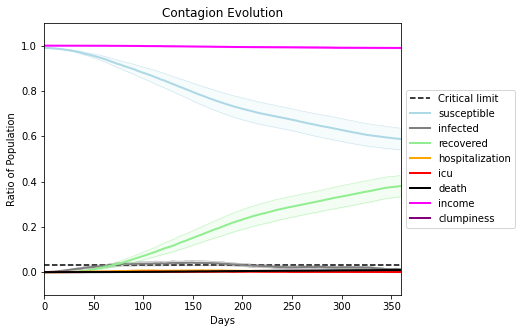

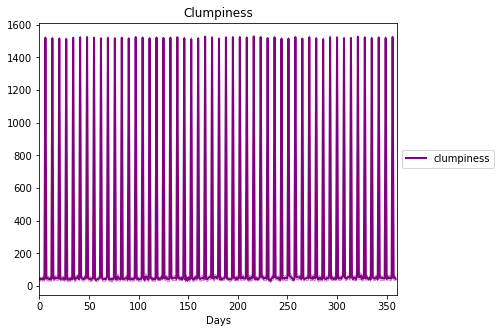

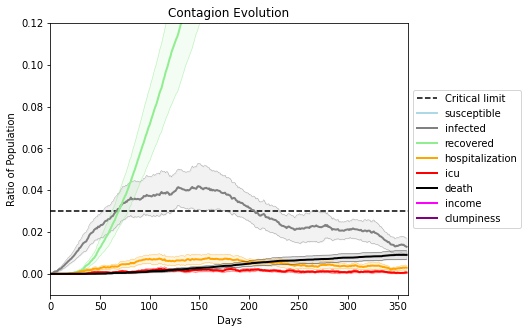

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2252, 7441, 3398, 8228, 1227, 7921, 8979, 8787, 9559, 3706, 9337, 3629, 1777, 3711, 9589, 3841, 7139, 4490, 4875, 6581]
Average similarity between family members is 0.19472238803611974 at temperature -0.4
Average similarity between family and home is 0.9998501179079522 at temperature -1
Average similarity between students and their classroom is 0.11911323494763854 at temperature -0.4
Average classroom occupancy is 1.509090909090909 and number classrooms is 165
Average similarity between workers is 0.1420282090107148 at temperature -0.4
Average office occupancy is 3.4146341463414633 and number offices is 205
Average friend similarity for adults: 0.29675420291290155 for kids: 0.20365321300408637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.2420410559503497
avg restaurant similarity 0.09482836147790649
avg restaurant similarity -0.008726724740421875
avg restaurant similarity -0.008548914759300141
avg restaurant similarity 0.0890909242964579
avg restaurant similarity 0.37269604553249885
avg restaurant similarity 0.1957252997355512
avg restaurant similarity 0.04806120378696856
avg restaurant similarity 0.21419187392907216
avg restaurant similarity 0.14072471492665017
avg restaurant similarity -0.07436482699729753
avg restaurant similarity 0.3396961941788319
avg restaurant similarity -0.10900077020161225
avg restaurant similarity 0.05733144414000282
avg restaurant similarity 0.08680840969669838
avg restaurant similarity 0.03374413103268009
avg restaurant similarity -0.01810994692818576
avg restaurant similarity 0.18261589248289153
avg restaurant similarity 0.08947731852529855
avg restaurant similarity 0.49471227882685986
avg restaurant similarity -0.1275398871895178
avg restaurant similarity -0.17

avg restaurant similarity 0.2496455006366644
avg restaurant similarity 0.20340950652940024
avg restaurant similarity 0.5791246053509164
Average similarity between family members is 0.22057208311078613 at temperature -0.4
Average similarity between family and home is 0.9998501197492421 at temperature -1
Average similarity between students and their classroom is 0.16549985426743172 at temperature -0.4
Average classroom occupancy is 1.6011560693641618 and number classrooms is 173
Average similarity between workers is 0.14443052695873707 at temperature -0.4
Average office occupancy is 3.388888888888889 and number offices is 198
Average friend similarity for adults: 0.28519439917185613 for kids: 0.20763545058046998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity -0.07941104682441319
avg restaurant similarity -0.031599795077165
avg restaurant similarity -0.09362646206364739
avg restaurant similarity 0.08920539593706632
avg restaurant similarity -0.20142189577005026
avg restaurant similarity 0.3374252633547828
avg restaurant similarity 0.2031658046892578
avg restaurant similarity 0.2196962836338871
avg restaurant similarity -0.31585547134631187
avg restaurant similarity -0.17463263868843165
avg restaurant similarity 0.047812310885988085
avg restaurant similarity 0.1397152476746567
avg restaurant similarity 0.13335677853745737
avg restaurant similarity -0.1630175563141671
avg restaurant similarity -0.22313947554010533
avg restaurant similarity 0.24150365175671037
avg restaurant similarity -0.38382596455802914
avg restaurant similarity 0.13191034314057415
avg restaurant similarity 0.15445689492339926
avg restaurant similarity -0.10553058591859743
avg restaurant similarity 0.024854505630201584
avg restaurant similarity -0.

avg restaurant similarity 0.3951436691809104
avg restaurant similarity -0.16708580812016816
avg restaurant similarity -0.15102869591372486
avg restaurant similarity 0.3432943251191626
avg restaurant similarity 0.16983967170062142
avg restaurant similarity -0.3517150566508256
avg restaurant similarity 0.14904271042348433
avg restaurant similarity -0.2149066813966721
avg restaurant similarity 0.057842832522196366
avg restaurant similarity 0.4958189046120826
avg restaurant similarity 0.09605830002731139
avg restaurant similarity 0.12454273530839993
avg restaurant similarity 0.25622133260092006
avg restaurant similarity -0.10486182896085894
avg restaurant similarity 0.031000556639231146
avg restaurant similarity 0.14316817065566267
avg restaurant similarity -0.3123658722313649
avg restaurant similarity 0.024854505630201584
avg restaurant similarity -0.38382596455802914
avg restaurant similarity -0.04099723458942355
avg restaurant similarity 0.31773226467967636
avg restaurant similarity -0.

avg restaurant similarity 0.25513167266244374
avg restaurant similarity 0.14451048992778323
avg restaurant similarity 0.03628162110237387
avg restaurant similarity -0.28987987350787414
avg restaurant similarity 0.04791560674599071
avg restaurant similarity -0.016929015363559896
avg restaurant similarity -0.09265729599049077
avg restaurant similarity -0.02582407958078882
avg restaurant similarity 0.11801832082462271
avg restaurant similarity -0.2484669770828722
avg restaurant similarity 0.14193892420317417
avg restaurant similarity -0.19040187725444307
avg restaurant similarity 0.42311010788426473
avg restaurant similarity -0.38880191136750436
avg restaurant similarity -0.003842690735852111
avg restaurant similarity -0.113170949329643
avg restaurant similarity 0.4033164758799474
avg restaurant similarity -0.16958057763905188
avg restaurant similarity 0.4033164758799474
avg restaurant similarity -0.21831491190260735
avg restaurant similarity -0.1482779788656119
avg restaurant similarity 

avg restaurant similarity 0.4808414195180614
avg restaurant similarity 0.09425795943770011
avg restaurant similarity 0.22011215579264581
avg restaurant similarity 0.04342296151992048
avg restaurant similarity 0.027012560825812784
avg restaurant similarity -0.025688144514719725
avg restaurant similarity 0.22529337609637876
avg restaurant similarity 0.0022769157644580394
Average similarity between family members is 0.2202097474081017 at temperature -0.4
Average similarity between family and home is 0.9998538587639454 at temperature -1
Average similarity between students and their classroom is 0.19606840004535844 at temperature -0.4
Average classroom occupancy is 1.546875 and number classrooms is 192
Average similarity between workers is 0.14922000993389467 at temperature -0.4
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.27855628647543196 for kids: 0.20955114021841595
home_districts
[
Home (0,0) district with 1 Buildings


avg restaurant similarity 0.3543770960902003
avg restaurant similarity 0.11296800447634545
avg restaurant similarity 0.2972940973352167
avg restaurant similarity -0.24196413074946974
avg restaurant similarity 0.2840174611898694
avg restaurant similarity -0.19807040697296172
avg restaurant similarity 0.19288809859769646
avg restaurant similarity 0.03792793748891402
avg restaurant similarity 0.0962534539603513
avg restaurant similarity 0.03752508759836298
avg restaurant similarity -0.02085291365034184
avg restaurant similarity 0.18049174759294187
avg restaurant similarity 0.6500773861561424
avg restaurant similarity 0.04677938971083934
avg restaurant similarity -0.1329792526019576
avg restaurant similarity 0.27113814050963775
avg restaurant similarity 0.2088143944834857
avg restaurant similarity 0.10635648273028615
avg restaurant similarity 0.09288767086700409
avg restaurant similarity -0.0033256699025819327
avg restaurant similarity -0.15130408896674355
avg restaurant similarity 0.60739

avg restaurant similarity 0.04677938971083934
Average similarity between family members is 0.2106530263448953 at temperature -0.4
Average similarity between family and home is 0.9998622268851757 at temperature -1
Average similarity between students and their classroom is 0.18220630527742376 at temperature -0.4
Average classroom occupancy is 1.4772727272727273 and number classrooms is 176
Average similarity between workers is 0.15054015883498498 at temperature -0.4
Average office occupancy is 3.4696969696969697 and number offices is 198
Average friend similarity for adults: 0.28148316475821983 for kids: 0.22884197492833133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4

avg restaurant similarity 0.018913272526477065
avg restaurant similarity 0.20001288398279915
avg restaurant similarity 0.1648881270558247
avg restaurant similarity 0.1793407346833309
avg restaurant similarity 0.268592664477222
avg restaurant similarity -0.024843674933141248
avg restaurant similarity 0.6962025295588014
avg restaurant similarity 0.1057771739216704
avg restaurant similarity 0.20810537010361627
avg restaurant similarity 0.05174192314824831
avg restaurant similarity 0.26179176682837785
avg restaurant similarity -0.013678321453558975
avg restaurant similarity 0.03419030955396774
avg restaurant similarity 0.4661694476595772
avg restaurant similarity 0.09696438982893085
avg restaurant similarity 0.2808425695256747
avg restaurant similarity -0.3007814890394833
avg restaurant similarity -0.12224636623843302
avg restaurant similarity 0.21445213351338654
avg restaurant similarity 0.5109237890139383
avg restaurant similarity 0.38674853072147836
avg restaurant similarity 0.038118174

avg restaurant similarity 0.2820941556349222
avg restaurant similarity 0.1989449261759398
avg restaurant similarity 0.16104094473862307
avg restaurant similarity 0.20701963669091844
avg restaurant similarity 0.5303945724825355
avg restaurant similarity -0.06754348361618671
avg restaurant similarity 0.2487680125465473
avg restaurant similarity 0.190866558186674
avg restaurant similarity 0.09545060534924557
avg restaurant similarity 0.07995864743550993
avg restaurant similarity -0.02304398162154246
avg restaurant similarity -0.12224636623843302
avg restaurant similarity 0.18706372459535253
avg restaurant similarity 0.14215485814023163
avg restaurant similarity 0.12092649556603212
avg restaurant similarity 0.0773700258322477
Average similarity between family members is 0.21081689105678586 at temperature -0.4
Average similarity between family and home is 0.9998656567000603 at temperature -1
Average similarity between students and their classroom is 0.12669895547270035 at temperature -0.4
A

avg restaurant similarity 0.020789976890775136
avg restaurant similarity 0.15935145797788552
avg restaurant similarity 0.017469575698428802
avg restaurant similarity 0.14960725108076747
avg restaurant similarity 0.23327243644610401
avg restaurant similarity 0.04377960047273628
avg restaurant similarity -0.1268653197781415
avg restaurant similarity 0.19213869992807256
avg restaurant similarity -0.07421838198614164
avg restaurant similarity 0.1146358150947785
avg restaurant similarity 0.0080643657562562
avg restaurant similarity -0.17311203687529042
avg restaurant similarity -0.23318918003726158
avg restaurant similarity -0.05052535818839521
avg restaurant similarity 0.19180505740024822
avg restaurant similarity 0.11246110720556708
avg restaurant similarity -0.3124060686608787
avg restaurant similarity -0.4532296557175108
avg restaurant similarity 0.32821003369178453
avg restaurant similarity 0.16387582096086645
avg restaurant similarity -0.12030322615099479
avg restaurant similarity 0.4

avg restaurant similarity 0.3230010449154064
avg restaurant similarity 0.3880943588643835
avg restaurant similarity 0.22303631842108995
avg restaurant similarity 0.16635933395534674
avg restaurant similarity -0.048754754181206963
avg restaurant similarity 0.12726923337900725
avg restaurant similarity -0.005648349763116886
avg restaurant similarity 0.013753231942360791
avg restaurant similarity 0.09793935968141167
avg restaurant similarity 0.27235132370155557
avg restaurant similarity 0.25836673335106447
avg restaurant similarity 0.35801481574090277
avg restaurant similarity 0.36131897000770485
avg restaurant similarity 0.10775673991071993
avg restaurant similarity 0.28291479014209353
avg restaurant similarity 0.10775673991071993
avg restaurant similarity -0.13307430099022566
avg restaurant similarity 0.12656122712369094
avg restaurant similarity 0.2504902810814372
avg restaurant similarity 0.3531164117967241
avg restaurant similarity 0.4272680468824719
avg restaurant similarity -0.1312

avg restaurant similarity -0.02448226496067219
avg restaurant similarity -0.19669426788864802
avg restaurant similarity 0.044835821599502584
avg restaurant similarity 0.06582728875639485
avg restaurant similarity 0.2120959614171532
avg restaurant similarity -0.036332810765591694
avg restaurant similarity 0.3705415463746104
avg restaurant similarity 0.3783915626341133
avg restaurant similarity 0.06715687550534002
avg restaurant similarity 0.7469562887162488
avg restaurant similarity 0.7095442335464544
avg restaurant similarity 0.23497565484239868
avg restaurant similarity 0.23175908530709616
avg restaurant similarity 0.150835601945177
avg restaurant similarity 0.7094447346179632
avg restaurant similarity 0.40604455964756236
avg restaurant similarity 0.0951651227424717
avg restaurant similarity 0.26297127022400413
avg restaurant similarity -0.005373677760732384
avg restaurant similarity -0.47335823209290706
avg restaurant similarity -0.1224707200767986
avg restaurant similarity 0.0595720

avg restaurant similarity -0.11629794778872804
avg restaurant similarity -0.11402280765574858
avg restaurant similarity -0.15538179999261892
avg restaurant similarity 0.13154700522060622
avg restaurant similarity 0.20123902260238397
avg restaurant similarity 0.37405154999551554
avg restaurant similarity -0.020743170341035337
avg restaurant similarity 0.06613491144912784
avg restaurant similarity -0.15538179999261892
Average similarity between family members is 0.21832224748361798 at temperature -0.4
Average similarity between family and home is 0.9998669355467869 at temperature -1
Average similarity between students and their classroom is 0.18324813797783648 at temperature -0.4
Average classroom occupancy is 1.6302083333333333 and number classrooms is 192
Average similarity between workers is 0.16218721762398874 at temperature -0.4
Average office occupancy is 3.155 and number offices is 200
Average friend similarity for adults: 0.2736769530308244 for kids: 0.20570782352808423
home_dist

avg restaurant similarity 0.0483051441947854
avg restaurant similarity 0.10404828517661568
avg restaurant similarity 0.5181436857470619
avg restaurant similarity -0.10092193947831943
avg restaurant similarity -0.36783303859805827
avg restaurant similarity 0.4477869735300826
avg restaurant similarity 0.24217459339147313
avg restaurant similarity 0.31525855532875385
avg restaurant similarity 0.23763109868690588
avg restaurant similarity 0.21358740583897304
avg restaurant similarity -0.15901059441206777
avg restaurant similarity -0.05144653307246469
avg restaurant similarity 0.13940774055470417
avg restaurant similarity 0.08178080989582223
avg restaurant similarity 0.35856931324493857
avg restaurant similarity 0.14763653425268708
avg restaurant similarity 0.0034834885229318713
avg restaurant similarity 0.325547059330522
avg restaurant similarity 0.35812950114276637
avg restaurant similarity 0.24820141461088396
avg restaurant similarity 0.09561382949146885
avg restaurant similarity 0.17483

avg restaurant similarity 0.2270007889866779
avg restaurant similarity 0.16184173813070682
avg restaurant similarity -0.3454075816213448
avg restaurant similarity -0.07455863664452245
avg restaurant similarity 0.17454458024658348
avg restaurant similarity -0.09733818878281891
avg restaurant similarity 0.7594997964411698
avg restaurant similarity 0.3152984992111059
avg restaurant similarity 0.12377266230167755
avg restaurant similarity 0.07844802789038208
avg restaurant similarity -0.05200035628444538
avg restaurant similarity 0.15491883641408213
avg restaurant similarity -0.14912101782839188
avg restaurant similarity 0.1842363388012921
avg restaurant similarity 0.2744460803365782
avg restaurant similarity -0.09895957595526747
avg restaurant similarity 0.2735535396022881
avg restaurant similarity -0.5494843796489107
avg restaurant similarity 0.050872725313557514
avg restaurant similarity 0.44508379069083326
avg restaurant similarity 0.2046921401854883
avg restaurant similarity 0.0035578

avg restaurant similarity -0.11558846942250137
avg restaurant similarity 0.1179254066442731
avg restaurant similarity 0.3859073050841729
avg restaurant similarity 0.07946880917398937
avg restaurant similarity 0.03365524909989398
avg restaurant similarity 0.3743035809603622
avg restaurant similarity 0.1917508974599139
avg restaurant similarity 0.34140788772622
avg restaurant similarity 0.03783275721975696
avg restaurant similarity 0.22159488327409943
Average similarity between family members is 0.2075918683031508 at temperature -0.4
Average similarity between family and home is 0.9998502547544172 at temperature -1
Average similarity between students and their classroom is 0.15139841158341455 at temperature -0.4
Average classroom occupancy is 1.631578947368421 and number classrooms is 171
Average similarity between workers is 0.13482906190956948 at temperature -0.4
Average office occupancy is 3.299019607843137 and number offices is 204
Average friend similarity for adults: 0.282795540244

avg restaurant similarity 0.10629450534212374
avg restaurant similarity 0.18094304801398728
avg restaurant similarity -0.0315373116769439
avg restaurant similarity 0.34913817675502995
avg restaurant similarity 0.19709600403760688
avg restaurant similarity 0.3503857954910891
avg restaurant similarity 0.05096498721769269
avg restaurant similarity 0.0699586999254708
avg restaurant similarity -0.1893981717138719
avg restaurant similarity 0.30793040331548716
avg restaurant similarity 0.11049507313579325
avg restaurant similarity 0.21353279805195616
avg restaurant similarity 0.08021439528006634
avg restaurant similarity -0.013039866698604408
avg restaurant similarity 0.03015327000890879
avg restaurant similarity 0.1332782906077744
avg restaurant similarity 0.7177857724905563
avg restaurant similarity -0.012950248144888016
avg restaurant similarity 0.2337360606671571
avg restaurant similarity 0.36506660155157483
avg restaurant similarity 0.4613365300128198
avg restaurant similarity 0.42362486

avg restaurant similarity 0.08432423021704448
avg restaurant similarity 0.11113039664306762
avg restaurant similarity 0.0004142635921734472
avg restaurant similarity 0.2588305173780753
avg restaurant similarity 0.28644022927356394
avg restaurant similarity 0.30674867325186433
avg restaurant similarity 0.573610354274265
avg restaurant similarity 0.05834237496940414
avg restaurant similarity 0.2424712675050148
avg restaurant similarity 0.42352828578679774
avg restaurant similarity -0.08253292936230777
avg restaurant similarity 0.10166567355612888
avg restaurant similarity 0.1907745548559212
avg restaurant similarity 0.4319866271749495
avg restaurant similarity 0.0030788925918046606
avg restaurant similarity -0.01774557225570072
avg restaurant similarity -0.02050851482944723
avg restaurant similarity -0.058925467878477016
avg restaurant similarity 0.04807791685414817
avg restaurant similarity 0.19327272601690915
avg restaurant similarity 0.42352828578679774
avg restaurant similarity 0.085

avg restaurant similarity 0.24618252910100022
avg restaurant similarity 0.29203912078804733
avg restaurant similarity -0.16261281411495254
avg restaurant similarity 0.05085652905410494
avg restaurant similarity -0.1633444309543541
avg restaurant similarity 0.15214793908508917
avg restaurant similarity -0.08612201650187774
avg restaurant similarity -0.2951880528552254
avg restaurant similarity 0.18586119129860829
avg restaurant similarity 0.26465124848815236
avg restaurant similarity 0.2759473413853217
avg restaurant similarity 0.2288734916491734
avg restaurant similarity 0.2580986100155
avg restaurant similarity 0.22601645946542914
avg restaurant similarity 0.20532973225686302
avg restaurant similarity 0.24532804466027203
avg restaurant similarity 0.012057070077721666
avg restaurant similarity 0.43550541637643353
avg restaurant similarity 0.3440488855977606
avg restaurant similarity 0.46269054276655375
avg restaurant similarity 0.26646331821090463
avg restaurant similarity -0.085519822

avg restaurant similarity 0.14749481193140895
avg restaurant similarity 0.26818001481571485
avg restaurant similarity 0.06768513749823138
avg restaurant similarity -0.05443274764613427
avg restaurant similarity 0.3354613039134215
avg restaurant similarity -0.3000712113111497
avg restaurant similarity 0.1171150629205543
avg restaurant similarity 0.17994941858932276
avg restaurant similarity 0.04119490138943743
avg restaurant similarity 0.27752659582202865
avg restaurant similarity -0.3021142739547937
avg restaurant similarity -0.03348308822819751
avg restaurant similarity 0.17143970376406792
avg restaurant similarity -0.058011446722100936
avg restaurant similarity 0.21733718511684752
avg restaurant similarity -0.3361078897714117
avg restaurant similarity -0.09713457769445064
avg restaurant similarity -0.05021958416119665
avg restaurant similarity 0.3746898601378561
avg restaurant similarity 0.4829987408545081
avg restaurant similarity 0.40694768620862926
avg restaurant similarity 0.1535

avg restaurant similarity -0.01953290522917099
avg restaurant similarity 0.11609447271662245
avg restaurant similarity 0.2783050419613592
avg restaurant similarity 0.006581387422277013
avg restaurant similarity -0.12061487960356622
avg restaurant similarity 0.1274839462615527
avg restaurant similarity 0.48643351954447056
avg restaurant similarity 0.44695226887680983
avg restaurant similarity 0.2809681969214656
avg restaurant similarity 0.03311432004781856
avg restaurant similarity 0.10888796130730118
avg restaurant similarity -0.08166615266958463
avg restaurant similarity 0.11416177135742019
avg restaurant similarity -0.3374837309470258
avg restaurant similarity 0.25719570993814006
avg restaurant similarity 0.2882248931145932
avg restaurant similarity 0.2482483986827584
avg restaurant similarity 0.2744738810704218
avg restaurant similarity 0.14819062610732067
avg restaurant similarity 0.07649352481763592
avg restaurant similarity 0.0437081227392173
avg restaurant similarity -0.15524870

Average similarity between workers is 0.1390260549286887 at temperature -0.4
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.278435669622279 for kids: 0.21290401184897448
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocat

avg restaurant similarity 0.13319833827213617
avg restaurant similarity 0.39676831011063945
avg restaurant similarity -0.06591511620234508
avg restaurant similarity 0.04719865158917881
avg restaurant similarity 0.03218008189269611
avg restaurant similarity 0.14263720049517778
avg restaurant similarity 0.6547364652815655
avg restaurant similarity -0.1988652808149738
avg restaurant similarity 0.24310175090055033
avg restaurant similarity 0.3712082343292431
avg restaurant similarity 0.11193910218112771
avg restaurant similarity 0.09580829784297573
avg restaurant similarity 0.6496884119957118
avg restaurant similarity -0.03522848429660586
avg restaurant similarity -0.2295074563248169
avg restaurant similarity 0.11830784570488492
avg restaurant similarity 0.12490304255755069
avg restaurant similarity 0.6164405951136509
avg restaurant similarity -0.31483117417447704
avg restaurant similarity -0.35324212140901556
avg restaurant similarity 0.09273348050560665
avg restaurant similarity -0.34140

avg restaurant similarity 0.11643837895710306
avg restaurant similarity 0.0033520073384717963
avg restaurant similarity -0.2295074563248169
avg restaurant similarity -0.12783555316472361
avg restaurant similarity 0.01461270470332969
avg restaurant similarity -0.03524267556679164
avg restaurant similarity -0.003909273251524195
Average similarity between family members is 0.20094051418646935 at temperature -0.4
Average similarity between family and home is 0.9998446054714277 at temperature -1
Average similarity between students and their classroom is 0.15573655681492818 at temperature -0.4
Average classroom occupancy is 1.6477272727272727 and number classrooms is 176
Average similarity between workers is 0.1437515423814983 at temperature -0.4
Average office occupancy is 3.2463054187192117 and number offices is 203
Average friend similarity for adults: 0.27608354901311694 for kids: 0.2079088970911867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.07337733900044946
avg restaurant similarity -0.06623055240110115
avg restaurant similarity 0.19895698229864348
avg restaurant similarity 0.30024297044134834
avg restaurant similarity 0.2821049215813097
avg restaurant similarity -0.015375217956999226
avg restaurant similarity 0.015141564170898958
avg restaurant similarity 0.04438251677637617
avg restaurant similarity -0.3070775357519318
avg restaurant similarity 0.5447533492801228
avg restaurant similarity -0.06961994530998436
avg restaurant similarity 0.03932282528356072
avg restaurant similarity 0.0072580469833513905
avg restaurant similarity -0.40988218378834645
avg restaurant similarity 0.3583108605246825
avg restaurant similarity 0.3719897936945824
avg restaurant similarity -0.05186929298592414
avg restaurant similarity -0.06611243705011433
avg restaurant similarity 0.055418157814756425
avg restaurant similarity -0.24426258326861836
avg restaurant similarity 0.09499015268862114
avg restaurant similarity 

avg restaurant similarity 0.27584768504229384
avg restaurant similarity 0.008632868515131167
avg restaurant similarity 0.045788185348573096
avg restaurant similarity -0.11759673622064978
avg restaurant similarity 0.0025213288907604617
avg restaurant similarity 0.24954284532908347
avg restaurant similarity 0.3180466342468079
avg restaurant similarity 0.09634948298632502
avg restaurant similarity -0.11986925453543024
avg restaurant similarity 0.3879120415167762
avg restaurant similarity -0.12931604405861927
avg restaurant similarity 0.06990467736610059
avg restaurant similarity 0.021491200017864684
avg restaurant similarity 0.1766555588093733
avg restaurant similarity -0.0072848555054405295
avg restaurant similarity 0.18986883924149142
avg restaurant similarity -0.04348772538352609
avg restaurant similarity -0.2715469690039352
avg restaurant similarity 0.12428529579010957
avg restaurant similarity 0.04757917771189208
avg restaurant similarity -0.167121979089047
avg restaurant similarity 

avg restaurant similarity 0.13250112374302217
avg restaurant similarity 0.04947152095243659
avg restaurant similarity 0.1647631112817695
avg restaurant similarity 0.1647631112817695
avg restaurant similarity 0.1866770068335193
avg restaurant similarity -0.20742187673905346
avg restaurant similarity 0.21578700403472106
avg restaurant similarity 0.2833129115115103
avg restaurant similarity 0.2547980324740945
avg restaurant similarity 0.0801509917639237
avg restaurant similarity -0.22729484797544555
avg restaurant similarity 0.377903028056187
avg restaurant similarity 0.40663410263416644
avg restaurant similarity -0.14867653378709025
avg restaurant similarity 0.05438505092584557
avg restaurant similarity 0.1575900142151485
avg restaurant similarity 0.29316684224265155
avg restaurant similarity 0.09914112356621842
avg restaurant similarity 0.04591358534554835
avg restaurant similarity 0.2866912671855744
avg restaurant similarity 0.09219681081512536
avg restaurant similarity 0.0293425441447

avg restaurant similarity -0.11421875759308803
avg restaurant similarity -0.05479475539733473
avg restaurant similarity -0.0025002811723720837
avg restaurant similarity -0.08486671949218709
avg restaurant similarity -0.027638633745603144
avg restaurant similarity -0.1952191374737827
avg restaurant similarity 0.4918589295688881
avg restaurant similarity 0.29953099800378985
avg restaurant similarity 0.19309896321956976
avg restaurant similarity 0.05177581275689404
avg restaurant similarity 0.5872648508636679
avg restaurant similarity 0.28371434192348305
avg restaurant similarity -0.0370437306832838
avg restaurant similarity -0.09974674840920701
avg restaurant similarity -0.017675233359647956
avg restaurant similarity -0.0635443107325892
avg restaurant similarity 0.32563667511855177
avg restaurant similarity 0.13561273164606186
avg restaurant similarity -0.0021308464204266298
avg restaurant similarity -0.3891902425169341
avg restaurant similarity 0.005479283051337908
avg restaurant simila

avg restaurant similarity 0.16808206021913094
avg restaurant similarity -0.06520536594900256
avg restaurant similarity 0.29522710867838237
avg restaurant similarity 0.5058667601824764
avg restaurant similarity -0.3374883402842855
avg restaurant similarity 0.09584545940857177
avg restaurant similarity 0.08821024791332446
avg restaurant similarity -0.26289309796119936
avg restaurant similarity 0.3245316900652229
avg restaurant similarity 0.33468228998979954
avg restaurant similarity 0.8953290415908559
avg restaurant similarity 0.3953206265234101
avg restaurant similarity 0.41888547084850514
avg restaurant similarity 0.5212666844603187
avg restaurant similarity 0.43369404748255924
avg restaurant similarity 0.33289664322335866
avg restaurant similarity -0.02072695396231146
avg restaurant similarity 0.03297232598151695
avg restaurant similarity -0.4029582506556745
avg restaurant similarity 0.1384257125530269
avg restaurant similarity 0.25606849522192
avg restaurant similarity 0.242345399443

avg restaurant similarity 0.24857039848876417
avg restaurant similarity -0.1751818366392544
avg restaurant similarity 0.14369498572895792
avg restaurant similarity 0.14916375718640923
avg restaurant similarity 0.029940071270290018
avg restaurant similarity -0.1294647325989572
avg restaurant similarity 0.16863197497409976
avg restaurant similarity 0.06782452152874616
avg restaurant similarity 0.11892510174525478
avg restaurant similarity 0.21756752110234
avg restaurant similarity 0.46751870659631023
avg restaurant similarity 0.09124597493728007
avg restaurant similarity 0.14688191451769725
avg restaurant similarity -0.03808531868890908
avg restaurant similarity 0.04031046946937378
avg restaurant similarity -0.2305560284713401
avg restaurant similarity -0.073438014849437
avg restaurant similarity 0.3174693387694568
avg restaurant similarity -0.1700512278570255
avg restaurant similarity 0.6379598512588014
avg restaurant similarity 0.1655665058018973
avg restaurant similarity -0.1597931203

Average similarity between workers is 0.15216159259055556 at temperature -0.4
Average office occupancy is 3.1323529411764706 and number offices is 204
Average friend similarity for adults: 0.2761508776889168 for kids: 0.2177294566615762
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 1

avg restaurant similarity 0.0661367141771814
avg restaurant similarity -0.24480722118280226
avg restaurant similarity 0.06184709083583481
avg restaurant similarity 0.16895339997660988
avg restaurant similarity 0.17239828088988973
avg restaurant similarity 0.18988821148913132
avg restaurant similarity -0.08246392404611044
avg restaurant similarity 0.0038388762297814245
avg restaurant similarity 0.2169704220730777
avg restaurant similarity -0.12954033996759567
avg restaurant similarity 0.5095155334350356
avg restaurant similarity 0.22201376370165815
avg restaurant similarity 0.20215696481848786
avg restaurant similarity 0.08956094239758633
avg restaurant similarity 0.17761252001670025
avg restaurant similarity -0.4549696335535008
avg restaurant similarity -0.05639552020166695
avg restaurant similarity 0.32085934992787113
avg restaurant similarity 0.2591743627950005
avg restaurant similarity -0.10244110318041727
avg restaurant similarity 0.0943204207815651
avg restaurant similarity -0.025

(<function dict.items>, <function dict.items>, <function dict.items>)

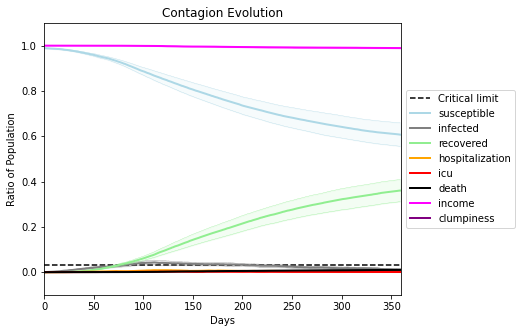

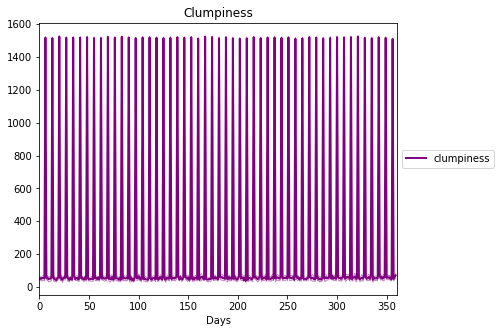

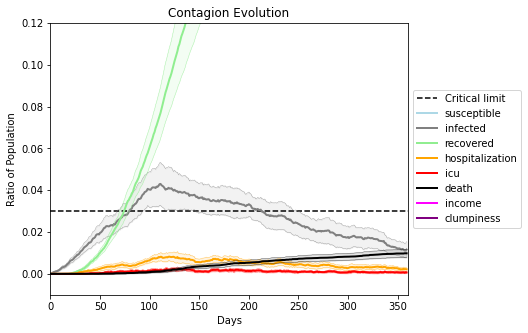

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2196, 4148, 2180, 6409, 3955, 4350, 2628, 9314, 2882, 4444, 8930, 8804, 9444, 1626, 5775, 772, 2105, 7695, 7165, 7347]
Average similarity between family members is 0.20686118406132142 at temperature -0.3
Average similarity between family and home is 0.9998407066775615 at temperature -1
Average similarity between students and their classroom is 0.2063692384117279 at temperature -0.3
Average classroom occupancy is 1.6073298429319371 and number classrooms is 191
Average similarity between workers is 0.15240157739074559 at temperature -0.3
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.25003483773856794 for kids: 0.22275938680790036
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity -0.08490224629212006
avg restaurant similarity 0.0034773577644986314
avg restaurant similarity -0.5895270644800816
avg restaurant similarity -0.2128124929574929
avg restaurant similarity 0.13947540558859706
avg restaurant similarity 0.41767839601706036
avg restaurant similarity 0.09353019671162552
avg restaurant similarity 0.4709770724893644
avg restaurant similarity 0.2163334007734179
avg restaurant similarity 0.41586562050093934
avg restaurant similarity -0.02416691453330197
avg restaurant similarity -0.09425191988859816
avg restaurant similarity -0.02100988401730802
avg restaurant similarity -0.045680722089572245
avg restaurant similarity -0.19757140351005056
avg restaurant similarity 0.10980063272363558
avg restaurant similarity 0.1919203152391097
avg restaurant similarity 0.4783102236527417
avg restaurant similarity 0.19938782565795501
avg restaurant similarity 0.5268144855747964
avg restaurant similarity 0.11435121657015242
avg restaurant similarity 0.42

avg restaurant similarity -0.1149492111038655
avg restaurant similarity 0.8429576486424117
avg restaurant similarity 0.4381044007168597
avg restaurant similarity 0.30758976652154624
avg restaurant similarity 0.5183820437168182
avg restaurant similarity 0.46280409168533376
avg restaurant similarity 0.04425898568760718
avg restaurant similarity 0.27218553187941047
Average similarity between family members is 0.17087362421450633 at temperature -0.3
Average similarity between family and home is 0.9998683648383503 at temperature -1
Average similarity between students and their classroom is 0.20973372599190188 at temperature -0.3
Average classroom occupancy is 1.60989010989011 and number classrooms is 182
Average similarity between workers is 0.17018804730417098 at temperature -0.3
Average office occupancy is 3.312820512820513 and number offices is 195
Average friend similarity for adults: 0.24134373471337625 for kids: 0.20509449820578465
home_districts
[
Home (0,0) district with 1 Buildings

avg restaurant similarity 0.4053136975824403
avg restaurant similarity 0.27970757891856535
avg restaurant similarity -0.19927670368991965
avg restaurant similarity 0.04721736735937036
avg restaurant similarity -0.20523615095091735
avg restaurant similarity 0.20186576555467226
avg restaurant similarity -0.10951003034724942
avg restaurant similarity 0.15301414246223663
avg restaurant similarity 0.03644146589627165
avg restaurant similarity 0.0661803208993472
avg restaurant similarity -0.17878238777200328
avg restaurant similarity 0.22551803889979508
avg restaurant similarity -0.15102379385609854
avg restaurant similarity 0.09655162435328471
avg restaurant similarity -0.27272534476406224
avg restaurant similarity -0.15605264316357478
avg restaurant similarity -0.12717165017989548
avg restaurant similarity -0.0510681545628545
avg restaurant similarity -0.30668935858959645
avg restaurant similarity 0.3687251544520594
avg restaurant similarity -0.046053459173632696
avg restaurant similarity 

avg restaurant similarity 0.32716709290218304
avg restaurant similarity -0.06709428963993484
avg restaurant similarity -0.07250803959631263
avg restaurant similarity 0.17914854015068582
avg restaurant similarity 0.2062286770283721
avg restaurant similarity 0.02455930053229112
avg restaurant similarity -0.028817255187551603
avg restaurant similarity -0.11610216331154934
avg restaurant similarity -0.124237457283528
avg restaurant similarity -0.4434590358903316
avg restaurant similarity 0.04059575906377902
avg restaurant similarity 0.08102553029095737
avg restaurant similarity -0.12261088352164654
avg restaurant similarity 0.18404574678050578
avg restaurant similarity 0.061585624166622166
avg restaurant similarity 0.12775967155225812
avg restaurant similarity 0.0449118183614054
avg restaurant similarity 0.053400799197753035
Average similarity between family members is 0.18169377651068525 at temperature -0.3
Average similarity between family and home is 0.9998509382354199 at temperature -1

avg restaurant similarity 0.0005061065966117939
avg restaurant similarity -0.09080670871058807
avg restaurant similarity 0.0005061065966117939
avg restaurant similarity -0.11950776221777064
avg restaurant similarity 0.1297536971446813
avg restaurant similarity 0.1736824081553508
avg restaurant similarity 0.35766959296320977
avg restaurant similarity 0.10957110625140613
avg restaurant similarity 0.20604929894060758
avg restaurant similarity 0.15477965796755713
avg restaurant similarity 0.1174099804735683
avg restaurant similarity 0.2602182181501062
avg restaurant similarity -0.3630335687967574
avg restaurant similarity 0.03504081317629554
avg restaurant similarity 0.0876558405004943
avg restaurant similarity 0.1484997295267361
avg restaurant similarity 0.7504400611851754
avg restaurant similarity 0.4475633330501705
avg restaurant similarity 0.08813842996593889
avg restaurant similarity 0.21591646768555717
avg restaurant similarity -0.2604192996284098
avg restaurant similarity 0.25837842

avg restaurant similarity 0.11265847683535443
avg restaurant similarity 0.3683794878231297
avg restaurant similarity 0.20424368450273397
avg restaurant similarity 0.028418815968230274
avg restaurant similarity 0.22979883899709352
avg restaurant similarity 0.5331252951084154
avg restaurant similarity 0.058237863568632836
avg restaurant similarity -0.07066125223016789
avg restaurant similarity 0.9999035535995361
avg restaurant similarity 0.10501858959527723
avg restaurant similarity 0.28729792324620995
avg restaurant similarity -0.2330795613203268
avg restaurant similarity 0.25595262498981863
avg restaurant similarity -0.5150521814074711
avg restaurant similarity -0.04704174709188724
avg restaurant similarity -0.010264831405177421
avg restaurant similarity 0.24971897729489517
avg restaurant similarity -0.036185110182535216
avg restaurant similarity 0.008538462790805154
avg restaurant similarity 0.14048655352277167
avg restaurant similarity -0.014763022804193247
avg restaurant similarity 

avg restaurant similarity 0.2731794449129271
avg restaurant similarity -0.198173985426415
avg restaurant similarity 0.12791447413996762
avg restaurant similarity -0.18059899943109511
avg restaurant similarity -0.44946590504502815
avg restaurant similarity 0.33804917446512056
avg restaurant similarity 0.19779597130478013
avg restaurant similarity 0.26508901102418037
avg restaurant similarity -0.1634708283449581
avg restaurant similarity 0.3204328127074846
avg restaurant similarity 0.05942549614309661
avg restaurant similarity 0.25063134211694094
avg restaurant similarity -0.061910020072643956
avg restaurant similarity -0.025516476690750342
avg restaurant similarity -0.05867933949486579
avg restaurant similarity -0.13541637999079442
avg restaurant similarity 0.037724380791131926
avg restaurant similarity 0.11903906076991726
avg restaurant similarity 0.018301108782571674
avg restaurant similarity 0.04361877006785087
avg restaurant similarity 0.12246568846722516
avg restaurant similarity -

avg restaurant similarity -0.17462946284196074
avg restaurant similarity -0.08049126717979777
avg restaurant similarity -0.08049126717979777
avg restaurant similarity 0.26115437097060773
avg restaurant similarity 0.0676826641496766
avg restaurant similarity 0.02609412546467703
Average similarity between family members is 0.19004650406372453 at temperature -0.3
Average similarity between family and home is 0.9998491519018983 at temperature -1
Average similarity between students and their classroom is 0.14235574349169555 at temperature -0.3
Average classroom occupancy is 1.580110497237569 and number classrooms is 181
Average similarity between workers is 0.13926251053553873 at temperature -0.3
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.2440967816288418 for kids: 0.20734638845582493
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units wit

avg restaurant similarity 0.19554916177557893
avg restaurant similarity 0.23095169934942883
avg restaurant similarity 0.14224747222973774
avg restaurant similarity -0.06898018425494053
avg restaurant similarity -0.14945512127590477
avg restaurant similarity 0.09078416897539857
avg restaurant similarity 0.040856407621436615
avg restaurant similarity 0.2252430867942674
avg restaurant similarity 0.25089334416301634
avg restaurant similarity -0.02342168200592956
avg restaurant similarity 0.2725423894210519
avg restaurant similarity 0.04651310856363154
avg restaurant similarity 0.15922091469089888
avg restaurant similarity 0.08755202163222382
avg restaurant similarity 0.4916685188837198
avg restaurant similarity 0.20568473748576643
avg restaurant similarity 0.015485206082044081
avg restaurant similarity -0.1306081771407845
avg restaurant similarity 0.04344039004890695
avg restaurant similarity 0.31614043670869535
avg restaurant similarity 0.05011821816534433
avg restaurant similarity 0.2437

avg restaurant similarity 0.2444541539343127
avg restaurant similarity -0.020061783011637135
avg restaurant similarity 0.09568262371349648
avg restaurant similarity 0.015941051194716366
avg restaurant similarity -0.08034468156933522
avg restaurant similarity 0.19264443450366608
avg restaurant similarity -0.002231526506580983
avg restaurant similarity 0.3081770164363516
avg restaurant similarity -0.11187088388247828
avg restaurant similarity -0.010251651150880961
avg restaurant similarity -0.25719423030528055
avg restaurant similarity 0.08398156231140674
avg restaurant similarity -0.1438589854469354
avg restaurant similarity -0.09868945774865913
avg restaurant similarity -0.29169417181202834
avg restaurant similarity -0.03495542708170515
avg restaurant similarity -0.053008236871875065
avg restaurant similarity -0.29169417181202834
avg restaurant similarity 0.15958939710212094
avg restaurant similarity 0.3142365850708323
avg restaurant similarity 0.06297036332195413
avg restaurant simila

avg restaurant similarity 0.021393152723023723
avg restaurant similarity 0.044097328750943826
avg restaurant similarity 0.02377476113721729
avg restaurant similarity 0.19331848842542743
avg restaurant similarity -0.0326245245421912
avg restaurant similarity -0.05002567964648709
avg restaurant similarity -0.03729743794342123
avg restaurant similarity 0.29057638143453823
avg restaurant similarity 0.034209479131546615
avg restaurant similarity -0.16672934038473275
avg restaurant similarity -0.0003478273048053357
avg restaurant similarity -0.09320766507013009
avg restaurant similarity 0.044097328750943826
avg restaurant similarity 0.1265212366186178
avg restaurant similarity 0.13318233695511916
avg restaurant similarity -0.00018739208082696468
avg restaurant similarity 0.19331848842542743
avg restaurant similarity -0.1752613806033093
avg restaurant similarity 0.41321293239397994
avg restaurant similarity 0.4245153128071308
Average similarity between family members is 0.18689376195241636 at

avg restaurant similarity 0.08118159981759934
avg restaurant similarity 0.2404787626363511
avg restaurant similarity 0.030575917612469083
avg restaurant similarity -0.24670020072648993
avg restaurant similarity 0.03758100114064347
avg restaurant similarity 0.23268191523989107
avg restaurant similarity -0.1583967212002751
avg restaurant similarity 0.600154754826518
avg restaurant similarity -0.1382843430488735
avg restaurant similarity 0.12913788260651293
avg restaurant similarity 0.3571522700032363
avg restaurant similarity 0.09384307965954126
avg restaurant similarity -0.0838779938112081
avg restaurant similarity -0.4233661365862632
avg restaurant similarity -0.08734676766725848
avg restaurant similarity 0.36999953816960585
avg restaurant similarity 0.2888329926355512
avg restaurant similarity 0.16970961419469685
avg restaurant similarity 0.0869951207675035
avg restaurant similarity -0.18578594439925383
avg restaurant similarity 0.14808422205039962
avg restaurant similarity -0.0014159

avg restaurant similarity 0.46318971762353156
avg restaurant similarity -0.055237817348726986
avg restaurant similarity 0.10531931503601688
avg restaurant similarity 0.03697229109582603
avg restaurant similarity 0.11720619725042215
avg restaurant similarity -0.09680028783053243
avg restaurant similarity 0.023147285076783142
avg restaurant similarity 0.3976765714655415
avg restaurant similarity 0.585005859292093
avg restaurant similarity -0.0924284226418602
avg restaurant similarity 0.3104252299379603
avg restaurant similarity 0.0979364103478193
avg restaurant similarity -0.019368665645975502
avg restaurant similarity -0.19029453311504244
avg restaurant similarity 0.07475360095747512
avg restaurant similarity -0.29620017206847826
avg restaurant similarity -0.15096434155526356
avg restaurant similarity 0.1026596649713687
avg restaurant similarity -0.08046871633557469
avg restaurant similarity 0.02939309811264232
avg restaurant similarity -0.18403044024211632
avg restaurant similarity 0.2

avg restaurant similarity -0.07794225128401638
avg restaurant similarity -0.06442917023517422
avg restaurant similarity -0.1877879647631597
avg restaurant similarity -0.20459603493229137
avg restaurant similarity 0.026733324745030273
avg restaurant similarity 0.04207286989015374
avg restaurant similarity -0.3294886728526599
avg restaurant similarity 0.26487357565904074
avg restaurant similarity -0.006540273917229367
avg restaurant similarity -0.040480214479978044
avg restaurant similarity -0.2563395929743346
avg restaurant similarity 0.11173277109570931
avg restaurant similarity -0.2101661326453384
avg restaurant similarity 0.25234905220977294
avg restaurant similarity -0.12355376364287361
avg restaurant similarity -0.28666648697536434
avg restaurant similarity -0.0814204043972205
avg restaurant similarity 0.1560170488277095
avg restaurant similarity -0.2108729020205277
avg restaurant similarity -0.3524585649833679
avg restaurant similarity -0.05773662716529482
avg restaurant similarit

avg restaurant similarity 0.283762994526621
avg restaurant similarity 0.029075100164897543
avg restaurant similarity 0.19573043723500586
avg restaurant similarity 0.046508232886750156
avg restaurant similarity -0.07485981288483329
avg restaurant similarity -0.15689619696558244
avg restaurant similarity -0.12786928150707633
avg restaurant similarity -0.34289841108606034
avg restaurant similarity -0.2907533649202333
avg restaurant similarity 0.371728968397452
avg restaurant similarity -0.08536729969500513
avg restaurant similarity -0.014536944771260454
avg restaurant similarity 0.010106215451607968
avg restaurant similarity 0.4574022063895902
avg restaurant similarity -0.20702811374019758
avg restaurant similarity 0.14020459314907047
avg restaurant similarity 0.3940435751947677
avg restaurant similarity 0.03231201347753786
avg restaurant similarity -0.2657314904015788
avg restaurant similarity 0.10105136966783806
avg restaurant similarity -0.06499014276362024
avg restaurant similarity -0

avg restaurant similarity 0.29354217921703846
avg restaurant similarity 0.07804566084381856
avg restaurant similarity 0.4618637199359202
avg restaurant similarity 0.19083007873449775
avg restaurant similarity 0.33549413688787444
avg restaurant similarity 0.14031422100004792
avg restaurant similarity -0.06827826049559133
avg restaurant similarity 0.2062606615597487
avg restaurant similarity 0.1485398390094776
avg restaurant similarity 0.2419390836982181
avg restaurant similarity 0.39263090500501513
avg restaurant similarity 0.05500210610191786
avg restaurant similarity -0.4366473209839925
avg restaurant similarity 0.13991079770120166
avg restaurant similarity 0.5150379758468444
avg restaurant similarity 0.1763538899906119
avg restaurant similarity 0.11626952859004233
avg restaurant similarity -0.11869139159139871
avg restaurant similarity 0.06930798748823358
avg restaurant similarity 0.3270398500693749
avg restaurant similarity 0.12628091195465554
avg restaurant similarity 0.29167678160

Average similarity between students and their classroom is 0.1333850894761305 at temperature -0.3
Average classroom occupancy is 1.55 and number classrooms is 180
Average similarity between workers is 0.15391705756858717 at temperature -0.3
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.2511835997205974 for kids: 0.22087004776282998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this distric

avg restaurant similarity 0.30208794368037095
avg restaurant similarity 0.29729924161540866
avg restaurant similarity -0.2682361066741601
avg restaurant similarity 0.1146565426864594
avg restaurant similarity 0.049074713434200896
avg restaurant similarity 0.14061530701256647
avg restaurant similarity 0.07196129417130948
avg restaurant similarity 0.43671821506288494
avg restaurant similarity 0.22471662242004847
avg restaurant similarity 0.017287470718196994
avg restaurant similarity 0.574221682317594
avg restaurant similarity 0.726724766732834
avg restaurant similarity 0.2700027034270002
avg restaurant similarity 0.454022490262303
avg restaurant similarity 0.08048107142172284
avg restaurant similarity 0.2648776069862865
avg restaurant similarity -0.2526116564265607
avg restaurant similarity 0.23981866365236706
avg restaurant similarity 0.5882276344334108
avg restaurant similarity 0.24687190574858675
avg restaurant similarity 0.2772985159571982
avg restaurant similarity -0.31060074198019

avg restaurant similarity -0.17342118389295014
avg restaurant similarity 0.03992272071082974
avg restaurant similarity -0.23247388501245914
avg restaurant similarity 0.20786177514055237
avg restaurant similarity -0.3981123637062747
avg restaurant similarity -0.10148610673666074
avg restaurant similarity 0.14293514056237205
avg restaurant similarity 0.0033956919371208177
avg restaurant similarity -0.15788267555640942
avg restaurant similarity -0.1547666427600623
avg restaurant similarity 0.15480923939198285
avg restaurant similarity -0.06412324804839224
avg restaurant similarity 0.019835396964684043
avg restaurant similarity 0.13685583198341816
avg restaurant similarity -0.07065367551503736
avg restaurant similarity -0.04019797844887719
avg restaurant similarity -0.10724464251227396
avg restaurant similarity 0.03780384698634678
avg restaurant similarity -0.19863632984848498
avg restaurant similarity -0.10621518364867752
avg restaurant similarity -0.033665087713400876
avg restaurant simi

Average similarity between workers is 0.14256066264905795 at temperature -0.3
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.24669764510029565 for kids: 0.20360245631396326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total 

avg restaurant similarity 0.14869080467585893
avg restaurant similarity 0.144540422975063
avg restaurant similarity -0.007938590226665529
avg restaurant similarity 0.3406302612900958
avg restaurant similarity -0.22227419763897893
avg restaurant similarity 0.24121458053343087
avg restaurant similarity -0.21997796418991314
avg restaurant similarity 0.54021472358436
avg restaurant similarity 0.41855719977529493
avg restaurant similarity 0.35958616331939103
avg restaurant similarity 0.1578656291082562
avg restaurant similarity -0.016646185087861132
avg restaurant similarity 0.33723388456242454
avg restaurant similarity 0.04128325458697686
avg restaurant similarity -0.08504071042852478
avg restaurant similarity 0.5155099598268581
avg restaurant similarity -0.32048361939555375
avg restaurant similarity 0.1055873275145736
avg restaurant similarity -0.04970516405112531
avg restaurant similarity 0.3181371587485922
avg restaurant similarity 0.20834145022411663
avg restaurant similarity 0.3689425

avg restaurant similarity 0.24444581201683818
avg restaurant similarity -0.042187061106288275
avg restaurant similarity -0.061536110953410245
avg restaurant similarity 0.41546583846253315
avg restaurant similarity 0.28160060100011675
avg restaurant similarity 0.7380526563801171
avg restaurant similarity 0.16824496962189336
avg restaurant similarity 0.29918683106110033
avg restaurant similarity 0.22928972122421276
avg restaurant similarity 0.31789894138238567
avg restaurant similarity 0.17031539604305393
avg restaurant similarity 0.24306666220684536
avg restaurant similarity 0.5650951538440804
avg restaurant similarity 0.18781716917458785
avg restaurant similarity -0.123608942444538
avg restaurant similarity -0.09354855811049928
avg restaurant similarity 0.19837644321521525
avg restaurant similarity 0.13808640119122964
avg restaurant similarity 0.023735656049942877
avg restaurant similarity 0.6652214873655443
avg restaurant similarity 0.10758010476060142
avg restaurant similarity 0.2435

avg restaurant similarity 0.16537812738569635
avg restaurant similarity -0.08369519179224749
avg restaurant similarity 0.33111933700541335
avg restaurant similarity 0.19366639508198397
avg restaurant similarity -0.04961798085875583
avg restaurant similarity 0.4106131515823052
avg restaurant similarity 0.15877609022234004
avg restaurant similarity 0.24014076574572782
avg restaurant similarity 0.11904087728167281
avg restaurant similarity 0.16537812738569635
avg restaurant similarity 0.49562531127906495
avg restaurant similarity -0.20677460677797693
avg restaurant similarity -0.07095124936966943
avg restaurant similarity 0.2436854081136943
avg restaurant similarity -0.039214767932197914
avg restaurant similarity -0.010207415433995615
avg restaurant similarity 0.09370032281993432
avg restaurant similarity 0.20272755292322103
avg restaurant similarity 0.19037182005949574
avg restaurant similarity 0.15618692087573763
avg restaurant similarity 0.017898769492864203
avg restaurant similarity -

avg restaurant similarity 0.23480508732014052
avg restaurant similarity 0.3390213088811065
avg restaurant similarity 0.24015555347843673
avg restaurant similarity 0.22336857186522963
avg restaurant similarity -0.14312865774648714
avg restaurant similarity -0.048583309677166626
avg restaurant similarity 0.0778028234503473
avg restaurant similarity 0.3087670872951856
avg restaurant similarity 0.048599573397824634
avg restaurant similarity 0.14861485258968385
avg restaurant similarity -0.0044922355681486816
avg restaurant similarity 0.1223248166357433
avg restaurant similarity -0.0602461251807618
avg restaurant similarity 0.24948683446640535
avg restaurant similarity -0.021832186554412214
avg restaurant similarity 0.2246402285510793
avg restaurant similarity 0.35994459571066545
avg restaurant similarity 0.3288642351727047
avg restaurant similarity 0.01378795254376275
avg restaurant similarity -0.0814078487071377
avg restaurant similarity 0.6201514813877376
avg restaurant similarity 0.3355

avg restaurant similarity 0.014066039956460358
avg restaurant similarity 0.05280132759428091
avg restaurant similarity -0.1283885335625378
avg restaurant similarity 0.07593160595000367
avg restaurant similarity -0.14072843279704284
avg restaurant similarity -0.055644919694864445
avg restaurant similarity 0.13391689738069276
avg restaurant similarity -0.09274800102669312
avg restaurant similarity 0.04748970219559347
avg restaurant similarity 0.1546945933931241
avg restaurant similarity 0.21774341750383486
avg restaurant similarity 0.27960945329383047
avg restaurant similarity 0.15687016743924548
avg restaurant similarity 0.3141778160932637
avg restaurant similarity 0.21647605245945098
avg restaurant similarity 0.15687016743924548
avg restaurant similarity 0.2969973979008694
avg restaurant similarity 0.43155059131781937
avg restaurant similarity 0.45859594529733905
avg restaurant similarity 0.03834117879496059
avg restaurant similarity -0.042345258931277385
avg restaurant similarity -0.1

avg restaurant similarity 0.12693138758876077
avg restaurant similarity 0.07592513365389983
avg restaurant similarity -0.1224908538895994
avg restaurant similarity 0.1787543390642939
avg restaurant similarity 0.02062830306600373
Average similarity between family members is 0.21038164662871237 at temperature -0.3
Average similarity between family and home is 0.9998522747637597 at temperature -1
Average similarity between students and their classroom is 0.1435802436137687 at temperature -0.3
Average classroom occupancy is 1.715151515151515 and number classrooms is 165
Average similarity between workers is 0.1529193233080166 at temperature -0.3
Average office occupancy is 3.2487804878048783 and number offices is 205
Average friend similarity for adults: 0.24362464785186894 for kids: 0.2106979475861662
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocat

avg restaurant similarity 0.03937982944064754
avg restaurant similarity 0.0532671242153079
avg restaurant similarity -0.015774762955016577
avg restaurant similarity 0.09308110586116852
avg restaurant similarity -0.04267271063306811
avg restaurant similarity 0.16226783683974033
avg restaurant similarity 0.18301335783437336
avg restaurant similarity 0.13606227572990487
avg restaurant similarity -0.14769591404664323
avg restaurant similarity -0.12412204160394213
avg restaurant similarity -0.18558751351334302
avg restaurant similarity 0.02546378735591659
avg restaurant similarity -0.18370801715527896
avg restaurant similarity 0.12408555771742164
avg restaurant similarity 0.07054195041391231
avg restaurant similarity 0.1659643768214476
avg restaurant similarity 0.004169503114957951
avg restaurant similarity 0.2703879358430035
avg restaurant similarity -0.0927750528353962
avg restaurant similarity 0.4667574276419078
avg restaurant similarity -0.1394921587386648
avg restaurant similarity -0.0

avg restaurant similarity 0.18602791094652651
avg restaurant similarity 0.34000051109732704
avg restaurant similarity -0.08796038385172655
avg restaurant similarity 0.4343959343250552
avg restaurant similarity 0.07671467067374525
avg restaurant similarity 0.1539456320927206
avg restaurant similarity -0.027452848761864136
avg restaurant similarity 0.00409345221336091
avg restaurant similarity 0.07154837461742718
avg restaurant similarity 0.03346402244265406
avg restaurant similarity -0.06820844943449814
avg restaurant similarity 0.012609396087065919
avg restaurant similarity 0.07017247439953894
avg restaurant similarity -0.1523546104331395
avg restaurant similarity -0.24046256647197622
avg restaurant similarity 0.2579362310120616
avg restaurant similarity 0.10952989301455865
avg restaurant similarity -0.11910302366276818
avg restaurant similarity 0.15009986446047413
avg restaurant similarity 0.0715821548214863
avg restaurant similarity -0.21821811249732984
avg restaurant similarity 0.16

avg restaurant similarity 0.17307103183288647
avg restaurant similarity 0.33135325598880616
avg restaurant similarity -0.07185868501545559
using average of time series:
stats on susceptible:
data: [0.6344416666666667, 0.7084, 0.8347277777777776, 0.8637722222222222, 0.7422527777777778, 0.8193888888888889, 0.8562132312132312, 0.7686535686535687, 0.7401138888888888, 0.7940583333333333, 0.6899305555555556, 0.8487388888888888, 0.807213888888889, 0.771938888888889, 0.8430333333333334, 0.680136111111111, 0.6585166666666666, 0.8784499999999998, 0.7549145299145299, 0.7119660247897299]
min:
0.6344416666666667
max:
0.8784499999999998
std:
0.07157557827045413
mean:
0.7703430621729973
median:
0.7702962287712288
95% confidence interval for the mean:
(0.7359744271188995,0.8047116972270951)
using average of time series:
stats on infected:
data: [0.03777222222222222, 0.031211111111111113, 0.01941388888888889, 0.019922222222222223, 0.02867777777777778, 0.02096111111111111, 0.02022699522699523, 0.0269119

(<function dict.items>, <function dict.items>, <function dict.items>)

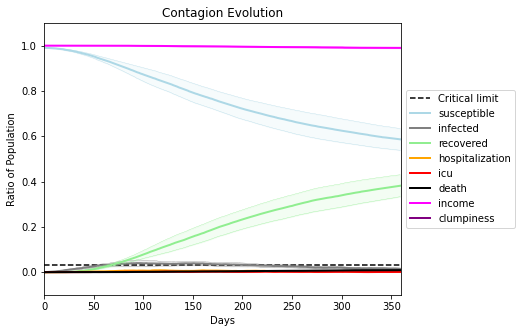

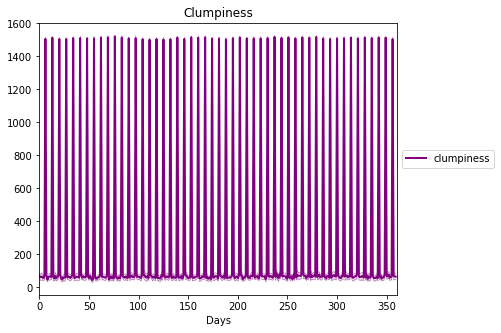

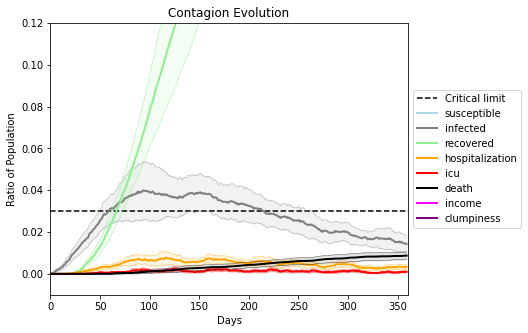

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9732, 8486, 632, 895, 8315, 6501, 8297, 5960, 6561, 9859, 3524, 7276, 8720, 6833, 5534, 7528, 3585, 8951, 1278, 2728]
Average similarity between family members is 0.16809053800149384 at temperature -0.2
Average similarity between family and home is 0.9998603754243123 at temperature -1
Average similarity between students and their classroom is 0.16083793256469295 at temperature -0.2
Average classroom occupancy is 1.6536312849162011 and number classrooms is 179
Average similarity between workers is 0.14854371850259215 at temperature -0.2
Average office occupancy is 3.1822660098522166 and number offices is 203
Average friend similarity for adults: 0.2059506548673944 for kids: 0.1943425403365097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.1681824939152806
avg restaurant similarity 0.10311139479023047
avg restaurant similarity -0.021608536667828037
avg restaurant similarity 0.1727703565872916
avg restaurant similarity -0.006700352744051272
avg restaurant similarity 0.1189693662118294
avg restaurant similarity 0.7406423924589295
avg restaurant similarity 0.19551986758735102
avg restaurant similarity -0.09052469944863821
avg restaurant similarity -0.08682665527876736
avg restaurant similarity -0.029620906985033682
avg restaurant similarity 0.18632838223276488
avg restaurant similarity 0.017979012004428918
avg restaurant similarity -0.080005085371179
avg restaurant similarity -0.10534690165456594
avg restaurant similarity -0.2199567142292621
avg restaurant similarity 0.3481728750649715
avg restaurant similarity 0.07112935236519674
avg restaurant similarity 0.3933445915322702
avg restaurant similarity -0.235032058548254
avg restaurant similarity 0.3527180832716086
avg restaurant similarity -0.0805

avg restaurant similarity 0.44238695974903525
avg restaurant similarity 0.051804279799698136
avg restaurant similarity 0.06699640017678937
avg restaurant similarity -0.02782815398679881
avg restaurant similarity 0.2288427038290518
avg restaurant similarity 0.03188808986055769
avg restaurant similarity -0.11725055745553072
avg restaurant similarity 0.10311139479023047
avg restaurant similarity 0.24951214738584115
avg restaurant similarity -0.35615805064242656
avg restaurant similarity -0.2649731655450556
avg restaurant similarity -0.4386557921601488
avg restaurant similarity 0.31558893368569585
avg restaurant similarity 0.0060741051514173645
avg restaurant similarity -0.35615805064242656
avg restaurant similarity 0.15119906069546984
avg restaurant similarity -0.13050498451551618
avg restaurant similarity 0.016697957654975455
avg restaurant similarity 0.004114056675810347
avg restaurant similarity 0.17118919351548575
avg restaurant similarity -0.007494363347238381
avg restaurant similari

avg restaurant similarity 0.18613864978753053
avg restaurant similarity 0.32146979518767893
avg restaurant similarity -0.09573704798437885
avg restaurant similarity 0.13441377342842373
avg restaurant similarity 0.07732399322162085
avg restaurant similarity -0.16080168402304168
avg restaurant similarity 0.19237549805069373
avg restaurant similarity 0.46516447284376716
avg restaurant similarity 0.3049817135530688
avg restaurant similarity 0.21827753872132988
avg restaurant similarity 0.16104475639014698
avg restaurant similarity 0.06800208469277289
avg restaurant similarity -0.3581552992340621
avg restaurant similarity 0.3362881955871269
avg restaurant similarity 0.2606791367518853
avg restaurant similarity 0.1326816036786011
avg restaurant similarity 0.48585037617066396
avg restaurant similarity 0.490271232830632
avg restaurant similarity 0.10821084258937971
avg restaurant similarity -0.04082534972165147
avg restaurant similarity 0.6648984358278811
avg restaurant similarity 0.2011642548

avg restaurant similarity 0.4596830840534777
avg restaurant similarity 0.13874286270367375
avg restaurant similarity 0.3567969535026656
Average similarity between family members is 0.1742791842769664 at temperature -0.2
Average similarity between family and home is 0.9998502126983042 at temperature -1
Average similarity between students and their classroom is 0.1698974890014466 at temperature -0.2
Average classroom occupancy is 1.6571428571428573 and number classrooms is 175
Average similarity between workers is 0.1555951946229766 at temperature -0.2
Average office occupancy is 3.215686274509804 and number offices is 204
Average friend similarity for adults: 0.21055551478408557 for kids: 0.20525398452306173
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity -0.010283194141508975
avg restaurant similarity -0.21926274281775024
avg restaurant similarity 0.13716820683586528
avg restaurant similarity 0.2007968826826952
avg restaurant similarity 0.41155774880876467
avg restaurant similarity 0.010694659139080243
avg restaurant similarity 0.3356327647060229
avg restaurant similarity 0.07300565861596697
avg restaurant similarity 0.330152251389833
avg restaurant similarity 0.22029906468858115
avg restaurant similarity 0.20298107114438765
avg restaurant similarity -0.2667799498909653
avg restaurant similarity 0.09269695918777754
avg restaurant similarity 0.22521803967212217
avg restaurant similarity 0.4329613006446434
avg restaurant similarity 0.015658386285628424
avg restaurant similarity -0.10068808877702942
avg restaurant similarity 0.19019813504495783
avg restaurant similarity 0.18563626123719157
avg restaurant similarity 0.4118316464105561
avg restaurant similarity -0.08345312665693791
avg restaurant similarity 0.40626

avg restaurant similarity 0.4299726985464246
avg restaurant similarity 0.5139747815243076
Average similarity between family members is 0.18045259248867657 at temperature -0.2
Average similarity between family and home is 0.9998405177717725 at temperature -1
Average similarity between students and their classroom is 0.1501993861934866 at temperature -0.2
Average classroom occupancy is 1.6021505376344085 and number classrooms is 186
Average similarity between workers is 0.14457587721172682 at temperature -0.2
Average office occupancy is 3.1881188118811883 and number offices is 202
Average friend similarity for adults: 0.2135372909537051 for kids: 0.2200497120315072
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.20543777052813222
avg restaurant similarity 0.09258838223821801
avg restaurant similarity -0.159078195082974
avg restaurant similarity -0.09859616403557303
avg restaurant similarity 0.01506187468766698
avg restaurant similarity 0.0024401352671911056
avg restaurant similarity -0.27451963508550714
avg restaurant similarity -0.08741679115858524
avg restaurant similarity -0.05408331255465243
avg restaurant similarity 0.4866728482865674
avg restaurant similarity 0.06900349874484898
avg restaurant similarity -0.08850586053352186
avg restaurant similarity 0.5463502428230844
avg restaurant similarity 0.003514668020681358
avg restaurant similarity 0.3428959797156387
avg restaurant similarity -0.20572594004853034
avg restaurant similarity 0.012600314595771716
avg restaurant similarity -0.02693354588117282
avg restaurant similarity 0.22628743775413476
avg restaurant similarity 0.2512121854505386
avg restaurant similarity 0.2564987011503409
avg restaurant similarity 0.4

avg restaurant similarity 0.6756767392895688
avg restaurant similarity 0.19782523893338602
avg restaurant similarity 0.21546211432875984
avg restaurant similarity 0.12450720117245201
avg restaurant similarity 0.13349163465183736
Average similarity between family members is 0.18180911998505184 at temperature -0.2
Average similarity between family and home is 0.9998571968396793 at temperature -1
Average similarity between students and their classroom is 0.2016419136039328 at temperature -0.2
Average classroom occupancy is 1.7039106145251397 and number classrooms is 179
Average similarity between workers is 0.1476769354483983 at temperature -0.2
Average office occupancy is 3.237623762376238 and number offices is 202
Average friend similarity for adults: 0.21046755808712198 for kids: 0.22002023805415485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people alloca

avg restaurant similarity -0.017217929873660737
avg restaurant similarity 0.02013522732351389
avg restaurant similarity -0.3978336686028521
avg restaurant similarity 0.4545588818148625
avg restaurant similarity 0.08944707889234582
avg restaurant similarity 0.10127827313259856
avg restaurant similarity 0.30338503285886426
avg restaurant similarity -0.00647328321493798
avg restaurant similarity 0.43177298697372474
avg restaurant similarity 0.09764245220666533
avg restaurant similarity -0.051068469062421934
avg restaurant similarity 0.18193844835391898
avg restaurant similarity 0.4102182321278478
avg restaurant similarity -0.15657068001703262
avg restaurant similarity 0.4587606010079212
avg restaurant similarity 0.20616997102935586
avg restaurant similarity 0.3168718525829447
avg restaurant similarity 0.20178031723598686
avg restaurant similarity -0.013534927669914917
avg restaurant similarity 0.3207440793107638
avg restaurant similarity 0.4153347363430244
avg restaurant similarity 0.1081

avg restaurant similarity 0.1582685909048837
avg restaurant similarity 0.28368740254178815
avg restaurant similarity 0.0722787681834053
avg restaurant similarity 0.021414211491713908
avg restaurant similarity -0.4144938448259319
avg restaurant similarity 0.12444296442596019
avg restaurant similarity 0.24070251363180453
avg restaurant similarity 0.14041363580284827
avg restaurant similarity -0.24433398718489094
avg restaurant similarity -0.054100530508922204
avg restaurant similarity 0.5965882729691553
avg restaurant similarity -0.1024791048225743
avg restaurant similarity 0.25966434051259396
avg restaurant similarity -0.4508051643206884
avg restaurant similarity 0.3097439737490155
avg restaurant similarity -0.1158058896599987
avg restaurant similarity 0.17402115000079607
avg restaurant similarity 0.5164989634908008
avg restaurant similarity 0.2369341949339037
avg restaurant similarity -0.011810806135946143
avg restaurant similarity 0.0815928514857648
avg restaurant similarity -0.077611

avg restaurant similarity -0.12255549117682518
avg restaurant similarity -0.05326500281391994
avg restaurant similarity 0.22648430404309663
avg restaurant similarity 0.07710083732356254
avg restaurant similarity 0.03517721993694893
avg restaurant similarity 0.3009365104139206
avg restaurant similarity 0.11381638621011894
avg restaurant similarity -0.11165842815301222
avg restaurant similarity -0.04584650459636677
avg restaurant similarity 0.03517721993694893
avg restaurant similarity 0.43863140678386014
avg restaurant similarity 0.3862873159976112
avg restaurant similarity -0.18900198276616678
avg restaurant similarity 0.5879218740823087
avg restaurant similarity 0.47932230609943033
avg restaurant similarity 0.16463829242903036
avg restaurant similarity 0.4659260663925184
avg restaurant similarity -0.12768189257161713
avg restaurant similarity 0.1017476539798117
avg restaurant similarity 0.06678952982541045
avg restaurant similarity -0.05873903993130848
avg restaurant similarity 0.1450

Average similarity between workers is 0.13650888345770268 at temperature -0.2
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.20947396229093834 for kids: 0.22532518485095415
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 21 people.
Total of

avg restaurant similarity 0.09546637033872606
avg restaurant similarity -0.13841808932690883
avg restaurant similarity 0.34762530810096365
avg restaurant similarity 0.06647855757699718
avg restaurant similarity 0.551040227118325
avg restaurant similarity 0.13361009092060125
avg restaurant similarity -0.281148301361638
avg restaurant similarity 0.191812348359272
avg restaurant similarity -0.11749668755239255
avg restaurant similarity -0.09284680794250351
avg restaurant similarity -0.25369749344722375
avg restaurant similarity 0.13468839893225473
avg restaurant similarity 0.009541027802114512
avg restaurant similarity 0.32317378746073117
avg restaurant similarity -0.07948480785528134
avg restaurant similarity -0.020549816456098075
avg restaurant similarity -0.10416488749448359
avg restaurant similarity 0.5363705066418659
avg restaurant similarity -0.12851629234208206
avg restaurant similarity 0.044199353707714994
avg restaurant similarity -0.14815550998666852
avg restaurant similarity -0

avg restaurant similarity 0.15956611430406595
avg restaurant similarity 0.09983630217468784
avg restaurant similarity 0.07375483716130023
avg restaurant similarity 0.2797489769568167
avg restaurant similarity 0.21270935743981312
avg restaurant similarity 0.10329700667123827
avg restaurant similarity -0.20168800113696206
avg restaurant similarity 0.248666697829409
avg restaurant similarity 0.08731435663695702
avg restaurant similarity 0.049502738529510246
avg restaurant similarity 0.19425691839206077
avg restaurant similarity 0.09420911819757258
avg restaurant similarity 0.28639040925789716
avg restaurant similarity 0.03650010326333016
avg restaurant similarity 0.08248363319583134
avg restaurant similarity 0.20186090211640836
avg restaurant similarity 0.07114681754971451
avg restaurant similarity -0.2577722999868862
avg restaurant similarity 0.21270935743981312
avg restaurant similarity 0.09026640099540108
avg restaurant similarity 0.032715599623312885
avg restaurant similarity 0.322132

avg restaurant similarity 0.3040635026482451
avg restaurant similarity -0.37391404264792494
avg restaurant similarity 0.11348871976545831
avg restaurant similarity -0.25325728618806087
avg restaurant similarity 0.07494918076054127
avg restaurant similarity -0.40270019677618174
avg restaurant similarity -0.08107811203124969
avg restaurant similarity -0.25325728618806087
avg restaurant similarity 0.4558979807989991
avg restaurant similarity -0.24492958470160925
avg restaurant similarity 0.04889513282865604
avg restaurant similarity 0.3474593355480639
avg restaurant similarity 0.2719335539670075
avg restaurant similarity -0.255120462575326
avg restaurant similarity -0.2421548641205491
avg restaurant similarity 0.16616859137634507
avg restaurant similarity 0.18291975358517978
avg restaurant similarity -0.08886018050079802
avg restaurant similarity -0.05420760226392582
avg restaurant similarity 0.08764296191838067
avg restaurant similarity -0.26706553225606794
avg restaurant similarity -0.3

avg restaurant similarity 0.08976765303732973
avg restaurant similarity 0.5032490448245611
avg restaurant similarity 0.06043445025913281
avg restaurant similarity 0.07816574739420083
avg restaurant similarity 0.13616828464537256
avg restaurant similarity 0.28610081840835444
avg restaurant similarity 0.2697403729431625
avg restaurant similarity -0.44520843003551047
avg restaurant similarity 0.0036026205777789713
avg restaurant similarity -0.10049348971840473
avg restaurant similarity -0.03985421478355043
avg restaurant similarity -0.07304303432280915
avg restaurant similarity -0.182507954186808
avg restaurant similarity -0.2303732909031978
avg restaurant similarity 0.5038856151858508
avg restaurant similarity 0.45923277805727125
avg restaurant similarity 0.3942638111079507
avg restaurant similarity 0.5365562210923811
avg restaurant similarity -0.0705150072590504
avg restaurant similarity 0.20670725273150986
avg restaurant similarity 0.1299397503291011
avg restaurant similarity 0.2889518

avg restaurant similarity 0.20472633730134004
avg restaurant similarity 0.4212300825000637
avg restaurant similarity 0.0518435266142019
avg restaurant similarity -0.10547694867734991
avg restaurant similarity 0.3079106927902712
avg restaurant similarity 0.3929013647483071
avg restaurant similarity 0.37965981723389086
avg restaurant similarity -0.08484887871711805
avg restaurant similarity 0.10043541506481604
avg restaurant similarity 0.2350716363358006
avg restaurant similarity -0.44520843003551047
Average similarity between family members is 0.1777256034116174 at temperature -0.2
Average similarity between family and home is 0.999863704542477 at temperature -1
Average similarity between students and their classroom is 0.17521969874297422 at temperature -0.2
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.1571569480307672 at temperature -0.2
Average office occupancy is 3.345 and number offices is 200
Average friend s

avg restaurant similarity 0.3524374495594822
avg restaurant similarity -0.18229425611111455
avg restaurant similarity 0.17911377434501516
avg restaurant similarity 0.4091398969143697
avg restaurant similarity 0.3212773477238944
avg restaurant similarity -0.3447312881800534
avg restaurant similarity 0.2657053081781841
avg restaurant similarity 0.10195686786922958
avg restaurant similarity 0.15740829081538366
avg restaurant similarity -0.06689587251426486
avg restaurant similarity 0.18315590514123065
avg restaurant similarity 0.059294439462407325
avg restaurant similarity -0.21428792362078425
avg restaurant similarity 0.059294439462407325
avg restaurant similarity 0.02954856387852884
avg restaurant similarity 0.14546048465581013
avg restaurant similarity -0.032416701627512895
avg restaurant similarity -0.11726318178846001
avg restaurant similarity -0.17100362148882514
avg restaurant similarity 0.14932293443109834
avg restaurant similarity 0.003018524336809575
avg restaurant similarity 0.

Average friend similarity for adults: 0.21531338230650532 for kids: 0.2134089266228747
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated 

avg restaurant similarity -0.023384053310153436
avg restaurant similarity -0.07792975771319491
avg restaurant similarity 0.5101425782551259
avg restaurant similarity -0.09637192787869049
avg restaurant similarity -0.12237988372789013
avg restaurant similarity -0.10209875385517417
avg restaurant similarity 0.28540562392922053
avg restaurant similarity -0.15929693505429193
avg restaurant similarity 0.24126969081251842
avg restaurant similarity 0.2517816695243741
avg restaurant similarity 0.10243482405688052
avg restaurant similarity -0.03532188781722835
avg restaurant similarity 0.08460929153584104
avg restaurant similarity 0.5979976368989302
avg restaurant similarity 0.1362469038058282
avg restaurant similarity -0.051724477077563516
avg restaurant similarity -0.042349590989455656
avg restaurant similarity 0.19882487975965102
avg restaurant similarity -0.12153421179869174
avg restaurant similarity 0.059987075249350125
avg restaurant similarity -0.1541609278641069
avg restaurant similarit

avg restaurant similarity 0.04480301860688579
avg restaurant similarity -0.10209875385517417
avg restaurant similarity 0.3027086429651532
avg restaurant similarity -0.12508839577099057
avg restaurant similarity 0.10605750198277568
avg restaurant similarity 0.09705303845714039
avg restaurant similarity 0.020840966992886463
avg restaurant similarity -0.02119733650414001
avg restaurant similarity 0.24760318948185317
avg restaurant similarity -0.01863898649691493
avg restaurant similarity 0.006411717103797232
avg restaurant similarity 0.2392614750361636
avg restaurant similarity -0.14396352617493516
avg restaurant similarity -0.06643720994867995
avg restaurant similarity 0.22116195449746825
avg restaurant similarity -0.4791278321659773
avg restaurant similarity -0.237538967314614
avg restaurant similarity -0.020963056301857935
avg restaurant similarity -0.04655460215420044
avg restaurant similarity -0.020963056301857935
avg restaurant similarity 0.38564388105606645
avg restaurant similarit

avg restaurant similarity 0.36656815020430483
avg restaurant similarity -0.30743154021703245
avg restaurant similarity -0.09517780573533714
avg restaurant similarity -0.3051915751383334
avg restaurant similarity 0.5602592636489481
avg restaurant similarity 0.19425185952804455
avg restaurant similarity -0.04642885480063969
avg restaurant similarity 0.13876900692013175
avg restaurant similarity 0.12780790449627333
avg restaurant similarity -0.2823496792688817
avg restaurant similarity 0.009648884793833648
avg restaurant similarity 0.3306240151260011
avg restaurant similarity -0.03511944225578291
avg restaurant similarity -0.009278402630123181
avg restaurant similarity -0.2060697887596855
avg restaurant similarity -0.1236766464078151
avg restaurant similarity -0.27212345612792765
avg restaurant similarity 0.028567527795510902
avg restaurant similarity -0.1784152518550327
avg restaurant similarity -0.2404216868272055
avg restaurant similarity -0.04439577648088029
avg restaurant similarity 

avg restaurant similarity 0.0063413053469919545
avg restaurant similarity -0.18230387902663678
avg restaurant similarity 0.19649379873757394
avg restaurant similarity 0.1784108844483055
avg restaurant similarity 0.19363633193437724
avg restaurant similarity 0.17681459861738008
Average similarity between family members is 0.17187361338381035 at temperature -0.2
Average similarity between family and home is 0.9998390319550828 at temperature -1
Average similarity between students and their classroom is 0.16163114082524405 at temperature -0.2
Average classroom occupancy is 1.6 and number classrooms is 180
Average similarity between workers is 0.12437417658717476 at temperature -0.2
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.2094854716765517 for kids: 0.21116106271926516
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 

avg restaurant similarity 0.048889006243540006
avg restaurant similarity 0.0540393865082712
avg restaurant similarity 0.054484860037093796
avg restaurant similarity 0.2617370577092788
avg restaurant similarity 0.24739542074605247
avg restaurant similarity -0.17123746372832754
avg restaurant similarity -0.010150263394953507
avg restaurant similarity -0.2374954549532274
avg restaurant similarity 0.04672787864291907
avg restaurant similarity 0.0892617512012103
avg restaurant similarity 0.1968234109431662
avg restaurant similarity 0.21678803152227843
avg restaurant similarity 0.3878358984461712
avg restaurant similarity 0.38486176622067303
avg restaurant similarity -0.008423279990220193
avg restaurant similarity 0.25470888495902344
avg restaurant similarity 0.11225416657871916
avg restaurant similarity -0.13320940767445844
avg restaurant similarity 0.3684566050920434
avg restaurant similarity 0.33699191504633963
avg restaurant similarity 0.19639356404180694
avg restaurant similarity -0.103

avg restaurant similarity -0.02084749366037942
avg restaurant similarity -0.08545286733214787
avg restaurant similarity 0.35889473467154676
avg restaurant similarity 0.6508451712885721
avg restaurant similarity 0.22791928624747043
avg restaurant similarity -0.17278696942528904
avg restaurant similarity 0.19661750039255582
Average similarity between family members is 0.18331374030026754 at temperature -0.2
Average similarity between family and home is 0.9998433607237969 at temperature -1
Average similarity between students and their classroom is 0.18559654544881876 at temperature -0.2
Average classroom occupancy is 1.6263736263736264 and number classrooms is 182
Average similarity between workers is 0.1267345435459297 at temperature -0.2
Average office occupancy is 3.2413793103448274 and number offices is 203
Average friend similarity for adults: 0.21442086471343252 for kids: 0.21092441274074644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.20736619907371917
avg restaurant similarity 0.24862625639187316
avg restaurant similarity 0.12827183668624842
avg restaurant similarity -0.305246758845151
avg restaurant similarity -0.03683134097631468
avg restaurant similarity 0.255023728999833
avg restaurant similarity 0.40746234122919983
avg restaurant similarity -0.05168328094265415
avg restaurant similarity 0.1863811522957166
avg restaurant similarity 0.17906277918451136
avg restaurant similarity -0.22860582136938878
avg restaurant similarity -0.12308409818534294
avg restaurant similarity 0.18706553412522905
avg restaurant similarity 0.044706896883637604
avg restaurant similarity 0.18551303580949025
avg restaurant similarity 0.3838797818131265
avg restaurant similarity -0.17076851206076332
avg restaurant similarity 0.10571390704995864
avg restaurant similarity 0.11932950379207573
avg restaurant similarity 0.22603226961390743
avg restaurant similarity 0.5418856588551166
avg restaurant similarity -0.19433

avg restaurant similarity 0.1729684767941759
avg restaurant similarity 0.3751800073979229
avg restaurant similarity 0.23362584294174982
avg restaurant similarity 0.4048450772874058
avg restaurant similarity 0.028555863316267173
avg restaurant similarity 0.11121859663951525
Average similarity between family members is 0.1825515220094222 at temperature -0.2
Average similarity between family and home is 0.9998594982147118 at temperature -1
Average similarity between students and their classroom is 0.17418715379635663 at temperature -0.2
Average classroom occupancy is 1.521978021978022 and number classrooms is 182
Average similarity between workers is 0.14492661221957126 at temperature -0.2
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.20967303089952788 for kids: 0.2018194288113136
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 peo

avg restaurant similarity -0.05728119949206853
avg restaurant similarity -0.06531684091365272
avg restaurant similarity 0.013412493843745932
avg restaurant similarity 0.23558588013394866
avg restaurant similarity -0.22176375098357037
avg restaurant similarity 0.048074598613925455
avg restaurant similarity 0.0677639184686542
avg restaurant similarity 0.34483449087309753
avg restaurant similarity 0.33703332962863614
avg restaurant similarity 0.15276745054321883
avg restaurant similarity 0.00356074201377643
avg restaurant similarity -0.0470544292696407
avg restaurant similarity 0.3694245493648635
avg restaurant similarity 0.09184393985205966
avg restaurant similarity 0.2720471008927335
avg restaurant similarity -0.04777128334179253
avg restaurant similarity 0.05776455750040444
avg restaurant similarity 0.0412135261327128
avg restaurant similarity -0.019511385009424134
avg restaurant similarity 0.09863966211109718
avg restaurant similarity 0.30539237514446105
avg restaurant similarity 0.20

avg restaurant similarity 0.3283340405719666
avg restaurant similarity -0.10740861619479941
avg restaurant similarity 0.0790962862479843
avg restaurant similarity 0.19112769679068883
avg restaurant similarity 0.18722009108367804
avg restaurant similarity 0.08059961356769295
avg restaurant similarity 0.3055618210929568
avg restaurant similarity -0.04892913225149798
avg restaurant similarity 0.23892276741603574
avg restaurant similarity -0.0883586045555562
avg restaurant similarity 0.24636024173524973
avg restaurant similarity 0.06405867663646339
avg restaurant similarity 0.3636165526442646
avg restaurant similarity 0.10337025123680149
avg restaurant similarity -0.16838390464343772
avg restaurant similarity 0.1624225060358959
avg restaurant similarity 0.20574441392968446
avg restaurant similarity 0.42771189728908793
avg restaurant similarity 0.01976078666489913
avg restaurant similarity 0.02880450681208431
avg restaurant similarity 0.05872739163026716
avg restaurant similarity -0.0348645

avg restaurant similarity 0.005499406541372834
avg restaurant similarity 0.12133492131407751
avg restaurant similarity -0.11713462205259118
avg restaurant similarity -0.08894461737324201
avg restaurant similarity -0.19827474149665575
avg restaurant similarity 0.20524369291054848
avg restaurant similarity 0.20312507164658103
avg restaurant similarity -0.019257690054871608
avg restaurant similarity 0.10752295988453539
avg restaurant similarity 0.21585551405661632
avg restaurant similarity 0.5353628388989415
avg restaurant similarity 0.09186566060821122
avg restaurant similarity 0.21253958565865086
avg restaurant similarity 0.20167929284994915
avg restaurant similarity -0.028559832973443527
avg restaurant similarity 0.04064847840688167
avg restaurant similarity -0.07748295172492048
avg restaurant similarity 0.42503422621787684
avg restaurant similarity -0.33363120048172024
avg restaurant similarity 0.1952407964580006
avg restaurant similarity -0.13508537238482965
avg restaurant similarity

avg restaurant similarity -0.0620077107849171
avg restaurant similarity -0.03245621820015197
avg restaurant similarity 0.06505899537304594
avg restaurant similarity 0.1349676785552022
avg restaurant similarity 0.11407933496002469
avg restaurant similarity -0.29920254354163534
avg restaurant similarity -0.01388439792039222
avg restaurant similarity 0.1153757239980408
avg restaurant similarity 0.20833018498488856
avg restaurant similarity 0.03555789510688562
avg restaurant similarity 0.013563579344997885
avg restaurant similarity 0.012782695131371674
avg restaurant similarity 0.12399905933843802
avg restaurant similarity -0.1047577315149626
avg restaurant similarity -0.018878131466950478
avg restaurant similarity -0.017122246768913642
avg restaurant similarity -0.08208497107243068
avg restaurant similarity 0.3274768793956137
avg restaurant similarity 0.05182925241591027
avg restaurant similarity 0.09130463284272197
avg restaurant similarity 0.11237896189595856
avg restaurant similarity 0

avg restaurant similarity 0.004666400231726528
avg restaurant similarity -0.10733419427748522
avg restaurant similarity 0.15664375565534475
avg restaurant similarity 0.3121821359120317
avg restaurant similarity -0.1061408604229879
avg restaurant similarity 0.08191111931212071
avg restaurant similarity -0.10733419427748522
avg restaurant similarity -0.04339234736129524
avg restaurant similarity 0.11257971439486252
avg restaurant similarity -0.09402542075828144
avg restaurant similarity 0.20302513061174282
avg restaurant similarity 0.2559229710355904
avg restaurant similarity 0.19981356339497564
avg restaurant similarity 0.204111917969243
avg restaurant similarity -0.10733419427748522
avg restaurant similarity 0.17649922314543934
avg restaurant similarity -0.2376771945738655
avg restaurant similarity -0.12703557581309213
avg restaurant similarity 0.3085735558822537
avg restaurant similarity -0.10733419427748522
avg restaurant similarity 0.08188737333713682
avg restaurant similarity 0.204

Average similarity between workers is 0.15752017792630113 at temperature -0.2
Average office occupancy is 3.2205882352941178 and number offices is 204
Average friend similarity for adults: 0.21735647070018171 for kids: 0.2188903716202335
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 

avg restaurant similarity 0.3286828464040688
avg restaurant similarity 0.392858406585735
avg restaurant similarity 0.07076896097918194
avg restaurant similarity 0.18406244373733713
avg restaurant similarity 0.08256272158487327
avg restaurant similarity -0.021857958751324444
avg restaurant similarity -0.17163147921954539
avg restaurant similarity 0.5633786070774854
avg restaurant similarity -0.11073160859595896
avg restaurant similarity 0.23142134579604734
avg restaurant similarity -0.03415491652040611
avg restaurant similarity 0.06934137953649272
avg restaurant similarity -0.15500697746870254
avg restaurant similarity 0.22867869039029304
avg restaurant similarity 0.03435847227898145
avg restaurant similarity 0.015265153757111793
avg restaurant similarity 0.502646212190696
avg restaurant similarity -0.2883643870705678
avg restaurant similarity 0.0557443638023951
avg restaurant similarity 0.043258181969854426
avg restaurant similarity -0.10033263341039529
avg restaurant similarity 0.0974

Average friend similarity for adults: 0.20871437728757916 for kids: 0.2150912930159888
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity 0.3592043658613431
avg restaurant similarity 0.13988347162292036
avg restaurant similarity 0.1990578840132715
avg restaurant similarity 0.08365881169548822
avg restaurant similarity -0.04697413559306755
avg restaurant similarity 0.08106603208090163
avg restaurant similarity -0.03179006307073441
avg restaurant similarity 0.021987175060366695
avg restaurant similarity 0.028413133251426123
avg restaurant similarity 0.2780688559135066
avg restaurant similarity 0.16134124001868078
avg restaurant similarity -0.13915988924998335
avg restaurant similarity 0.3254250775124058
avg restaurant similarity -0.23037336272512107
avg restaurant similarity 0.1161546806555409
avg restaurant similarity 0.14217452179728393
avg restaurant similarity -0.01637683972303551
avg restaurant similarity 0.25667460454100804
avg restaurant similarity 0.3313482441848279
avg restaurant similarity 0.013868225973867039
avg restaurant similarity 0.17188246098058618
avg restaurant similarity 0.1061

avg restaurant similarity -0.006563958565580258
avg restaurant similarity 0.13614331924278836
avg restaurant similarity 0.10987369735529931
avg restaurant similarity 0.3161754212351232
avg restaurant similarity -0.2830124462111748
avg restaurant similarity 0.2862111278471706
avg restaurant similarity 0.12342618122100486
avg restaurant similarity 0.32181695323866494
avg restaurant similarity -0.10693899564487228
avg restaurant similarity -0.019054867252241824
avg restaurant similarity 0.07899393681752237
avg restaurant similarity 0.7617589749246126
avg restaurant similarity 0.0940171424839569
avg restaurant similarity 0.007262171833146681
avg restaurant similarity 0.1639278555602166
avg restaurant similarity -0.1925611027672281
avg restaurant similarity -0.05363711719823683
avg restaurant similarity 0.21892959089358507
avg restaurant similarity 0.3123845563052176
avg restaurant similarity 0.10227638795540206
avg restaurant similarity 0.4202857459530121
avg restaurant similarity 0.121117

(<function dict.items>, <function dict.items>, <function dict.items>)

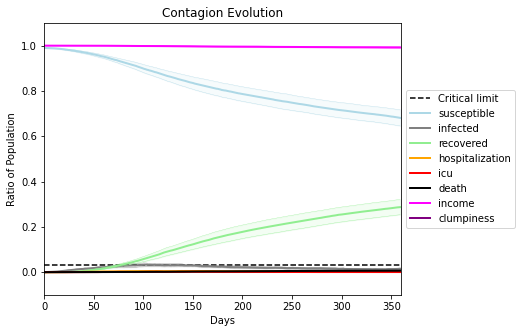

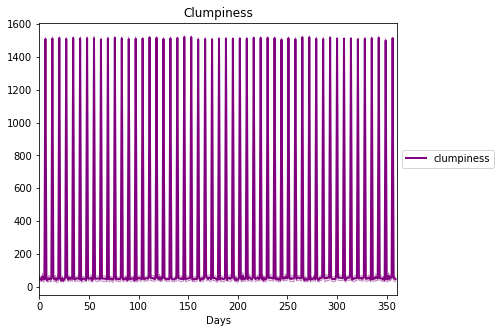

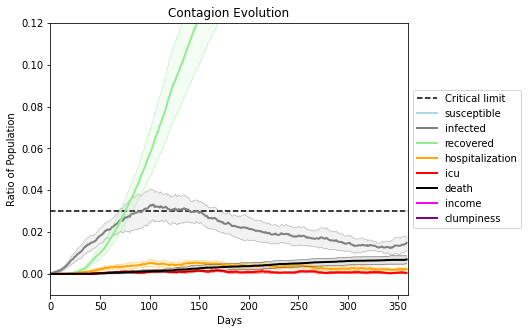

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9976, 5495, 5613, 2243, 9212, 9531, 7231, 395, 8392, 2797, 3434, 523, 7339, 6439, 2439, 7796, 564, 2392, 7964, 7368]
Average similarity between family members is 0.154740848119257 at temperature -0.1
Average similarity between family and home is 0.9998539903251269 at temperature -1
Average similarity between students and their classroom is 0.16389146050036402 at temperature -0.1
Average classroom occupancy is 1.593939393939394 and number classrooms is 165
Average similarity between workers is 0.14694276194724185 at temperature -0.1
Average office occupancy is 3.3448275862068964 and number offices is 203
Average friend similarity for adults: 0.21090016924773758 for kids: 0.20894556044513155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.3747542700374764
avg restaurant similarity 0.07915128989459658
avg restaurant similarity -0.2426648524097263
avg restaurant similarity 0.11334382644888065
avg restaurant similarity 0.5137007653962252
avg restaurant similarity 0.07751464973955176
avg restaurant similarity 0.2804854404798141
avg restaurant similarity 0.39908723438306076
avg restaurant similarity 0.3277983131240304
avg restaurant similarity -0.3246239718554016
avg restaurant similarity 0.8957840486768781
avg restaurant similarity 0.1654801030809346
avg restaurant similarity 0.0995812382701932
avg restaurant similarity -0.2310434230250261
avg restaurant similarity 0.3371713812047062
avg restaurant similarity 0.09117504790829284
avg restaurant similarity 0.24943884826292984
avg restaurant similarity -0.08515309532740932
avg restaurant similarity -0.11353906837932248
avg restaurant similarity 0.45988072131563223
avg restaurant similarity 0.27123293330354725
avg restaurant similarity 0.196276682523

Average similarity between family members is 0.17302369274997176 at temperature -0.1
Average similarity between family and home is 0.9998553440230791 at temperature -1
Average similarity between students and their classroom is 0.17580270315783933 at temperature -0.1
Average classroom occupancy is 1.6647398843930636 and number classrooms is 173
Average similarity between workers is 0.1431409960337666 at temperature -0.1
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.20823298470384347 for kids: 0.20768350236540387
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2

avg restaurant similarity -0.09977400386625895
avg restaurant similarity -0.05932010235634283
avg restaurant similarity -0.451009085332115
avg restaurant similarity 0.09155622711414164
avg restaurant similarity -0.19286022147446572
avg restaurant similarity -0.15978442575828866
avg restaurant similarity 0.2136059668616455
avg restaurant similarity 0.12967100317340166
avg restaurant similarity 0.16164175968510353
avg restaurant similarity -0.09847215843321495
avg restaurant similarity 0.14863888575381354
avg restaurant similarity -0.3152720766271272
avg restaurant similarity 0.019497608442041972
avg restaurant similarity 0.12683430745562002
avg restaurant similarity -0.05607020513238522
avg restaurant similarity 0.23551459123315155
avg restaurant similarity -0.14280866579104695
avg restaurant similarity 0.038885571115820416
avg restaurant similarity 0.26560391476770784
avg restaurant similarity 0.11055700952899457
avg restaurant similarity -0.001673489688410477
avg restaurant similarity

avg restaurant similarity -0.07981200143783104
avg restaurant similarity 0.2445835704094611
avg restaurant similarity -0.10986269497834047
avg restaurant similarity -0.05932010235634283
avg restaurant similarity 0.407983057359326
avg restaurant similarity 0.3700911726859939
avg restaurant similarity -0.05542751424677918
avg restaurant similarity 0.2772135385779702
avg restaurant similarity 0.2501466907636184
avg restaurant similarity 0.331416272477099
avg restaurant similarity 0.1153599216688698
avg restaurant similarity 0.13955530360013357
avg restaurant similarity 0.3684269525103909
avg restaurant similarity -0.09094358939545057
avg restaurant similarity -0.2836506372981762
avg restaurant similarity 0.31015384958090364
avg restaurant similarity 0.42852607361598194
avg restaurant similarity 0.3028033856479708
avg restaurant similarity 0.05100961090782276
avg restaurant similarity -0.44313935269706317
avg restaurant similarity 0.00882423850142236
avg restaurant similarity 0.19775195608

avg restaurant similarity 0.21161737609342768
avg restaurant similarity 0.07718554668673011
avg restaurant similarity 0.3305863704655868
avg restaurant similarity -0.32394052476014135
avg restaurant similarity 0.29727301350493085
avg restaurant similarity 0.133205377148657
avg restaurant similarity -0.32394052476014135
avg restaurant similarity -0.04620457642372161
avg restaurant similarity -0.04224326506978925
avg restaurant similarity -0.28992668245593917
avg restaurant similarity -0.32394052476014135
avg restaurant similarity -0.23662811429230168
avg restaurant similarity 0.007968448984233018
avg restaurant similarity 0.13822414309522443
avg restaurant similarity 0.060147209312208336
avg restaurant similarity 0.2530249429866228
avg restaurant similarity 0.13350716430185902
avg restaurant similarity 0.378429615855941
avg restaurant similarity -0.3796974320399318
avg restaurant similarity 0.06900468197739837
avg restaurant similarity 0.32840371935730117
avg restaurant similarity 0.195

avg restaurant similarity -0.08492818456955342
avg restaurant similarity 0.2894925700391541
avg restaurant similarity -0.09251157116659231
avg restaurant similarity 0.26514238070397766
avg restaurant similarity 0.1875235701914671
avg restaurant similarity 0.11709460744282513
avg restaurant similarity 0.030653433961898888
avg restaurant similarity 0.003944914079798301
avg restaurant similarity 0.619726470071136
avg restaurant similarity -0.11859959720107596
avg restaurant similarity 0.2863377226068697
avg restaurant similarity -0.20736054593901188
avg restaurant similarity -0.034736907349173674
avg restaurant similarity 0.050985494273839305
avg restaurant similarity 0.09574617405392931
avg restaurant similarity 0.4736751254748569
avg restaurant similarity 0.26041647152202224
avg restaurant similarity 0.061707604222386955
avg restaurant similarity 0.2543677413091701
avg restaurant similarity 0.6998707666196268
avg restaurant similarity 0.10961318958410915
avg restaurant similarity 0.0011

avg restaurant similarity 0.27137497585984627
avg restaurant similarity -0.21893838264522184
avg restaurant similarity 0.35778415114931106
avg restaurant similarity 0.3239539507017139
avg restaurant similarity 0.14632188482253733
avg restaurant similarity 0.44109959891672845
avg restaurant similarity -0.013234423377612686
avg restaurant similarity -0.0365992806485087
avg restaurant similarity 0.1932763786236825
avg restaurant similarity 0.18216242200265542
avg restaurant similarity 0.03241061737776682
avg restaurant similarity 0.17610125714306857
avg restaurant similarity -0.259201644184434
avg restaurant similarity 0.2505881369419641
avg restaurant similarity -0.008922675400839394
avg restaurant similarity 0.22876794760559027
avg restaurant similarity 0.17453428737911897
avg restaurant similarity 0.28760395128248417
avg restaurant similarity 0.42154921896529934
avg restaurant similarity 0.40218228929345257
avg restaurant similarity 0.23662165530730606
avg restaurant similarity -0.1775

avg restaurant similarity -0.022097342492733846
avg restaurant similarity -0.008922675400839394
avg restaurant similarity 0.057303943445885665
avg restaurant similarity 0.37069006171707497
avg restaurant similarity 0.26904515251020183
avg restaurant similarity 0.08187459548800408
avg restaurant similarity 0.13439590410476054
avg restaurant similarity -0.21029600725426897
avg restaurant similarity 0.8093077285151029
avg restaurant similarity 0.17092996157878182
avg restaurant similarity 0.2051561720211315
avg restaurant similarity -0.09309820314557929
avg restaurant similarity 0.02852924093739744
avg restaurant similarity 0.17263042011861596
avg restaurant similarity 0.8093077285151029
avg restaurant similarity -0.008922675400839394
avg restaurant similarity 0.40218228929345257
avg restaurant similarity 0.01620718291971865
avg restaurant similarity 0.30586124030061246
avg restaurant similarity 0.14998236914228766
avg restaurant similarity -0.033257930630748875
avg restaurant similarity 

avg restaurant similarity 0.5607122805565159
avg restaurant similarity -0.24895950232275502
avg restaurant similarity 0.15180396408287306
avg restaurant similarity 0.335874948074515
avg restaurant similarity 0.17814139054608744
avg restaurant similarity 0.035043938519183984
avg restaurant similarity 0.21334912529919528
avg restaurant similarity 0.10164082057548118
avg restaurant similarity -0.4028441982608972
avg restaurant similarity 0.39451013448145733
avg restaurant similarity -0.23217367587939491
avg restaurant similarity 0.8782850100412106
avg restaurant similarity 0.09989355395718721
avg restaurant similarity 0.14926475967736447
avg restaurant similarity -0.05868138168848678
avg restaurant similarity -0.26205376937456104
avg restaurant similarity 0.018544750031130652
avg restaurant similarity -0.030235204231987743
avg restaurant similarity 0.28927312599375316
avg restaurant similarity 0.43324001390777644
avg restaurant similarity 0.27448715749671454
avg restaurant similarity 0.17

avg restaurant similarity 0.1941957381801733
avg restaurant similarity 0.2314606232841968
avg restaurant similarity 0.48542808909600116
avg restaurant similarity 0.4367124012290471
avg restaurant similarity 0.18531199289744352
avg restaurant similarity 0.08055307432331582
avg restaurant similarity 0.19190507879349797
avg restaurant similarity 0.425931179765752
avg restaurant similarity 0.5607122805565159
avg restaurant similarity 0.48436916389778667
avg restaurant similarity 0.11542174526165348
Average similarity between family members is 0.17146844458621693 at temperature -0.1
Average similarity between family and home is 0.999857576654085 at temperature -1
Average similarity between students and their classroom is 0.18590647343224564 at temperature -0.1
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.1604325121021258 at temperature -0.1
Average office occupancy is 3.318407960199005 and number offices is 201
Averag

avg restaurant similarity 0.03798796056144099
avg restaurant similarity 0.06356874120463134
avg restaurant similarity 0.06474134417153415
avg restaurant similarity 0.3678003774702742
avg restaurant similarity 0.23297589867781884
avg restaurant similarity 0.03663503539497663
avg restaurant similarity 0.32506158290736464
avg restaurant similarity -0.018456967125437474
avg restaurant similarity 0.5013324348570004
avg restaurant similarity 0.17173934039390165
avg restaurant similarity 0.004345903333489248
avg restaurant similarity 0.09379621449518799
avg restaurant similarity 0.031909624845750495
avg restaurant similarity -0.0420496036729931
avg restaurant similarity -0.019618662879170343
avg restaurant similarity 0.16680268508368445
avg restaurant similarity 0.12932009060808253
avg restaurant similarity 0.29305148969487843
avg restaurant similarity -0.007807826036914887
avg restaurant similarity -0.46897042176459025
avg restaurant similarity -0.2056668968011754
avg restaurant similarity 0

avg restaurant similarity -0.07059880478603553
avg restaurant similarity 0.2655312368202212
avg restaurant similarity 0.21435210596439674
avg restaurant similarity 0.3005592498804682
avg restaurant similarity 0.0794020585096751
avg restaurant similarity 0.05387016226724438
avg restaurant similarity 0.0026765908183214726
avg restaurant similarity 0.09917851895809107
avg restaurant similarity 0.139737876360509
avg restaurant similarity 0.39131337293670965
avg restaurant similarity -0.2040552035420948
avg restaurant similarity 0.06851081139384152
avg restaurant similarity -0.06064130917346912
avg restaurant similarity 0.7655552384938915
avg restaurant similarity 0.08199427136227212
avg restaurant similarity 0.170041729530279
avg restaurant similarity 0.03877402629679977
avg restaurant similarity -0.19019664687845098
avg restaurant similarity -0.2190826056365078
avg restaurant similarity -0.3520125626200641
avg restaurant similarity -0.0768006500823562
avg restaurant similarity -0.23848320

avg restaurant similarity 0.24277992680036176
avg restaurant similarity 0.027031976596821772
avg restaurant similarity 0.4833780235966505
avg restaurant similarity 0.1440149156273046
avg restaurant similarity 0.33242741187101976
avg restaurant similarity -0.1192225179222732
avg restaurant similarity 0.10322843672706829
avg restaurant similarity -0.17280473497490717
avg restaurant similarity -0.14315454846441994
avg restaurant similarity 0.02012563647183175
avg restaurant similarity -0.026163514562523055
avg restaurant similarity -0.01265389678150175
avg restaurant similarity -0.09978021650269109
avg restaurant similarity 0.19203082846043412
avg restaurant similarity 0.24778885253277463
avg restaurant similarity 0.2978706575217086
avg restaurant similarity 0.28317277344446024
avg restaurant similarity -0.1878720396817112
avg restaurant similarity 0.06618849737515656
avg restaurant similarity 0.13429103175617568
avg restaurant similarity 0.06340715278260062
avg restaurant similarity -0.0

avg restaurant similarity 0.08813571686944616
avg restaurant similarity 0.25059447197904927
avg restaurant similarity 0.31385491114007624
avg restaurant similarity 0.08813571686944616
avg restaurant similarity 0.5476718027620517
avg restaurant similarity -0.01083829894657725
avg restaurant similarity 0.14504402076601217
avg restaurant similarity 0.11939254425292148
avg restaurant similarity -0.0011094687527408026
avg restaurant similarity 0.6437628037536884
avg restaurant similarity 0.10446605391110086
avg restaurant similarity 0.17976416252501756
avg restaurant similarity 0.08813571686944616
avg restaurant similarity 0.06375261677782701
avg restaurant similarity 0.29099811752516824
avg restaurant similarity -0.0361270441110307
avg restaurant similarity -0.3384087949648822
avg restaurant similarity 0.3242203394949959
avg restaurant similarity 0.07686058436165179
avg restaurant similarity -0.16590649672791022
avg restaurant similarity 0.17630057273175975
avg restaurant similarity -0.376

avg restaurant similarity -0.15485710134330366
avg restaurant similarity 0.01908992314634981
avg restaurant similarity -0.02712228350952462
avg restaurant similarity 0.17827672620855503
avg restaurant similarity -0.14804161504984267
avg restaurant similarity -0.10304883404488077
avg restaurant similarity -0.07473627057284123
Average similarity between family members is 0.15410245278644327 at temperature -0.1
Average similarity between family and home is 0.99984847847716 at temperature -1
Average similarity between students and their classroom is 0.1787730235142528 at temperature -0.1
Average classroom occupancy is 1.6144578313253013 and number classrooms is 166
Average similarity between workers is 0.1530166383445854 at temperature -0.1
Average office occupancy is 3.2815533980582523 and number offices is 206
Average friend similarity for adults: 0.21151830450944686 for kids: 0.20898362855329128
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.2902995478565002
avg restaurant similarity -0.001039812505803827
avg restaurant similarity -0.3298749914796182
avg restaurant similarity 0.3760316596157935
avg restaurant similarity -0.1474148800866232
avg restaurant similarity 0.28649154036381136
avg restaurant similarity 0.09030216900469973
avg restaurant similarity 0.051440109683956604
avg restaurant similarity -0.1332700470472016
avg restaurant similarity 0.33785184976911475
avg restaurant similarity 0.027375791119014597
avg restaurant similarity 0.3312465002155524
avg restaurant similarity 0.1555875757388178
avg restaurant similarity 0.06830186559390165
avg restaurant similarity -0.12772115693497965
avg restaurant similarity 0.03421348420318848
avg restaurant similarity -0.1332700470472016
avg restaurant similarity -0.1474148800866232
avg restaurant similarity -0.11895945445785563
avg restaurant similarity -0.03923996851092283
avg restaurant similarity -0.2824982226618751
avg restaurant similarity -0.05

avg restaurant similarity -0.18243967298507996
avg restaurant similarity 0.09153913348357587
avg restaurant similarity -0.04818419207532716
avg restaurant similarity -0.09087329296311161
avg restaurant similarity -0.6008890609217028
avg restaurant similarity -0.5616741327888692
avg restaurant similarity -0.061300199272400394
avg restaurant similarity 0.28649154036381136
avg restaurant similarity 0.3036513003456224
avg restaurant similarity 0.030999822614870592
avg restaurant similarity -0.13774609459309992
avg restaurant similarity -0.23512145384413194
avg restaurant similarity -0.10900924672694767
avg restaurant similarity 0.17253450332194753
avg restaurant similarity 0.0855613052011321
avg restaurant similarity 0.050916233004784754
avg restaurant similarity 0.28794121928624167
avg restaurant similarity -0.5616741327888692
avg restaurant similarity 0.14244557011223585
avg restaurant similarity -0.1332700470472016
avg restaurant similarity -0.017343266217248444
avg restaurant similarit

avg restaurant similarity 0.2683492245337629
avg restaurant similarity -0.20594126803071156
avg restaurant similarity 0.15331306684079388
avg restaurant similarity -0.02469575774026002
avg restaurant similarity -0.3311349586349756
avg restaurant similarity -0.23305215353225317
avg restaurant similarity -0.2283606304053573
avg restaurant similarity -0.09364375899821653
avg restaurant similarity 0.2626022141503602
avg restaurant similarity 0.31394683882847363
avg restaurant similarity 0.32474677447840006
avg restaurant similarity 0.30903257583069216
avg restaurant similarity 0.3641237530365621
avg restaurant similarity 0.15856572579628228
avg restaurant similarity 0.2654107270047875
avg restaurant similarity 0.4329186739875816
avg restaurant similarity 0.09382958290852694
avg restaurant similarity -0.06709760948572661
avg restaurant similarity 0.04130065380165564
avg restaurant similarity 0.6170145306832899
avg restaurant similarity 0.09237151834219999
avg restaurant similarity 0.0212045

avg restaurant similarity 0.049487339098856886
avg restaurant similarity 0.184215388217906
avg restaurant similarity 0.1019940114135476
avg restaurant similarity 0.27326711267674
avg restaurant similarity 0.2409197619728923
avg restaurant similarity 0.2650490376846635
avg restaurant similarity 0.0973133419487225
avg restaurant similarity -0.3086018449697505
avg restaurant similarity -0.07777512977218404
avg restaurant similarity 0.20362106611878086
avg restaurant similarity 0.021694938532346116
avg restaurant similarity -0.0003359633661474959
avg restaurant similarity -0.13946493123814938
avg restaurant similarity -0.01000836630187984
avg restaurant similarity 0.1382237580081081
avg restaurant similarity -0.1925152654860039
avg restaurant similarity 0.2626591279924439
avg restaurant similarity 0.3280348758251672
avg restaurant similarity -0.17667015735790198
avg restaurant similarity 0.040029773050175
avg restaurant similarity 0.3696396785885211
avg restaurant similarity -0.23021334370

avg restaurant similarity -0.07583633524890063
avg restaurant similarity -0.026917383441922373
avg restaurant similarity 0.07013896055645383
avg restaurant similarity 0.4304812463142903
avg restaurant similarity 0.2012417135360436
avg restaurant similarity -0.10390448021730098
avg restaurant similarity -0.14068646801484308
avg restaurant similarity 0.23037498726107947
avg restaurant similarity 0.11604825094319972
avg restaurant similarity 0.0903986358921435
avg restaurant similarity -0.021251499991855265
avg restaurant similarity 0.2229969294873211
avg restaurant similarity -0.0494715312310376
avg restaurant similarity 0.4283986031097282
avg restaurant similarity 0.326863542225304
avg restaurant similarity 0.20772333115538227
avg restaurant similarity 0.21184510299235657
avg restaurant similarity 0.031231854849366164
avg restaurant similarity 0.2529556778666885
avg restaurant similarity -0.09135851628584768
avg restaurant similarity 0.020693750093918023
avg restaurant similarity 0.0747

avg restaurant similarity 0.0903986358921435
avg restaurant similarity 0.18120037057374938
avg restaurant similarity 0.29098147550567066
avg restaurant similarity -0.03644453142140906
avg restaurant similarity 0.09428200118207038
avg restaurant similarity -0.33133814554835556
avg restaurant similarity 0.5411860971239247
avg restaurant similarity 0.02083261339718813
Average similarity between family members is 0.1528598118488912 at temperature -0.1
Average similarity between family and home is 0.9998485367314636 at temperature -1
Average similarity between students and their classroom is 0.1483312619495251 at temperature -0.1
Average classroom occupancy is 1.6540880503144655 and number classrooms is 159
Average similarity between workers is 0.13466717792478933 at temperature -0.1
Average office occupancy is 3.3627450980392157 and number offices is 204
Average friend similarity for adults: 0.20444797946422777 for kids: 0.21467565877459827
home_districts
[
Home (0,0) district with 1 Build

avg restaurant similarity 0.3121869782156721
avg restaurant similarity -0.389632600913336
avg restaurant similarity 0.15920370499389508
avg restaurant similarity 0.2529873691569835
avg restaurant similarity 0.1456566975567904
avg restaurant similarity 0.31201932595421356
avg restaurant similarity 0.1795655096937717
avg restaurant similarity -0.003082932221392284
avg restaurant similarity -0.06732759083399607
avg restaurant similarity -0.13517618401860168
avg restaurant similarity -0.3673307560030743
avg restaurant similarity 0.2668451270126212
avg restaurant similarity 0.1344579521119193
avg restaurant similarity 0.016035020083326697
avg restaurant similarity -0.19241565029578778
avg restaurant similarity -0.30143975736860723
avg restaurant similarity -0.058214881179469505
avg restaurant similarity 0.07224640391436413
avg restaurant similarity 0.1155252471290401
avg restaurant similarity -0.3194675727621173
avg restaurant similarity 0.22989847017561146
avg restaurant similarity -0.0430

avg restaurant similarity 0.23853237223457324
avg restaurant similarity -0.023082128218537685
avg restaurant similarity 0.2542526881979178
avg restaurant similarity 0.2605077678000675
avg restaurant similarity 0.3770171737344583
avg restaurant similarity -0.1934420221041454
avg restaurant similarity 0.99966974693334
avg restaurant similarity -0.24403898753224068
avg restaurant similarity 0.8014973593477424
avg restaurant similarity 0.2028857606501766
avg restaurant similarity 0.07902790286788491
avg restaurant similarity 0.3090127526377309
avg restaurant similarity -0.4371398098150824
avg restaurant similarity -0.1731516942666633
avg restaurant similarity -0.03584925339418263
avg restaurant similarity 0.1823372130914548
avg restaurant similarity 0.24399307463816244
avg restaurant similarity 0.3900373175076742
avg restaurant similarity 0.3231999557679612
avg restaurant similarity 0.5692307622014124
avg restaurant similarity 0.5941872607546981
avg restaurant similarity -0.290020144396760

Average friend similarity for adults: 0.20767951128306886 for kids: 0.21447672961751582
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.410945099042604
avg restaurant similarity 0.37948808557473585
avg restaurant similarity 0.19276410364238222
avg restaurant similarity 0.13953506651535183
avg restaurant similarity 0.5598553245477597
avg restaurant similarity -0.25816459276708736
avg restaurant similarity -0.12835349143856747
avg restaurant similarity 0.06884880937709963
avg restaurant similarity 0.1468643616145933
avg restaurant similarity 0.06807039631169376
avg restaurant similarity 0.06768637856486767
avg restaurant similarity 0.23412673430450548
avg restaurant similarity 0.31220124620191597
avg restaurant similarity 0.2361998200133723
avg restaurant similarity 0.19402368503721812
avg restaurant similarity 0.07415614864591724
avg restaurant similarity 0.10466405483545019
avg restaurant similarity 0.21310377060431893
avg restaurant similarity 0.09014433544888477
avg restaurant similarity 0.25337258357513565
avg restaurant similarity -0.006139879619658908
avg restaurant similarity 0.2704757

avg restaurant similarity 0.044121885053158595
avg restaurant similarity -0.03409334588285813
avg restaurant similarity 0.09740281119231478
avg restaurant similarity -0.22184648780491278
avg restaurant similarity -0.1524547576806166
avg restaurant similarity -0.05216060773354572
avg restaurant similarity 0.6389660576578899
avg restaurant similarity 0.08069118541308738
avg restaurant similarity 0.019539917495749043
avg restaurant similarity 0.1737397054211873
avg restaurant similarity 0.25515802971013246
avg restaurant similarity -0.11220749619071475
avg restaurant similarity 0.21753059241425818
avg restaurant similarity 0.13577379738199993
avg restaurant similarity 0.5080339764170925
avg restaurant similarity 0.09852448513053498
avg restaurant similarity 0.10322320796856005
avg restaurant similarity 0.5546460956135146
avg restaurant similarity 0.207689215800356
avg restaurant similarity -0.09674422221947587
avg restaurant similarity 0.1774397258845344
avg restaurant similarity 0.127524

avg restaurant similarity -0.07970037383623221
avg restaurant similarity 0.19291046733647382
avg restaurant similarity -0.019102497227977494
avg restaurant similarity 0.2544905658273367
avg restaurant similarity 0.3021002127145341
avg restaurant similarity -0.28931492893268446
avg restaurant similarity 0.027768471427853186
avg restaurant similarity 0.4777985088298252
avg restaurant similarity 0.28809347604772023
avg restaurant similarity -0.11409549928194695
avg restaurant similarity -0.28276916157460663
avg restaurant similarity -0.29558917132031637
avg restaurant similarity -0.14651005084660396
avg restaurant similarity 0.17178669116652
avg restaurant similarity 0.05219977858453232
avg restaurant similarity -0.0015473332656356087
avg restaurant similarity 0.08065614307864964
avg restaurant similarity 0.3759827746538287
avg restaurant similarity 0.3863413362686555
Average similarity between family members is 0.1550570466726942 at temperature -0.1
Average similarity between family and 

avg restaurant similarity 0.05149497678774463
avg restaurant similarity -0.23067044744066095
avg restaurant similarity 0.49444683224044356
avg restaurant similarity 0.17058905605288108
avg restaurant similarity -0.04022264676950486
avg restaurant similarity 0.026640333432270916
avg restaurant similarity 0.058814919590672206
avg restaurant similarity -0.002892192648000438
avg restaurant similarity -0.03750158598170407
avg restaurant similarity -0.10314217505452719
avg restaurant similarity -0.11956864533765832
avg restaurant similarity 0.0005870988757955877
avg restaurant similarity 0.06504700758514055
avg restaurant similarity 0.05331692843011269
avg restaurant similarity -0.42045110895388454
avg restaurant similarity 0.4558190721245876
avg restaurant similarity 0.006646502949067157
avg restaurant similarity 0.014298382484833165
avg restaurant similarity -0.04629637437193823
avg restaurant similarity 0.07355394389519501
avg restaurant similarity 0.8553247878998771
avg restaurant simila

avg restaurant similarity -0.2864494895274432
avg restaurant similarity 0.40515209146717907
avg restaurant similarity 0.37000156512167875
avg restaurant similarity 0.2526601877814842
Average similarity between family members is 0.15506347187979352 at temperature -0.1
Average similarity between family and home is 0.9998519049000003 at temperature -1
Average similarity between students and their classroom is 0.18681198246772707 at temperature -0.1
Average classroom occupancy is 1.5029585798816567 and number classrooms is 169
Average similarity between workers is 0.14938867609845635 at temperature -0.1
Average office occupancy is 3.43 and number offices is 200
Average friend similarity for adults: 0.2038297151581213 for kids: 0.2033879197677817
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.11236301027340474
avg restaurant similarity -0.09254612377698314
avg restaurant similarity -0.09218725691724566
avg restaurant similarity 0.3223904657080972
avg restaurant similarity 0.15336744536704783
avg restaurant similarity 0.17328805532855945
avg restaurant similarity 0.02655200150958667
avg restaurant similarity -0.12005575682088888
avg restaurant similarity 0.21749497939631707
avg restaurant similarity 0.02382199670524908
avg restaurant similarity 0.20072140874128483
avg restaurant similarity 0.27281592111865655
avg restaurant similarity -0.05053747367910358
avg restaurant similarity 0.021231888762596282
avg restaurant similarity -0.04495284394310412
avg restaurant similarity 0.33108291190488853
avg restaurant similarity 0.31840751717280485
avg restaurant similarity 0.4164040762447484
avg restaurant similarity -0.3687600828342502
avg restaurant similarity 0.42559830549719774
avg restaurant similarity 0.08378513275131147
avg restaurant similarity -0.0

Average similarity between workers is 0.15234933338762485 at temperature -0.1
Average office occupancy is 3.1959798994974875 and number offices is 199
Average friend similarity for adults: 0.20525382019802738 for kids: 0.2127629881198327
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3

avg restaurant similarity 0.11561220013790602
avg restaurant similarity -0.06482334814323942
avg restaurant similarity -0.01546623552286723
avg restaurant similarity 0.27183430423907157
avg restaurant similarity 0.2160773057405814
avg restaurant similarity -0.3616354881119376
avg restaurant similarity 0.2553868480591296
avg restaurant similarity 0.34169521007693254
avg restaurant similarity -0.023809153730560945
avg restaurant similarity 0.16994664491910128
avg restaurant similarity 0.018225119386420824
avg restaurant similarity 0.10819990369485163
avg restaurant similarity 0.2651019632420835
avg restaurant similarity 0.32911834271275203
avg restaurant similarity 0.5224451345739503
avg restaurant similarity -0.2476156644972774
avg restaurant similarity 0.22793249050664888
avg restaurant similarity -0.0444575293977533
avg restaurant similarity -0.4709289096552305
avg restaurant similarity 0.00841194882138133
avg restaurant similarity 0.43325337589581386
avg restaurant similarity -0.3106

Average similarity between workers is 0.16237777635553488 at temperature -0.1
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.20983891099898638 for kids: 0.20887049787655634
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.13380817138104323
avg restaurant similarity 0.25280265543536934
avg restaurant similarity 0.05823541684450191
avg restaurant similarity 0.31018158839257304
avg restaurant similarity 0.12515797265888245
avg restaurant similarity 0.08303810211255395
avg restaurant similarity 0.45318065959471837
avg restaurant similarity 0.3511201052717028
avg restaurant similarity 0.3986973282361156
avg restaurant similarity 0.4385769834497352
avg restaurant similarity 0.12775465665174796
avg restaurant similarity 0.17035538361934416
avg restaurant similarity 0.20152887302888892
avg restaurant similarity 0.09030023541807838
avg restaurant similarity -0.022624696191480477
avg restaurant similarity 0.10623119462558513
avg restaurant similarity 0.4214404150163776
avg restaurant similarity 0.08806472347427566
avg restaurant similarity 0.3293812649128503
avg restaurant similarity -0.2654320741879721
avg restaurant similarity -0.016063932864534197
avg restaurant similarity 0.0911693

avg restaurant similarity -0.019431371692487764
avg restaurant similarity 0.0871548549888897
avg restaurant similarity 0.27885749675323845
avg restaurant similarity 0.4395161320892498
avg restaurant similarity 0.23525764103819835
avg restaurant similarity -0.017663819399707854
avg restaurant similarity 0.2218937599655423
avg restaurant similarity 0.19873352773837852
avg restaurant similarity -0.3742437308236212
avg restaurant similarity -0.23822327496978063
avg restaurant similarity -0.16185174771722066
avg restaurant similarity 0.15567878497368076
avg restaurant similarity 0.27446783463754354
avg restaurant similarity 0.10055085840856282
avg restaurant similarity 0.060652152684867455
avg restaurant similarity 0.7265129374407193
avg restaurant similarity -0.28511312734344735
avg restaurant similarity 0.009704952139158438
avg restaurant similarity 0.4027891999982823
avg restaurant similarity 0.2829055987083162
avg restaurant similarity -0.19235716699972055
avg restaurant similarity -0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

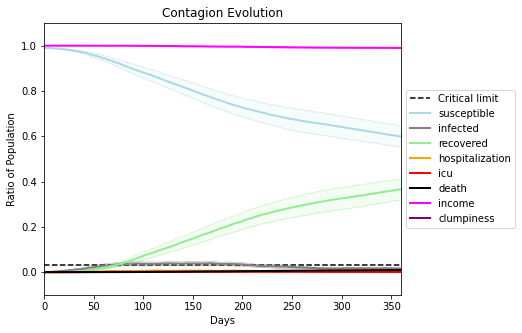

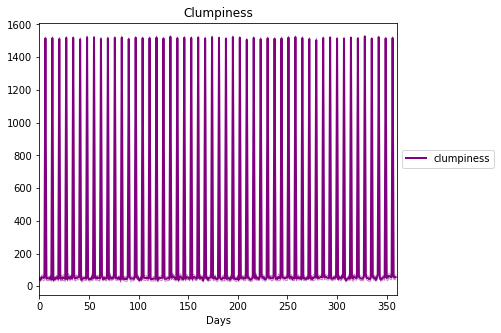

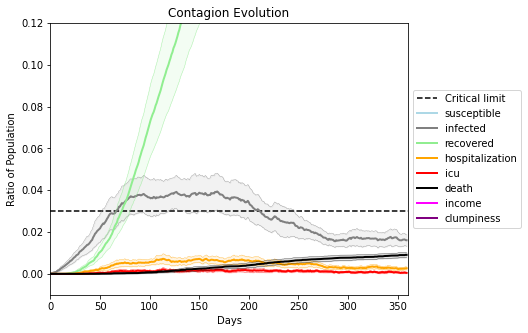

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2213, 4037, 864, 2172, 966, 10, 892, 7083, 5645, 1866, 1314, 7945, 8125, 8038, 2836, 1627, 4375, 6356, 7643, 6192]
Average similarity between family members is 0.15161578335479903 at temperature 0
Average similarity between family and home is 0.9998468521029695 at temperature -1
Average similarity between students and their classroom is 0.1448965075930719 at temperature 0
Average classroom occupancy is 1.6198830409356726 and number classrooms is 171
Average similarity between workers is 0.16657795159243985 at temperature 0
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.207005475019758 for kids: 0.21941655590581624
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.1405906255658133
avg restaurant similarity 0.30069017558174965
avg restaurant similarity -0.2058632206684683
avg restaurant similarity 0.16866032432259126
avg restaurant similarity 0.2621654111978249
avg restaurant similarity 0.08973864400112815
avg restaurant similarity -0.0775153740369835
avg restaurant similarity -0.22989807199349827
avg restaurant similarity 0.25932956324201883
avg restaurant similarity 0.0969742169440931
avg restaurant similarity 0.19784149476270171
avg restaurant similarity 0.09084107150089298
avg restaurant similarity 0.20114954391096634
avg restaurant similarity -0.010661602191330097
avg restaurant similarity -0.06531325117870046
avg restaurant similarity 0.30280009566729754
avg restaurant similarity 0.061498889100709705
avg restaurant similarity -0.06105691332460763
avg restaurant similarity 0.14953221307223616
avg restaurant similarity -0.23840604385521352
avg restaurant similarity 0.3840162997407496
avg restaurant similarity -0.02

avg restaurant similarity -0.22989807199349827
avg restaurant similarity -0.3091594504033757
avg restaurant similarity 0.11371184664831009
avg restaurant similarity 0.1642458407397787
avg restaurant similarity -0.10365589146026533
avg restaurant similarity -0.12310819883303789
avg restaurant similarity -0.36186020592788454
avg restaurant similarity -0.11247027194897558
avg restaurant similarity -0.00964011180544111
avg restaurant similarity 0.23419954258535008
avg restaurant similarity -0.16872299518266579
avg restaurant similarity 0.13635311045891182
avg restaurant similarity -0.007122602117192787
avg restaurant similarity 0.2545300219443983
avg restaurant similarity 0.1742390194491934
avg restaurant similarity 0.15090145886007453
avg restaurant similarity 0.03750963588636375
avg restaurant similarity -0.026430709060466406
avg restaurant similarity -0.1758980266819652
avg restaurant similarity 0.4738010475449217
avg restaurant similarity 0.25932956324201883
avg restaurant similarity 0

avg restaurant similarity 0.24448439935228575
avg restaurant similarity -0.14280492790369667
avg restaurant similarity -0.017699094308026422
avg restaurant similarity 0.31823065724033817
avg restaurant similarity 0.02770602875756779
avg restaurant similarity -0.23621648952736476
avg restaurant similarity 0.03952749490221638
avg restaurant similarity -0.13799927113401134
avg restaurant similarity 0.29021497399009666
avg restaurant similarity 0.02770602875756779
avg restaurant similarity -0.044393504561177785
avg restaurant similarity -0.24247574881001627
avg restaurant similarity 0.35776384905523995
avg restaurant similarity -0.10183325198245484
avg restaurant similarity 0.06841211359890106
avg restaurant similarity -0.053579324718876664
avg restaurant similarity -0.10761819291722192
avg restaurant similarity 0.07297954032220576
avg restaurant similarity 0.7651737536683969
avg restaurant similarity 0.23410512648684523
avg restaurant similarity -0.09321748994319812
avg restaurant similar

avg restaurant similarity -0.019560064808693663
avg restaurant similarity 0.032263556344874655
avg restaurant similarity -0.04751327927598243
avg restaurant similarity 0.23750687586188612
avg restaurant similarity 0.37287931993345036
avg restaurant similarity -0.13342626186729364
avg restaurant similarity 0.3505000178921492
avg restaurant similarity 0.03864052438363585
avg restaurant similarity 0.0600281891022721
avg restaurant similarity 0.049087756606686295
avg restaurant similarity 0.02770602875756779
avg restaurant similarity -0.12324829624696929
avg restaurant similarity 0.017951631984626848
avg restaurant similarity 0.08091467684332504
avg restaurant similarity 0.277195242212252
avg restaurant similarity 0.06694462575841659
Average similarity between family members is 0.1507275698891976 at temperature 0
Average similarity between family and home is 0.9998585737937168 at temperature -1
Average similarity between students and their classroom is 0.20268718467617164 at temperature 0


avg restaurant similarity 0.27686311733380553
avg restaurant similarity 0.01457258784251761
avg restaurant similarity -0.007306816387340716
avg restaurant similarity -0.16321698269843604
avg restaurant similarity -0.12265738815663574
avg restaurant similarity -0.06141887233364622
avg restaurant similarity 0.049027498414668004
avg restaurant similarity 0.016242946942813075
avg restaurant similarity 0.556014114256262
avg restaurant similarity -0.06014951476695675
avg restaurant similarity -0.02405880359972462
avg restaurant similarity -0.1182791781305413
avg restaurant similarity 0.356718690017086
avg restaurant similarity 0.15784850129555186
avg restaurant similarity -0.06141887233364622
avg restaurant similarity 0.14175337955700712
avg restaurant similarity -0.1902761968086919
avg restaurant similarity 0.17428005133096802
avg restaurant similarity 0.36027654124189484
avg restaurant similarity -0.15445858902437343
avg restaurant similarity -0.022580742292729133
avg restaurant similarity

avg restaurant similarity -0.05440809793450202
avg restaurant similarity 0.10343493971381403
avg restaurant similarity 0.17371955414501528
avg restaurant similarity 0.2093184950436881
avg restaurant similarity 0.11581305112772865
Average similarity between family members is 0.16485603793921635 at temperature 0
Average similarity between family and home is 0.9998599546983535 at temperature -1
Average similarity between students and their classroom is 0.12971484941097264 at temperature 0
Average classroom occupancy is 1.6702127659574468 and number classrooms is 188
Average similarity between workers is 0.15560046934220056 at temperature 0
Average office occupancy is 3.218274111675127 and number offices is 197
Average friend similarity for adults: 0.20157836077780583 for kids: 0.20276435128973633
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in t

avg restaurant similarity 0.010155522075039475
avg restaurant similarity 0.01806256801612352
avg restaurant similarity 0.28351657623234056
avg restaurant similarity 0.17224927634533935
avg restaurant similarity 0.20742024890995003
avg restaurant similarity 0.20084927278651588
avg restaurant similarity 0.1743724930483467
avg restaurant similarity 0.28351657623234056
avg restaurant similarity 0.09937874893106184
avg restaurant similarity 0.019837454078871906
avg restaurant similarity 0.11519967870668038
avg restaurant similarity 0.22057731302207048
avg restaurant similarity -0.16207196152808986
avg restaurant similarity 0.16837108066880066
avg restaurant similarity -0.011059371216890983
avg restaurant similarity -0.17791687205648757
avg restaurant similarity -0.24681625025549578
avg restaurant similarity 0.14780621238134034
avg restaurant similarity 0.47010050864438735
avg restaurant similarity 0.177614872749687
avg restaurant similarity 0.014326083152041591
avg restaurant similarity -0.

avg restaurant similarity 0.050915606607089305
avg restaurant similarity 0.27121354104042916
avg restaurant similarity 0.046399665833379816
avg restaurant similarity -0.05663373836146846
Average similarity between family members is 0.15055162829587496 at temperature 0
Average similarity between family and home is 0.9998517965994608 at temperature -1
Average similarity between students and their classroom is 0.1791975558765801 at temperature 0
Average classroom occupancy is 1.6608187134502923 and number classrooms is 171
Average similarity between workers is 0.16052503615748306 at temperature 0
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 0.2081720287365925 for kids: 0.22149933741210825
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.8368041093796038
avg restaurant similarity 0.11058033570776868
avg restaurant similarity 0.011700930639272938
avg restaurant similarity -0.002565082257932373
avg restaurant similarity 0.3093896063745897
avg restaurant similarity 0.42994817341230096
avg restaurant similarity 0.2843500432320905
avg restaurant similarity 0.0011381560564291474
avg restaurant similarity 0.5546432297068311
avg restaurant similarity 0.22445543001365165
avg restaurant similarity 0.10109470825036078
avg restaurant similarity 0.27511109205725914
avg restaurant similarity 0.19631685576871066
avg restaurant similarity 0.22207311675420371
avg restaurant similarity 0.48586244043991406
avg restaurant similarity 0.04062753699613976
avg restaurant similarity 0.031002442886423776
avg restaurant similarity -0.021535980592927283
avg restaurant similarity 0.33711341822890606
avg restaurant similarity 0.1600388874566979
avg restaurant similarity -0.38529955717852066
avg restaurant similarity 0.00

avg restaurant similarity -0.3153482500216432
avg restaurant similarity 0.03488408376548731
avg restaurant similarity 0.3747124828396311
avg restaurant similarity -0.12236585430307001
avg restaurant similarity 0.0997814275530787
avg restaurant similarity -0.1485666284880296
avg restaurant similarity -0.14741610523330026
avg restaurant similarity 0.10841537856602185
avg restaurant similarity 0.09616363643627295
avg restaurant similarity -0.02391459073336592
avg restaurant similarity 0.18334462824656517
avg restaurant similarity 0.11014674905189531
avg restaurant similarity 0.12257114895533343
avg restaurant similarity 0.06901371069590334
avg restaurant similarity 0.2290017758257306
avg restaurant similarity 0.09800951996091856
avg restaurant similarity 0.18372610582425133
avg restaurant similarity 0.08255502391186254
avg restaurant similarity 0.5777546660136903
avg restaurant similarity 0.2899705125855867
avg restaurant similarity -0.08061173962189633
avg restaurant similarity 0.0302896

avg restaurant similarity 0.07754944176440234
avg restaurant similarity 0.18764828863359048
avg restaurant similarity -0.24261420123531213
avg restaurant similarity 0.041254905275844356
avg restaurant similarity 0.11971630435317554
avg restaurant similarity 0.12049480539610714
avg restaurant similarity 0.2316537915899566
avg restaurant similarity 0.2251968937936079
avg restaurant similarity 0.30997574949702333
avg restaurant similarity 0.15848595029532
avg restaurant similarity 0.37917586105997675
avg restaurant similarity -0.04465002643767089
avg restaurant similarity 0.15293228816921017
avg restaurant similarity 0.08237459555456751
avg restaurant similarity 0.12411129785618899
avg restaurant similarity 0.03169934234490862
avg restaurant similarity -0.1306521167369174
avg restaurant similarity 0.19927242831753064
Average similarity between family members is 0.16171050381257726 at temperature 0
Average similarity between family and home is 0.9998461618811699 at temperature -1
Average s

avg restaurant similarity -0.0018456103109241034
avg restaurant similarity 0.28108794959310524
avg restaurant similarity 0.2182271301336758
avg restaurant similarity 0.14855955416682082
avg restaurant similarity 0.3570501835078578
avg restaurant similarity 0.121377686635149
avg restaurant similarity 0.5395712767932357
avg restaurant similarity 0.07804651291532974
avg restaurant similarity 0.2874240190509129
avg restaurant similarity 0.1296917278420842
avg restaurant similarity 0.17195264947140695
avg restaurant similarity 0.21364838698268995
avg restaurant similarity -0.03010297708735471
avg restaurant similarity 0.10276187091557841
avg restaurant similarity 0.5052729113701734
avg restaurant similarity -0.2944193070174591
avg restaurant similarity 0.4976070017419162
avg restaurant similarity 0.17460113318326081
avg restaurant similarity 0.24214702430333623
avg restaurant similarity 0.34087289612199595
avg restaurant similarity 0.39304748760556774
avg restaurant similarity 0.13007762280

avg restaurant similarity -0.11356150064982783
avg restaurant similarity 0.07650509281695139
avg restaurant similarity 0.41035900605839604
avg restaurant similarity 0.19783359022170882
avg restaurant similarity 0.2611659429296404
avg restaurant similarity 0.25840653985613193
avg restaurant similarity 0.389741430867542
avg restaurant similarity 0.054429407031366325
avg restaurant similarity -0.04008945448383759
avg restaurant similarity -0.03667773447700028
avg restaurant similarity -0.0519733818398723
avg restaurant similarity 0.27617616468365147
avg restaurant similarity 0.3175698665658331
avg restaurant similarity -0.05933414939225809
avg restaurant similarity 0.09187337012416963
avg restaurant similarity 0.1379936267505992
avg restaurant similarity 0.1933882941624205
avg restaurant similarity 0.3312610886920249
avg restaurant similarity 0.05312726769902118
avg restaurant similarity -0.11422264474003896
avg restaurant similarity 0.2852590651898407
avg restaurant similarity 0.16059806

avg restaurant similarity 0.19518765901817237
avg restaurant similarity 0.30529097313006914
avg restaurant similarity 0.11797765788041009
avg restaurant similarity -0.15013265225779537
avg restaurant similarity 0.0464803140899929
avg restaurant similarity 0.02181175965566241
avg restaurant similarity 0.4947127861151992
avg restaurant similarity -0.06918823363292198
avg restaurant similarity -0.2163380837977788
avg restaurant similarity -0.08655567986298762
avg restaurant similarity -0.08398843967619998
avg restaurant similarity 0.2588213179828796
avg restaurant similarity 0.08547750700907905
avg restaurant similarity -0.10750422003723067
avg restaurant similarity 0.217366349140534
avg restaurant similarity -0.08307906807902776
avg restaurant similarity -0.16189494311801206
avg restaurant similarity -0.02590036330864455
avg restaurant similarity -0.10082558399900263
avg restaurant similarity 0.364933930330417
avg restaurant similarity -0.07325945510171437
avg restaurant similarity 0.183

avg restaurant similarity -0.06193680310275419
avg restaurant similarity -0.016833172657134965
avg restaurant similarity -0.0961482874526368
avg restaurant similarity -0.04665803110876101
avg restaurant similarity -0.10189982975754017
avg restaurant similarity 0.026168668287432185
avg restaurant similarity -0.14608827920575043
avg restaurant similarity 0.17418835672461583
avg restaurant similarity 0.12143119057478799
avg restaurant similarity 0.15804671539637002
avg restaurant similarity -0.032907961161552715
avg restaurant similarity 0.16728034289061844
avg restaurant similarity 0.056192441225923206
avg restaurant similarity -0.3237866523272829
avg restaurant similarity -0.1557476892809156
avg restaurant similarity 0.055171463979887744
avg restaurant similarity -0.15789433257046043
avg restaurant similarity -0.030699200588304717
avg restaurant similarity 0.38160465553244843
avg restaurant similarity 0.08994183529352365
avg restaurant similarity 0.3438630553849404
avg restaurant simila

avg restaurant similarity -0.07745222281178153
avg restaurant similarity 0.012685648622991735
avg restaurant similarity 0.23098780945247013
avg restaurant similarity 0.42181210235477196
avg restaurant similarity -0.05911155227159372
avg restaurant similarity 0.48927346965915464
avg restaurant similarity 0.0434102714376403
avg restaurant similarity -0.2707465324660472
avg restaurant similarity 0.23166418492187363
avg restaurant similarity -0.054383202418856746
avg restaurant similarity -0.08367821162964822
avg restaurant similarity 0.01449002056421217
avg restaurant similarity -0.11727087612229661
avg restaurant similarity 0.08138225866909356
avg restaurant similarity 0.289284686618507
avg restaurant similarity -0.07095989771566913
avg restaurant similarity 0.09734169278511261
avg restaurant similarity -0.08954885526765542
avg restaurant similarity 0.09438968973564472
avg restaurant similarity 0.0708892942354995
avg restaurant similarity 0.2117911025074085
avg restaurant similarity -0.0

avg restaurant similarity 0.3293863210443283
avg restaurant similarity 0.1045228721454309
avg restaurant similarity 0.04460897975911088
avg restaurant similarity 0.3983767479393787
avg restaurant similarity 0.2310138590255617
avg restaurant similarity 0.34976861671442827
avg restaurant similarity -0.11302253000944916
avg restaurant similarity -0.2457675160427605
avg restaurant similarity 0.420265360938709
avg restaurant similarity 0.31339719570720836
avg restaurant similarity 0.36252960443145626
avg restaurant similarity 0.10533645076103396
avg restaurant similarity -0.12537162535971844
avg restaurant similarity 0.11796908130618566
Average similarity between family members is 0.14810100321801695 at temperature 0
Average similarity between family and home is 0.9998615382474247 at temperature -1
Average similarity between students and their classroom is 0.18054958284684605 at temperature 0
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity b

avg restaurant similarity -0.03169177565046581
avg restaurant similarity 0.1304559789730032
avg restaurant similarity 0.2585090725379794
avg restaurant similarity 0.1956127798109685
avg restaurant similarity -0.12690727509336694
avg restaurant similarity -0.2539018614689611
avg restaurant similarity 0.19176245179213372
avg restaurant similarity 0.3889386384921613
avg restaurant similarity -0.042311165128670836
avg restaurant similarity 0.12387122719646904
avg restaurant similarity 0.3748925922412369
avg restaurant similarity -0.08487384078870899
avg restaurant similarity 0.09982592777021125
avg restaurant similarity -0.06846655884876401
avg restaurant similarity 0.045020823175037555
avg restaurant similarity 0.29122866048915996
avg restaurant similarity 0.36993380872471526
avg restaurant similarity 0.05712817551274385
avg restaurant similarity 0.05929737181943455
avg restaurant similarity 0.18960213409846524
avg restaurant similarity -0.1507380330328707
avg restaurant similarity 0.2253

avg restaurant similarity 0.037964983837263766
avg restaurant similarity 0.10414124536216511
avg restaurant similarity 0.22299364439781594
avg restaurant similarity -0.17962942124845355
avg restaurant similarity -0.21621897573016616
avg restaurant similarity 0.0017251198578926742
avg restaurant similarity 0.11753290727207222
avg restaurant similarity 0.057217027145523215
avg restaurant similarity 0.12387122719646904
avg restaurant similarity 0.16517506381020708
avg restaurant similarity 0.02998612448943205
avg restaurant similarity -0.16150229536952565
avg restaurant similarity 0.2684999461499096
avg restaurant similarity 0.03025014603619003
avg restaurant similarity -0.006905962459473873
avg restaurant similarity 0.037964983837263766
avg restaurant similarity -0.08640848815945584
avg restaurant similarity 0.09410227410152354
avg restaurant similarity -0.07981726686211199
avg restaurant similarity 0.11205193189877072
avg restaurant similarity 0.1011323313467484
avg restaurant similarit

avg restaurant similarity -0.09972246078790138
avg restaurant similarity -0.18819862082515493
avg restaurant similarity -0.14674620997864332
avg restaurant similarity 0.1752424058851493
avg restaurant similarity -0.07283192112765283
avg restaurant similarity 0.0770125731551899
avg restaurant similarity -0.22261232094144448
avg restaurant similarity -0.2762364991973823
avg restaurant similarity 0.020018569313114923
avg restaurant similarity -0.2384130154308771
avg restaurant similarity 0.33705777335182135
avg restaurant similarity 0.07776393353722891
avg restaurant similarity -0.12225866023214642
avg restaurant similarity -0.2292767648616021
avg restaurant similarity 0.47811013519629836
avg restaurant similarity 0.2510180826017268
avg restaurant similarity 0.18736802519228332
avg restaurant similarity 0.006644430082696151
avg restaurant similarity -0.1535402631017035
avg restaurant similarity -0.2211702886082821
avg restaurant similarity 0.07376352112665388
avg restaurant similarity -0.

Average friend similarity for adults: 0.20186161011990866 for kids: 0.20391937376045194
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.10181105213818871
avg restaurant similarity 0.2638227601951614
avg restaurant similarity 0.2102093100617342
avg restaurant similarity -0.1350454662321349
avg restaurant similarity 0.34618050034500225
avg restaurant similarity -0.03428958062159193
avg restaurant similarity -0.038606680288351514
avg restaurant similarity -0.014662175993768761
avg restaurant similarity -0.0073146310706052875
avg restaurant similarity -0.21411415613868506
avg restaurant similarity 0.16243368987593965
avg restaurant similarity 0.16938034631206023
avg restaurant similarity 0.01564252327405197
avg restaurant similarity 0.30737098747326286
avg restaurant similarity 0.11689014482473042
avg restaurant similarity 0.17206314170215667
avg restaurant similarity 0.44388836540290544
avg restaurant similarity 0.31161768669529055
avg restaurant similarity 0.09621303568571701
avg restaurant similarity 0.20492425070717007
avg restaurant similarity 0.16672270857791543
avg restaurant similarity 0

avg restaurant similarity 0.13515347182064455
avg restaurant similarity -0.042870923798911616
avg restaurant similarity 0.23197141565775842
avg restaurant similarity 0.11052564851173848
avg restaurant similarity -0.0634337828160612
avg restaurant similarity -0.23586672011163112
avg restaurant similarity 0.20492425070717007
avg restaurant similarity -0.16574639177504197
avg restaurant similarity -0.4391038390726101
avg restaurant similarity -0.026167419080080134
avg restaurant similarity -0.026863622069535353
avg restaurant similarity 0.2996157179872382
avg restaurant similarity 0.06769157931189912
avg restaurant similarity 0.23387948278563692
avg restaurant similarity 0.027798499674940524
avg restaurant similarity -0.4321321995171209
avg restaurant similarity 0.057824574031911824
avg restaurant similarity 0.37432741219012156
avg restaurant similarity 0.12129275022208791
avg restaurant similarity 0.2368585786791942
Average similarity between family members is 0.13663589708962112 at temp

avg restaurant similarity 0.2718322777935823
avg restaurant similarity 0.4339725106112384
avg restaurant similarity -0.036622383564573896
avg restaurant similarity 0.02001952594537032
avg restaurant similarity -0.18650209469658355
avg restaurant similarity -0.2141587586076834
avg restaurant similarity 0.15568165513057208
avg restaurant similarity 0.6189150713051236
avg restaurant similarity 0.1711814610956133
avg restaurant similarity -0.01653225290304522
avg restaurant similarity 0.46472925287444056
avg restaurant similarity 0.02554131400379186
avg restaurant similarity 0.10887699165283304
avg restaurant similarity 0.5465759699128996
avg restaurant similarity 0.18330846730500902
avg restaurant similarity 0.05973872214637589
avg restaurant similarity -0.10957163628594924
avg restaurant similarity 0.4844197002804052
avg restaurant similarity 0.19646786886655737
avg restaurant similarity 0.1173812472938263
avg restaurant similarity 0.4123594694521253
avg restaurant similarity 0.155693324

avg restaurant similarity -0.4510403370243937
avg restaurant similarity -0.037859448433352844
avg restaurant similarity -0.32560289576443374
avg restaurant similarity 0.05980276500410237
avg restaurant similarity 0.15951949682339542
avg restaurant similarity 0.20960468512345917
avg restaurant similarity 0.20428121268852678
avg restaurant similarity 0.6644622548547617
avg restaurant similarity 0.15568165513057208
avg restaurant similarity 0.330573735184561
avg restaurant similarity -0.15334105248419613
avg restaurant similarity 0.2719351348878811
avg restaurant similarity 0.08025385538109474
avg restaurant similarity 0.2696235089825588
avg restaurant similarity 0.15569332453720852
avg restaurant similarity -0.05743443365702995
avg restaurant similarity 0.24686507300277621
avg restaurant similarity 0.05296974570281994
avg restaurant similarity 0.18298827022076614
avg restaurant similarity -0.0332343175068492
avg restaurant similarity 0.018068623901043225
avg restaurant similarity -0.3643

avg restaurant similarity 0.07611448960913614
avg restaurant similarity -0.3924961092651408
avg restaurant similarity 0.17455932116125586
avg restaurant similarity -0.07179281886857503
avg restaurant similarity 0.2056158578806367
avg restaurant similarity 0.1491309645785967
avg restaurant similarity 0.01647587562596392
avg restaurant similarity 0.13224723316962267
avg restaurant similarity -0.3199384991076292
avg restaurant similarity 0.21493223826800573
avg restaurant similarity 0.34288639037680557
avg restaurant similarity -0.011570198253118717
avg restaurant similarity -0.0880680756101477
avg restaurant similarity 0.0023039249399175177
avg restaurant similarity 0.05958016597458335
avg restaurant similarity -0.10579593522219687
avg restaurant similarity 0.5570108352052477
avg restaurant similarity 0.051644162248832254
avg restaurant similarity 0.047427933393703825
avg restaurant similarity 0.15391434293865813
avg restaurant similarity -0.0315451549022926
avg restaurant similarity -0.

avg restaurant similarity 0.08806287321980355
avg restaurant similarity 0.35999558860068614
avg restaurant similarity -0.20450194482392745
avg restaurant similarity -0.1150451015987277
avg restaurant similarity 0.1877261830328708
avg restaurant similarity -0.13545390657473003
avg restaurant similarity 0.24390856801311553
avg restaurant similarity -0.06122755631529403
avg restaurant similarity 0.5061323709609462
avg restaurant similarity 0.271670012219792
avg restaurant similarity -0.01526982443826562
avg restaurant similarity 0.21116775659892095
avg restaurant similarity 0.36528643477708045
avg restaurant similarity 0.06704997460326777
avg restaurant similarity 0.1001387964788081
avg restaurant similarity 0.2216275200671146
avg restaurant similarity 0.07394854101746742
avg restaurant similarity 0.07080537342032026
avg restaurant similarity 0.03185945803242985
avg restaurant similarity 0.2413220738523575
Average similarity between family members is 0.16792556107694814 at temperature 0
A

avg restaurant similarity 0.012377553783385245
avg restaurant similarity 0.4498752435122017
avg restaurant similarity 0.1028953639339847
avg restaurant similarity -0.22065382843475906
avg restaurant similarity -0.08076249091095145
avg restaurant similarity 0.026637764410423585
avg restaurant similarity 0.07722763018260552
avg restaurant similarity 0.282789485156815
avg restaurant similarity 0.2597008761125606
avg restaurant similarity 0.06573259819583706
avg restaurant similarity -0.01175285030750925
avg restaurant similarity 0.01434550591228087
avg restaurant similarity -0.02568182377393048
avg restaurant similarity 0.006873021492439811
avg restaurant similarity -0.07978474797293239
avg restaurant similarity -0.16867269688162806
avg restaurant similarity -0.05933169666986536
avg restaurant similarity 0.2130427638084046
avg restaurant similarity 0.4484570519394052
avg restaurant similarity 0.03032123609917984
avg restaurant similarity -0.31323373206815747
avg restaurant similarity -0.1

avg restaurant similarity 0.23350083665351953
avg restaurant similarity 0.19488797178565967
avg restaurant similarity 0.2568050428750715
avg restaurant similarity 0.1877340090807629
avg restaurant similarity -0.02622154693807112
avg restaurant similarity -0.0890688118598966
avg restaurant similarity -0.053267652145078545
avg restaurant similarity 0.07557482248915015
avg restaurant similarity -0.02551159264168265
avg restaurant similarity 0.3290246486923098
avg restaurant similarity 0.13821262269280712
avg restaurant similarity -0.33545982509736655
avg restaurant similarity 0.2632960183382439
avg restaurant similarity 0.18241792641316218
avg restaurant similarity -0.15192459573384676
avg restaurant similarity 0.06744383782001609
avg restaurant similarity -0.10252937368606461
avg restaurant similarity -0.019846076013234418
avg restaurant similarity -0.21353528431671726
avg restaurant similarity 0.2483925610656738
avg restaurant similarity 0.31411197198910606
avg restaurant similarity -0.

avg restaurant similarity 0.1764290602830272
avg restaurant similarity 0.2755048722815536
avg restaurant similarity 0.05758307036126893
avg restaurant similarity 0.257517260232928
avg restaurant similarity 0.1450826819393859
avg restaurant similarity 0.12324154120700082
avg restaurant similarity 0.3203574525799874
avg restaurant similarity -0.1257650636005
avg restaurant similarity -0.02827328683142428
avg restaurant similarity -0.5381054433182577
avg restaurant similarity 0.09295331994451779
avg restaurant similarity 0.37822485641783443
avg restaurant similarity -0.0033616260030901457
avg restaurant similarity -0.13492778305671738
avg restaurant similarity 0.2578783169000136
avg restaurant similarity 0.07219386334675779
avg restaurant similarity 0.06927543994426438
avg restaurant similarity -0.11609042044249113
avg restaurant similarity -0.3749211327154423
avg restaurant similarity -0.17013505225419195
avg restaurant similarity 0.3742714507112705
avg restaurant similarity -0.231775622

Average similarity between family and home is 0.9998582563622216 at temperature -1
Average similarity between students and their classroom is 0.14607718708490758 at temperature 0
Average classroom occupancy is 1.5573770491803278 and number classrooms is 183
Average similarity between workers is 0.15473323310611725 at temperature 0
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.21064943704888428 for kids: 0.22484386949276047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peopl

avg restaurant similarity 0.12416389578435905
avg restaurant similarity 0.3756873474553188
avg restaurant similarity -0.10713697753202119
avg restaurant similarity 0.3845208850097507
avg restaurant similarity 0.20634606603283967
avg restaurant similarity 0.1833121402905174
avg restaurant similarity -0.1533076346115472
avg restaurant similarity 0.05713473240188634
avg restaurant similarity 0.2436720121705467
avg restaurant similarity 0.3603452915640717
avg restaurant similarity -0.35315906411842546
avg restaurant similarity -0.32087191137846627
avg restaurant similarity -0.14771577703193622
avg restaurant similarity 0.23671082376698582
avg restaurant similarity -0.15528291265387548
avg restaurant similarity 0.5052611756600401
avg restaurant similarity 0.20110035540023938
avg restaurant similarity 0.3424309310353948
avg restaurant similarity 0.2666493837244449
avg restaurant similarity -0.11301829738949794
avg restaurant similarity 0.14273272492365188
avg restaurant similarity 0.27156199

Average similarity between workers is 0.16238523928200768 at temperature 0
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.2090287320734296 for kids: 0.2070977013953692
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.21107699312470266
avg restaurant similarity 0.20297465327312836
avg restaurant similarity -0.11932105403411043
avg restaurant similarity -0.1293789210838799
avg restaurant similarity 0.5042910408091834
avg restaurant similarity -0.30110117385063084
avg restaurant similarity -0.0217076710672697
avg restaurant similarity 0.25457857889988383
avg restaurant similarity 0.47338503962551504
avg restaurant similarity -0.07651937464942982
avg restaurant similarity 0.23261805415717893
avg restaurant similarity 0.1123023580222247
avg restaurant similarity -0.055759597821900445
avg restaurant similarity 0.27405930345139173
avg restaurant similarity 0.28159131608846155
avg restaurant similarity -0.2219986759470643
avg restaurant similarity 0.20476699615330393
avg restaurant similarity -0.06795336721448228
avg restaurant similarity 0.15875760096563812
avg restaurant similarity 0.10183582615447934
avg restaurant similarity 0.36883710105340123
avg restaurant similarity 0.24

(<function dict.items>, <function dict.items>, <function dict.items>)

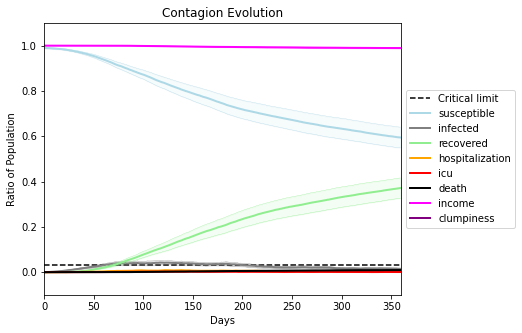

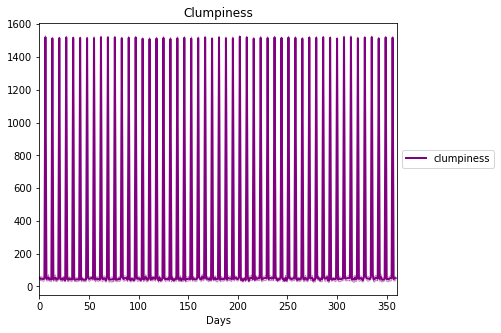

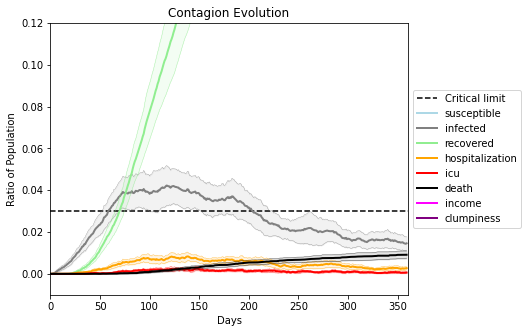

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3995, 2311, 3865, 266, 8709, 7720, 1085, 6794, 6272, 7865, 3441, 3897, 6689, 846, 462, 2749, 9948, 5070, 4363, 9622]
Average similarity between family members is 0.10448254462921798 at temperature 0.33
Average similarity between family and home is 0.9998628911548295 at temperature -1
Average similarity between students and their classroom is 0.09892716636894232 at temperature 0.33
Average classroom occupancy is 1.5491329479768785 and number classrooms is 173
Average similarity between workers is 0.09044327816510123 at temperature 0.33
Average office occupancy is 3.3627450980392157 and number offices is 204
Average friend similarity for adults: 0.16317886576541324 for kids: 0.17597364767908308
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity -0.0158168201811469
avg restaurant similarity 0.022804484411178105
avg restaurant similarity -0.18743286037154044
avg restaurant similarity 0.19317534595275046
avg restaurant similarity 0.15141281079942348
avg restaurant similarity 0.19747551829141186
avg restaurant similarity 0.51573385241682
avg restaurant similarity 0.1854090913831865
avg restaurant similarity 0.016974472952518027
avg restaurant similarity -0.4900799752672573
avg restaurant similarity -0.1528399172657655
avg restaurant similarity 0.15424201509428728
avg restaurant similarity 0.20780054811828924
avg restaurant similarity 0.07694993568301989
avg restaurant similarity 0.1204844448174692
avg restaurant similarity 0.009357731736449208
avg restaurant similarity -0.1200855807648795
avg restaurant similarity -0.23148705845307405
avg restaurant similarity -0.38137899481539156
avg restaurant similarity 0.0943174947084863
avg restaurant similarity 0.11802683000282355
avg restaurant similarity 0.136283

avg restaurant similarity -0.13201276730541697
avg restaurant similarity 0.23610395124158318
avg restaurant similarity 0.4196036809312315
avg restaurant similarity 0.011411734823615405
avg restaurant similarity 0.042595045173562676
avg restaurant similarity 0.1293660470303609
avg restaurant similarity -0.36133721704582233
avg restaurant similarity 0.0577203775674871
avg restaurant similarity 0.2757555197389707
avg restaurant similarity -0.030830519575495235
avg restaurant similarity 0.032768707391781685
avg restaurant similarity 0.30840556397500063
avg restaurant similarity -0.0004828961602820689
avg restaurant similarity 0.21697926704959664
avg restaurant similarity 0.053662141642260464
avg restaurant similarity -0.010883799897871992
avg restaurant similarity -0.05012936964850613
avg restaurant similarity 0.21629669736421955
avg restaurant similarity -0.037288351595548476
avg restaurant similarity 0.09768368779291076
avg restaurant similarity -0.07340753894024989
avg restaurant simila

avg restaurant similarity 0.0868182796633834
avg restaurant similarity -0.14198912462880373
avg restaurant similarity 0.08483423160221154
avg restaurant similarity -0.1572051932265906
avg restaurant similarity 0.2999584961870982
avg restaurant similarity 0.4917463637819539
avg restaurant similarity 0.2691213884350064
avg restaurant similarity 0.23235438571433314
avg restaurant similarity 0.21767617965319253
avg restaurant similarity 0.3206898745333446
avg restaurant similarity 0.037656098457043596
avg restaurant similarity 0.30705874125982746
avg restaurant similarity 0.37040848844464686
avg restaurant similarity -0.0020106788350314833
avg restaurant similarity 0.12585333454225484
avg restaurant similarity 0.1843014938351278
avg restaurant similarity -0.1932884860786711
avg restaurant similarity 0.40671152582760284
avg restaurant similarity -0.025591293679995065
avg restaurant similarity 0.23348289540976613
avg restaurant similarity -0.020172981957635307
avg restaurant similarity 0.168

Average similarity between students and their classroom is 0.09951723522280634 at temperature 0.33
Average classroom occupancy is 1.593939393939394 and number classrooms is 165
Average similarity between workers is 0.10869994568098086 at temperature 0.33
Average office occupancy is 3.371287128712871 and number offices is 202
Average friend similarity for adults: 0.15970606697908185 for kids: 0.17274037574497245
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in

avg restaurant similarity 0.08032934097596264
avg restaurant similarity -0.3168523952140355
avg restaurant similarity 0.16360444941507407
avg restaurant similarity 0.08543670207555326
avg restaurant similarity 0.039381711776120015
avg restaurant similarity 0.14280378817286848
avg restaurant similarity 0.3205420729040939
avg restaurant similarity 0.21591102385606253
avg restaurant similarity -0.29539462279446116
avg restaurant similarity -0.5650552779187852
avg restaurant similarity -0.11056855473040603
avg restaurant similarity 0.3684174335530351
avg restaurant similarity -0.08020810632390417
avg restaurant similarity 0.3722184076272417
avg restaurant similarity 0.3876767608892125
avg restaurant similarity -0.12222925394352263
avg restaurant similarity -0.15636551754744435
avg restaurant similarity -0.17895917285901625
avg restaurant similarity 0.36072470532789064
avg restaurant similarity -0.2649506072885793
avg restaurant similarity 0.37275871466458604
avg restaurant similarity 0.086

avg restaurant similarity 0.47312491454118527
avg restaurant similarity 0.4158923761210564
avg restaurant similarity -0.11424088354507667
avg restaurant similarity 0.2164722562679356
avg restaurant similarity -0.23676311933016536
avg restaurant similarity -0.009389773717251852
avg restaurant similarity 0.2042951974667582
avg restaurant similarity 0.014130704693595513
avg restaurant similarity 0.04999826585194442
avg restaurant similarity 0.10100677477077881
avg restaurant similarity 0.11044495533834044
avg restaurant similarity -0.1650156298929173
avg restaurant similarity 0.22733863460698936
avg restaurant similarity 0.2907533422800588
avg restaurant similarity -0.01710943749443517
avg restaurant similarity -0.11154554720188585
avg restaurant similarity -0.14004397898915566
avg restaurant similarity 0.4871912761871167
avg restaurant similarity -0.05783880131276348
avg restaurant similarity -0.12207028497366523
avg restaurant similarity 0.03220449533556011
avg restaurant similarity 0.1

avg restaurant similarity 0.03711195018385836
avg restaurant similarity 0.3835198344297021
avg restaurant similarity 0.03617533229059704
avg restaurant similarity 0.11050147235854531
avg restaurant similarity 0.3634480320021749
avg restaurant similarity 0.19391207237188338
avg restaurant similarity 0.2711011827004418
avg restaurant similarity -0.5018821645153705
avg restaurant similarity -0.17965891811039605
avg restaurant similarity 0.044277882350407353
avg restaurant similarity -0.38296821690458693
avg restaurant similarity -0.04159061543483886
avg restaurant similarity 0.2264492965894925
avg restaurant similarity -0.0866967081133838
avg restaurant similarity 0.20889068081057405
avg restaurant similarity -0.04204626650313392
avg restaurant similarity 0.16344942913853094
avg restaurant similarity -0.10547257795734062
avg restaurant similarity 0.13399476401820531
avg restaurant similarity 0.12548060760215812
avg restaurant similarity -0.07904720021173128
avg restaurant similarity 0.124

avg restaurant similarity 0.2476226674901686
avg restaurant similarity -0.08639870429697731
avg restaurant similarity -0.006703956585078261
avg restaurant similarity 0.22567273158802964
avg restaurant similarity -0.03796433150478415
avg restaurant similarity 0.24321408915456905
avg restaurant similarity -0.18165789354308626
avg restaurant similarity 0.04303022198544997
avg restaurant similarity 0.008661652853974064
avg restaurant similarity 0.1581188850892756
avg restaurant similarity -0.5018821645153705
avg restaurant similarity 0.20800865402183033
avg restaurant similarity 0.1731477758523028
avg restaurant similarity 0.3090527200063102
avg restaurant similarity -0.013924214242565685
avg restaurant similarity -0.24417669807212863
avg restaurant similarity 0.38353361035342287
avg restaurant similarity 0.14050023615490997
avg restaurant similarity 0.02169562949219916
avg restaurant similarity -0.02835921396486541
avg restaurant similarity -0.2972905319754118
avg restaurant similarity 0.

avg restaurant similarity 0.11050660585948917
avg restaurant similarity -0.017469679317284586
avg restaurant similarity -0.08007283611853007
avg restaurant similarity -0.15741832999728078
avg restaurant similarity -0.01658304729512483
avg restaurant similarity -0.04336168807720854
avg restaurant similarity 0.09809144561222996
avg restaurant similarity -0.13050388148590317
avg restaurant similarity -0.10162424032370061
avg restaurant similarity 0.5126312543716269
avg restaurant similarity -0.4901911336997927
avg restaurant similarity 0.11990949751800119
avg restaurant similarity 0.6634541523161375
avg restaurant similarity 0.05765855193508
avg restaurant similarity 0.20498843268020694
avg restaurant similarity -0.11814276490250557
avg restaurant similarity 0.0797695441506886
avg restaurant similarity -0.049151031893482224
avg restaurant similarity -0.24125951110347474
avg restaurant similarity 0.17083804499915733
avg restaurant similarity 0.032121877553511535
avg restaurant similarity 0

avg restaurant similarity 0.09658722984702206
avg restaurant similarity -0.19305369473020215
avg restaurant similarity 0.6050939236462787
avg restaurant similarity 0.22185644187244002
avg restaurant similarity -0.09989898081976782
avg restaurant similarity -0.01658304729512483
avg restaurant similarity 0.21467715457004888
avg restaurant similarity -0.15741832999728078
avg restaurant similarity 0.05613536097676047
avg restaurant similarity -0.037612100238260796
avg restaurant similarity 0.07123509857644106
avg restaurant similarity -0.28368787296545606
avg restaurant similarity -0.0013328293654890806
avg restaurant similarity 0.3207606937734868
avg restaurant similarity -0.18720198610249694
avg restaurant similarity 0.29006354512219157
avg restaurant similarity -0.26900478980501397
avg restaurant similarity 0.08580162876502695
avg restaurant similarity -0.037821797039814684
avg restaurant similarity -0.025824870922950716
avg restaurant similarity 0.028072625220190037
avg restaurant simi

avg restaurant similarity 0.2061544935431571
avg restaurant similarity -0.108876991304655
avg restaurant similarity 0.21602255488506003
avg restaurant similarity 0.06677337291740236
avg restaurant similarity -0.24340521590137565
avg restaurant similarity -0.02756245836347663
avg restaurant similarity 0.1003216560367544
avg restaurant similarity -0.12833120805183323
avg restaurant similarity -0.42729308834748503
avg restaurant similarity 0.19743789037990425
avg restaurant similarity 0.16878526402046276
avg restaurant similarity -0.20977102437137832
avg restaurant similarity 0.07035496426780884
avg restaurant similarity 0.12327995235515185
avg restaurant similarity -0.05637554477527522
avg restaurant similarity -0.12277897352034761
avg restaurant similarity 0.12327995235515185
avg restaurant similarity -0.24785825106051637
avg restaurant similarity -0.03474833301018746
avg restaurant similarity 0.12803203721411222
avg restaurant similarity -0.1991980344750226
avg restaurant similarity 0.

avg restaurant similarity -0.15817763476101468
avg restaurant similarity 0.06808291112504326
avg restaurant similarity -0.23318340553772698
avg restaurant similarity 0.04723307824334032
avg restaurant similarity -0.28998834493803727
avg restaurant similarity 0.012081565776347225
avg restaurant similarity -0.006751152965160376
avg restaurant similarity 0.06736486315382703
avg restaurant similarity 0.07323161810363484
Average similarity between family members is 0.11897963642611088 at temperature 0.33
Average similarity between family and home is 0.9998457273550605 at temperature -1
Average similarity between students and their classroom is 0.14707849173028353 at temperature 0.33
Average classroom occupancy is 1.6 and number classrooms is 165
Average similarity between workers is 0.12927727314216678 at temperature 0.33
Average office occupancy is 3.4489795918367347 and number offices is 196
Average friend similarity for adults: 0.18427732806500915 for kids: 0.16772240098066726
home_distr

avg restaurant similarity 0.09526054170523517
avg restaurant similarity 0.030967298000778954
avg restaurant similarity -0.22266015010412624
avg restaurant similarity -0.13604606073571462
avg restaurant similarity 0.15432952203898798
avg restaurant similarity 0.4337241083921904
avg restaurant similarity -0.09232205072305974
avg restaurant similarity -0.25990033445545324
avg restaurant similarity -0.4550881920993379
avg restaurant similarity 0.161705991194389
avg restaurant similarity 0.37629525709120776
avg restaurant similarity 0.23310727510943963
avg restaurant similarity -0.08743323444313415
avg restaurant similarity 0.02496961331359006
avg restaurant similarity 0.13730303813854391
avg restaurant similarity -0.3127082601167449
avg restaurant similarity 0.35677523489788854
avg restaurant similarity -0.007525208305734447
avg restaurant similarity -0.0324164571893778
avg restaurant similarity 0.016147520972245873
avg restaurant similarity -0.07523938865706288
avg restaurant similarity 0

avg restaurant similarity 0.08457625649963174
avg restaurant similarity 0.08430192135627645
Average similarity between family members is 0.11410109349654991 at temperature 0.33
Average similarity between family and home is 0.9998514681234952 at temperature -1
Average similarity between students and their classroom is 0.17312976142385178 at temperature 0.33
Average classroom occupancy is 1.6022727272727273 and number classrooms is 176
Average similarity between workers is 0.12666220903196124 at temperature 0.33
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.16928466847343857 for kids: 0.18071784849931427
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloca

avg restaurant similarity -0.12942293058141874
avg restaurant similarity -0.186411319828102
avg restaurant similarity 0.12452732210644987
avg restaurant similarity 0.6753624025546517
avg restaurant similarity -0.4110634667974045
avg restaurant similarity 0.12839312633103828
avg restaurant similarity -0.35405199220941574
avg restaurant similarity 0.18610159194614273
avg restaurant similarity 0.3283757999088641
avg restaurant similarity -0.2845791063508184
avg restaurant similarity -0.051489221573535485
avg restaurant similarity -0.02631481467552542
avg restaurant similarity 0.08994330218916326
avg restaurant similarity 0.330107481489706
avg restaurant similarity -0.20973559333207753
avg restaurant similarity -0.10097888262374327
avg restaurant similarity 0.15323414382419193
avg restaurant similarity 0.07717553043338164
avg restaurant similarity 0.17639296182266653
avg restaurant similarity 0.031135743120912218
avg restaurant similarity 0.06801544403963393
avg restaurant similarity 0.052

avg restaurant similarity 0.060653144230646064
avg restaurant similarity 0.1860669028485134
avg restaurant similarity -0.3721506702188546
avg restaurant similarity 0.23012599790478133
avg restaurant similarity -0.11646193039825402
avg restaurant similarity 0.1675429731982565
avg restaurant similarity 0.12279762406470719
avg restaurant similarity 0.15893794846277132
avg restaurant similarity 0.503202944089138
avg restaurant similarity 0.0174168617706838
avg restaurant similarity 0.12839312633103828
avg restaurant similarity -0.1651732053198656
avg restaurant similarity -0.13785438565188335
avg restaurant similarity -0.19514012320722818
avg restaurant similarity 0.3419772802352722
avg restaurant similarity 0.10032011756407579
avg restaurant similarity 0.19340872003612014
avg restaurant similarity 0.1491687908634136
avg restaurant similarity 0.330107481489706
avg restaurant similarity -0.027626746875138653
avg restaurant similarity 0.27473071580034947
avg restaurant similarity 0.067790774

avg restaurant similarity 0.020964439069596386
avg restaurant similarity 0.06481928594448305
avg restaurant similarity -0.07826004437934075
avg restaurant similarity 0.14199729566594044
avg restaurant similarity 0.16540816628192556
avg restaurant similarity -0.3703275281403794
avg restaurant similarity 0.35783623063321623
avg restaurant similarity -0.1458295356744468
avg restaurant similarity 0.05492235340678857
avg restaurant similarity -0.021627440279146072
avg restaurant similarity 0.009439551242243702
avg restaurant similarity 0.43131050559941975
avg restaurant similarity 0.08458989416555741
avg restaurant similarity 0.23988972681533122
avg restaurant similarity 0.15432238620803332
avg restaurant similarity -0.12017570223941196
avg restaurant similarity -0.37015676787338636
avg restaurant similarity 0.4056930385287656
avg restaurant similarity 0.4895809208217642
avg restaurant similarity 0.09428115030249697
avg restaurant similarity -0.06016304455881341
avg restaurant similarity -0

avg restaurant similarity 0.17544025726466264
avg restaurant similarity 0.12060369389893473
avg restaurant similarity -0.3408887753497455
avg restaurant similarity 0.16909043914379118
avg restaurant similarity -0.10364337516635136
avg restaurant similarity 0.30523388862122885
avg restaurant similarity -0.3034513822518166
avg restaurant similarity 0.1075378509436832
avg restaurant similarity 0.004306507488922175
avg restaurant similarity 0.058502174362455577
avg restaurant similarity -0.4583347483316983
Average similarity between family members is 0.11046182605859044 at temperature 0.33
Average similarity between family and home is 0.9998574742694826 at temperature -1
Average similarity between students and their classroom is 0.11507788160710569 at temperature 0.33
Average classroom occupancy is 1.554945054945055 and number classrooms is 182
Average similarity between workers is 0.1285004372836452 at temperature 0.33
Average office occupancy is 3.2955665024630543 and number offices is 2

avg restaurant similarity -0.24584618101506822
avg restaurant similarity 0.20419945259024838
avg restaurant similarity -0.03768768714049326
avg restaurant similarity 0.10219699417607589
avg restaurant similarity 0.2474878043764009
avg restaurant similarity -0.3290768045802146
avg restaurant similarity 0.38158742807305374
avg restaurant similarity 0.13107453585124867
avg restaurant similarity 0.11745933349117878
avg restaurant similarity -0.14995497402940816
avg restaurant similarity 0.041486217315087046
avg restaurant similarity 0.12479824902927375
avg restaurant similarity 0.4410737191164832
avg restaurant similarity 0.199578545125121
avg restaurant similarity -0.017195797337286836
avg restaurant similarity 0.10289951099743874
avg restaurant similarity 0.06271348169030093
avg restaurant similarity 0.386841759696128
avg restaurant similarity 0.2515221775005205
avg restaurant similarity 0.001718851686105527
avg restaurant similarity -0.07747800086998528
avg restaurant similarity -0.1104

avg restaurant similarity -0.466728926785481
avg restaurant similarity 0.24361006599479657
avg restaurant similarity -0.14022744640170082
avg restaurant similarity 0.06506682584182759
avg restaurant similarity -0.42058373286933015
avg restaurant similarity -0.23050648154263592
avg restaurant similarity 0.03141878826547512
avg restaurant similarity -0.25190407215113597
avg restaurant similarity -0.0010157264859833592
avg restaurant similarity 0.023676266453887523
avg restaurant similarity 0.06765067030907265
avg restaurant similarity -0.2786475688291411
avg restaurant similarity 0.10861108777556305
avg restaurant similarity -0.012779504668229625
avg restaurant similarity 0.16387104127948351
avg restaurant similarity -0.23050648154263592
avg restaurant similarity -0.15332753503219196
avg restaurant similarity -0.0940646945252847
avg restaurant similarity -0.056911173232990095
avg restaurant similarity 0.49591534447578844
avg restaurant similarity 0.3850904052734413
avg restaurant similar

avg restaurant similarity 0.08879614528729629
avg restaurant similarity 0.21356814095918658
avg restaurant similarity 0.16976933546422548
avg restaurant similarity 0.24659387306310307
avg restaurant similarity 0.07520021084533775
avg restaurant similarity -0.2124146766812816
avg restaurant similarity -0.14056081697494519
avg restaurant similarity -0.1608574208656078
avg restaurant similarity 0.0292117935299994
avg restaurant similarity 0.3451561820273892
avg restaurant similarity -0.047564195058715744
avg restaurant similarity 0.1668997332130788
avg restaurant similarity 0.054469577130110455
avg restaurant similarity 0.08805346904468586
avg restaurant similarity -0.08167324108495748
avg restaurant similarity 0.1147634343829884
avg restaurant similarity -0.16811055754971066
avg restaurant similarity -0.017655773418420145
avg restaurant similarity -0.03571274859999715
avg restaurant similarity 0.22612436742302724
avg restaurant similarity 0.19602583802757262
avg restaurant similarity -0.

avg restaurant similarity -0.043915407657654185
avg restaurant similarity -0.12231610370563117
avg restaurant similarity -0.012642174934382792
avg restaurant similarity 0.01976759300591645
avg restaurant similarity 0.182824631345813
avg restaurant similarity 0.04756698318417823
avg restaurant similarity 0.06507807807847998
avg restaurant similarity 0.14721882480952897
avg restaurant similarity -0.1658985326655297
avg restaurant similarity 0.1334301079113876
avg restaurant similarity 0.0222429639785314
avg restaurant similarity 0.0800227931701934
avg restaurant similarity 0.3283458459800637
avg restaurant similarity 0.021327770051172146
avg restaurant similarity 0.09928558515604839
avg restaurant similarity -0.05408405950259155
avg restaurant similarity 0.017773623017551282
avg restaurant similarity -0.013542044839834507
avg restaurant similarity -0.1288349667353691
avg restaurant similarity -0.014807855396479205
avg restaurant similarity -0.3533843931494895
avg restaurant similarity 0.

avg restaurant similarity 0.1986958538129464
avg restaurant similarity 0.2282975573736451
avg restaurant similarity 0.23714633190846804
avg restaurant similarity -0.19173575931759929
avg restaurant similarity -0.08643511802264633
avg restaurant similarity 0.09908892189997105
avg restaurant similarity 0.3076572052443812
avg restaurant similarity -0.00953646454520285
avg restaurant similarity 0.0038322336658940456
avg restaurant similarity -0.05039862425294748
avg restaurant similarity 0.09571803869216136
avg restaurant similarity 0.00727644322738603
avg restaurant similarity -0.04733437312350607
avg restaurant similarity 0.004231559248461331
avg restaurant similarity -0.13869108106481617
avg restaurant similarity 0.030862001449080873
avg restaurant similarity 0.14405623342855473
avg restaurant similarity 0.1551368239411263
avg restaurant similarity 0.24439803180588432
avg restaurant similarity -0.31219953521024213
avg restaurant similarity -0.26249157970812864
avg restaurant similarity 

avg restaurant similarity 0.03585603733436368
avg restaurant similarity 0.34740820814333384
avg restaurant similarity 0.18327893966292022
avg restaurant similarity 0.2054275374254368
avg restaurant similarity 0.17186518003567175
avg restaurant similarity 0.0702990330167593
avg restaurant similarity -0.218029580622346
avg restaurant similarity -0.11138472189052719
avg restaurant similarity -0.009609143279056789
avg restaurant similarity 0.27957376398475964
avg restaurant similarity -0.107133688413824
avg restaurant similarity 0.24670764092468234
avg restaurant similarity 0.13908449938955764
avg restaurant similarity -0.0561394433128034
avg restaurant similarity -0.09696479046933473
avg restaurant similarity 0.02070589254383689
avg restaurant similarity 0.13806099386570506
avg restaurant similarity 0.47842621066024704
avg restaurant similarity 0.1276553590220133
avg restaurant similarity -0.0026129592051784833
avg restaurant similarity 0.01711088173352371
avg restaurant similarity 0.7007

avg restaurant similarity -0.23840486445847225
avg restaurant similarity 0.24870785503215714
avg restaurant similarity -0.24386471080940184
avg restaurant similarity 0.09460674601485188
avg restaurant similarity 0.18388361863428437
avg restaurant similarity -0.272658679125861
avg restaurant similarity -0.08210306806331642
avg restaurant similarity 0.07217393939466347
avg restaurant similarity 0.04203979990270179
avg restaurant similarity -0.4149428755675669
avg restaurant similarity -0.2607627908276827
avg restaurant similarity 0.3758797052806209
avg restaurant similarity 0.37704184640014193
avg restaurant similarity -0.07564614475412304
avg restaurant similarity -0.14998588824069875
avg restaurant similarity 0.20729538493417551
avg restaurant similarity -0.011579623215496847
avg restaurant similarity 0.019383995995886596
avg restaurant similarity 0.22393672951976668
avg restaurant similarity 0.08179571578693882
avg restaurant similarity 0.042380052167729935
avg restaurant similarity 0

avg restaurant similarity 0.2157583168711403
avg restaurant similarity 0.20716582913529916
avg restaurant similarity 0.007040500658746621
avg restaurant similarity -0.2131351993397559
avg restaurant similarity 0.024954513302059327
avg restaurant similarity 0.27730555035041754
avg restaurant similarity 0.37363944620174705
avg restaurant similarity -0.10146780212830259
avg restaurant similarity 0.22015057491735376
avg restaurant similarity 0.02847213027782866
avg restaurant similarity -0.0032393140080853172
avg restaurant similarity 0.060616067533186435
avg restaurant similarity 0.20039132484772734
avg restaurant similarity 0.04457677491503454
avg restaurant similarity 0.05307570812243507
avg restaurant similarity 0.45277262374495864
avg restaurant similarity -0.006250779157104869
avg restaurant similarity 0.15656900476858968
avg restaurant similarity -0.23443642414475993
avg restaurant similarity -0.09014972750766174
avg restaurant similarity 0.11916704023325181
avg restaurant similarit

avg restaurant similarity -0.013276084587737137
avg restaurant similarity -0.19059538785033603
avg restaurant similarity 0.030674595250672527
avg restaurant similarity -0.061432778863406756
avg restaurant similarity 0.03190910593185162
avg restaurant similarity 0.07514767919551556
avg restaurant similarity 0.16183825435916113
avg restaurant similarity 0.3668279902927377
avg restaurant similarity 0.2723834905781264
avg restaurant similarity 0.016677639392802188
avg restaurant similarity -0.2457948014517708
avg restaurant similarity 0.01943763657529616
avg restaurant similarity 0.01847754458604941
avg restaurant similarity -0.2457948014517708
avg restaurant similarity -0.08233001970275189
avg restaurant similarity -0.21160998250637605
avg restaurant similarity 0.06208681953803001
avg restaurant similarity 0.27121360923219606
avg restaurant similarity 0.08284336301663515
avg restaurant similarity 0.06656057614536953
avg restaurant similarity -0.06289305660120888
avg restaurant similarity 

avg restaurant similarity -0.34813228745905556
avg restaurant similarity -0.6951541747491833
avg restaurant similarity 0.08796853344095137
avg restaurant similarity -0.2221766272448372
avg restaurant similarity -0.08575664564751956
avg restaurant similarity -0.2542460830811282
avg restaurant similarity 0.22398073767683402
avg restaurant similarity -0.12564748611538556
avg restaurant similarity -0.1436597995699166
avg restaurant similarity 0.4321848186344988
avg restaurant similarity -0.14323713633872864
avg restaurant similarity 0.20444666118864369
avg restaurant similarity 0.17101456943624166
avg restaurant similarity -0.1673702105548399
avg restaurant similarity -0.19799062426568492
avg restaurant similarity 0.6242014714661231
avg restaurant similarity -0.2127943835616781
avg restaurant similarity -0.31384308987631515
avg restaurant similarity -0.31015007111908
avg restaurant similarity -0.53414386834113
avg restaurant similarity 0.10370904799089192
avg restaurant similarity 0.012465

avg restaurant similarity -0.11774815011690336
avg restaurant similarity 0.18661393035257293
avg restaurant similarity 0.058611695034031186
avg restaurant similarity 0.23941412203565687
avg restaurant similarity -0.02344781674205492
avg restaurant similarity 0.13939687480548252
avg restaurant similarity -0.4982692536002715
avg restaurant similarity 0.13431256365016997
avg restaurant similarity 0.14528027911763547
avg restaurant similarity -0.03353130970412981
avg restaurant similarity -0.10479429171673041
avg restaurant similarity 0.19219921605936505
avg restaurant similarity 0.08022185459333747
avg restaurant similarity -0.026806570353084466
avg restaurant similarity 0.004513672188696545
avg restaurant similarity -0.21628572063339666
avg restaurant similarity 0.07428736477940026
avg restaurant similarity 0.13848310144555506
avg restaurant similarity 0.1267087442828364
avg restaurant similarity -0.08758643192194668
avg restaurant similarity -0.055161075554340785
avg restaurant similari

Average similarity between students and their classroom is 0.1500625142310329 at temperature 0.33
Average classroom occupancy is 1.5934065934065933 and number classrooms is 182
Average similarity between workers is 0.12279033665648244 at temperature 0.33
Average office occupancy is 3.321608040201005 and number offices is 199
Average friend similarity for adults: 0.17355084700989376 for kids: 0.1687367232987179
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in 

avg restaurant similarity 0.01957375110172222
avg restaurant similarity 0.021560838609472353
avg restaurant similarity -0.256957630876296
avg restaurant similarity 0.20263679686907982
avg restaurant similarity 0.6395927822112152
avg restaurant similarity 0.12763866647205901
avg restaurant similarity 0.17624770867750886
avg restaurant similarity -0.1930968942630939
avg restaurant similarity 0.23426159335897023
avg restaurant similarity 0.3053560727567598
avg restaurant similarity 0.1946588090376956
avg restaurant similarity 0.19036003878057564
avg restaurant similarity -0.1512799109202797
avg restaurant similarity 0.07252535474672438
avg restaurant similarity 0.4993817845675028
avg restaurant similarity 0.20626902318666968
avg restaurant similarity 0.16819677039138964
avg restaurant similarity 0.13637575733956303
avg restaurant similarity 0.30095708948412236
avg restaurant similarity 0.22954935288010617
avg restaurant similarity 0.17365029371559781
avg restaurant similarity 0.2095259126

Average similarity between workers is 0.1001000127816053 at temperature 0.33
Average office occupancy is 3.2270531400966185 and number offices is 207
Average friend similarity for adults: 0.16305705113897717 for kids: 0.1687527254277946
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 

avg restaurant similarity 0.1221854428304764
avg restaurant similarity 0.107928930423206
avg restaurant similarity 0.33263401370321233
avg restaurant similarity 0.11470958630126593
avg restaurant similarity 0.24731135566613824
avg restaurant similarity 0.2110487690482221
avg restaurant similarity -0.018656580554374885
avg restaurant similarity -0.5114815940835907
avg restaurant similarity 0.3766760408972265
avg restaurant similarity 0.11012721659819615
avg restaurant similarity -0.16859060317281713
avg restaurant similarity 0.017107815117066716
avg restaurant similarity 0.07847480343948707
avg restaurant similarity 0.21359993739714944
avg restaurant similarity 0.18379852229091803
avg restaurant similarity 0.2740526026045912
avg restaurant similarity 0.10015808677068361
avg restaurant similarity -0.0918681167405325
avg restaurant similarity 0.4967580320787006
avg restaurant similarity -0.32363422699112526
avg restaurant similarity -0.020357437044841827
avg restaurant similarity 0.171081

Average friend similarity for adults: 0.16863608107910977 for kids: 0.17757755422870472
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.06724061232495193
avg restaurant similarity -0.016517909772107195
avg restaurant similarity 0.29802529436054004
avg restaurant similarity -0.02386530816756466
avg restaurant similarity 0.054161460433414535
avg restaurant similarity -0.22554874713624048
avg restaurant similarity 0.036800883561993306
avg restaurant similarity 0.3008919696862914
avg restaurant similarity 0.06371282125029476
avg restaurant similarity 0.33611383485576807
avg restaurant similarity -0.32869507128304376
avg restaurant similarity 0.20657249752125645
avg restaurant similarity -0.2398702289500987
avg restaurant similarity -0.09674769284751969
avg restaurant similarity 0.043116076428310585
avg restaurant similarity 0.3555037665563281
avg restaurant similarity 0.20341724501528732
avg restaurant similarity 0.33611383485576807
avg restaurant similarity 0.019459546027161212
avg restaurant similarity -0.1253790001826226
avg restaurant similarity -0.09954618028338309
avg restaurant similarity

avg restaurant similarity 0.18004020057631537
avg restaurant similarity 0.08941048880955695
avg restaurant similarity -0.07900522562461232
avg restaurant similarity -0.17122834252839061
avg restaurant similarity 0.1015556041965663
avg restaurant similarity 0.22573875152499895
avg restaurant similarity 0.24825610249340732
avg restaurant similarity -0.17877979029445412
avg restaurant similarity -0.20739785938849337
avg restaurant similarity -0.1781265336590747
avg restaurant similarity -0.005641138370558255
using average of time series:
stats on susceptible:
data: [0.7564315812818806, 0.7500664010624172, 0.7957027777777778, 0.6318944444444444, 0.6964083333333333, 0.8112583333333333, 0.7786555555555557, 0.8032523032523032, 0.8119388888888889, 0.7173888888888889, 0.6523416666666666, 0.8561638888888891, 0.8546972222222221, 0.8226361111111111, 0.7636305555555557, 0.7678611111111111, 0.7389496959646213, 0.8047611111111111, 0.8766638888888889, 0.89345]
min:
0.6318944444444444
max:
0.89345
std:

(<function dict.items>, <function dict.items>, <function dict.items>)

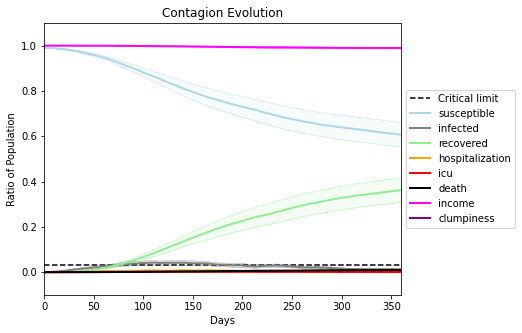

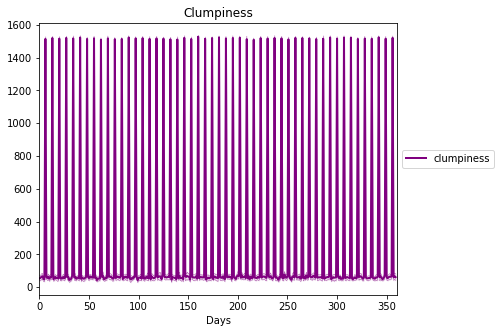

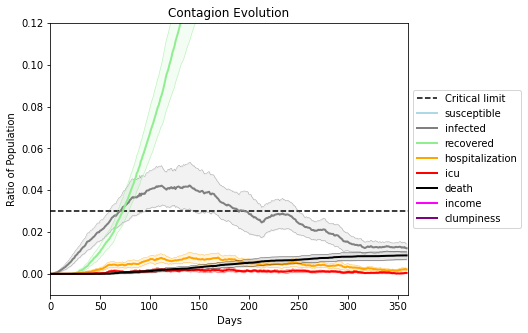

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6203, 4550, 8167, 6208, 3844, 2557, 1706, 8340, 4753, 5228, 4574, 4540, 7170, 986, 4250, 8595, 1818, 346, 3673, 2160]
Average similarity between family members is 0.06336989138343123 at temperature 0.66
Average similarity between family and home is 0.9998644466579811 at temperature -1
Average similarity between students and their classroom is 0.09672332064847271 at temperature 0.66
Average classroom occupancy is 1.6145251396648044 and number classrooms is 179
Average similarity between workers is 0.05374707546304367 at temperature 0.66
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.1262086902893991 for kids: 0.13710824825084839
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity -0.16837325361474692
avg restaurant similarity -0.03358847928689153
avg restaurant similarity 0.340245985377415
avg restaurant similarity 0.02100520086344347
avg restaurant similarity -0.0869291490549327
avg restaurant similarity 0.28715322226733603
avg restaurant similarity -0.0026414514169824793
avg restaurant similarity -0.12724066244601423
avg restaurant similarity 0.08917745314746563
avg restaurant similarity -0.07068847264860185
avg restaurant similarity 0.7435789416171638
avg restaurant similarity 0.437832430928413
avg restaurant similarity -0.191074709133379
avg restaurant similarity 0.17236308175884194
avg restaurant similarity -0.20373901563514166
avg restaurant similarity -0.047905265354509195
avg restaurant similarity 0.2050358702788327
avg restaurant similarity 0.2602040023043502
avg restaurant similarity 0.17884813607339442
avg restaurant similarity -0.053190947631503005
avg restaurant similarity -0.32624534449408343
avg restaurant similarity -0.

avg restaurant similarity 0.0031390489508855146
avg restaurant similarity 0.27548024773250857
avg restaurant similarity -0.21969775779272327
avg restaurant similarity 0.2737240393617642
avg restaurant similarity 0.010637580690537288
avg restaurant similarity -0.15370690402030868
avg restaurant similarity -0.17589283302367117
avg restaurant similarity 0.43189063271210937
avg restaurant similarity -0.04605652534808059
avg restaurant similarity 0.11655142821715984
avg restaurant similarity 0.00790346258161026
avg restaurant similarity 0.0780668357727786
Average similarity between family members is 0.05838863257076513 at temperature 0.66
Average similarity between family and home is 0.9998636405370515 at temperature -1
Average similarity between students and their classroom is 0.05193473017780273 at temperature 0.66
Average classroom occupancy is 1.5904255319148937 and number classrooms is 188
Average similarity between workers is 0.05075885287469774 at temperature 0.66
Average office occu

avg restaurant similarity -0.06577869568168994
avg restaurant similarity -0.15488899887373617
avg restaurant similarity -0.09695448556713501
avg restaurant similarity 0.0010681504704101452
avg restaurant similarity 0.2497117994478774
avg restaurant similarity -0.10530144505290026
avg restaurant similarity 0.1856032898323463
avg restaurant similarity 0.35189131723927586
avg restaurant similarity 0.015308028550675114
avg restaurant similarity 0.3140290638463715
avg restaurant similarity -0.08436017592798231
avg restaurant similarity -0.08003182819995382
avg restaurant similarity -0.2215095769541383
avg restaurant similarity 0.07447679581581655
avg restaurant similarity -0.020605954190793585
avg restaurant similarity -0.10182822955326194
avg restaurant similarity -0.03165794424972346
avg restaurant similarity 0.205459271461814
avg restaurant similarity -0.08680010033677271
avg restaurant similarity 0.27215486684871426
avg restaurant similarity -0.2246031434950671
avg restaurant similarity

avg restaurant similarity 0.35631253886835645
avg restaurant similarity 0.3329691921598688
avg restaurant similarity -0.4447618642690896
avg restaurant similarity 0.2253832597132759
avg restaurant similarity -0.15290513684120885
avg restaurant similarity -0.03165794424972346
avg restaurant similarity 0.2402850051480715
avg restaurant similarity 0.08070566192562392
avg restaurant similarity 0.11415625914853415
avg restaurant similarity -0.0010057604769087916
avg restaurant similarity -0.03165794424972346
avg restaurant similarity 0.12557622494116638
Average similarity between family members is 0.06054306468498058 at temperature 0.66
Average similarity between family and home is 0.9998399964164767 at temperature -1
Average similarity between students and their classroom is 0.057874610110370144 at temperature 0.66
Average classroom occupancy is 1.620879120879121 and number classrooms is 182
Average similarity between workers is 0.05292617657939781 at temperature 0.66
Average office occupa

avg restaurant similarity -0.38952776755918017
avg restaurant similarity -0.15662933255607742
avg restaurant similarity 0.07947778404349214
avg restaurant similarity 0.016343615115911626
avg restaurant similarity 0.777624992083585
avg restaurant similarity 0.6073439117903505
avg restaurant similarity 0.5425200480749102
avg restaurant similarity 0.15865359846840751
avg restaurant similarity 0.0003214090075377152
avg restaurant similarity 0.20462773018630165
avg restaurant similarity 0.2561003261749705
avg restaurant similarity 0.33436824366255646
avg restaurant similarity -0.2382682105690328
avg restaurant similarity 0.031242701420931218
avg restaurant similarity 0.2923110453732216
avg restaurant similarity 0.2923110453732216
avg restaurant similarity 0.1847960495167956
avg restaurant similarity 0.010726414080130295
avg restaurant similarity 0.38327766504026517
avg restaurant similarity 0.2873390943142635
avg restaurant similarity 0.2992112539694999
avg restaurant similarity 0.073320694

avg restaurant similarity -0.5102677745994815
avg restaurant similarity 0.07446500798048115
avg restaurant similarity 0.14267025633582192
avg restaurant similarity 0.4003863067369738
avg restaurant similarity -0.32243120022963057
avg restaurant similarity -0.1445041226257855
avg restaurant similarity -0.09420444034546013
avg restaurant similarity 0.09817250513493064
avg restaurant similarity -0.1350102091325749
avg restaurant similarity 0.3230195421742974
avg restaurant similarity 0.5846502267569231
avg restaurant similarity -0.1956161815196159
avg restaurant similarity -0.04535709879081245
avg restaurant similarity 0.1747998542507262
avg restaurant similarity 0.004883823541827804
avg restaurant similarity 0.040546187204800556
avg restaurant similarity 0.34025602908410635
avg restaurant similarity 0.08042815710966776
avg restaurant similarity -0.1328129408041868
avg restaurant similarity 0.0464329971022813
avg restaurant similarity 0.1375774924446167
avg restaurant similarity 0.3230195

avg restaurant similarity -0.01440622761219302
avg restaurant similarity 0.2608931968334608
avg restaurant similarity -0.12009527618139898
avg restaurant similarity 0.09049607366692217
avg restaurant similarity 0.6816373877079658
avg restaurant similarity 0.09791271034762747
avg restaurant similarity 0.09272875420502186
avg restaurant similarity 0.1378998074424821
avg restaurant similarity 0.3187445245819634
avg restaurant similarity 0.1171084291346495
avg restaurant similarity 0.27285975942029395
Average similarity between family members is 0.06513710198149643 at temperature 0.66
Average similarity between family and home is 0.9998604076633086 at temperature -1
Average similarity between students and their classroom is 0.048585205381849204 at temperature 0.66
Average classroom occupancy is 1.5875706214689265 and number classrooms is 177
Average similarity between workers is 0.06906527130951738 at temperature 0.66
Average office occupancy is 3.282178217821782 and number offices is 202


avg restaurant similarity -0.09474677865047752
avg restaurant similarity 0.04003746076230441
avg restaurant similarity -0.02861719914320965
avg restaurant similarity -0.01876583749726696
avg restaurant similarity 0.16629576140358956
avg restaurant similarity 0.5445362418991134
avg restaurant similarity 0.03162930799071414
avg restaurant similarity 0.10832637315479679
avg restaurant similarity 0.032733576425639094
avg restaurant similarity -0.04432917988833927
avg restaurant similarity 0.5528118249289207
avg restaurant similarity -0.1562234640823666
avg restaurant similarity -0.13382238314426378
avg restaurant similarity 0.24712785092614137
avg restaurant similarity 0.015561389732580352
avg restaurant similarity -0.20263625577103128
avg restaurant similarity -0.2678708657665041
avg restaurant similarity 0.3424367920214409
avg restaurant similarity -0.024516477149066337
avg restaurant similarity -0.011481124379205607
avg restaurant similarity 0.18706081784311734
avg restaurant similarity

avg restaurant similarity 0.05171675689034506
avg restaurant similarity -0.05415414980698913
avg restaurant similarity -0.14097274065841492
avg restaurant similarity -0.29540261802819257
avg restaurant similarity -0.06244350837129764
avg restaurant similarity -0.52888526319673
Average similarity between family members is 0.04783885638875533 at temperature 0.66
Average similarity between family and home is 0.9998577463400311 at temperature -1
Average similarity between students and their classroom is 0.09422830518785952 at temperature 0.66
Average classroom occupancy is 1.5789473684210527 and number classrooms is 171
Average similarity between workers is 0.06901087743797728 at temperature 0.66
Average office occupancy is 3.4020100502512562 and number offices is 199
Average friend similarity for adults: 0.12574305407181396 for kids: 0.12627196075664324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units 

avg restaurant similarity 0.1566183296252381
avg restaurant similarity -0.3067242056396082
avg restaurant similarity -0.06591985930956322
avg restaurant similarity 0.06557439681536113
avg restaurant similarity 0.012812199427521848
avg restaurant similarity -0.19192939189101496
avg restaurant similarity 0.12072124648453529
avg restaurant similarity -0.09586317457474167
avg restaurant similarity -0.09704471308589895
avg restaurant similarity 0.1847591618263432
avg restaurant similarity 0.11673185718406696
avg restaurant similarity 0.3127540991677151
avg restaurant similarity 0.21424570460093167
avg restaurant similarity -0.13741734497189476
avg restaurant similarity 0.19872373780600833
avg restaurant similarity 0.0872670120313329
avg restaurant similarity 0.2377572596439757
avg restaurant similarity 0.1346663038786288
avg restaurant similarity -0.4834690417599922
avg restaurant similarity 0.1975105610890554
avg restaurant similarity -0.23297987467292863
avg restaurant similarity 0.218665

avg restaurant similarity 0.05600644132345933
avg restaurant similarity -0.030887883305348817
avg restaurant similarity -0.06776508717258062
avg restaurant similarity 0.31020962789989837
avg restaurant similarity -0.06899080455271779
avg restaurant similarity 0.20137565940072938
avg restaurant similarity -0.37641911806978756
avg restaurant similarity -0.07101457273089888
avg restaurant similarity -0.16553681107965165
avg restaurant similarity -0.06396238712925438
avg restaurant similarity -0.03599698733052285
avg restaurant similarity -0.19737066850625257
avg restaurant similarity -0.09833903897322063
avg restaurant similarity -0.0755359149332244
avg restaurant similarity 0.27269296860790887
avg restaurant similarity -0.04666318855955882
avg restaurant similarity 0.2619843217399738
avg restaurant similarity 0.0080226138640032
avg restaurant similarity 0.10324593260310194
avg restaurant similarity 0.6677523003999026
avg restaurant similarity 0.24968002025252578
avg restaurant similarity

Average friend similarity for adults: 0.12363617281760328 for kids: 0.12583995460481195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.23137535218276714
avg restaurant similarity -0.19419462339871219
avg restaurant similarity -0.2027038591372134
avg restaurant similarity 0.02278783932377776
avg restaurant similarity 0.0551526549138531
avg restaurant similarity 0.10657677431093576
avg restaurant similarity 0.3258076625434078
avg restaurant similarity 0.19819742724185782
avg restaurant similarity -0.2027038591372134
avg restaurant similarity 0.1195431381093213
avg restaurant similarity 0.2596418975306723
avg restaurant similarity -0.31494439596506435
avg restaurant similarity 0.42720009013386157
avg restaurant similarity 0.6339018935103197
avg restaurant similarity -0.07729077891523407
avg restaurant similarity 0.17610469146217148
avg restaurant similarity -0.2662977738389372
avg restaurant similarity 0.13562762505130593
avg restaurant similarity -0.15264858337608725
avg restaurant similarity -0.15098468881785995
avg restaurant similarity 0.11511318213116484
avg restaurant similarity -0.27416

avg restaurant similarity -0.24772472342309992
avg restaurant similarity 0.09862185092607785
avg restaurant similarity -0.13004436720947832
avg restaurant similarity -0.27486933907091365
avg restaurant similarity -0.2027038591372134
avg restaurant similarity 0.017564281882746696
avg restaurant similarity -0.2649871960142606
avg restaurant similarity -0.011086437970767221
avg restaurant similarity 0.2344141749555576
avg restaurant similarity -0.17476724465020987
avg restaurant similarity 0.3057467861085147
avg restaurant similarity -0.13006624301325728
avg restaurant similarity 0.2857298404923613
avg restaurant similarity 0.2447673126749787
avg restaurant similarity -0.1074664827744405
avg restaurant similarity 0.26010845423313006
avg restaurant similarity 0.0026084373041852984
avg restaurant similarity -0.41391809011258807
avg restaurant similarity 0.21530942448031204
avg restaurant similarity -0.13695562282713772
avg restaurant similarity -0.05104337651101312
avg restaurant similarity

avg restaurant similarity 0.1845755947512461
avg restaurant similarity 0.2723048262011856
avg restaurant similarity 0.2163724365993745
avg restaurant similarity -0.09210093390725828
avg restaurant similarity -0.2350878634598429
avg restaurant similarity -0.12363539721182708
avg restaurant similarity 0.05527634257303357
avg restaurant similarity 0.08195239638568926
avg restaurant similarity 0.7275188652465787
avg restaurant similarity 0.0630621106092388
avg restaurant similarity 0.2223019293463453
avg restaurant similarity 0.021841572406928383
avg restaurant similarity 0.1928543966001611
avg restaurant similarity 0.0908316852525029
avg restaurant similarity 0.2723048262011856
avg restaurant similarity 0.13652905959388817
avg restaurant similarity 0.12543592756045727
avg restaurant similarity 0.11685044601504799
avg restaurant similarity 0.41557550302026214
avg restaurant similarity -0.5487543691130977
avg restaurant similarity 0.031798962081472266
avg restaurant similarity -0.0664792001

avg restaurant similarity 0.3336605365495174
avg restaurant similarity -0.15892203200406546
avg restaurant similarity 0.2570661829440759
avg restaurant similarity 0.25864382139477904
avg restaurant similarity 0.10455551804621313
avg restaurant similarity 0.07159306140483376
avg restaurant similarity -0.29403172841159053
avg restaurant similarity -0.2988195706460822
avg restaurant similarity 0.02357566124320929
avg restaurant similarity 0.3273237826889302
avg restaurant similarity -0.23095507067267634
avg restaurant similarity 0.712961881622057
avg restaurant similarity 0.046154023574257984
avg restaurant similarity -0.08872923783602807
avg restaurant similarity 0.15661591741415834
avg restaurant similarity 0.40796941731851677
avg restaurant similarity 0.019704772150491462
avg restaurant similarity 0.07159306140483376
avg restaurant similarity -0.5118146297792097
avg restaurant similarity 0.07371427746495629
avg restaurant similarity -0.26592419210579565
avg restaurant similarity 0.0799

Average friend similarity for adults: 0.12749785237143155 for kids: 0.13153152651451372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 all

avg restaurant similarity 0.11888860617753978
avg restaurant similarity -0.02477990710463194
avg restaurant similarity 0.05641649564613428
avg restaurant similarity -0.25305758086296776
avg restaurant similarity -0.19021340171963808
avg restaurant similarity -0.28208087096188883
avg restaurant similarity 0.04418557000148948
avg restaurant similarity -0.2190840794915804
avg restaurant similarity -0.13091423352964143
avg restaurant similarity -0.3288939610806553
avg restaurant similarity -0.04593393832540876
avg restaurant similarity -0.3002690755870823
avg restaurant similarity 0.29359244536118084
avg restaurant similarity 0.001851737106254761
avg restaurant similarity -0.11191842856561911
avg restaurant similarity -0.030878125659273732
avg restaurant similarity 0.20713252156338371
avg restaurant similarity 0.2720716220927433
avg restaurant similarity 0.06496606505521141
avg restaurant similarity 0.29588754388699573
avg restaurant similarity -0.23627800461233245
avg restaurant similarit

avg restaurant similarity 0.17730655706873336
avg restaurant similarity -0.09111838410959816
avg restaurant similarity 0.04404590445372178
avg restaurant similarity -0.03223631882987038
avg restaurant similarity -0.13054752793227928
avg restaurant similarity -0.23260054446028375
avg restaurant similarity -0.13755889769206595
avg restaurant similarity -0.14395469064890223
avg restaurant similarity 0.12015237117326515
avg restaurant similarity 0.4168091485408354
avg restaurant similarity -0.3928177743605552
avg restaurant similarity 0.1539235192691718
avg restaurant similarity -0.012653722256882563
avg restaurant similarity -0.34730332541648556
avg restaurant similarity -0.1972459171073307
avg restaurant similarity 0.12184256744044979
avg restaurant similarity -0.20577384553857514
avg restaurant similarity 0.012988652804386451
avg restaurant similarity 0.2070909129491121
avg restaurant similarity 0.16251754684565267
avg restaurant similarity -0.2751067539906398
avg restaurant similarity 

avg restaurant similarity 0.0016482194115734344
avg restaurant similarity 0.4577177450404949
avg restaurant similarity 0.3501098054290676
avg restaurant similarity -0.3535802861902474
avg restaurant similarity 0.5615220952299209
avg restaurant similarity 0.07623579504857783
avg restaurant similarity 0.18964270016654236
avg restaurant similarity 0.31291471269451887
avg restaurant similarity 0.08276320810824618
avg restaurant similarity -0.10688850404705098
avg restaurant similarity 0.6055820541886798
avg restaurant similarity -0.09130177361733523
avg restaurant similarity 0.21995058042956708
avg restaurant similarity 0.11463087035954582
avg restaurant similarity 0.039267396468994575
avg restaurant similarity -0.007481596536161872
avg restaurant similarity 0.14854422188952926
avg restaurant similarity -0.12255902676951093
avg restaurant similarity -0.13192328933881386
avg restaurant similarity 0.15442600816304025
avg restaurant similarity 0.014158268685793104
avg restaurant similarity -0

avg restaurant similarity 0.12348994343882803
avg restaurant similarity -0.04425860526693868
avg restaurant similarity -0.414702779743489
avg restaurant similarity -0.02606117667715422
avg restaurant similarity 0.008679910219296524
avg restaurant similarity 0.08374595472760417
avg restaurant similarity 0.32433570944323503
avg restaurant similarity 0.06537139727242065
avg restaurant similarity 0.2938105873456577
avg restaurant similarity 0.14026453152808113
avg restaurant similarity -0.033250551330457546
avg restaurant similarity -0.01954460284747328
avg restaurant similarity -0.13629684200171704
avg restaurant similarity -0.35540404757859384
avg restaurant similarity -0.1316745027095937
avg restaurant similarity 0.0720840132723512
avg restaurant similarity -0.22193551245545626
avg restaurant similarity 0.13611028293500946
avg restaurant similarity 0.10734082975812038
avg restaurant similarity 0.0705276490383752
avg restaurant similarity 0.06272462013606898
avg restaurant similarity -0.

avg restaurant similarity 0.29399274687121957
avg restaurant similarity 0.03324659692878282
avg restaurant similarity 0.024438681977126633
avg restaurant similarity -0.04770178087764132
avg restaurant similarity 0.06862889622059037
avg restaurant similarity -0.025887266616326288
avg restaurant similarity 0.5970574257782512
avg restaurant similarity 0.7077577140928291
avg restaurant similarity -0.00593035156740386
avg restaurant similarity 0.07487457685706399
avg restaurant similarity 0.3307133129332162
avg restaurant similarity 0.3405290707958979
avg restaurant similarity -0.029477415789805138
avg restaurant similarity -0.10884046447514278
avg restaurant similarity 0.38760304767205706
avg restaurant similarity 0.38760304767205706
avg restaurant similarity 0.007323297671698955
avg restaurant similarity 0.37708006170705366
avg restaurant similarity -0.32186904011101836
avg restaurant similarity 0.18584237122482272
avg restaurant similarity -0.2921136049666064
avg restaurant similarity 0.

avg restaurant similarity -0.010601729597008525
avg restaurant similarity -0.054963016943911334
avg restaurant similarity 0.7238570684855227
avg restaurant similarity -0.04489529135635087
avg restaurant similarity -0.2898515448313932
avg restaurant similarity -0.2544467042697013
avg restaurant similarity -0.3296849001051774
avg restaurant similarity 0.06458775325093377
avg restaurant similarity 0.29976394364366615
avg restaurant similarity 0.19926872686385366
avg restaurant similarity 0.31711762224823026
avg restaurant similarity 0.20133285459947212
avg restaurant similarity -0.18531241441801075
avg restaurant similarity -0.21099690023232145
avg restaurant similarity -0.16953090613194527
avg restaurant similarity 0.02523647335673071
avg restaurant similarity 0.033336547640468374
avg restaurant similarity 0.100695974565081
avg restaurant similarity 0.09227090634020908
avg restaurant similarity 0.2999840190554829
avg restaurant similarity 0.4017532800817079
avg restaurant similarity 0.05

avg restaurant similarity -0.0525382200902052
avg restaurant similarity -0.007371445087174744
avg restaurant similarity 0.11209566733711931
avg restaurant similarity 0.04148947124637223
avg restaurant similarity -0.33771056810313355
avg restaurant similarity -0.273347657648329
avg restaurant similarity -0.19313196334753135
avg restaurant similarity 0.2275668156420576
avg restaurant similarity 0.1390357873187849
avg restaurant similarity 0.22174500843498798
avg restaurant similarity -0.09198443304186615
avg restaurant similarity -0.01881219552229403
avg restaurant similarity 0.230957989121241
avg restaurant similarity 0.181735177756921
avg restaurant similarity -0.3004062697387427
avg restaurant similarity -0.47771620448384083
avg restaurant similarity -0.24544674684790763
avg restaurant similarity 0.04488213740686442
avg restaurant similarity -0.2562093064707298
avg restaurant similarity 0.21987109491750273
avg restaurant similarity 0.30551365711531536
avg restaurant similarity 0.45102

avg restaurant similarity 0.2275668156420576
avg restaurant similarity 0.1373176390135987
avg restaurant similarity -0.3867399538361016
avg restaurant similarity 0.06134959068537285
avg restaurant similarity 0.036805271703267306
avg restaurant similarity 0.2695406768392296
avg restaurant similarity 0.0200332379291102
avg restaurant similarity 0.3856942161875272
avg restaurant similarity -0.3613211323217798
avg restaurant similarity -0.08383091893578604
avg restaurant similarity -0.2616313413495134
avg restaurant similarity -0.028518369635383983
avg restaurant similarity 0.287505530950483
avg restaurant similarity 0.012591656215304841
avg restaurant similarity 0.10500217988549333
avg restaurant similarity 0.15832907705968008
avg restaurant similarity -0.20058846579964806
avg restaurant similarity -0.16253029638627378
avg restaurant similarity -0.09024698892465433
avg restaurant similarity 0.41345467743095454
avg restaurant similarity -0.2747737004998095
avg restaurant similarity -0.2616

avg restaurant similarity 0.26798718614164513
avg restaurant similarity -0.360681980140916
avg restaurant similarity 0.2839742218406536
avg restaurant similarity 0.3906540896058005
avg restaurant similarity -0.25227358197985716
avg restaurant similarity -0.11965880029717971
avg restaurant similarity -0.09231463633566171
avg restaurant similarity 0.012692812956171147
avg restaurant similarity 0.24060443061753822
avg restaurant similarity 0.16006036891374675
avg restaurant similarity 0.2224928269838949
avg restaurant similarity 0.07524164550219843
avg restaurant similarity -0.15547045428866088
avg restaurant similarity 0.14827054524042607
avg restaurant similarity -0.24563575732198184
avg restaurant similarity -0.10514113898039201
avg restaurant similarity 0.32907602659352597
avg restaurant similarity 0.1326465500617958
avg restaurant similarity 0.5721812635057247
avg restaurant similarity -0.21965471858153576
avg restaurant similarity -0.18928637669602966
avg restaurant similarity 0.140

avg restaurant similarity -0.2693304061327832
avg restaurant similarity 0.15167436547394128
avg restaurant similarity 0.4225644151075401
avg restaurant similarity 0.12927650232293642
avg restaurant similarity -0.1497250351500486
avg restaurant similarity 0.15164108271328075
avg restaurant similarity 0.05843135484219979
Average similarity between family members is 0.05493192625338311 at temperature 0.66
Average similarity between family and home is 0.9998563992275709 at temperature -1
Average similarity between students and their classroom is 0.12684238401256726 at temperature 0.66
Average classroom occupancy is 1.5804597701149425 and number classrooms is 174
Average similarity between workers is 0.04667774347267558 at temperature 0.66
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.12760652732817024 for kids: 0.1392192354232911
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity -0.021048757476283653
avg restaurant similarity 0.15101526442906685
avg restaurant similarity 0.15095035299832701
avg restaurant similarity 0.2807257689059111
avg restaurant similarity -0.20537362487152072
avg restaurant similarity 0.31481668091655374
avg restaurant similarity 0.005397318368314197
avg restaurant similarity 0.23952082427999066
avg restaurant similarity 0.37611852413131697
avg restaurant similarity 0.24402854721450382
avg restaurant similarity 0.41510438301700153
avg restaurant similarity -0.16870738802017052
avg restaurant similarity -0.030952702256520075
avg restaurant similarity 0.10334204937497152
avg restaurant similarity 0.15665629152609323
avg restaurant similarity 0.11432833781054119
avg restaurant similarity -0.11036711638254476
avg restaurant similarity -0.158780349338924
avg restaurant similarity -0.07566775773562248
avg restaurant similarity 0.17696948241717875
avg restaurant similarity -0.09457259596848086
avg restaurant similarity 

avg restaurant similarity -0.13479888681102895
avg restaurant similarity -0.0868661774146206
avg restaurant similarity -0.12906857981610237
avg restaurant similarity 0.14716799238258346
avg restaurant similarity -0.08051087491458128
avg restaurant similarity -0.27745552054138894
avg restaurant similarity 0.00535786599993035
avg restaurant similarity 0.09243749383485747
avg restaurant similarity 0.04025646570027147
avg restaurant similarity -0.05169976720003194
avg restaurant similarity 0.03432958206054142
avg restaurant similarity -0.09866723531365626
avg restaurant similarity 0.14790551856064488
avg restaurant similarity 0.26849296722027804
avg restaurant similarity -0.0254670752857018
avg restaurant similarity -0.0743948795460958
avg restaurant similarity -0.17383894472278266
avg restaurant similarity 0.0644955259776431
avg restaurant similarity -0.40528777621209017
avg restaurant similarity 0.39892741861953035
avg restaurant similarity -0.02141487857792332
avg restaurant similarity 

avg restaurant similarity 0.07938220450847641
avg restaurant similarity 0.20016179950490923
avg restaurant similarity 0.11017791105883898
avg restaurant similarity -0.011286637380070507
avg restaurant similarity 0.1561337557462078
avg restaurant similarity 0.3073672591786622
avg restaurant similarity 0.23842860971879987
avg restaurant similarity 0.2936561341524721
avg restaurant similarity -0.2929988014442565
avg restaurant similarity 0.26092037506338844
avg restaurant similarity -0.2775508213003349
avg restaurant similarity -0.43176452221791833
avg restaurant similarity 0.30300105039626657
avg restaurant similarity 0.013917739351379604
avg restaurant similarity -0.12281490891253123
avg restaurant similarity -0.0013931072808238965
avg restaurant similarity 0.3106413393842029
avg restaurant similarity -0.13766014342110394
avg restaurant similarity -0.09866723531365626
avg restaurant similarity 0.08336613789211572
avg restaurant similarity 0.2876566543235243
avg restaurant similarity -0.

avg restaurant similarity -0.04064627124310668
avg restaurant similarity 0.2968227773715987
avg restaurant similarity -0.09629589465520039
avg restaurant similarity -0.04707528264271294
avg restaurant similarity -0.20496175107285228
avg restaurant similarity -0.35997179675818125
avg restaurant similarity 0.14505913859312874
avg restaurant similarity 0.16871150007791302
avg restaurant similarity 0.20421309816747799
avg restaurant similarity -0.2826912802696992
avg restaurant similarity 0.217720386120058
avg restaurant similarity -0.1344224408995994
avg restaurant similarity -0.190802368078176
avg restaurant similarity 0.13828156215473358
avg restaurant similarity 0.15586164233001065
avg restaurant similarity 0.187277816598787
avg restaurant similarity -0.07446292584341634
avg restaurant similarity -0.07370366241507864
avg restaurant similarity 0.14873331600529394
avg restaurant similarity -0.12013264140965588
avg restaurant similarity 0.5954950308252357
avg restaurant similarity -0.1663

avg restaurant similarity 0.2075794332693789
avg restaurant similarity -0.04300641729370649
avg restaurant similarity -0.42099468564931775
avg restaurant similarity -0.0907241011306187
avg restaurant similarity -0.15537681022235575
avg restaurant similarity -0.003871829525376347
avg restaurant similarity -0.022359219349230394
avg restaurant similarity -0.09344899349886122
avg restaurant similarity -0.11366778268213541
avg restaurant similarity -0.26017206320614167
avg restaurant similarity 0.0008206608576233459
avg restaurant similarity 0.4848626119487338
avg restaurant similarity 0.03312102448262195
avg restaurant similarity -0.09594435640151482
avg restaurant similarity 0.07206972804643398
using average of time series:
stats on susceptible:
data: [0.8525305555555556, 0.8537194444444443, 0.8409126192060324, 0.7657722222222222, 0.7415777777777777, 0.8517083333333334, 0.7979111111111109, 0.8560194444444446, 0.8758083333333333, 0.845836111111111, 0.8256438006438006, 0.7570111111111111, 0

(<function dict.items>, <function dict.items>, <function dict.items>)

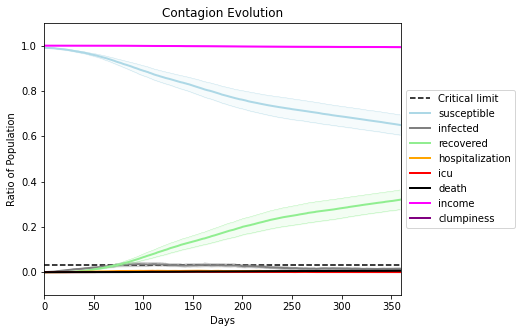

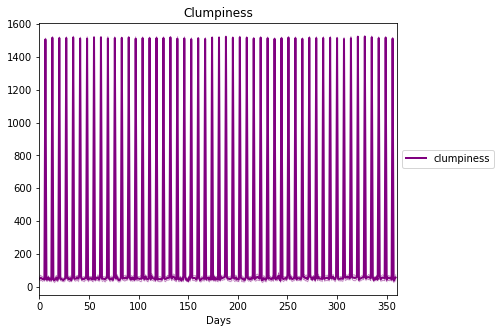

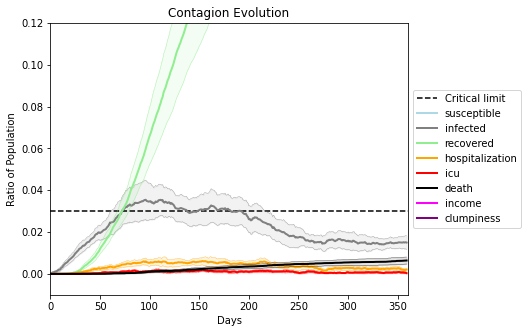

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2800, 7264, 4836, 6495, 5350, 8273, 8048, 9441, 8605, 4375, 9819, 6579, 3572, 5964, 5653, 1269, 8403, 3795, 1532, 793]
Average similarity between family members is 0.026137521779910352 at temperature 1
Average similarity between family and home is 0.999847331160208 at temperature -1
Average similarity between students and their classroom is 0.005612712699686493 at temperature 1
Average classroom occupancy is 1.56 and number classrooms is 175
Average similarity between workers is 0.021989197602165146 at temperature 1
Average office occupancy is 3.318407960199005 and number offices is 201
Average friend similarity for adults: 0.08044135358490567 for kids: 0.08742221178011657
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding

avg restaurant similarity 0.08560541757064108
avg restaurant similarity 0.10572046344924027
avg restaurant similarity -0.02320420445678743
avg restaurant similarity -0.07355685156299105
avg restaurant similarity 0.5779832711717234
avg restaurant similarity -0.07790419138729543
avg restaurant similarity -0.219669608515537
avg restaurant similarity -0.06548570719427257
avg restaurant similarity 0.24764490946936085
avg restaurant similarity -0.019926806894477914
avg restaurant similarity 0.10224185892772977
avg restaurant similarity -0.21597254747168776
avg restaurant similarity 0.09014901572279696
avg restaurant similarity 0.06901614561542949
avg restaurant similarity 0.0946033759168308
avg restaurant similarity 0.07864785225086211
avg restaurant similarity -0.11396840377086595
avg restaurant similarity 0.03724558121608175
avg restaurant similarity 0.06698881767115616
avg restaurant similarity -0.059170324115322415
avg restaurant similarity -0.17365142122722335
avg restaurant similarity 

avg restaurant similarity -0.21989757658002332
avg restaurant similarity 0.5447715036591831
avg restaurant similarity 0.08646693170907933
avg restaurant similarity 0.06901614561542949
avg restaurant similarity -0.048573700151987344
avg restaurant similarity -0.03716819850045018
avg restaurant similarity -0.17365142122722335
avg restaurant similarity 0.08188659061103568
avg restaurant similarity 0.10224185892772977
avg restaurant similarity -0.027750696495566274
avg restaurant similarity 0.05391680095620455
avg restaurant similarity 0.10594898831167418
avg restaurant similarity 0.1336449024752795
avg restaurant similarity -0.03716819850045018
avg restaurant similarity 0.101407843119598
avg restaurant similarity -0.003381553205724905
avg restaurant similarity 0.1063620488860188
avg restaurant similarity 0.024912573870414387
avg restaurant similarity 0.09187603026961623
avg restaurant similarity -0.05070415811097578
avg restaurant similarity -0.31910971211640515
avg restaurant similarity 

avg restaurant similarity 0.2089119380288653
avg restaurant similarity -0.23283390866827694
avg restaurant similarity -0.011236570545042901
avg restaurant similarity -0.42535054693312296
avg restaurant similarity 0.0060195332478923625
avg restaurant similarity -0.032998290862527424
avg restaurant similarity 0.20247840589251262
avg restaurant similarity -0.06724862170575252
avg restaurant similarity -0.0052640623688008925
avg restaurant similarity -0.010901447453408136
avg restaurant similarity -0.005589980359757857
avg restaurant similarity -0.021749786712416216
avg restaurant similarity 0.1122398284736942
avg restaurant similarity -0.299224657150436
avg restaurant similarity 0.021304057121584005
avg restaurant similarity -0.11283098759381797
avg restaurant similarity 0.14476086983841302
avg restaurant similarity -0.04442473993970307
avg restaurant similarity 0.1729587614544553
avg restaurant similarity 0.2926141884488999
avg restaurant similarity 0.06290459748249425
avg restaurant sim

avg restaurant similarity -0.09866261306288082
avg restaurant similarity -0.0008107362801176329
avg restaurant similarity -0.22543679534095862
avg restaurant similarity 0.02812306799316555
avg restaurant similarity -0.013966258211403772
avg restaurant similarity -0.09365419595815302
avg restaurant similarity -0.09162977524875231
avg restaurant similarity 0.13145504491032436
avg restaurant similarity 0.07088738667877204
avg restaurant similarity 0.12748940892142066
avg restaurant similarity 0.33611015767362684
avg restaurant similarity 0.04509826286344214
avg restaurant similarity 0.010564920738473954
avg restaurant similarity -0.06992748512736473
avg restaurant similarity -0.027473642144634925
avg restaurant similarity 0.2926144607961121
avg restaurant similarity 0.11485662885776318
avg restaurant similarity -0.013966258211403772
avg restaurant similarity -0.011357185247701719
avg restaurant similarity 0.13469855620653984
avg restaurant similarity 0.17128465574201712
avg restaurant sim

Average similarity between workers is 0.003590718057186261 at temperature 1
Average office occupancy is 3.272727272727273 and number offices is 198
Average friend similarity for adults: 0.08854559023989879 for kids: 0.07921706841493949
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.2099675968956883
avg restaurant similarity 0.31880923160301766
avg restaurant similarity 0.31880923160301766
avg restaurant similarity 0.005238289636424818
avg restaurant similarity 0.18963120488948568
avg restaurant similarity 0.06939096825999708
avg restaurant similarity -0.18079046649308428
avg restaurant similarity 0.03312990791503677
avg restaurant similarity -0.08812242706427884
avg restaurant similarity 0.14253178768302022
avg restaurant similarity -0.09617766861834459
avg restaurant similarity -0.17781532640571454
avg restaurant similarity -0.11647506471214619
avg restaurant similarity -0.08953877408306797
avg restaurant similarity -0.4687552807150125
avg restaurant similarity 0.23034535519287602
avg restaurant similarity -0.17995469812749434
avg restaurant similarity -0.2562156848941852
avg restaurant similarity -0.3056657046490685
avg restaurant similarity 0.10203917422341352
avg restaurant similarity 0.3100127618052279
avg restaurant similarity -0

avg restaurant similarity 0.20272056963989632
avg restaurant similarity -0.27708625300259426
avg restaurant similarity 0.388004492254358
avg restaurant similarity 0.010193175681787348
avg restaurant similarity -0.13573695640348787
avg restaurant similarity 0.060111973227396774
avg restaurant similarity -0.21452205284835135
avg restaurant similarity 0.09741740192275394
avg restaurant similarity 0.062430005618708234
avg restaurant similarity -0.09354578671649837
avg restaurant similarity -0.26632030563249565
avg restaurant similarity -0.006205200841071679
avg restaurant similarity 0.16645283393273305
avg restaurant similarity 0.0694977413400035
avg restaurant similarity -0.2113967199761279
avg restaurant similarity -0.2288756126957672
avg restaurant similarity -0.29117797464985684
avg restaurant similarity 0.15208701281325898
avg restaurant similarity 0.11937375119631248
avg restaurant similarity 0.12037397644825566
avg restaurant similarity 0.13165889646140205
avg restaurant similarity 

avg restaurant similarity 0.08681504995291887
avg restaurant similarity 0.28880530762646384
avg restaurant similarity -0.09547318773864995
avg restaurant similarity 0.4021143648009242
avg restaurant similarity -0.21374598160836727
avg restaurant similarity 0.21079298933282678
avg restaurant similarity -0.17585684081751918
avg restaurant similarity 0.2453125125371689
avg restaurant similarity -0.4816313696170283
avg restaurant similarity 0.13639253789740446
avg restaurant similarity 0.1591446359709424
avg restaurant similarity -0.33913082751617846
avg restaurant similarity 0.2918086056633365
avg restaurant similarity 0.14156693185174885
avg restaurant similarity 0.07406669773744756
avg restaurant similarity -0.045584004164423986
avg restaurant similarity -0.02056871113933556
avg restaurant similarity 0.0870553529335144
avg restaurant similarity -0.17093194678894916
avg restaurant similarity 0.04004697144865896
avg restaurant similarity 0.09344494789308959
avg restaurant similarity -0.02

avg restaurant similarity -0.11136213242395576
avg restaurant similarity 0.2290501102636897
avg restaurant similarity 0.23188214030862117
avg restaurant similarity -0.3053329715224308
avg restaurant similarity 0.06288306984432158
avg restaurant similarity 0.1776825732107975
avg restaurant similarity -0.060905921937943974
avg restaurant similarity -0.08683242834645041
avg restaurant similarity -0.38154618555533576
avg restaurant similarity 0.1746687371697449
avg restaurant similarity 0.2132996991714897
avg restaurant similarity 0.0598720170644413
avg restaurant similarity -0.308759656036555
avg restaurant similarity 0.4070219082274701
avg restaurant similarity -0.32525513768354136
avg restaurant similarity -0.002658544203016616
avg restaurant similarity 0.33499524608017134
avg restaurant similarity 0.2158347121453501
avg restaurant similarity 0.12022787253521401
avg restaurant similarity 0.06420183255555324
avg restaurant similarity 0.1484123489175794
avg restaurant similarity -0.032937

avg restaurant similarity 0.11809810929652911
avg restaurant similarity -0.12967596647022242
avg restaurant similarity -0.16190829887547065
avg restaurant similarity -0.027622488883634135
avg restaurant similarity 0.14518165515270676
avg restaurant similarity 0.4844140816261233
avg restaurant similarity -0.04134062772940545
avg restaurant similarity -0.002658544203016616
avg restaurant similarity 0.19705264772513265
avg restaurant similarity -0.18678295603106093
avg restaurant similarity -0.17968452073487115
avg restaurant similarity 0.06697567995565495
avg restaurant similarity -0.08257739756346695
avg restaurant similarity 0.11710162986674287
avg restaurant similarity 0.5452995595010189
avg restaurant similarity -0.24029502399415564
avg restaurant similarity 0.046464098933922254
avg restaurant similarity -0.18203806871768236
avg restaurant similarity -0.07772296069107062
avg restaurant similarity 0.023666143782682836
avg restaurant similarity -0.011059988821620324
avg restaurant simi

avg restaurant similarity 0.1207003128920184
avg restaurant similarity 0.010602387041091212
avg restaurant similarity 0.32974104106923785
avg restaurant similarity 0.03948781178447772
avg restaurant similarity 0.15335040673379027
avg restaurant similarity 0.20819780984286768
avg restaurant similarity 0.011390348794814958
avg restaurant similarity -0.22085380487711692
avg restaurant similarity -0.19057973491454555
avg restaurant similarity -0.21206236661889954
avg restaurant similarity -0.17617215858813606
avg restaurant similarity -0.1273491642944971
avg restaurant similarity -0.20368124045053337
avg restaurant similarity -0.18096869102605978
avg restaurant similarity 0.24196928043293653
avg restaurant similarity 0.2718404565432632
avg restaurant similarity -0.1358316592744317
avg restaurant similarity -0.20551855992705814
avg restaurant similarity -0.05139467304226114
avg restaurant similarity -0.08098316550580983
avg restaurant similarity -0.14980872748958204
avg restaurant similarit

avg restaurant similarity -0.3424304669702919
avg restaurant similarity -0.02799592129141116
avg restaurant similarity 0.06254213665621795
avg restaurant similarity -0.004357020685230861
avg restaurant similarity -0.3883643135663294
avg restaurant similarity -0.21091560413705587
avg restaurant similarity -0.17458455757175018
avg restaurant similarity -0.05141262416987273
avg restaurant similarity 0.1450261462127451
avg restaurant similarity 0.1620588383677244
avg restaurant similarity 0.014630078220368076
avg restaurant similarity 0.18690144354274846
avg restaurant similarity 0.0001316894201650922
avg restaurant similarity -0.09432039011184044
avg restaurant similarity 0.11758824823490237
Average similarity between family members is 0.02025338751200641 at temperature 1
Average similarity between family and home is 0.9998629952421959 at temperature -1
Average similarity between students and their classroom is 0.03779434162282635 at temperature 1
Average classroom occupancy is 1.56684491

avg restaurant similarity -0.17177176397254795
avg restaurant similarity -0.05501463438962711
avg restaurant similarity -0.21089244840330118
avg restaurant similarity 0.16564953220575676
avg restaurant similarity 0.013392696703693335
avg restaurant similarity -0.044669116576591276
avg restaurant similarity -0.016054473348355386
avg restaurant similarity 0.03633326350188491
avg restaurant similarity -0.013958649783492011
avg restaurant similarity -0.07354022775520845
avg restaurant similarity -0.17039634275986584
avg restaurant similarity -0.04425520813415431
avg restaurant similarity 0.556606992641358
avg restaurant similarity -0.030162282006575586
avg restaurant similarity -0.2611506545008677
avg restaurant similarity -0.07468010482128877
avg restaurant similarity 0.14563825356498128
avg restaurant similarity -0.3282742741171546
avg restaurant similarity 0.07903934229756915
avg restaurant similarity -0.02409495001695786
avg restaurant similarity 0.0612100792761458
avg restaurant simil

avg restaurant similarity -0.12398112145080056
avg restaurant similarity 0.060337640375417244
avg restaurant similarity 0.11725414295010854
avg restaurant similarity 0.016158535361905924
avg restaurant similarity 0.1292087791920863
avg restaurant similarity 0.15570297882789766
avg restaurant similarity 0.00531652269533911
avg restaurant similarity -0.09029006358611204
avg restaurant similarity 0.1260790428219867
avg restaurant similarity 0.10444398242068424
avg restaurant similarity 0.20739046007949802
avg restaurant similarity 0.07653417389716505
Average similarity between family members is 0.01667892649737583 at temperature 1
Average similarity between family and home is 0.9998600546710739 at temperature -1
Average similarity between students and their classroom is 0.023566975964705826 at temperature 1
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.017806114780007053 at temperature 1
Average office occupancy is 3

avg restaurant similarity -0.01755436398502732
avg restaurant similarity 0.31435777269387366
avg restaurant similarity 0.08789709339871342
avg restaurant similarity 0.1477680749612675
avg restaurant similarity 0.3478780189910675
avg restaurant similarity 0.10666767186488874
avg restaurant similarity 0.20594963727044988
avg restaurant similarity 0.03392381778137632
avg restaurant similarity -0.11695878591159614
avg restaurant similarity 0.021398218891429448
avg restaurant similarity 0.09871810446830226
avg restaurant similarity -0.2313478724838259
avg restaurant similarity -0.1105592419473975
avg restaurant similarity 0.40814347729850475
avg restaurant similarity -0.5605179062234478
avg restaurant similarity -0.07349647976280918
avg restaurant similarity 0.16583457790079742
avg restaurant similarity 0.25262900449607395
avg restaurant similarity 0.04904667619361822
avg restaurant similarity 0.44365981324501147
avg restaurant similarity 0.1339018363260666
avg restaurant similarity 0.12765

avg restaurant similarity -0.038185767584451275
avg restaurant similarity 0.11097058483114719
avg restaurant similarity -0.23312963704836695
avg restaurant similarity -0.21963077984084284
avg restaurant similarity -0.24022411760946008
avg restaurant similarity -0.21172339914001717
avg restaurant similarity -0.3543310549362945
avg restaurant similarity -0.011679301078562476
avg restaurant similarity 0.02569771760495509
avg restaurant similarity 0.060898686242807226
avg restaurant similarity -0.15856811537444535
avg restaurant similarity -0.0030014560584864236
avg restaurant similarity -0.31368649301047075
avg restaurant similarity -0.03064044797059476
avg restaurant similarity 0.02577893063518936
avg restaurant similarity -0.05236495786787778
avg restaurant similarity -0.23945521490501165
avg restaurant similarity -0.045762428393859876
avg restaurant similarity 0.013751416191090035
avg restaurant similarity 0.05711042675460604
avg restaurant similarity -0.34125774584365837
avg restauran

avg restaurant similarity 0.2107683738202521
avg restaurant similarity -0.24606203009028005
avg restaurant similarity 0.3402395574784926
avg restaurant similarity -0.13483217760121788
avg restaurant similarity 0.14703152700019329
avg restaurant similarity -0.1853602180678353
avg restaurant similarity 0.23167145055167976
avg restaurant similarity -0.16738544146811443
avg restaurant similarity -0.12420761335769068
avg restaurant similarity -0.14439508800031192
avg restaurant similarity -0.32557526228930433
avg restaurant similarity -0.011793556616982198
avg restaurant similarity 0.00936813661200262
avg restaurant similarity 0.059810678324445324
avg restaurant similarity -0.15590518670955722
avg restaurant similarity 0.035926562343443325
avg restaurant similarity -0.24183934417708064
avg restaurant similarity 0.12462427528627174
avg restaurant similarity -0.24203820048971542
avg restaurant similarity 0.03243842831532912
avg restaurant similarity -0.22949032051477095
avg restaurant similar

Average friend similarity for adults: 0.08623100614678456 for kids: 0.09342828525115723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.010628426744019957
avg restaurant similarity 0.04957358990925011
avg restaurant similarity -0.3711652428661144
avg restaurant similarity 0.19707269176524003
avg restaurant similarity -0.25418627396595883
avg restaurant similarity -0.09256563300292917
avg restaurant similarity 0.4651601901463702
avg restaurant similarity -0.05983981573503793
avg restaurant similarity -0.15008810076428436
avg restaurant similarity 0.07378703283011444
avg restaurant similarity 0.042257157909734694
avg restaurant similarity -0.1037913679113496
avg restaurant similarity -0.05168871947963552
avg restaurant similarity -0.1886137373346375
avg restaurant similarity 0.019323597226848722
avg restaurant similarity -0.09361889594831577
avg restaurant similarity 0.08321618152841989
avg restaurant similarity -0.141153351659327
avg restaurant similarity -0.31613282311671476
avg restaurant similarity 0.6242178415714432
avg restaurant similarity 0.011391867587340688
avg restaurant similarity 

avg restaurant similarity -0.0477368002492789
avg restaurant similarity 0.2698008787232415
avg restaurant similarity -0.3149690465672195
avg restaurant similarity 0.06746850246189462
avg restaurant similarity 0.08965878578079856
avg restaurant similarity 0.07985249718075384
avg restaurant similarity 0.03546726208813448
avg restaurant similarity 0.2206124469897761
Average similarity between family members is -0.008970419770187444 at temperature 1
Average similarity between family and home is 0.9998590664136032 at temperature -1
Average similarity between students and their classroom is 0.0009431223391412676 at temperature 1
Average classroom occupancy is 1.6704545454545454 and number classrooms is 176
Average similarity between workers is 0.010507196198279962 at temperature 1
Average office occupancy is 3.2216748768472905 and number offices is 203
Average friend similarity for adults: 0.08741397219340391 for kids: 0.08893015805530032
home_districts
[
Home (0,0) district with 1 Buildings

avg restaurant similarity 0.12094665009811179
avg restaurant similarity 0.035737916817387055
avg restaurant similarity -0.19716439345166548
avg restaurant similarity 0.21384357291750883
avg restaurant similarity -0.1417207723888368
avg restaurant similarity -0.32655760112151977
avg restaurant similarity 0.12481764285613872
avg restaurant similarity -0.08686353668880105
avg restaurant similarity 0.5528919333066522
avg restaurant similarity 0.35818084709715525
avg restaurant similarity -0.1529126328927651
avg restaurant similarity -0.03370911123679983
avg restaurant similarity -0.04386647687158994
avg restaurant similarity 0.324179801848462
avg restaurant similarity -0.03532677911217904
avg restaurant similarity -0.005644091427130692
avg restaurant similarity 0.07443932828085438
avg restaurant similarity 0.12530462191499084
avg restaurant similarity -0.15147935659888137
avg restaurant similarity 0.05011014939426086
avg restaurant similarity 0.41794371866341173
avg restaurant similarity 0

avg restaurant similarity 0.007526969968477149
avg restaurant similarity 0.0823858721295336
avg restaurant similarity -0.006634316746390108
avg restaurant similarity -0.42784329715545316
avg restaurant similarity 0.43652277635704895
avg restaurant similarity -0.06704659007577778
avg restaurant similarity 0.1626399698520203
avg restaurant similarity -0.0425029307263825
avg restaurant similarity -0.20331981946791042
avg restaurant similarity -0.1615276703702343
avg restaurant similarity -0.20894628103835242
avg restaurant similarity 0.4596405921365537
avg restaurant similarity -0.29105544028647845
avg restaurant similarity -0.0009448748171242694
avg restaurant similarity -0.05388598563445474
avg restaurant similarity 0.06560773187882137
avg restaurant similarity 0.11639911563308039
avg restaurant similarity 0.19326343229455678
avg restaurant similarity -0.18247543325420773
avg restaurant similarity -0.2135903973187221
avg restaurant similarity -0.10214883003887909
avg restaurant similari

avg restaurant similarity -0.00629642077939736
avg restaurant similarity -0.02217361217038305
avg restaurant similarity 0.16451452182610174
avg restaurant similarity 0.021526883667951816
avg restaurant similarity -0.08307815797227154
avg restaurant similarity 0.06055177616551364
avg restaurant similarity -0.06962392391716823
avg restaurant similarity -0.0924512253993973
avg restaurant similarity -0.20211288204242622
avg restaurant similarity 0.010956242854666814
avg restaurant similarity 0.12509638301592113
avg restaurant similarity -0.25471079455840384
avg restaurant similarity -0.07122195109866523
avg restaurant similarity 0.20389562566658956
avg restaurant similarity 0.007067381120019284
avg restaurant similarity 0.15053545388026135
avg restaurant similarity -0.13459066632715502
avg restaurant similarity 0.05739200831287872
avg restaurant similarity -0.21130522033235735
avg restaurant similarity 0.20234115599249633
avg restaurant similarity 0.37653121238640697
avg restaurant similar

avg restaurant similarity 0.08252882252040136
avg restaurant similarity 0.09197256620404241
avg restaurant similarity 0.25395421110993915
avg restaurant similarity -0.1761099955511407
avg restaurant similarity 0.439994206248304
avg restaurant similarity -0.026842160424411073
avg restaurant similarity 0.19813879543597823
avg restaurant similarity 0.2807681906446145
avg restaurant similarity -0.25401068826650786
avg restaurant similarity -0.01233723793851857
avg restaurant similarity -0.23281619536816772
avg restaurant similarity 0.07130669733135188
avg restaurant similarity 0.1610326472880094
avg restaurant similarity -0.08502123261458641
avg restaurant similarity 0.06701053334371218
avg restaurant similarity 0.19931142597399862
avg restaurant similarity 0.37995939927773215
avg restaurant similarity 0.17822394264567493
avg restaurant similarity 0.14349603841331152
avg restaurant similarity 0.12240760388250446
avg restaurant similarity 0.14357194679329405
avg restaurant similarity 0.6650

avg restaurant similarity -0.014962804487512
avg restaurant similarity -0.005985709695166235
avg restaurant similarity 0.15670420221990883
avg restaurant similarity -0.12270850407400793
avg restaurant similarity -0.012615423141413493
avg restaurant similarity -0.04908466392090194
avg restaurant similarity -0.13828008549866735
avg restaurant similarity -0.011169380890966418
avg restaurant similarity 0.05275654149720616
avg restaurant similarity -0.049709056898242385
avg restaurant similarity -0.09529721142214526
avg restaurant similarity 0.11759283229030248
avg restaurant similarity -0.39386913220497605
avg restaurant similarity -0.1545202225205937
avg restaurant similarity -0.3855645962349546
avg restaurant similarity 0.04034762267754019
avg restaurant similarity 0.2671751569354492
avg restaurant similarity -0.14878779512229257
avg restaurant similarity 0.23370116129228147
avg restaurant similarity -0.1764690207189799
avg restaurant similarity 0.023557552416348493
avg restaurant simila

Average friend similarity for adults: 0.07693584852536495 for kids: 0.08624929498124827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.17090933513151318
avg restaurant similarity 0.18784967241960873
avg restaurant similarity 0.2402592219087206
avg restaurant similarity -0.3307303383472838
avg restaurant similarity 0.16649341751846067
avg restaurant similarity 0.15975237426684907
avg restaurant similarity 0.40569692194228524
avg restaurant similarity 0.014458523418753932
avg restaurant similarity 0.489883758162837
avg restaurant similarity 0.08504839787130535
avg restaurant similarity 0.29988156960475904
avg restaurant similarity -0.01988557737013718
avg restaurant similarity -0.15726279940423793
avg restaurant similarity 0.31728917608244356
avg restaurant similarity 0.13834726637302364
avg restaurant similarity -0.29441060152790494
avg restaurant similarity -0.04370507423988362
avg restaurant similarity 0.3142487896265735
avg restaurant similarity -0.15546847113456003
avg restaurant similarity -0.025833991244884173
avg restaurant similarity 0.19655922987692043
avg restaurant similarity 0.35

avg restaurant similarity -0.009671132898165347
avg restaurant similarity 0.3390390226694213
avg restaurant similarity -0.20334054239391866
avg restaurant similarity -0.0701624261661099
avg restaurant similarity -0.05050782758022648
avg restaurant similarity -0.1647487367865915
avg restaurant similarity 0.1873941429788421
avg restaurant similarity 0.0008284160261462226
avg restaurant similarity -0.19483282347534753
avg restaurant similarity -0.06880143936857647
avg restaurant similarity -0.3136986937076139
avg restaurant similarity 0.2907875135770306
avg restaurant similarity 0.04414845160463653
avg restaurant similarity -0.207318462513067
avg restaurant similarity 0.26645953408874146
avg restaurant similarity 0.053887849696137656
avg restaurant similarity 0.10629171860174877
avg restaurant similarity 0.26101000272923286
avg restaurant similarity -0.01491561466613624
avg restaurant similarity -0.567091522914476
avg restaurant similarity 0.3361242783681077
avg restaurant similarity -0.1

avg restaurant similarity 0.15529757685761464
avg restaurant similarity -0.10934335238871475
avg restaurant similarity 0.13076704125144217
avg restaurant similarity 0.0015170066222656674
avg restaurant similarity 0.2732367888934282
avg restaurant similarity -0.07537445878430613
avg restaurant similarity 0.07794647840032343
avg restaurant similarity -0.14340516924409133
avg restaurant similarity -0.09984575908740828
avg restaurant similarity -0.10261403735925878
avg restaurant similarity 0.6178436459634953
avg restaurant similarity 0.0015170066222656674
avg restaurant similarity 0.3573709370856814
avg restaurant similarity 0.03809453538309643
avg restaurant similarity 0.3528407408961957
avg restaurant similarity 0.26296706122466307
avg restaurant similarity 0.08714818889875921
avg restaurant similarity 0.13076704125144217
avg restaurant similarity 0.3084542960138695
avg restaurant similarity 0.14049729002694458
avg restaurant similarity 0.24816010504470265
avg restaurant similarity -0.1

avg restaurant similarity 0.08714818889875921
avg restaurant similarity 0.2599968706639121
avg restaurant similarity 0.03607168928854264
Average similarity between family members is 0.00564166473873911 at temperature 1
Average similarity between family and home is 0.999853004174001 at temperature -1
Average similarity between students and their classroom is 0.038188172930500607 at temperature 1
Average classroom occupancy is 1.6184971098265897 and number classrooms is 173
Average similarity between workers is 0.01241711927190369 at temperature 1
Average office occupancy is 3.305 and number offices is 200
Average friend similarity for adults: 0.09406471408098295 for kids: 0.0846796793806284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity 

avg restaurant similarity -0.21708939551384002
avg restaurant similarity 0.11032868107178007
avg restaurant similarity -0.20402975444277083
avg restaurant similarity -0.12837777751043478
avg restaurant similarity 0.3814371939858281
avg restaurant similarity -0.0976600047920273
avg restaurant similarity 0.23127816491282094
avg restaurant similarity 0.43156083517293
avg restaurant similarity 0.1304005422751081
avg restaurant similarity -0.21248415074959354
avg restaurant similarity 0.3060433616789602
avg restaurant similarity -0.01572805801931173
avg restaurant similarity -0.29099725631667234
avg restaurant similarity -0.12945842882709288
avg restaurant similarity -0.1309605189525433
avg restaurant similarity -0.26977113475702336
avg restaurant similarity 0.12381589081657442
avg restaurant similarity 0.020692654494421425
avg restaurant similarity -0.209553473943352
avg restaurant similarity 0.012535946689532527
avg restaurant similarity 0.34647170528661075
avg restaurant similarity 0.309

avg restaurant similarity 0.005001868353231266
avg restaurant similarity 0.3791734083732932
avg restaurant similarity -0.26377971966924113
avg restaurant similarity -0.0008219281403515355
avg restaurant similarity 0.30528057097898875
avg restaurant similarity -0.3634926287445945
avg restaurant similarity -0.2874565374461705
avg restaurant similarity -0.1825647020893539
avg restaurant similarity -0.017646108824457465
avg restaurant similarity -0.2792784508691161
avg restaurant similarity -0.11739957847626876
avg restaurant similarity -0.2792784508691161
avg restaurant similarity -0.0816687546154459
avg restaurant similarity -0.0593529557593096
avg restaurant similarity 0.33690985548402486
avg restaurant similarity 0.3090854819798319
Average similarity between family members is 0.029761035044633063 at temperature 1
Average similarity between family and home is 0.999863319364751 at temperature -1
Average similarity between students and their classroom is 0.037108186178718874 at temperatur

avg restaurant similarity 0.08557878249980577
avg restaurant similarity -0.018162728796274646
avg restaurant similarity -0.10403320432435886
avg restaurant similarity 0.12484665965226549
avg restaurant similarity 0.2523321255567642
avg restaurant similarity -0.06335965540090062
avg restaurant similarity -0.0394227257615945
avg restaurant similarity 0.4191397411639348
avg restaurant similarity 0.03836825006506123
avg restaurant similarity 0.018061376135920924
avg restaurant similarity 0.25020898525023033
avg restaurant similarity 0.12257576938632213
avg restaurant similarity -0.2488114743632026
avg restaurant similarity 0.4292433037450274
avg restaurant similarity -0.01934763682763306
avg restaurant similarity -0.26252719659204304
avg restaurant similarity 0.006876812627242952
avg restaurant similarity 0.05361159652441814
avg restaurant similarity -0.20021381570279556
avg restaurant similarity 0.05738522243141067
avg restaurant similarity 0.04642847201160112
avg restaurant similarity 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

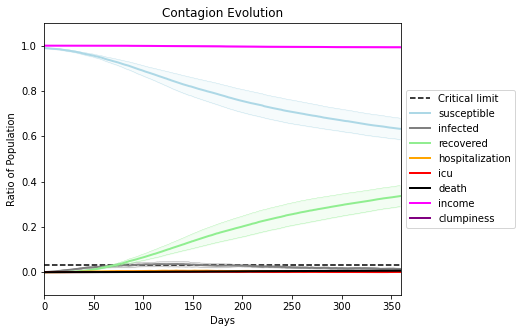

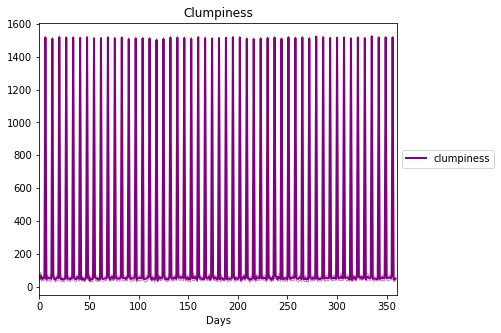

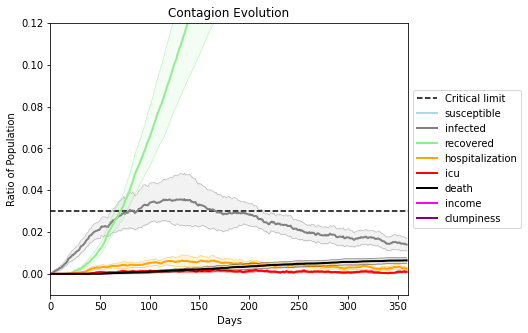

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)